### Importing libraries

In [30]:
#Importing audio file paths
import os

#For managing dataframe
import pandas as pd
import numpy as np

#PyTorch
import torchaudio
import torch
from torch.utils.tensorboard import SummaryWriter
from torch.utils.data import Dataset
from torch import nn

#Models
import transformer

#Metrics
import seaborn as sb
import matplotlib.pyplot as plt
from torchmetrics.classification import MulticlassF1Score
from torchmetrics.classification import ConfusionMatrix

# Misc.
import warnings
import librosa
import torchvision
import math
from sklearn.model_selection import train_test_split
from sklearn.utils.class_weight import compute_class_weight
from sklearn.preprocessing import StandardScaler
from tqdm.notebook import tqdm_notebook
from IPython.display import Audio

warnings.filterwarnings("ignore")

#Selecting device
device="cuda" if torch.cuda.is_available() else "cpu"

print(f"Using {device}")

Using cuda


### Dataset Loading

In [2]:
def add_noise(data,alpha=0.015):
    noise_value = alpha * np.random.uniform() * np.amax(data)
    data = data + noise_value * np.random.normal(size=data.shape[0])
    return data

def stretch_process(data, rate=0.8):
    return librosa.effects.time_stretch(data, rate=0.8)

def pitch_process(data, sampling_rate, pitch_factor=0.7):
    return librosa.effects.pitch_shift(data, sr=sampling_rate, n_steps=pitch_factor)


def extract_process(data, sample_rate):
    output_result = np.array([])

    mean_zero = np.mean(librosa.feature.zero_crossing_rate(y=data).T, axis=0)
    output_result = np.hstack((output_result, mean_zero))

    
    stft_out = np.abs(librosa.stft(data))
    chroma_stft = np.mean(librosa.feature.chroma_stft(S=stft_out, sr=sample_rate).T, axis=0)
    output_result = np.hstack((output_result, chroma_stft))

    mfcc_out = np.mean(librosa.feature.mfcc(y=data, sr=sample_rate, n_mfcc=40).T, axis=0)
    output_result = np.hstack((output_result, mfcc_out))

    root_mean_out = np.mean(librosa.feature.rms(y=data).T, axis=0)
    output_result = np.hstack((output_result, root_mean_out))

    mel_spectogram = np.mean(librosa.feature.melspectrogram(y=data, sr=sample_rate).T, axis=0)
    output_result = np.hstack((output_result, mel_spectogram))
    

    return output_result


def extract_features(file_name):
    
    """
    This function takes in the path for an audio file as a string, loads it,
    and extracts several audio features including mean values of MFCC, Zero Crossing Rate,
    Chromagram, Root Mean Square Energy, and Mel Spectrogram from the original and its augmented versions.
    """
    
    try:
        # Load the original audio file
        audio, sample_rate = librosa.load(file_name, res_type='kaiser_fast', duration=42, offset=0.6)

        # Extract features from the original audio data
        extracted_features = extract_process(audio, sample_rate)
        result = np.array(extracted_features)

        # Add noise and extract features
        noise_out = add_noise(audio)
        output_2 = extract_process(noise_out, sample_rate)
        result = np.vstack((result, output_2))

        # Time-stretch and then pitch-shift before extracting features
        new_out = stretch_process(audio,0.8)
        stretch_pitch = pitch_process(new_out, sample_rate,pitch_factor=0.7)
        output_3 = extract_process(stretch_pitch, sample_rate)
        result = np.vstack((result, output_3))

    except Exception as e:
        print("Error encountered while parsing file: ", file_name)
        print("Error Details:", e)
        return None

    return result

In [3]:
def class_fetch(df: pd.DataFrame())->(list,dict):
    s=list(sorted(df["target"].unique()))
    d={}
    
    count=0
    for i in s:
        d[i]=count
        count+=1
        
    return s,d

### Dataset Class

In [4]:
t=-1
type(t)==int

True

In [5]:
class audio_dataset(Dataset):
    def __init__(self,
                 audio_df_path=-1,
                 audio_df=-1,
                 transform=False) -> None:
        

        if(type(audio_df_path)==int and type(audio_df)==int):
            raise Exception("Both can't be empty at the same time (audio_df_path or audio_df)")

        if(type(audio_df_path)!=int):
            self.audio_df_path=audio_df_path
            self.df=pd.read_csv(self.audio_df_path)
        else:
            self.df=audio_df
            
        self.classes,self.class_to_idx=class_fetch(self.df)
        self.transform=transform
        self.scaler=StandardScaler()
    
    def apply_transform(self,x,sr):
        n=torch.randint(low=0,high=2,size=(1,))
        x=add_noise(x,0.015*n.item())
        x=stretch_process(x,0.8*n.item())
        x=pitch_process(x,sr,0.7*n.item())
        return x

    def get_all_class_idx(self):
        y=[]
        for i in range(len(self.df)):
            y.append(self.class_to_idx[self.df.iloc[i]["target"]])

        return y
    
    def __len__(self) -> int:
        return len(self.df)


    def __getitem__(self, index: int) -> torch.Tensor():
        
        self.val=self.df.iloc[index]["file_save_path"]
        self.class_val=self.class_to_idx[self.df.iloc[index]["target"]]

        self.signal, self.sr = librosa.load(self.val)
        
        if(self.transform!=False):
            self.signal=self.apply_transform(self.signal,self.sr)
            
        self.signal = torch.unsqueeze(torch.from_numpy(np.squeeze(self.scaler.fit_transform(np.reshape(extract_process(self.signal, self.sr),newshape=(-1,1))))),dim=0).type(torch.float32)
        
        return self.signal,self.class_val
            

### Train Test Split

In [6]:
path_df="../Sound_Classification/archive/processed_data.csv"
df=pd.read_csv("../Sound_Classification/archive/processed_data.csv")
test_size=0.25

cols=list(df.columns)
target=df["target"]

train_df,temp_df,temp1,temp2=train_test_split(df.values,target,test_size=test_size)

temp_df=pd.DataFrame(temp_df,columns=cols)
target=temp_df["target"]

test_df,val_df,temp1,temp2=train_test_split(temp_df.values,target,test_size=0.5)

train_df=pd.DataFrame(train_df,columns=cols)
val_df=pd.DataFrame(val_df,columns=cols)
test_df=pd.DataFrame(test_df,columns=cols)

In [7]:
train_df["target"].value_counts()

target
COPD              4308
Healthy            242
Pneumonia          213
URTI               189
Bronchiolitis      119
Bronchiectasis      74
Name: count, dtype: int64

In [8]:
test_df["target"].value_counts()

target
COPD              718
Healthy            45
Pneumonia          31
URTI               30
Bronchiolitis      17
Bronchiectasis     16
Name: count, dtype: int64

In [9]:
val_df["target"].value_counts()

target
COPD              720
Pneumonia          41
Healthy            35
URTI               24
Bronchiolitis      24
Bronchiectasis     14
Name: count, dtype: int64

In [10]:
1/train_df["target"].value_counts()

target
COPD              0.000232
Healthy           0.004132
Pneumonia         0.004695
URTI              0.005291
Bronchiolitis     0.008403
Bronchiectasis    0.013514
Name: count, dtype: float64

In [11]:
BATCH_SIZE=32

train_ds=audio_dataset(audio_df=train_df)
test_ds=audio_dataset(audio_df=test_df)
val_ds=audio_dataset(audio_df=val_df)

try:
    def get_class_weight_sampler(ds: audio_dataset) -> torch.Tensor():
        y=df["target"]
        class_weights = dict(1/pd.Series(y).value_counts())
        #print(class_weights)
        
        wt=[]
        for i in ds.classes:
            wt.append(class_weights[i])
        
        weight=[wt[i] for i in ds.get_all_class_idx()]
        
        return weight
    
    weights=get_class_weight_sampler(train_ds)
    sampler_train=torch.utils.data.WeightedRandomSampler(weights=weights, num_samples=len(train_ds), replacement=True)
    
    train_loader=torch.utils.data.DataLoader(train_ds,batch_size=BATCH_SIZE,sampler=sampler_train)
    test_loader=torch.utils.data.DataLoader(test_ds,batch_size=BATCH_SIZE,shuffle=True)
    val_loader=torch.utils.data.DataLoader(val_ds,batch_size=BATCH_SIZE,shuffle=True)
    
    print(f"\nData loaded with oversampling")

except Exception as e:
    print(f"\n{e}\n")
    train_loader=torch.utils.data.DataLoader(train_ds,batch_size=BATCH_SIZE,shuffle=True)
    test_loader=torch.utils.data.DataLoader(test_ds,batch_size=BATCH_SIZE,shuffle=True)
    val_loader=torch.utils.data.DataLoader(val_ds,batch_size=BATCH_SIZE,shuffle=True)
    print(f"\nData loaded without oversampling")


Data loaded with oversampling


#### Class imblanace and data loader check

In [12]:
def show_imbalance(dl: torch.utils.data.DataLoader, batches: int, train_ds: torch.utils.data.Dataset):
    for i in range(batches):
        data, label=next(iter(dl))
        data_qty={i:0 for i in range(len(train_ds.classes))}
        for i in label:
            data_qty[i.item()]+=1
        print(data_qty)

show_imbalance(train_loader,2,train_ds)

{0: 3, 1: 7, 2: 4, 3: 5, 4: 5, 5: 8}
{0: 4, 1: 4, 2: 6, 3: 6, 4: 5, 5: 7}


In [13]:
im=next(iter(train_loader))[0]
im.shape

torch.Size([32, 1, 182])

In [14]:
im[0].dtype

torch.float32

In [15]:
assert ((train_ds.classes==test_ds.classes and test_ds.classes==val_ds.classes))
train_ds.classes==test_ds.classes and test_ds.classes==val_ds.classes

True

### Setting up Tensorboard and performance metrics

In [16]:
log_dir = "../"+"performance_metrics"
writer = SummaryWriter(log_dir=log_dir)

def accuracy_fn(logits,true):
    return torch.eq(torch.argmax(torch.softmax(logits,dim=1),dim=1).squeeze(),true).sum().item()/len(logits)

f1_fn=MulticlassF1Score(num_classes=len(train_ds.classes)).to(device)
cf_matrix=ConfusionMatrix(num_classes=len(train_ds.classes),task="multiclass")

### Model 1 (Simple Conv1D Network)

In [17]:
class auditory_conv1d(nn.Module):
    def __init__(self):
        super().__init__()
        self.input_embedding=nn.Sequential(nn.Conv1d(in_channels=1,out_channels=256,stride=1,kernel_size=5),
                                           nn.ReLU(),
                                           nn.MaxPool1d(kernel_size=5,stride=2,padding=1),
                                           nn.Conv1d(in_channels=256,out_channels=256,kernel_size=4),
                                           nn.ReLU(),
                                           nn.MaxPool1d(kernel_size=5,stride=1,padding=1),
                                           nn.Conv1d(in_channels=256,out_channels=128,kernel_size=4),
                                           nn.ReLU(),
                                           nn.MaxPool1d(kernel_size=5,stride=2,padding=1),
                                           nn.Conv1d(in_channels=128,out_channels=64,kernel_size=4),
                                           nn.ReLU(),
                                           nn.MaxPool1d(kernel_size=5,stride=2,padding=1),
                                           nn.Conv1d(in_channels=64,out_channels=32,kernel_size=5),
                                           nn.ReLU(),
                                           nn.MaxPool1d(kernel_size=5,stride=2,padding=1),
                                           nn.Dropout(p=0.2),
                                           nn.Flatten(),
                                           nn.ReLU(),
                                           nn.Linear(in_features=192,out_features=32,bias=True),
                                           nn.ReLU(),
                                           nn.Dropout(p=0.3),
                                           nn.Linear(in_features=32,out_features=len(train_ds.classes),bias=True))

    def forward(self,x):
        return self.input_embedding(x)

### Model 2 (LSTM)

In [18]:
class AudioLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, num_classes):
        super(AudioLSTM, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, num_classes)
        
    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)
        
        out, _ = self.lstm(x, (h0, c0))
        # Use output of the last time step for classification
        out = self.fc(out[:, -1, :])
        return out

### Model 3 (Transformer)

In [36]:
class PositionalEncoding(nn.Module):
    def __init__(self,d_model: int,seq_len: int,dropout: float):
        super().__init__()
        self.d_model=d_model
        self.seq_len=seq_len
        self.dropout=nn.Dropout(p=dropout)

        pe=torch.zeros(seq_len,d_model)

        # Makes a variable with shape (seq_len,1)
        pos=torch.arange(0,seq_len,dtype=torch.float).unsqueeze(1)

        # Makes a variable with shape d_model/2 [d_model/2 because even position or odd poisitons are basically of total positions]
        div_term=torch.exp(torch.arange(0,self.d_model,2).float()*(-math.log(10000.0)/self.d_model))
        
        pe[:,0::2]=torch.sin(pos*div_term)
        pe[:,1::2]=torch.cos(pos*div_term)

        pe=pe.unsqueeze(0)

        self.register_buffer('pe',pe)

    def forward(self,x):
        x=x+(self.pe[:,:x.shape[1],:]).requires_grad_(False)
        print(self.pe[:,:x.shape[1],:].shape)
        return self.dropout(x)


class LayerNormalization(nn.Module):
    def __init__(self,eps: float=1e-6):
        super().__init__()
        self.eps=eps
        self.alpha=nn.Parameter(torch.ones(1))
        self.bias=nn.Parameter(torch.zeros(1))

    def forward(self,x):
        mean=x.mean(dim=-1,keepdim=True)
        std=x.std(dim=-1,keepdim=True)
        return (self.alpha*(x-mean)/(std+self.eps))+self.bias


class FeedForwardBlock(nn.Module):
    def __init__(self,d_model: int, d_ff: int,dropout:float):
        super().__init__()
        self.linear_1=nn.Linear(d_model,d_ff)
        self.dropout=nn.Dropout(dropout)
        self.linear_2=nn.Linear(d_ff,d_model)

    def forward(self,x):
        return self.linear_2(self.dropout(self.linear_1(x)))


class MultiHeadAttentionBlock(nn.Module):

    def __init__(self,d_model: int,h: int,dropout: float):
        super().__init__()
        self.d_model=d_model
        self.h=h
        self.dropout=nn.Dropout(p=dropout)
        assert d_model%h==0, f"{d_model} is not divisible by {h}"

        self.d_k=d_model//h
        self.w_q=nn.Linear(d_model,d_model) #Wq
        self.w_k=nn.Linear(d_model,d_model) #Wk
        self.w_v=nn.Linear(d_model,d_model) #Wv

        self.w_o=nn.Linear(d_model,d_model) #Wo

    @staticmethod
    def attention(query, key, value, mask, dropout: nn.Dropout):
        d_k=query.shape[-1]

        attention_scores=(query@key.transpose(-2,-1))/math.sqrt(d_k)
        if(mask is not None):
            attention_scores.masked_fill_(mask==0,-1e9)
        attention_scores=attention_scores.softmax(dim=-1)
        if(dropout is not None):
            attention_scores=dropout(attention_scores)

        return (attention_scores@value), attention_scores

    def forward(self,q,k,v,mask):
        query=self.w_q(q) # (Batch, seq_len, d_model) --> (Batch, seq_len, d_model)
        key=self.w_k(k) # (Batch, seq_len, d_model) --> (Batch, seq_len, d_model)
        value=self.w_v(v) # (Batch, seq_len, d_model) --> (Batch, seq_len, d_model)

        # (Batch, seq_len, d_model) --> (Batch, seq_len, h, d_model) --> (Batch, h , seq_len, d_k)

        query=query.view(query.shape[0],query.shape[1],self.h,self.d_k).transpose(1,2)
        key=query.view(query.shape[0],query.shape[1],self.h,self.d_k).transpose(1,2)
        value=query.view(query.shape[0],query.shape[1],self.h,self.d_k).transpose(1,2)

        x, self.attention_scores=MultiHeadAttentionBlock.attention(query, key, value, mask, self.dropout)

        # (Batch, h, seq_len, d_k) --> (Batch, seq_len, h, d_k) --> (Batch, seq_len, d_model)
        x=x.transpose(1,2).contiguous().view(x.shape[0],-1,self.h*self.d_k)

        # (Batch, seq_len, d_model) --> (Batch, seq_len, d_model)
        return self.w_o(x)

class ResidualConnection(nn.Module):
    def __init__(self, dropout: float):
        super().__init__()
        self.dropout=nn.Dropout(dropout)
        self.norm=LayerNormalization()

    def forward(self,x,sublayer):
        return x+self.dropout(sublayer(self.norm(x)))
        

class EncoderBlock(nn.Module):
    def __init__(self,self_attention_block: MultiHeadAttentionBlock, feed_forward_block: FeedForwardBlock, dropout:float):
        super().__init__()
        self.self_attention_block=self_attention_block
        self.feed_forward_block=feed_forward_block
        self.residual_connections=nn.ModuleList([ResidualConnection(dropout) for _ in range(2)])

    def forward(self,x,src_mask):
        x=self.residual_connections[0](x,lambda x: self.self_attention_block(x,x,x,src_mask))
        x=self.residual_connections[1](x,lambda x: self.feed_forward_block(x))                                    ############ HERE
        return x


class Encoder(nn.Module):
    def __init__(self,layers: nn.ModuleList):
        super().__init__()
        self.layers=layers
        self.norm=LayerNormalization()

    def forward(self, x, mask):
        for layer in self.layers:
            x=layer(x,mask)
        return self.norm(x)

class ProjectionLayer(nn.Module):

    def __init__(self, d_model, vocab_size) -> None:
        super().__init__()
        self.proj = nn.Linear(d_model, vocab_size)

    def forward(self, x) -> None:
        # (batch, seq_len, d_model) --> (batch, seq_len, vocab_size)
        return self.proj(x)
    
class Transformer(nn.Module):

    def __init__(self, encoder: Encoder, src_pos: PositionalEncoding, projection_layer: ProjectionLayer) -> None:
        super().__init__()
        self.encoder = encoder
        self.src_pos = src_pos
        self.projection_layer = projection_layer

    def encode(self, src, src_mask):
        # (batch, seq_len, d_model)
        src = self.src_pos(src)
        return self.encoder(src, src_mask)
    
    def project(self, x):
        # (batch, seq_len, vocab_size)
        return self.projection_layer(x)

In [46]:
def build_transformer(src_seq_len: int, d_model: int=182, N: int=6, h: int=7, dropout: float=0.1, d_ff: int=2048) -> Transformer:
    # Create the positional encoding layers
    src_pos = PositionalEncoding(d_model, src_seq_len, dropout)

    # Create the encoder blocks
    encoder_blocks = []
    for _ in range(N):
        encoder_self_attention_block = MultiHeadAttentionBlock(d_model, h, dropout)
        feed_forward_block = FeedForwardBlock(d_model, d_ff, dropout)
        encoder_block = EncoderBlock(encoder_self_attention_block, feed_forward_block, dropout)
        encoder_blocks.append(encoder_block)
    
    # Create the encoder and decoder
    encoder = Encoder(nn.ModuleList(encoder_blocks))
    
    # Create the projection layer
    projection_layer = ProjectionLayer(d_model, 2048)
    
    # Create the transformer
    transformer = Transformer(encoder, src_pos, projection_layer)
    
    # Initialize the parameters
    for p in transformer.parameters():
        if p.dim() > 1:
            nn.init.xavier_uniform_(p)
    
    return transformer


In [47]:
model3=build_transformer(26)

### Model Training and Testing

In [19]:
input_size = 182  # Input size, for example, if using a spectrogram
hidden_size = 64
num_layers = 2
num_classes = len(train_ds.classes)  # Number of classes for classification

model1=auditory_conv1d().to(device)
model2 = AudioLSTM(input_size, hidden_size, num_layers, num_classes).to(device)

test=next(iter(train_loader))[0].to(device)

with torch.inference_mode():
    print(model1(test).shape)
    print(model2(test).shape)

torch.Size([32, 6])
torch.Size([32, 6])


#### Training Function

In [20]:
def train_model(model,epochs):
    optimizer=torch.optim.Adam(params=model.parameters())
    loss_fn=nn.CrossEntropyLoss()
    
    for i in tqdm_notebook(range(epochs)):
        train_preds=torch.tensor([])
        val_preds=torch.tensor([])
        train_actual=torch.tensor([])
        val_actual=torch.tensor([])
        
        print("\nTraining:")
        model.train()
        
        #Defining accuracy and loss for train and val data
        temp_train_accuracy=[]
        temp_val_accuracy=[]
        temp_train_loss=[]
        temp_val_loss=[]
        temp_train_f1=[]
        temp_val_f1=[]
    
        net_train_accuracy=0
        net_val_accuracy=0
        net_train_loss=0
        net_val_loss=0
        net_train_f1=0
        net_val_f1=0
        
        with tqdm_notebook(total=len(train_loader)) as pbar:
            for x,y in train_loader:
                    x=x.to(device)
                    y=y.to(device)
        
                    #Calculating model output
                    logits=model(x)
        
                    #Reseting any old gradient values
                    optimizer.zero_grad()
                    loss=loss_fn(logits.squeeze(),y)
                
                    #Track of metrics
                    preds=torch.argmax(torch.softmax(logits,dim=1),dim=1).squeeze()
                    train_preds=torch.hstack((train_preds,preds.to("cpu")))
                    train_actual=torch.hstack((train_actual,y.to("cpu")))
                    accuracy_train=accuracy_fn(logits.type(torch.float32),y)
                    f1_train=f1_fn(preds,y)
                    temp_train_accuracy.append(accuracy_train)
                    temp_train_loss.append(loss.item())
                    temp_train_f1.append(f1_train.item())
                
                    #Back Propogation
                    loss.backward()
                
                    #Update Parameters
                    optimizer.step()
                
                    #Progress Bar Update
                    pbar.update(1)
            pbar.close()
        #Tensorboard & Metrics for the dataset
        net_train_accuracy=sum(temp_train_accuracy)/len(temp_train_accuracy)
        net_train_loss=sum(temp_train_loss)/len(temp_train_loss)
        net_train_f1=sum(temp_train_f1)/len(temp_train_f1)
        writer.add_scalar("Train Accuracy",net_train_accuracy,i)
        writer.add_scalar("Train Loss",net_train_loss,i)
        writer.add_scalar("Train F1 Score",net_train_f1,i)
    
        #Evaluation
        print("Testing:")
        model.eval()
    
        with tqdm_notebook(total=len(val_loader)) as pbar2:
            for x,y in val_loader:
                x=x.to(device)
                y=y.to(device)
                
                #Setting inference mode
                with torch.inference_mode():
                    logits=model(x)
                    loss=loss_fn(logits.squeeze().type(torch.float32),y)
    
                    #Track of metrics
                    preds=torch.argmax(torch.softmax(logits,dim=1),dim=1).squeeze()
                    val_preds=torch.hstack((val_preds,preds.to("cpu")))
                    val_actual=torch.hstack((val_actual,y.to("cpu")))
                    accuracy_val=accuracy_fn(logits,y)
                    f1_val=f1_fn(preds,y)
                    temp_val_accuracy.append(accuracy_val)
                    temp_val_loss.append(loss.item())
                    temp_val_f1.append(f1_val.item())
    
                    #Progress Bar Update
                    pbar2.update(1)
            pbar2.close()
    
        #Tensorboard & Metrics for the dataset
        net_val_accuracy=sum(temp_val_accuracy)/len(temp_val_accuracy)
        net_val_loss=sum(temp_val_loss)/len(temp_val_loss)
        net_val_f1=sum(temp_val_f1)/len(temp_val_f1)
        writer.add_scalar("Val Accuracy",net_val_accuracy,i)
        writer.add_scalar("Val Loss",net_val_loss,i)
        writer.add_scalar("Val F1 Score",net_val_f1,i)

        print(f"\nEpoch {i+1}:\n\nTrain Accuracy: {net_train_accuracy}\n\nTrain Loss: {net_train_loss}\n\nTrain F1 Score: {net_train_f1}\n\nVal Accuracy: {net_val_accuracy}\n\nVal Loss: {net_val_loss}\n\nVal F1 Score: {net_val_f1}")

        #Plotting confusion matrix
        print("\n")
        plt.figure(figsize=(10,5))
        sb.heatmap(cf_matrix(train_preds,train_actual),annot=True,xticklabels=train_ds.classes,yticklabels=train_ds.classes)
        plt.title("Train confusion matrix")
        plt.xlabel("Predictions")
        plt.ylabel("True")
        plt.show()
        
        print("\n")
        plt.figure(figsize=(10,5))
        sb.heatmap(cf_matrix(val_preds,val_actual),annot=True,xticklabels=train_ds.classes,yticklabels=train_ds.classes)
        plt.title("Val confusion matrix")
        plt.xlabel("Predictions")
        plt.ylabel("True")
        plt.show()

def test_model(model):
    loss_fn=nn.CrossEntropyLoss()

    train_preds=torch.tensor([])
    test_preds=torch.tensor([])
    train_actual=torch.tensor([])
    test_actual=torch.tensor([])
    
    print("\nTraining:")
    model.train()
    
    #Defining accuracy and loss for train and test ds
    temp_test_accuracy=[]
    temp_test_loss=[]
    temp_test_f1=[]

    net_test_accuracy=0
    net_test_loss=0
    net_test_f1=0

    with tqdm_notebook(total=len(test_loader)) as pbar2:
        for x,y in test_loader:
            x=x.to(device)
            y=y.to(device)
            
            #Setting inference mode
            with torch.inference_mode():
                logits=model(x)
                loss=loss_fn(logits.squeeze().type(torch.float32),y)
    
                #Track of metrics
                preds=torch.argmax(torch.softmax(logits,dim=1),dim=1).squeeze()
                test_preds=torch.hstack((test_preds,preds.to("cpu")))
                test_actual=torch.hstack((test_actual,y.to("cpu")))
                accuracy_test=accuracy_fn(logits,y)
                f1_test=f1_fn(preds,y)
                temp_test_accuracy.append(accuracy_test)
                temp_test_loss.append(loss.item())
                temp_test_f1.append(f1_test.item())
    
                #Progress Bar Update
                pbar2.update(1)
        pbar2.close()

    net_test_accuracy=sum(temp_test_accuracy)/len(temp_test_accuracy)
    net_test_loss=sum(temp_test_loss)/len(temp_test_loss)
    net_test_f1=sum(temp_test_f1)/len(temp_test_f1)

    print(f"\nTest Accuracy: {net_test_accuracy}\n\nTest Loss: {net_test_loss}\n\nTest F1 Score: {net_test_f1}")

    print("\n")
    plt.figure(figsize=(10,5))
    sb.heatmap(cf_matrix(test_preds,test_actual),annot=True,xticklabels=train_ds.classes,yticklabels=train_ds.classes)
    plt.title("Testing confusion matrix")
    plt.xlabel("Predictions")
    plt.ylabel("True")
    plt.show()

#### Training Conv1D

  0%|          | 0/100 [00:00<?, ?it/s]


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 1:

Train Accuracy: 0.2677406832298137

Train Loss: 1.6348039193183

Train F1 Score: 0.18957697588557043

Val Accuracy: 0.6655092592592593
\Val Loss: 0.9390556547376845

Val F1 Score: 0.24154365669797967




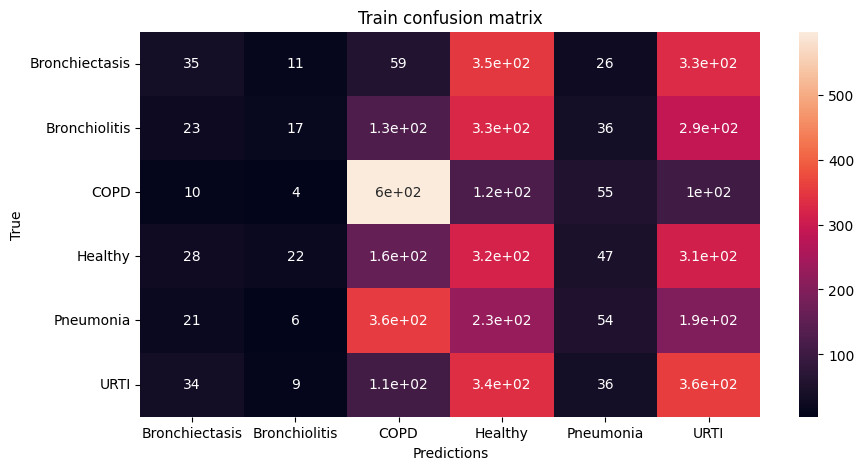

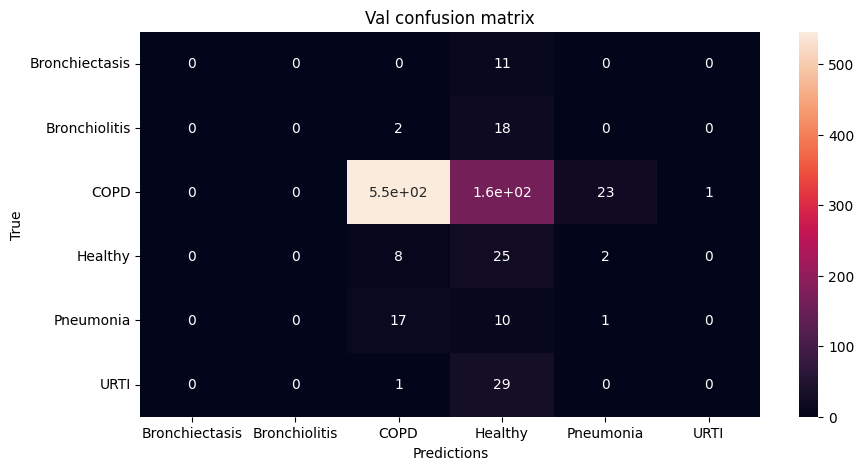


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 2:

Train Accuracy: 0.3627872670807453

Train Loss: 1.531843246140095

Train F1 Score: 0.3161584287881851

Val Accuracy: 0.5280448717948718
\Val Loss: 1.159728933263708

Val F1 Score: 0.22615134219328561




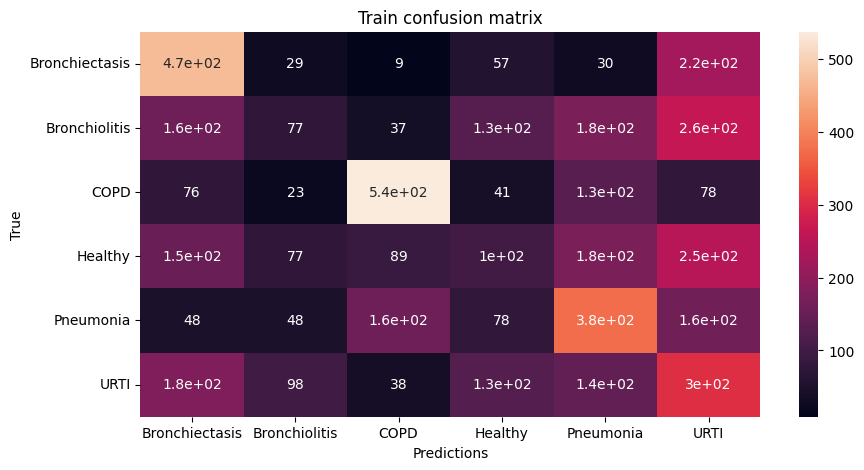

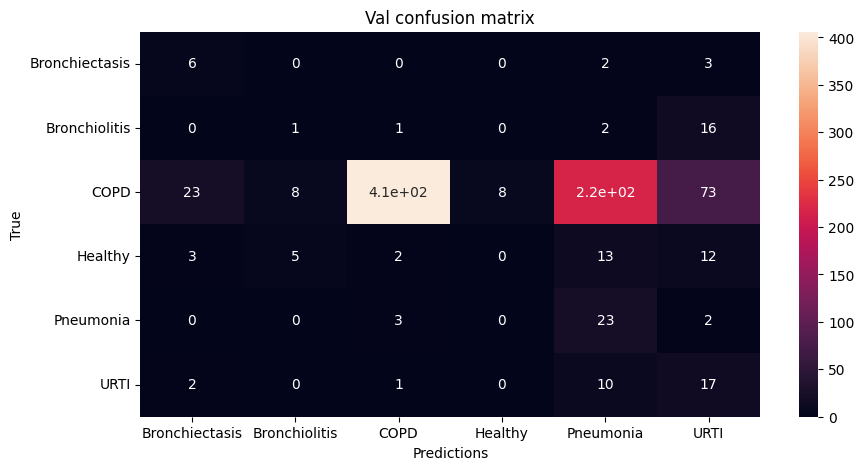


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 3:

Train Accuracy: 0.4788276397515528

Train Loss: 1.315980447005041

Train F1 Score: 0.4251404810025825

Val Accuracy: 0.5870726495726496
\Val Loss: 1.2402543778772708

Val F1 Score: 0.2575308492890111




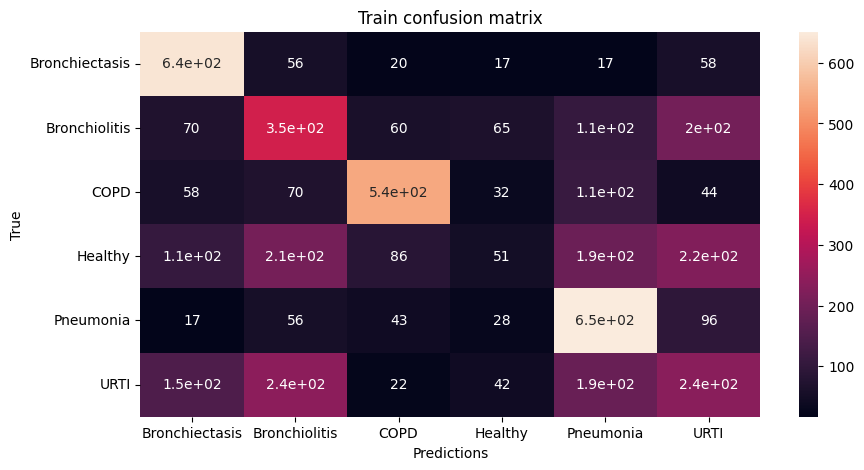

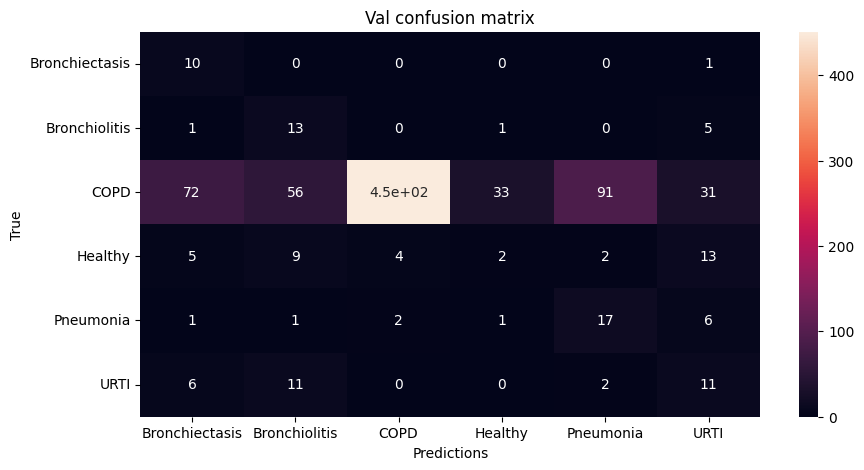


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 4:

Train Accuracy: 0.5046428571428572

Train Loss: 1.2301687975847944

Train F1 Score: 0.4472126575730602

Val Accuracy: 0.6766381766381767
\Val Loss: 0.9533272054460313

Val F1 Score: 0.294580947469782




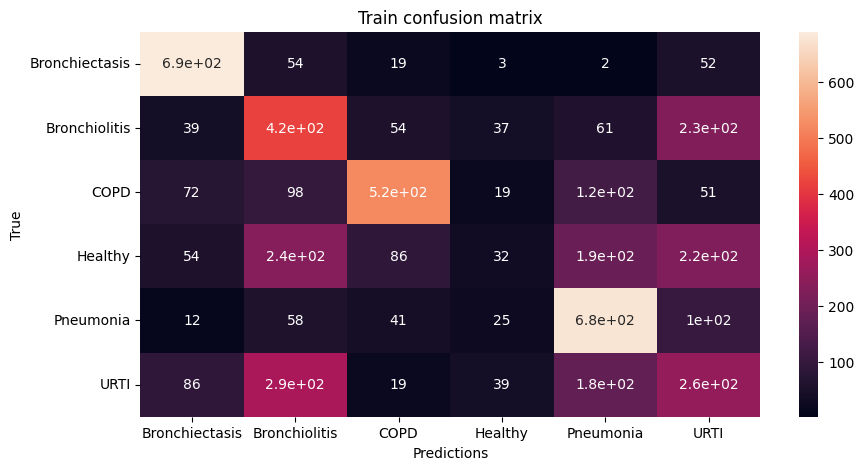

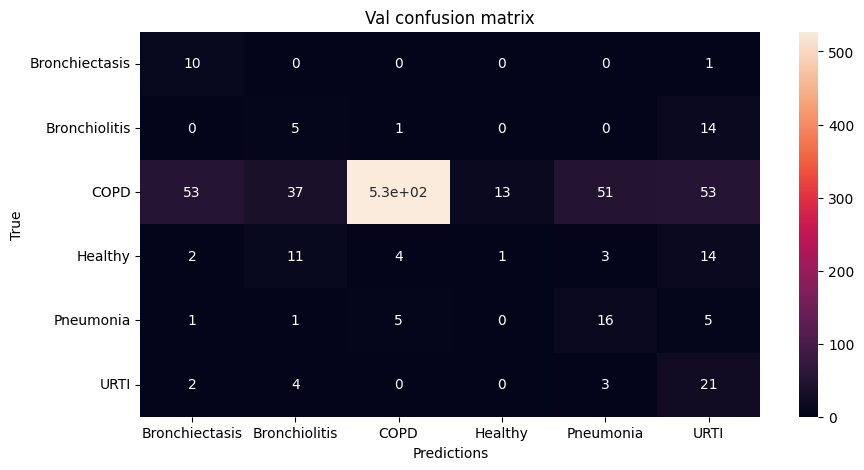


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 5:

Train Accuracy: 0.5354503105590062

Train Loss: 1.1322117355299293

Train F1 Score: 0.4947869857275708

Val Accuracy: 0.5603632478632479
\Val Loss: 1.226872691401729

Val F1 Score: 0.25550494618989805




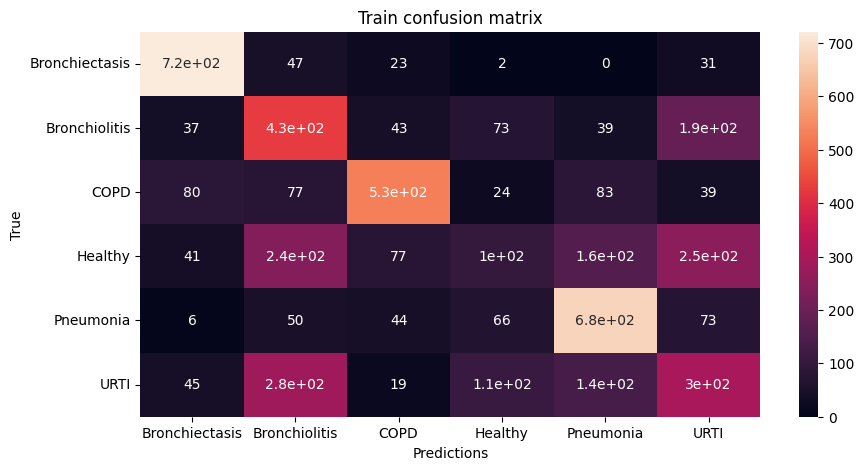

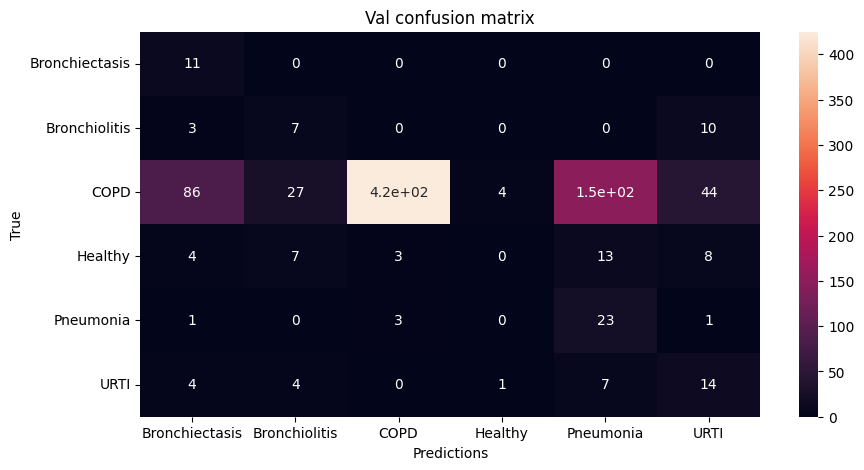


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 6:

Train Accuracy: 0.5816459627329192

Train Loss: 1.0284182836550364

Train F1 Score: 0.5551946165028566

Val Accuracy: 0.7470619658119658
\Val Loss: 0.6405188915906129

Val F1 Score: 0.31117449756021853




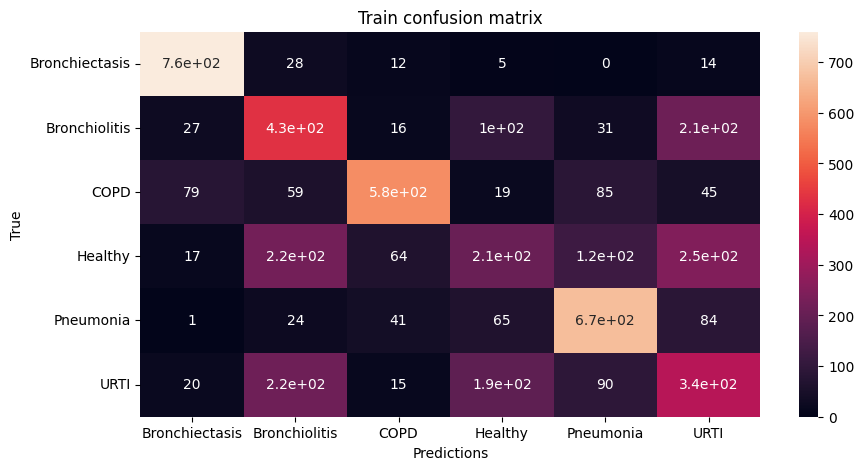

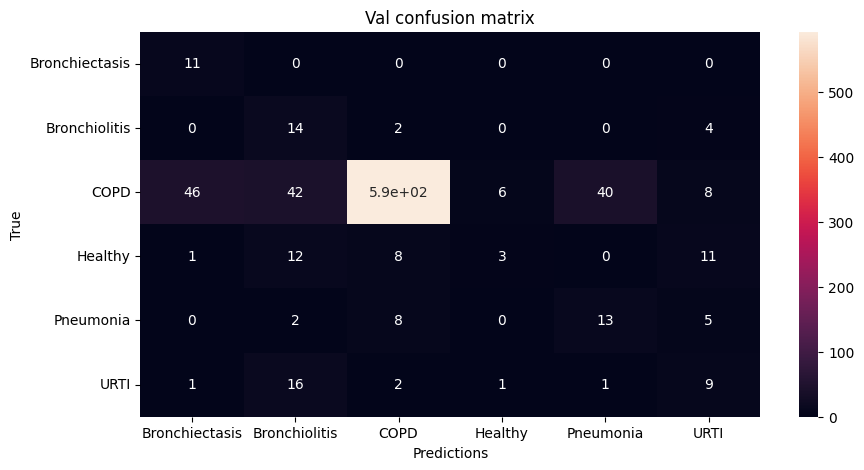


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 7:

Train Accuracy: 0.5934006211180124

Train Loss: 0.9910785174517898

Train F1 Score: 0.5708001202307873

Val Accuracy: 0.6920405982905983
\Val Loss: 0.8074623456707707

Val F1 Score: 0.3444419900576274




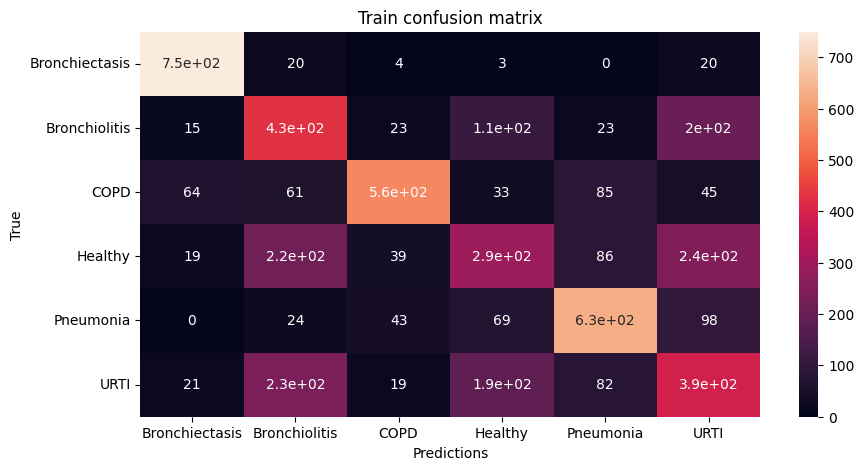

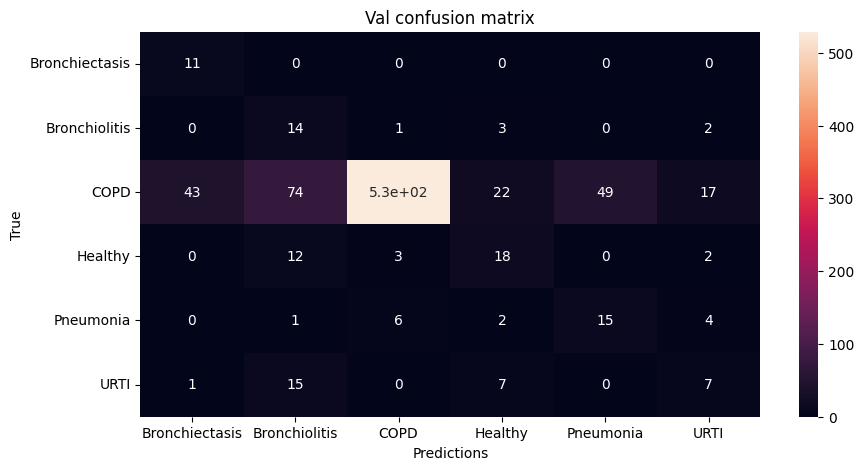


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 8:

Train Accuracy: 0.6250931677018634

Train Loss: 0.9374210419862167

Train F1 Score: 0.5910087797952734

Val Accuracy: 0.6810007122507122
\Val Loss: 0.6736075072376816

Val F1 Score: 0.33262960226447497




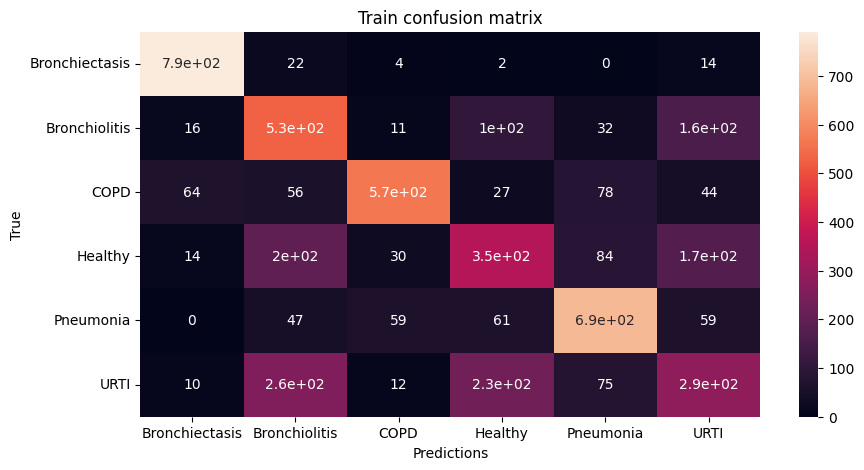

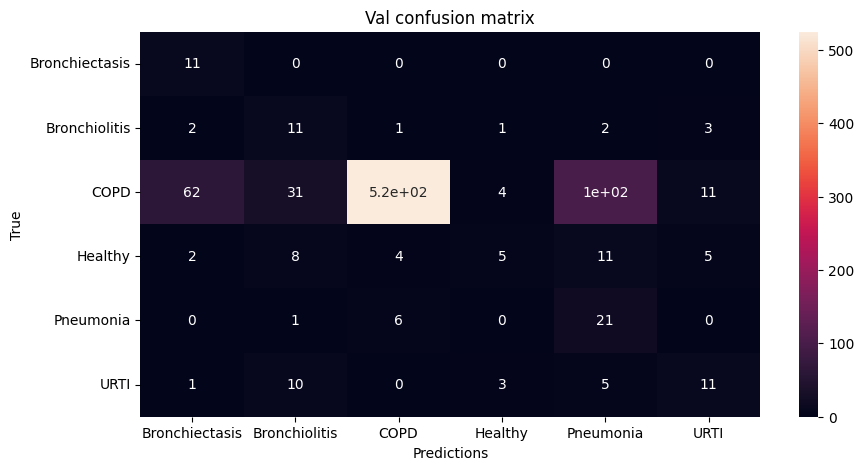


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 9:

Train Accuracy: 0.6581133540372671

Train Loss: 0.8474309044595091

Train F1 Score: 0.6325755306282399

Val Accuracy: 0.7435007122507122
\Val Loss: 0.6496575629269635

Val F1 Score: 0.4000303441727603




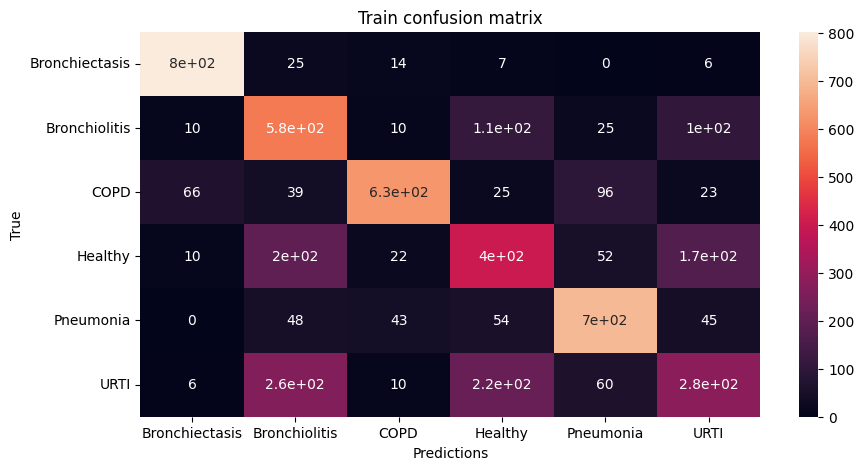

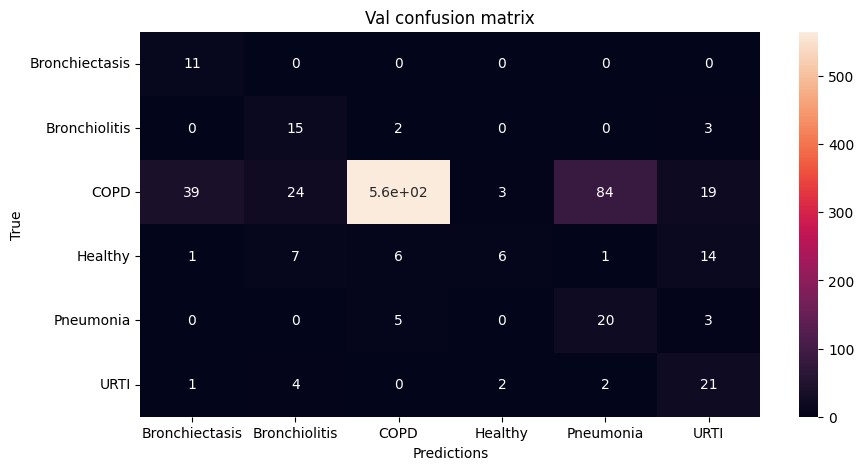


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 10:

Train Accuracy: 0.6620807453416149

Train Loss: 0.8473225010107763

Train F1 Score: 0.632615784310406

Val Accuracy: 0.7063746438746438
\Val Loss: 0.7305253103927329

Val F1 Score: 0.3821409455052129




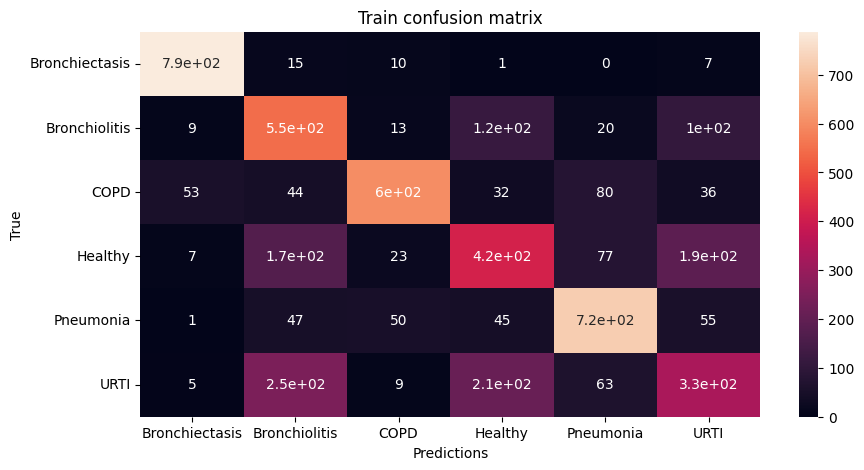

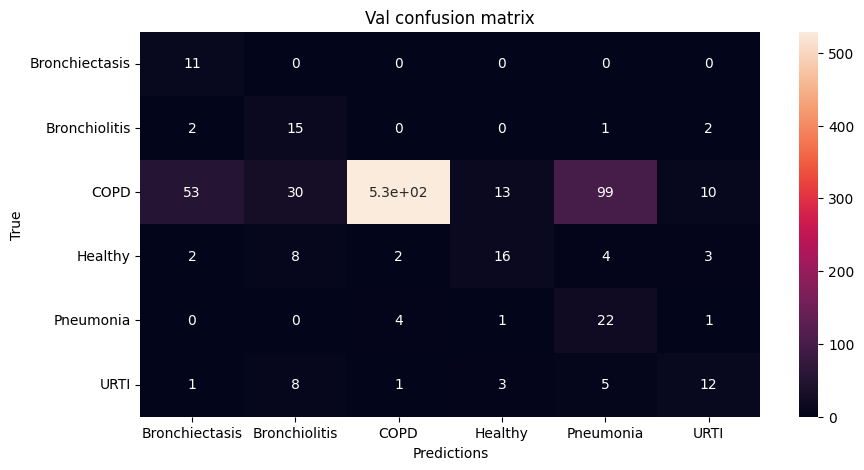


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 11:

Train Accuracy: 0.6854813664596273

Train Loss: 0.7917264187187882

Train F1 Score: 0.6622418640933422

Val Accuracy: 0.670940170940171
\Val Loss: 0.8924815147011368

Val F1 Score: 0.35256692711953763




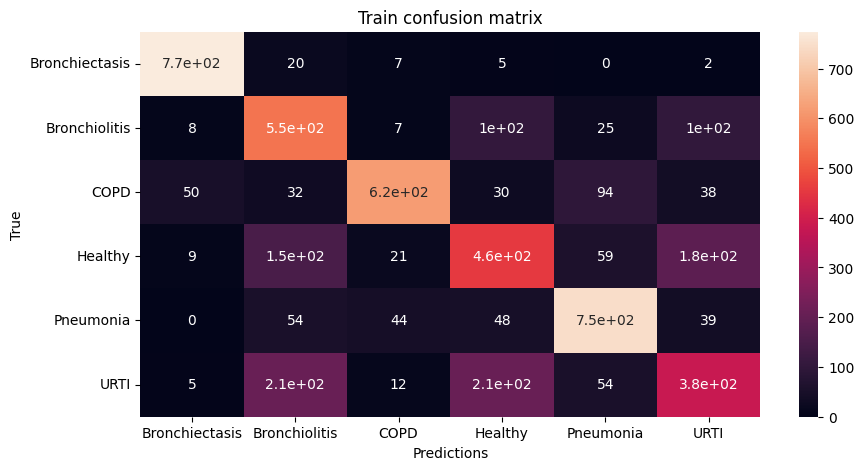

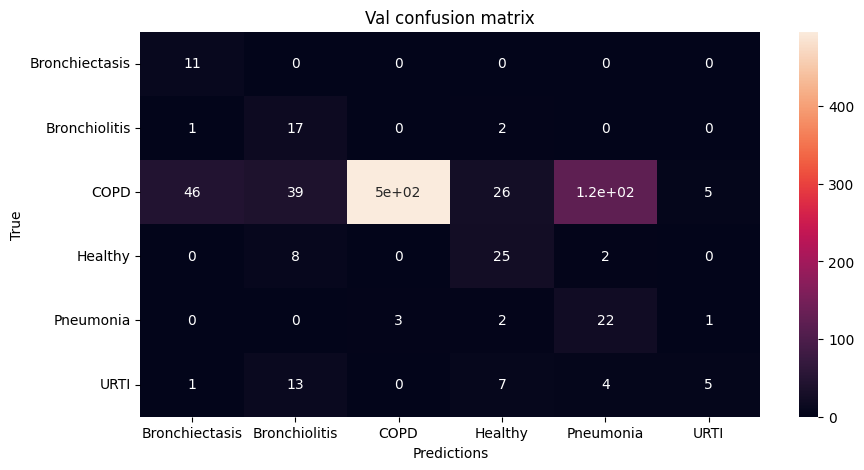


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 12:

Train Accuracy: 0.7128804347826088

Train Loss: 0.7379819373166339

Train F1 Score: 0.6835281532373487

Val Accuracy: 0.7880163817663818
\Val Loss: 0.558108267960725

Val F1 Score: 0.454779005712933




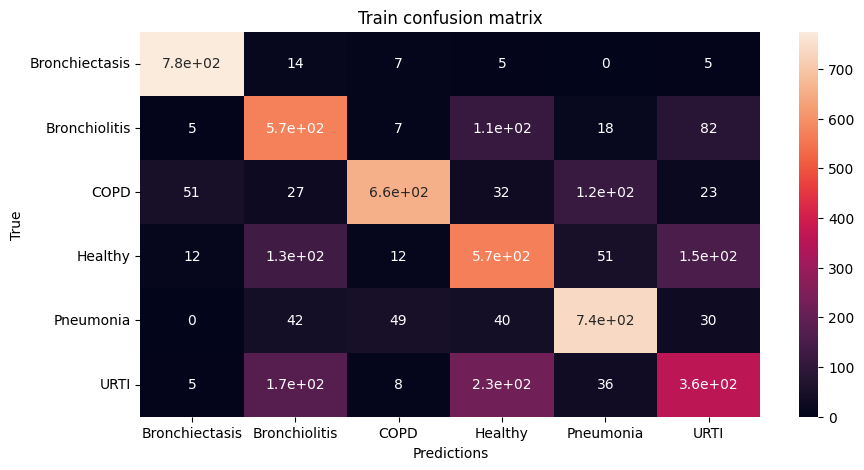

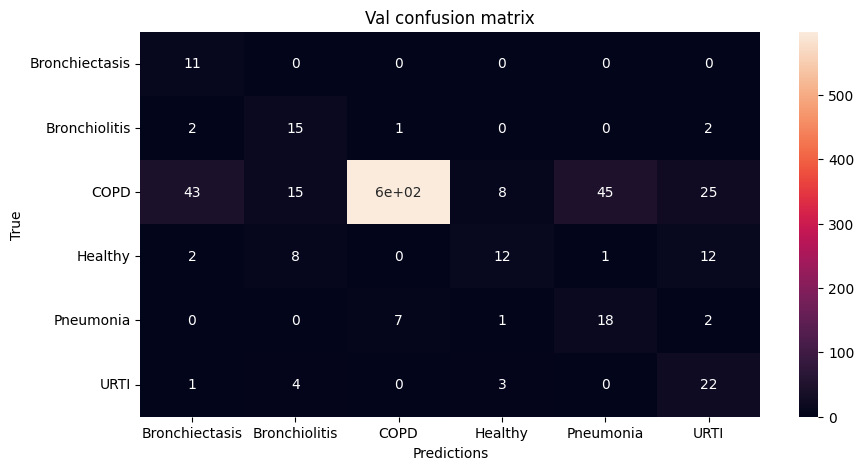


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 13:

Train Accuracy: 0.7216459627329193

Train Loss: 0.6970073371570303

Train F1 Score: 0.6995082082955734

Val Accuracy: 0.7839209401709402
\Val Loss: 0.5154277218712701

Val F1 Score: 0.5103610858873084




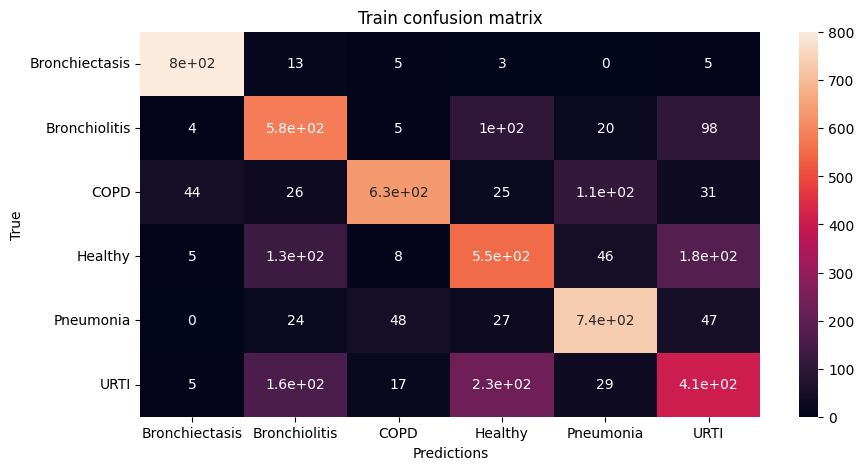

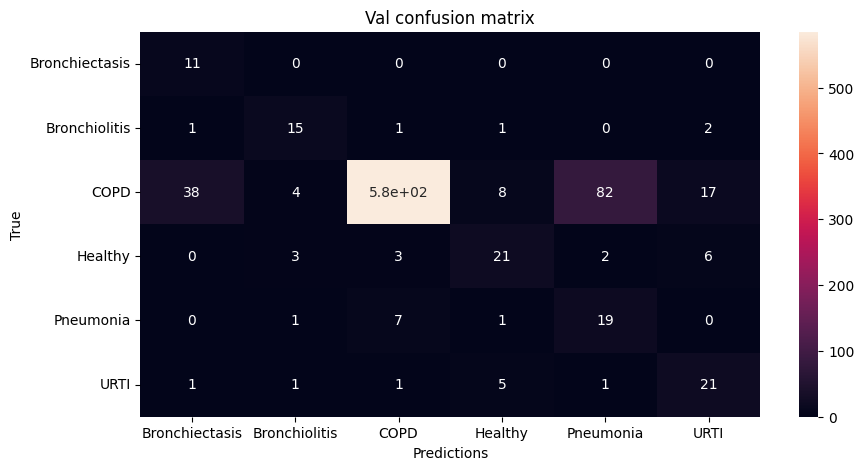


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 14:

Train Accuracy: 0.7342313664596274

Train Loss: 0.6782222577133534

Train F1 Score: 0.710417150895788

Val Accuracy: 0.753650284900285
\Val Loss: 0.6834191105983876

Val F1 Score: 0.4734779508025558




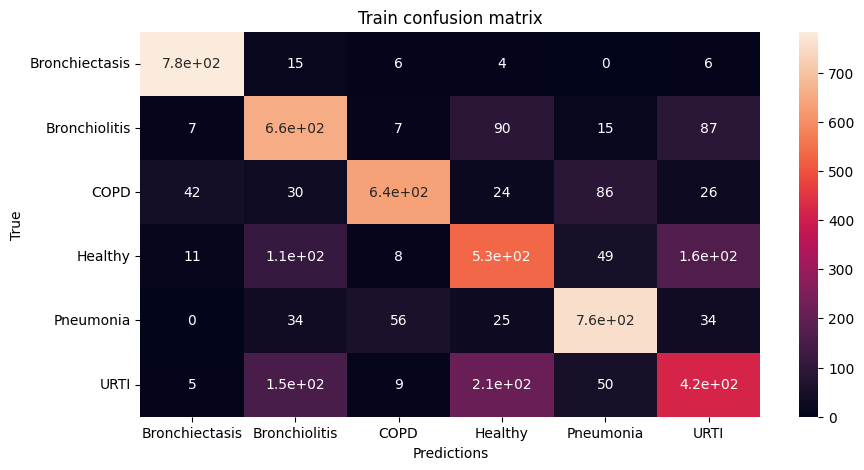

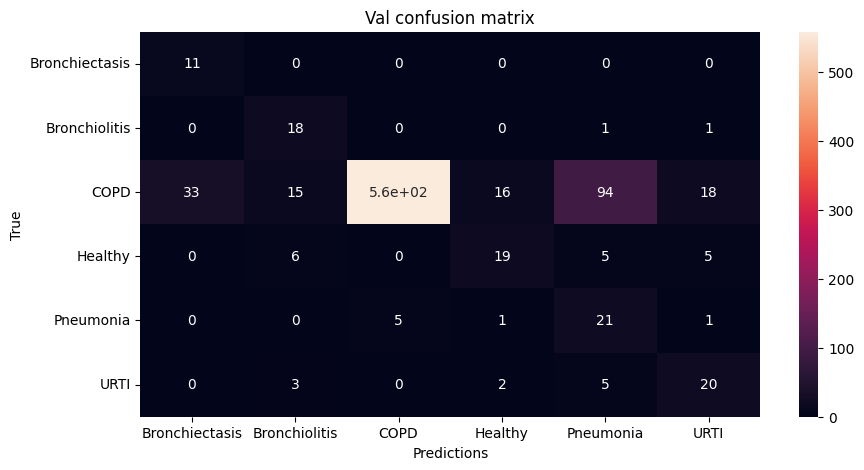


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 15:

Train Accuracy: 0.752445652173913

Train Loss: 0.6418278767085224

Train F1 Score: 0.7301685891536452

Val Accuracy: 0.7319266381766382
\Val Loss: 0.6789648996459113

Val F1 Score: 0.42256746137583695




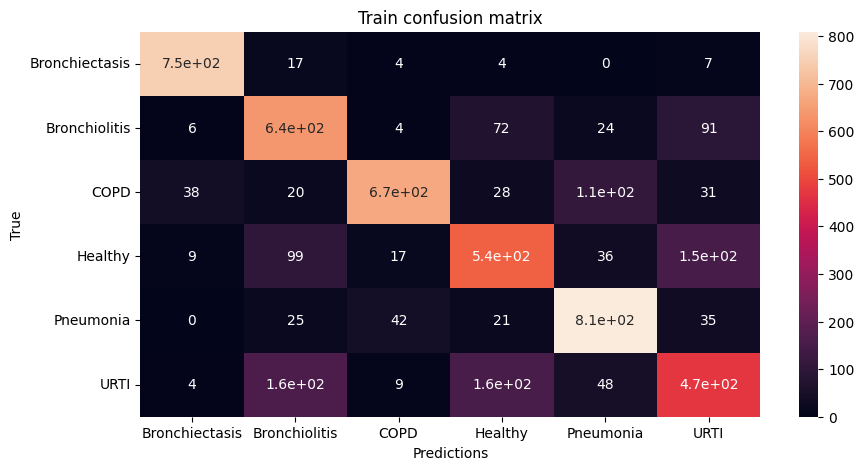

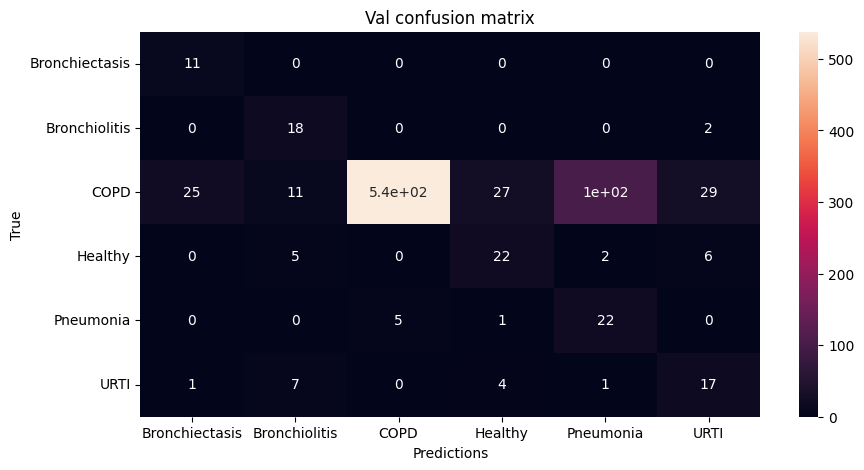


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 16:

Train Accuracy: 0.7651164596273292

Train Loss: 0.6161544226711582

Train F1 Score: 0.7441031858787773

Val Accuracy: 0.7526709401709402
\Val Loss: 0.7093172128553744

Val F1 Score: 0.4266530617519661




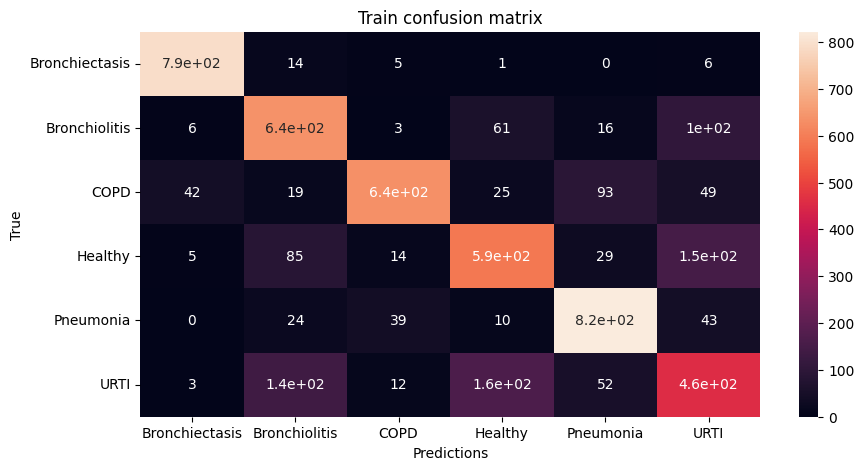

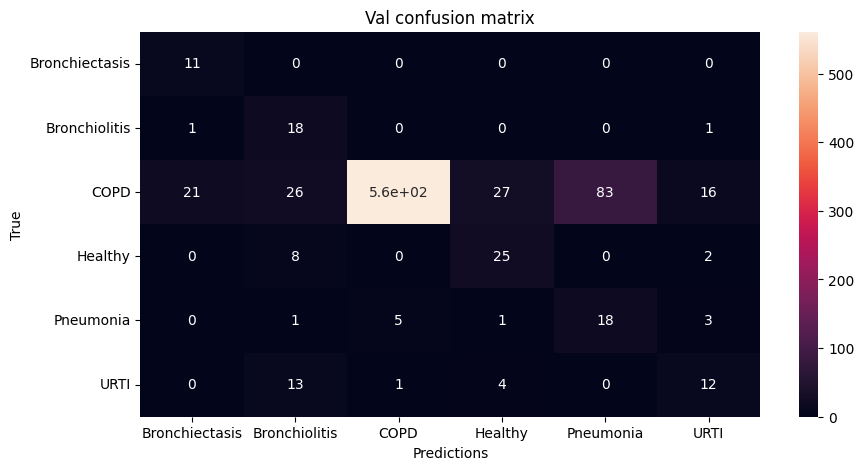


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 17:

Train Accuracy: 0.7774534161490684

Train Loss: 0.587457820680571

Train F1 Score: 0.7496181661668031

Val Accuracy: 0.7537393162393163
\Val Loss: 0.5794530742698245

Val F1 Score: 0.4935322453578313




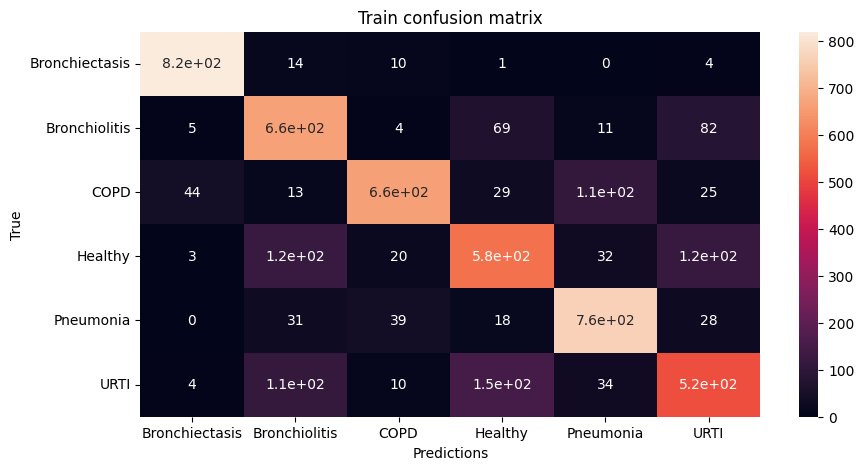

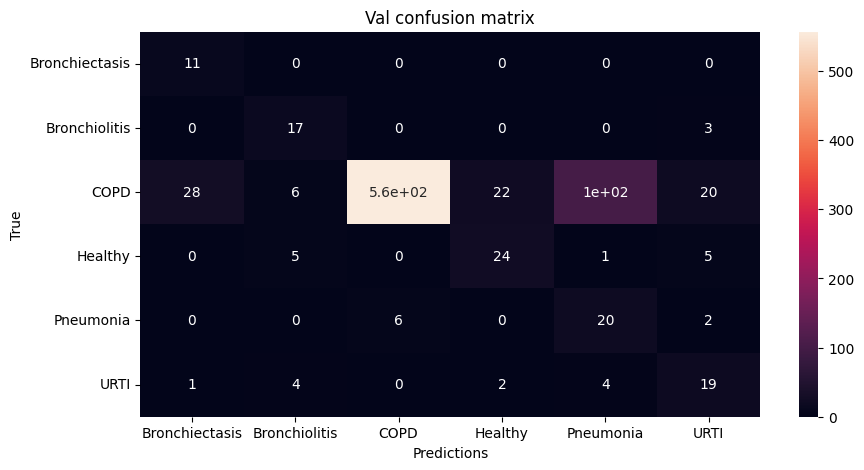


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 18:

Train Accuracy: 0.796863354037267

Train Loss: 0.5290896324267299

Train F1 Score: 0.7824310279040603

Val Accuracy: 0.7949608262108262
\Val Loss: 0.5206089439215483

Val F1 Score: 0.48008045112645187




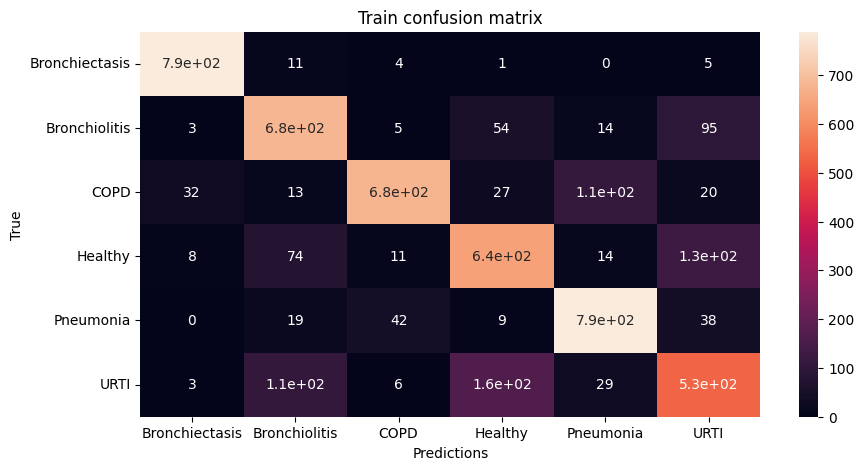

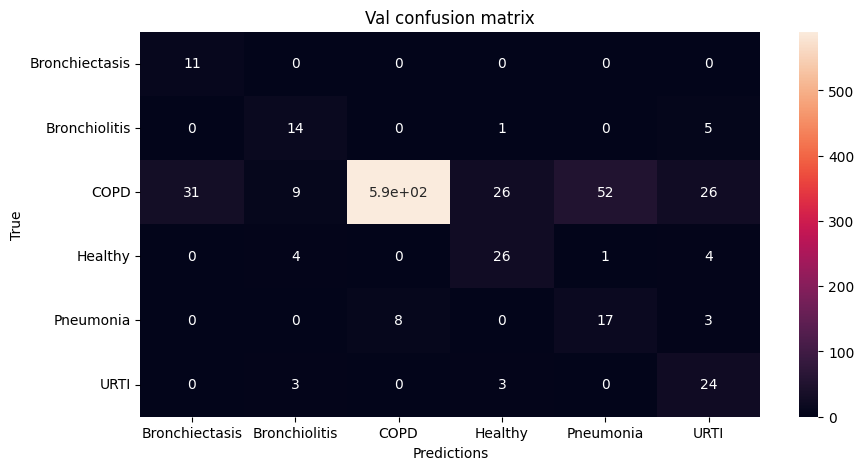


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 19:

Train Accuracy: 0.785582298136646

Train Loss: 0.554779917557047

Train F1 Score: 0.7672013396061725

Val Accuracy: 0.8076923076923076
\Val Loss: 0.5567085163460838

Val F1 Score: 0.5151502854294248




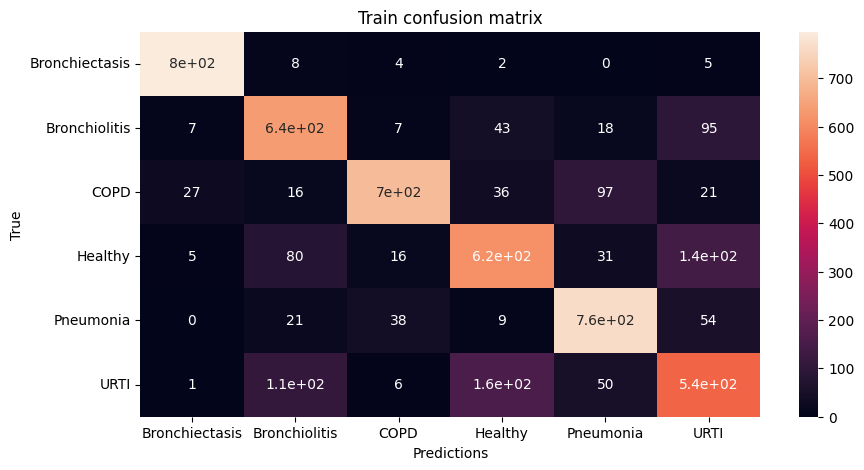

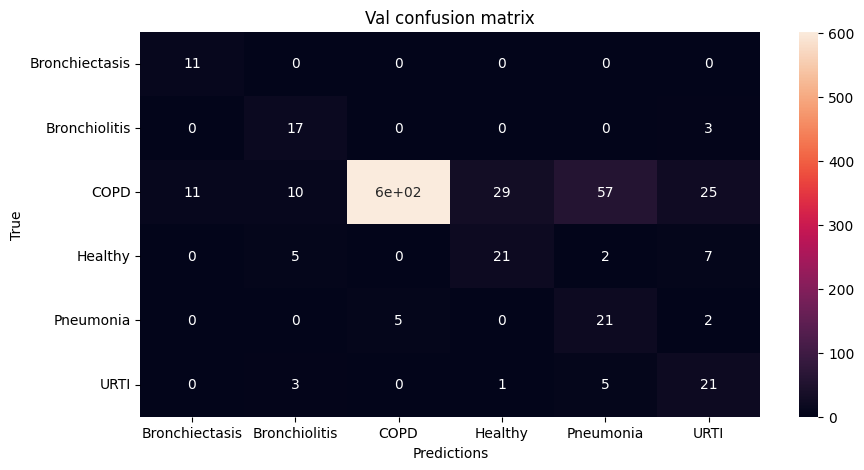


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 20:

Train Accuracy: 0.8210170807453416

Train Loss: 0.477530654450381

Train F1 Score: 0.8054766203305737

Val Accuracy: 0.8236289173789174
\Val Loss: 0.45405729446146226

Val F1 Score: 0.5409208839690244




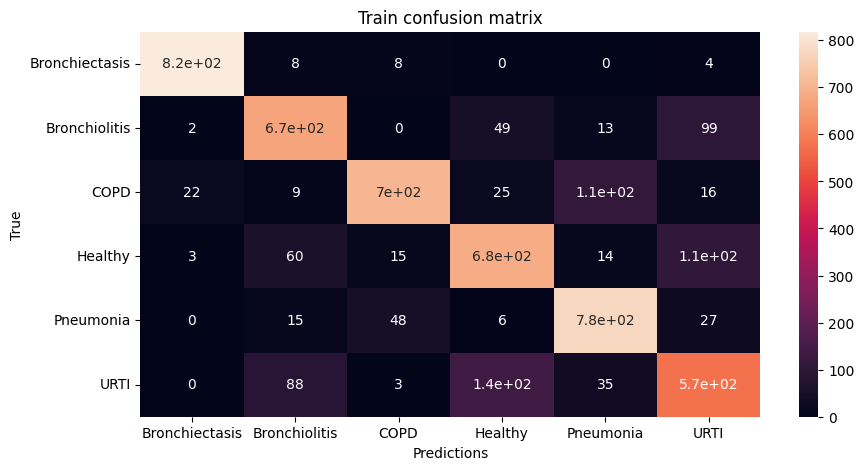

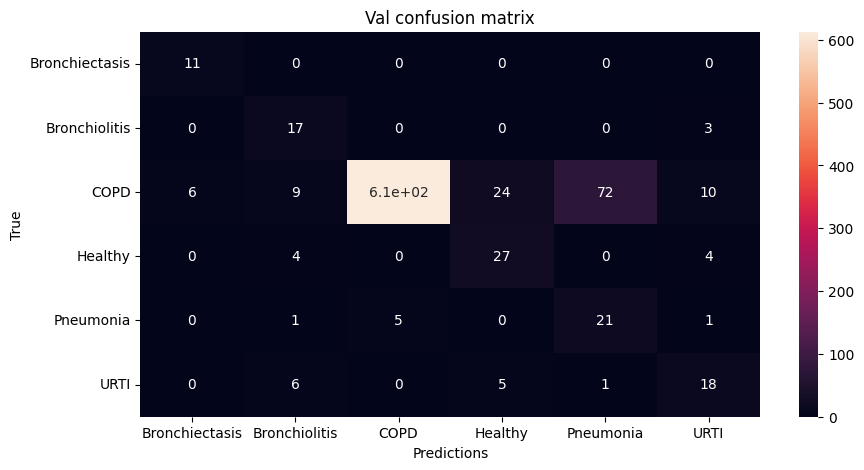


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 21:

Train Accuracy: 0.8079658385093168

Train Loss: 0.4984872586423566

Train F1 Score: 0.7934535018035344

Val Accuracy: 0.7946937321937322
\Val Loss: 0.5225288923139926

Val F1 Score: 0.5494800066506421




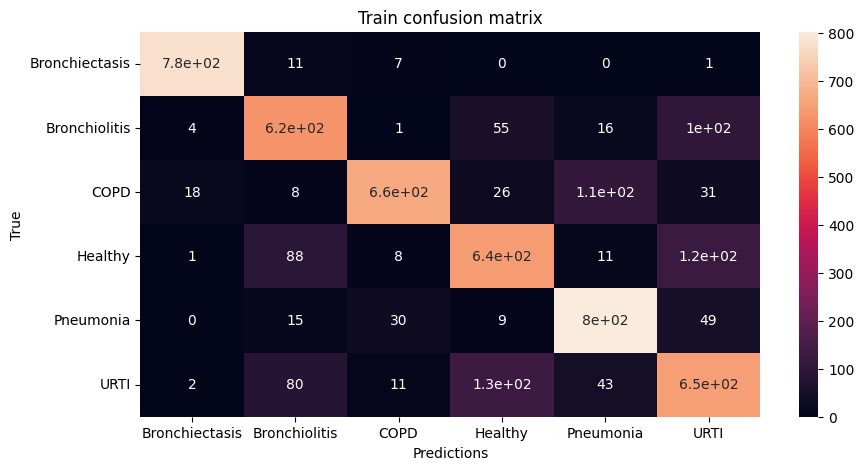

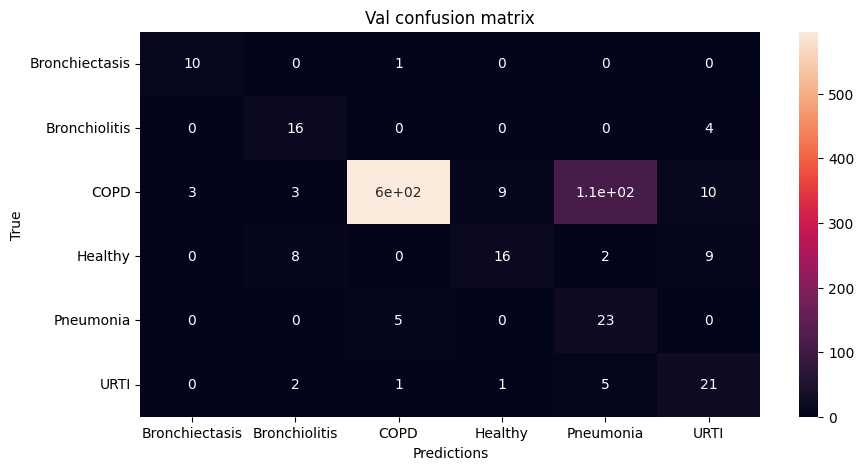


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 22:

Train Accuracy: 0.83

Train Loss: 0.4626808592251369

Train F1 Score: 0.815676404452472

Val Accuracy: 0.8246972934472935
\Val Loss: 0.5301662059845748

Val F1 Score: 0.5344093640645345




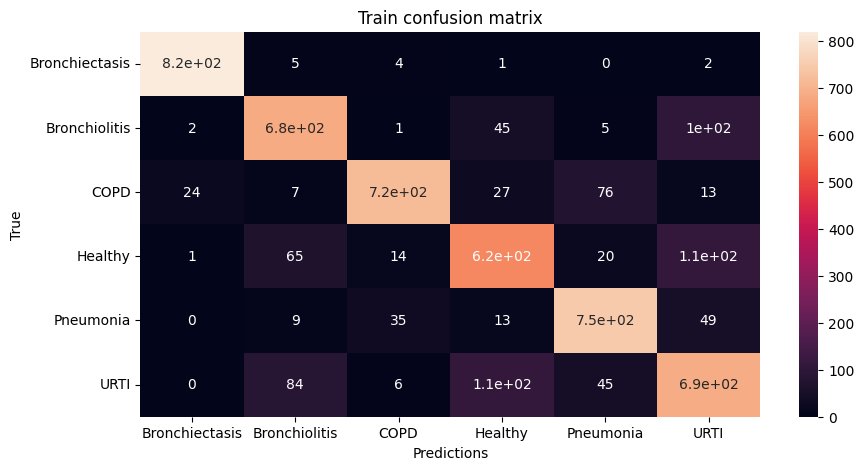

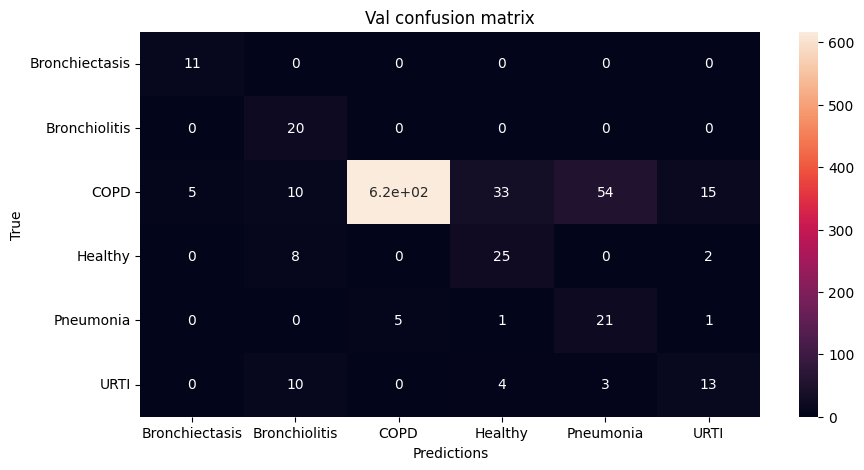


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 23:

Train Accuracy: 0.8257298136645962

Train Loss: 0.4786720750679881

Train F1 Score: 0.8113017837453332

Val Accuracy: 0.8776709401709402
\Val Loss: 0.4070886759846299

Val F1 Score: 0.6220437188943228




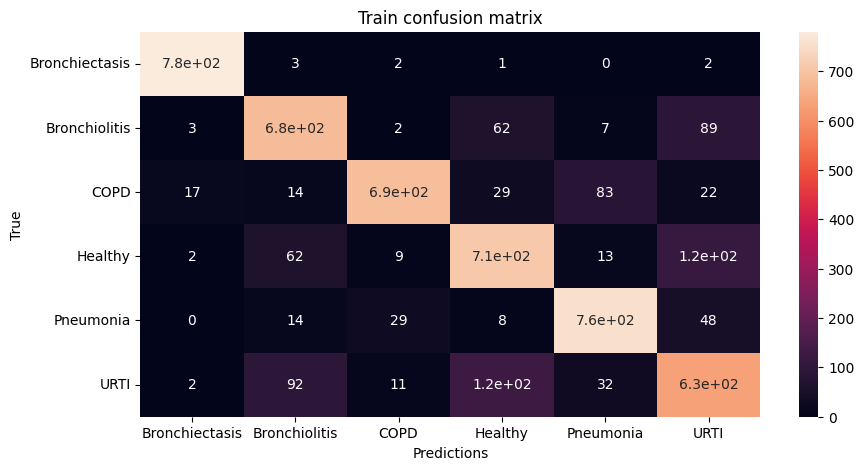

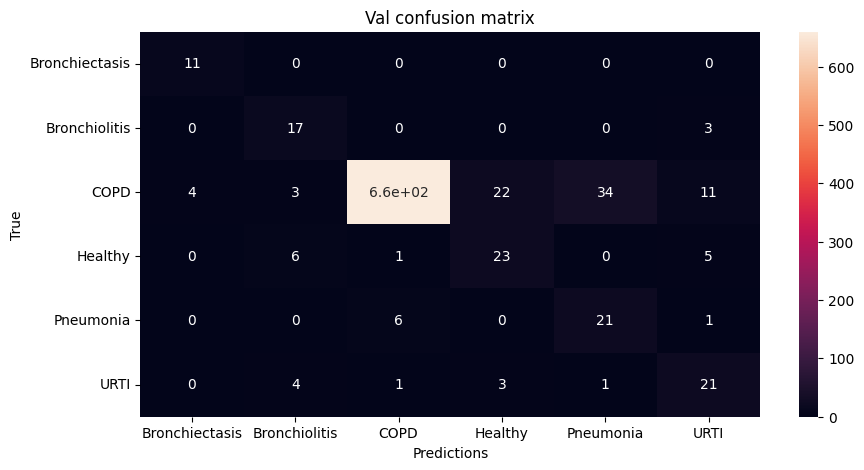


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 24:

Train Accuracy: 0.8459704968944098

Train Loss: 0.42662706332547323

Train F1 Score: 0.8350652293388888

Val Accuracy: 0.8598646723646723
\Val Loss: 0.4300175612723386

Val F1 Score: 0.6455971245412473




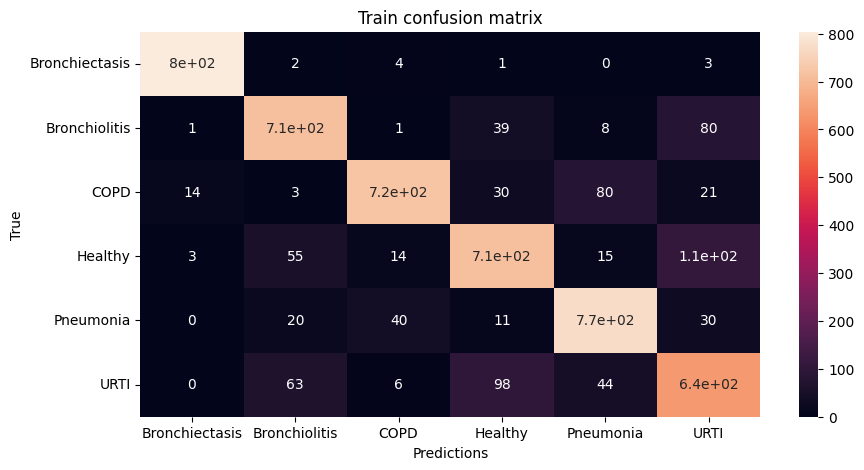

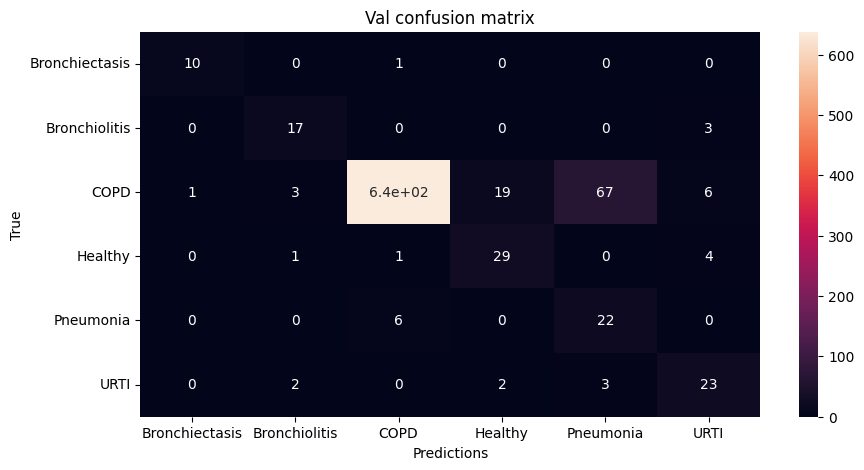


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 25:

Train Accuracy: 0.8589751552795031

Train Loss: 0.37173069180538937

Train F1 Score: 0.8452252756734813

Val Accuracy: 0.8631588319088318
\Val Loss: 0.43029897273690615

Val F1 Score: 0.6050869243012534




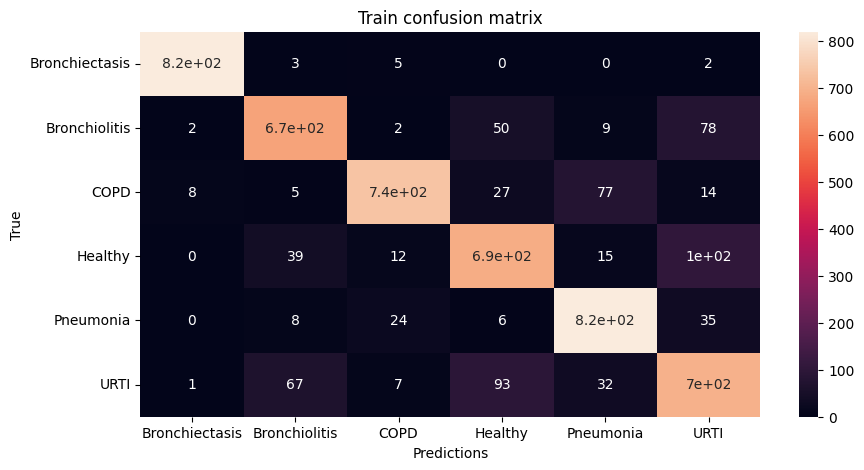

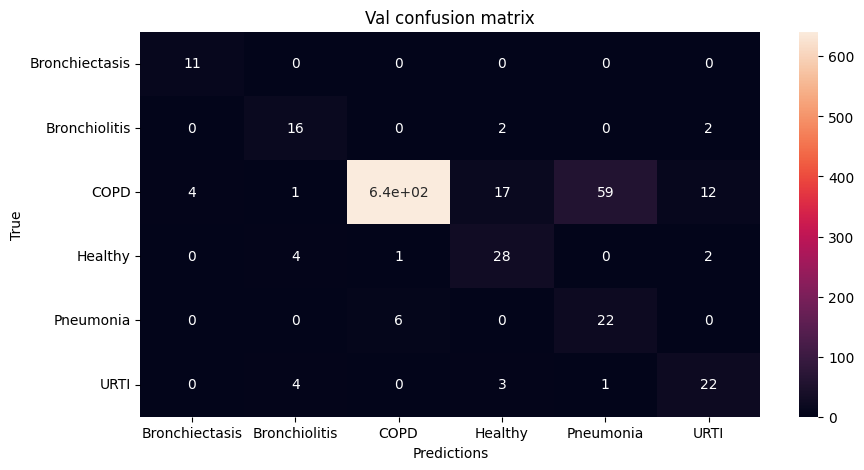


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 26:

Train Accuracy: 0.8552329192546584

Train Loss: 0.39522002827121605

Train F1 Score: 0.842469752945515

Val Accuracy: 0.8897792022792023
\Val Loss: 0.3826488446858194

Val F1 Score: 0.6692020297050476




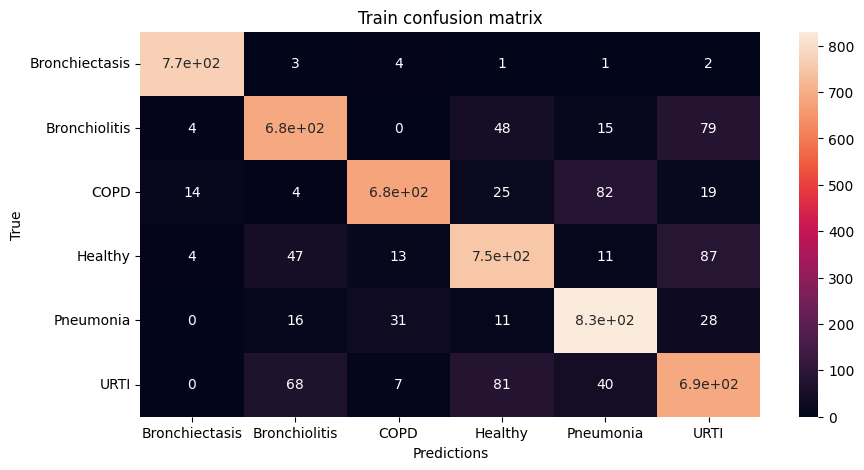

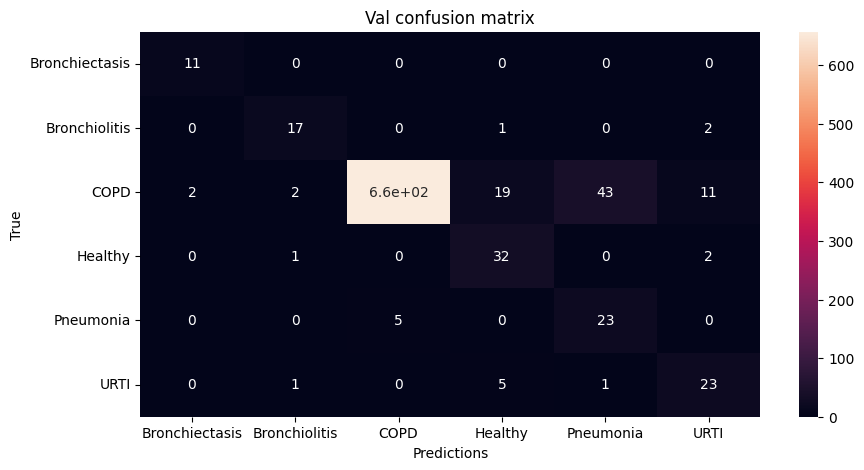


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 27:

Train Accuracy: 0.8616925465838509

Train Loss: 0.3778952536005411

Train F1 Score: 0.8501287136018646

Val Accuracy: 0.8782941595441595
\Val Loss: 0.3805323599113358

Val F1 Score: 0.5936780682316533




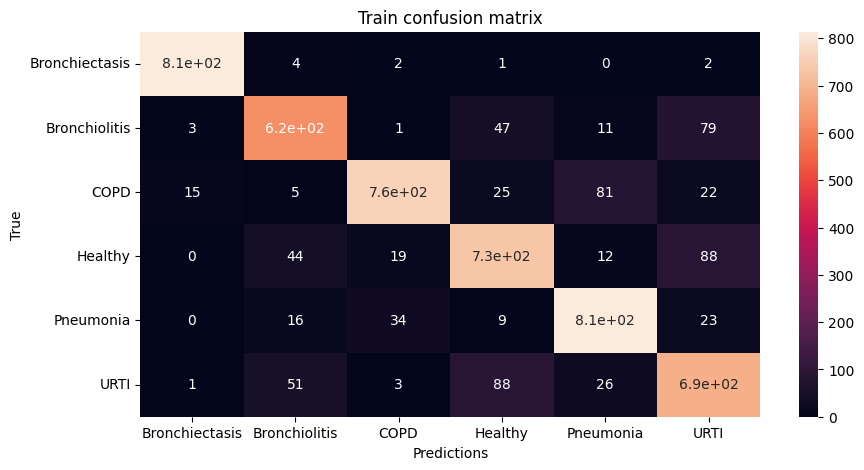

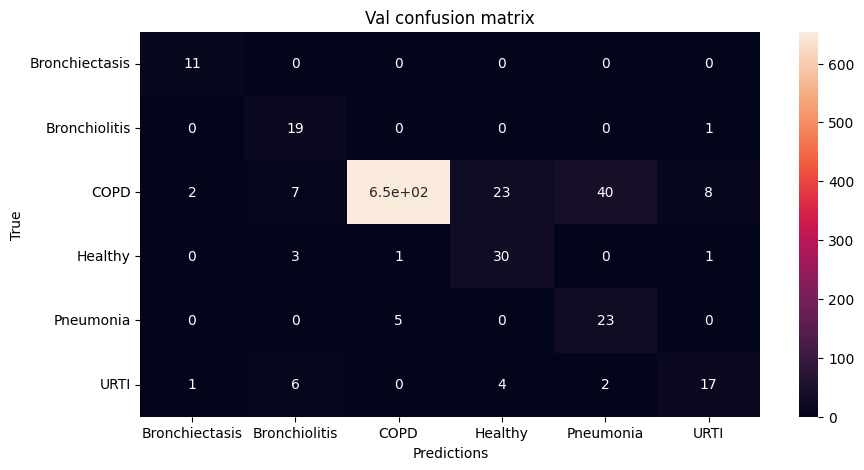


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 28:

Train Accuracy: 0.8741459627329193

Train Loss: 0.3471185957885677

Train F1 Score: 0.8594114406508688

Val Accuracy: 0.8898682336182335
\Val Loss: 0.35962050518503896

Val F1 Score: 0.665225632764675




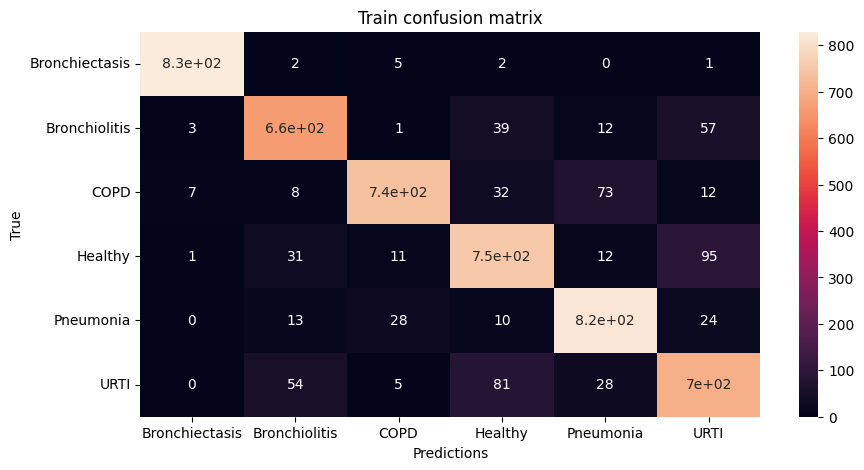

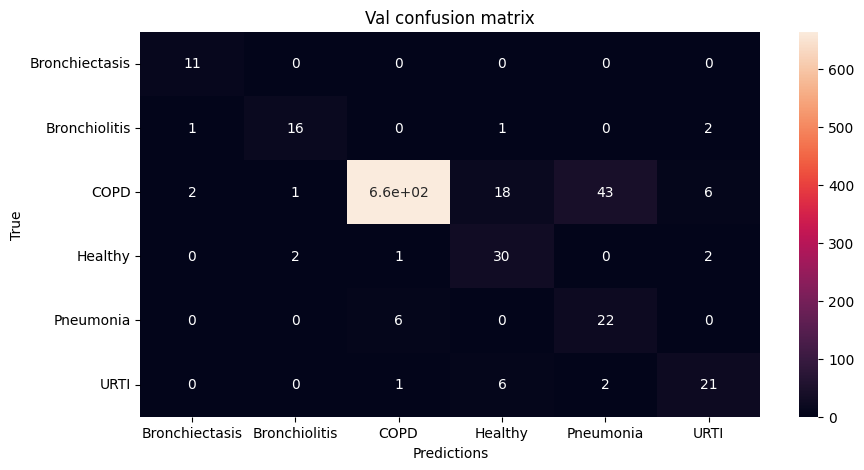


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 29:

Train Accuracy: 0.8684860248447204

Train Loss: 0.368634046466084

Train F1 Score: 0.8585640965781597

Val Accuracy: 0.8887108262108262
\Val Loss: 0.354553387120918

Val F1 Score: 0.6290138109966561




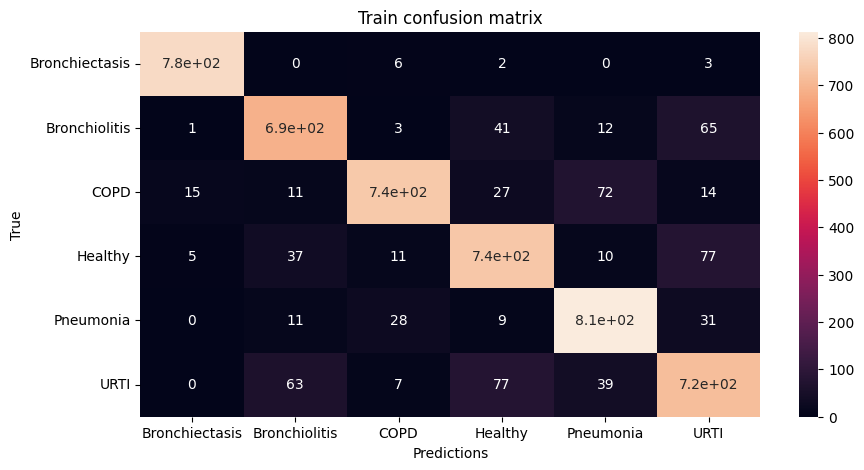

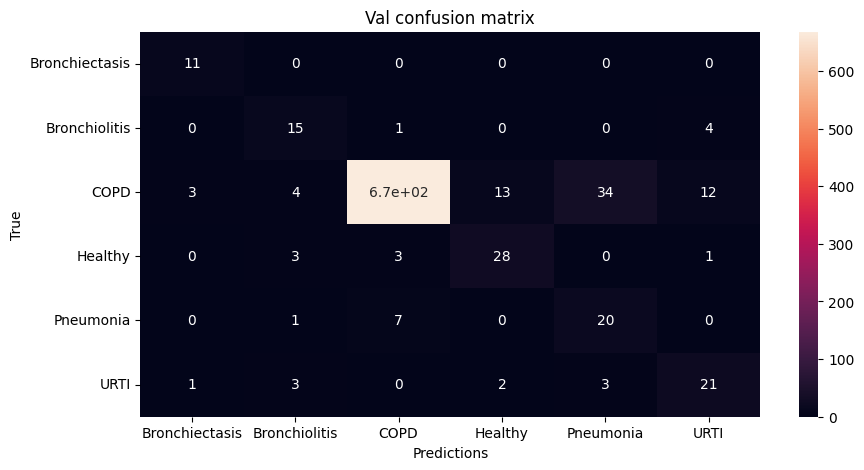


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 30:

Train Accuracy: 0.8644953416149068

Train Loss: 0.37839648872613907

Train F1 Score: 0.8536946621740827

Val Accuracy: 0.8704594017094017
\Val Loss: 0.4069627255753235

Val F1 Score: 0.6476947941161968




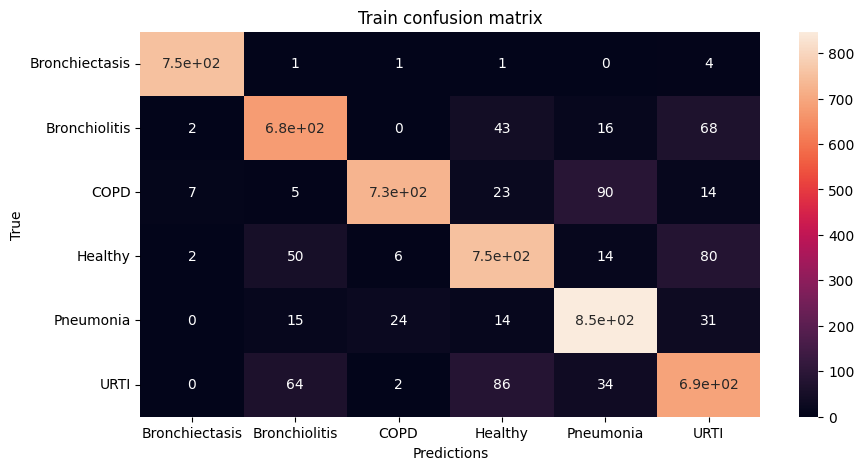

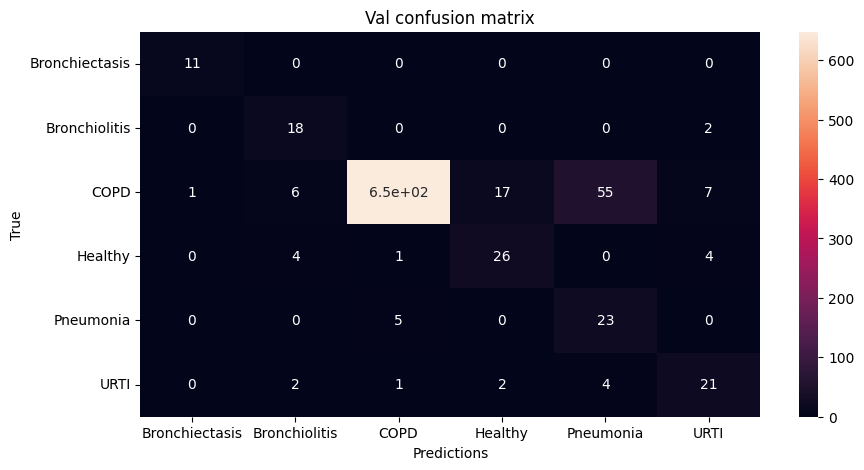


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 31:

Train Accuracy: 0.8740605590062112

Train Loss: 0.3565927202472035

Train F1 Score: 0.8641637397108611

Val Accuracy: 0.8816773504273504
\Val Loss: 0.35879724859087553

Val F1 Score: 0.6463886951958692




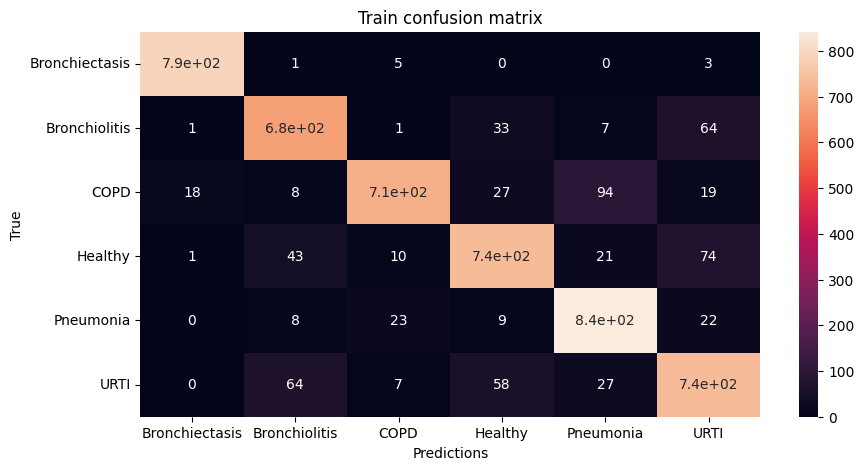

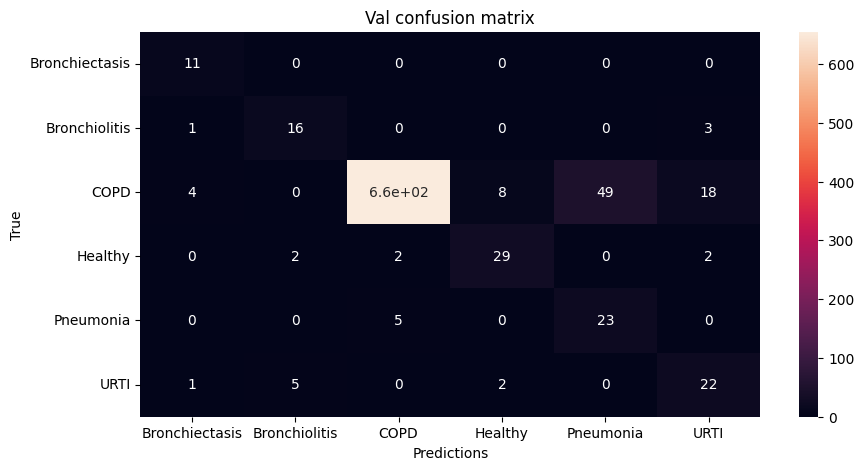


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 32:

Train Accuracy: 0.893082298136646

Train Loss: 0.31219118449443617

Train F1 Score: 0.8852749559449853

Val Accuracy: 0.79122150997151
\Val Loss: 0.5215112771149035

Val F1 Score: 0.5958944150695095




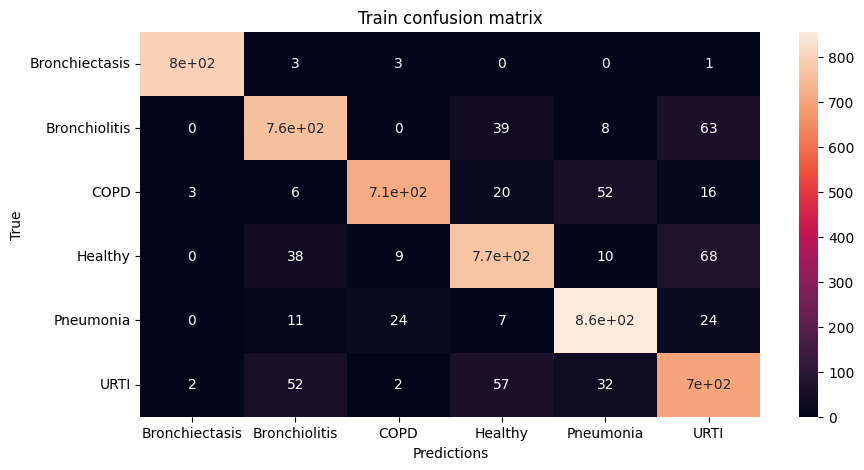

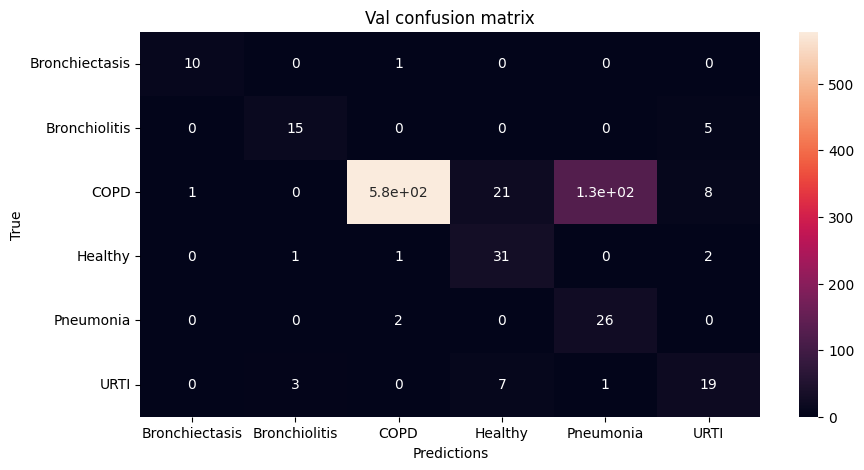


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 33:

Train Accuracy: 0.8966304347826086

Train Loss: 0.2987428973457828

Train F1 Score: 0.8839746410061854

Val Accuracy: 0.892094017094017
\Val Loss: 0.3270011891921361

Val F1 Score: 0.6839268295853226




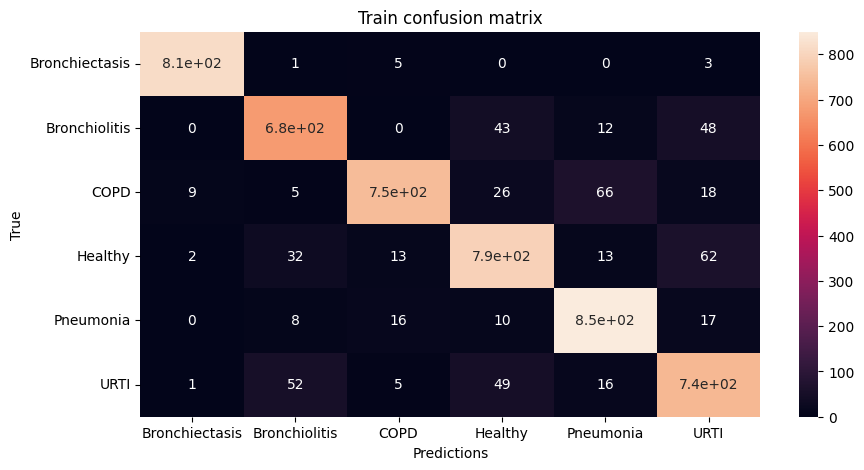

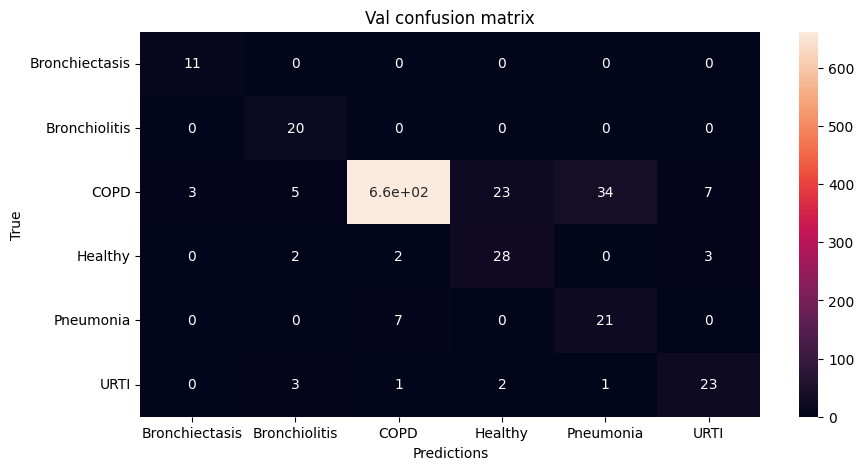


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 34:

Train Accuracy: 0.892414596273292

Train Loss: 0.3096234636925022

Train F1 Score: 0.8816519024209206

Val Accuracy: 0.8447293447293447
\Val Loss: 0.39716273159892473

Val F1 Score: 0.5974294046560923




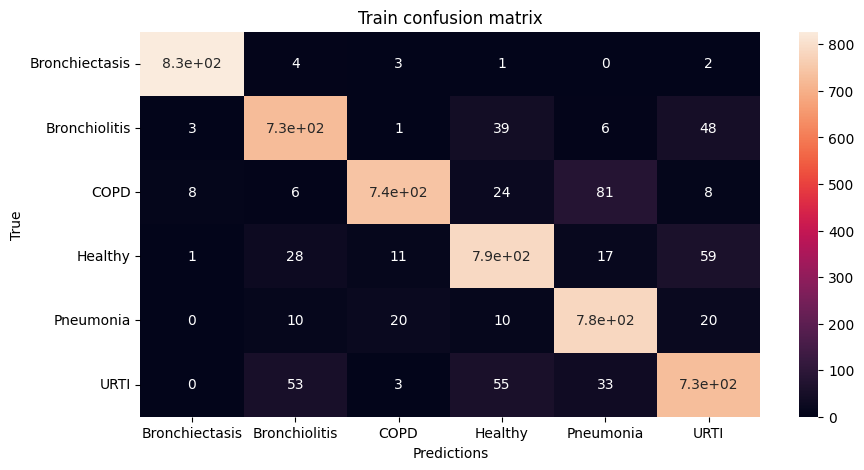

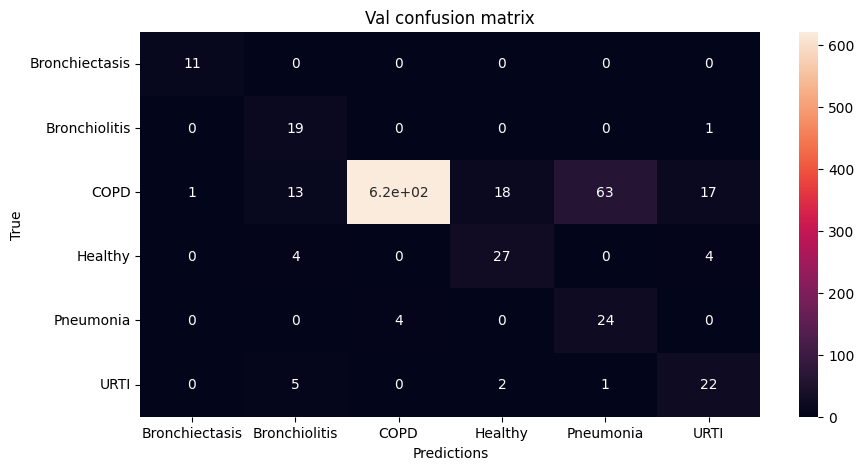


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 35:

Train Accuracy: 0.9199223602484471

Train Loss: 0.24044568690916765

Train F1 Score: 0.9127991932519475

Val Accuracy: 0.8942307692307693
\Val Loss: 0.31159416806918605

Val F1 Score: 0.666646894481447




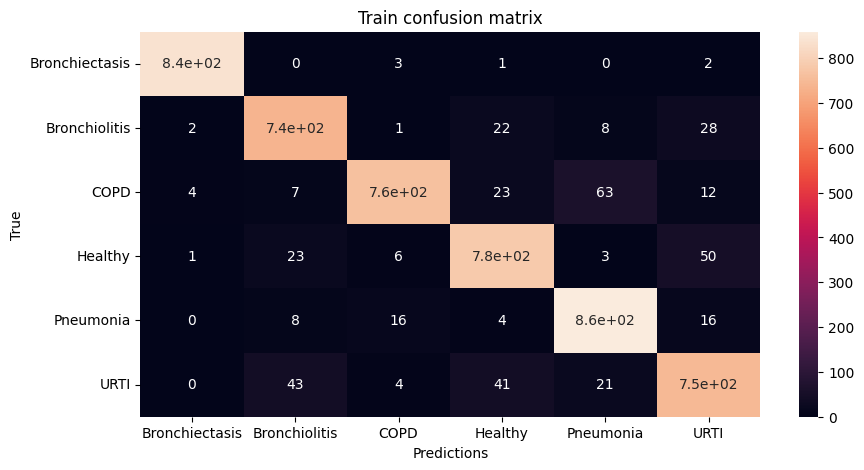

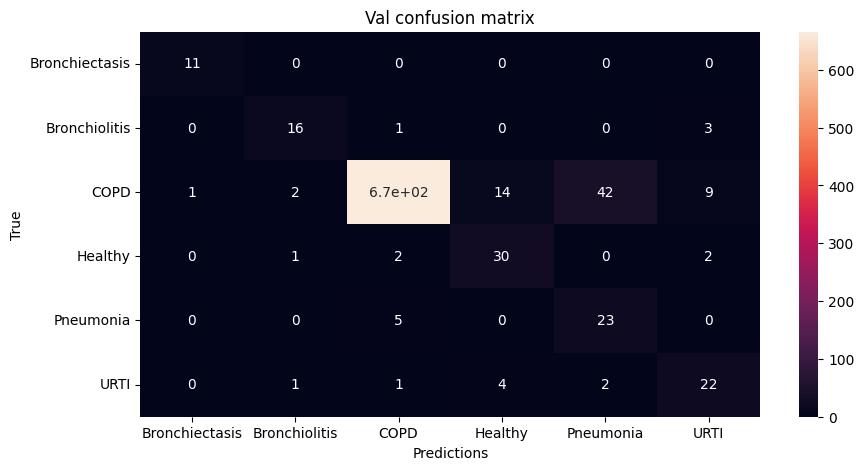


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 36:

Train Accuracy: 0.8999301242236024

Train Loss: 0.294709852520631

Train F1 Score: 0.891778079989534

Val Accuracy: 0.8863960113960113
\Val Loss: 0.37061108345234833

Val F1 Score: 0.6708740018032215




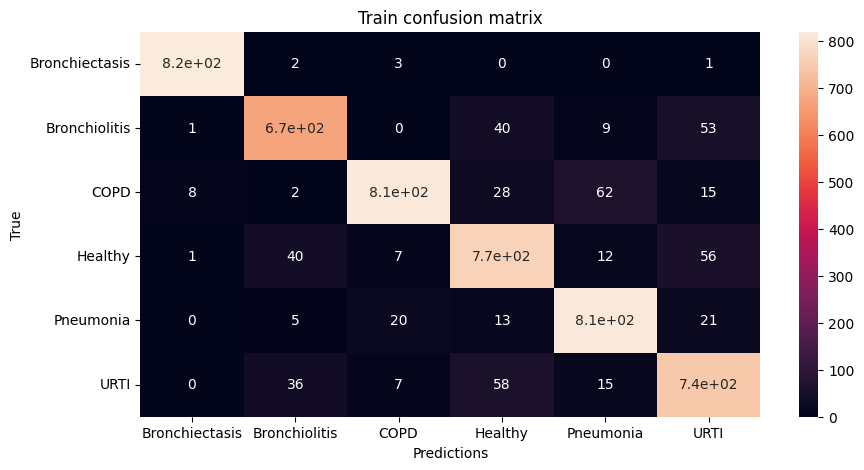

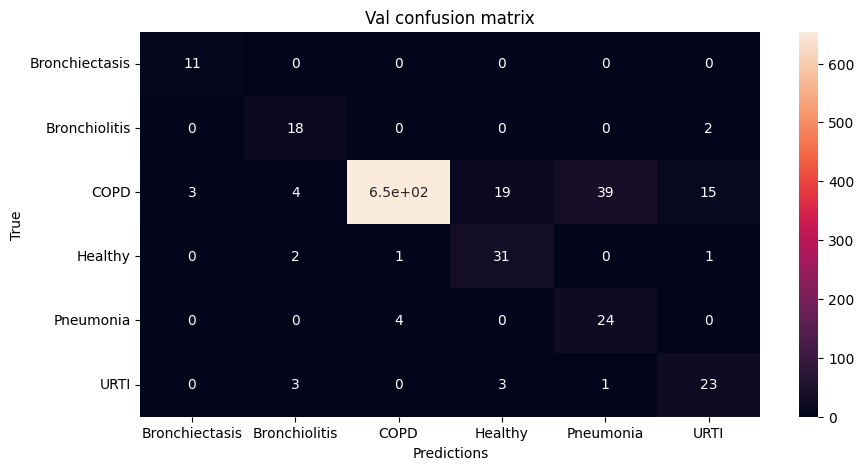


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 37:

Train Accuracy: 0.9080279503105589

Train Loss: 0.26436543691417447

Train F1 Score: 0.8990905251562226

Val Accuracy: 0.8721509971509972
\Val Loss: 0.3933811888650612

Val F1 Score: 0.6525269095544461




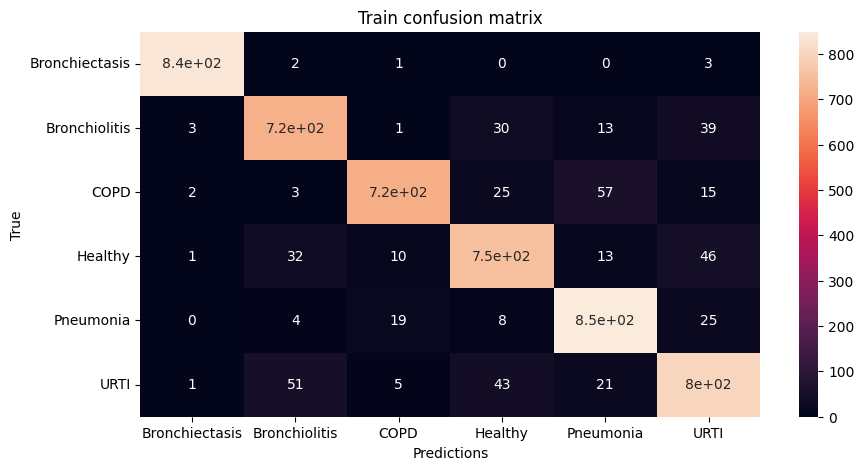

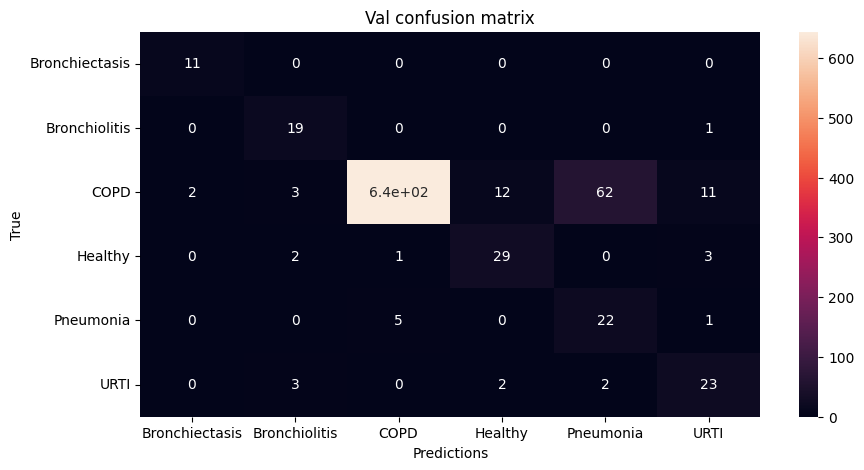


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 38:

Train Accuracy: 0.9130745341614906

Train Loss: 0.2639633788501624

Train F1 Score: 0.9082075635098522

Val Accuracy: 0.9086538461538461
\Val Loss: 0.3553726859304502

Val F1 Score: 0.7084600572232846




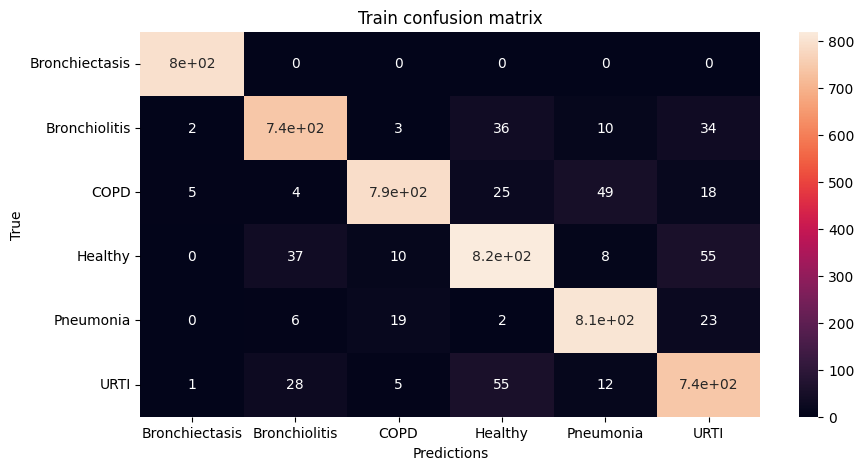

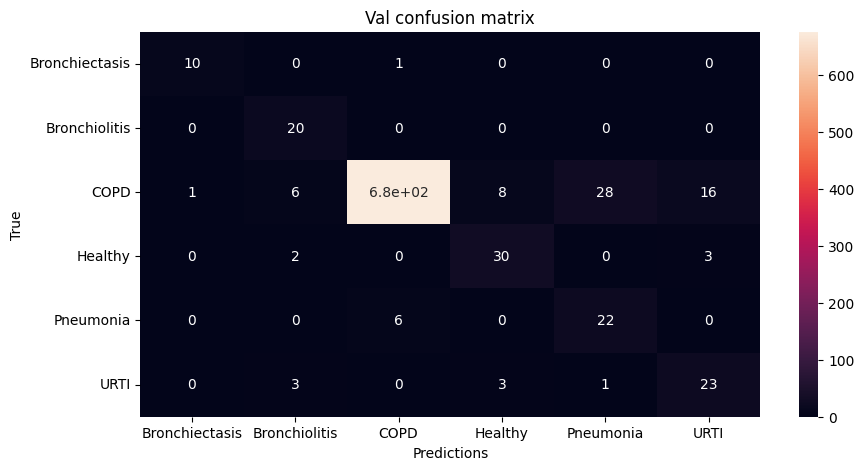


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 39:

Train Accuracy: 0.9114363354037267

Train Loss: 0.27176389595644074

Train F1 Score: 0.9022107975823539

Val Accuracy: 0.9036680911680911
\Val Loss: 0.3378988730686682

Val F1 Score: 0.7009965413146548




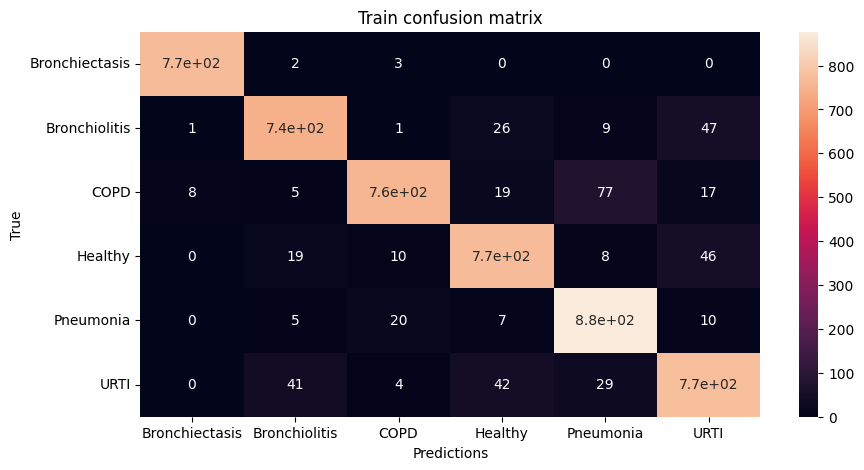

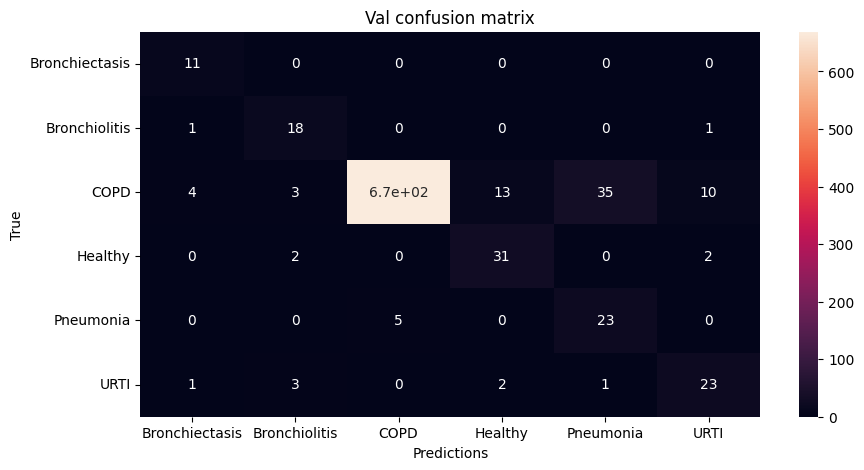


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 40:

Train Accuracy: 0.9160403726708074

Train Loss: 0.25733338680511675

Train F1 Score: 0.9076573226762854

Val Accuracy: 0.836894586894587
\Val Loss: 0.4952601144711177

Val F1 Score: 0.5780987474653456




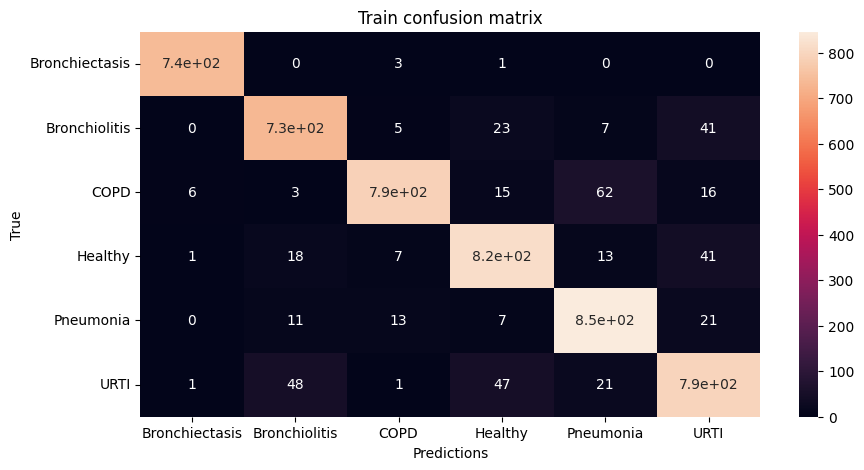

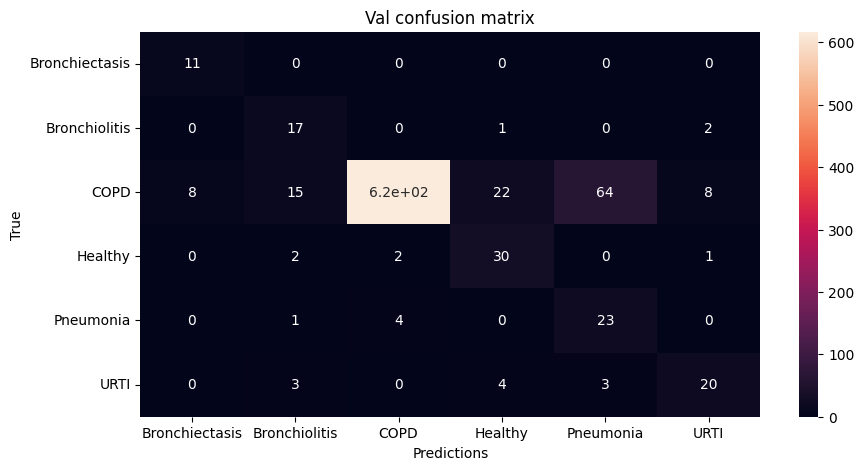


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 41:

Train Accuracy: 0.9163742236024844

Train Loss: 0.24080172377806272

Train F1 Score: 0.9077872863467435

Val Accuracy: 0.8793625356125355
\Val Loss: 0.40974902152083814

Val F1 Score: 0.636438399553299




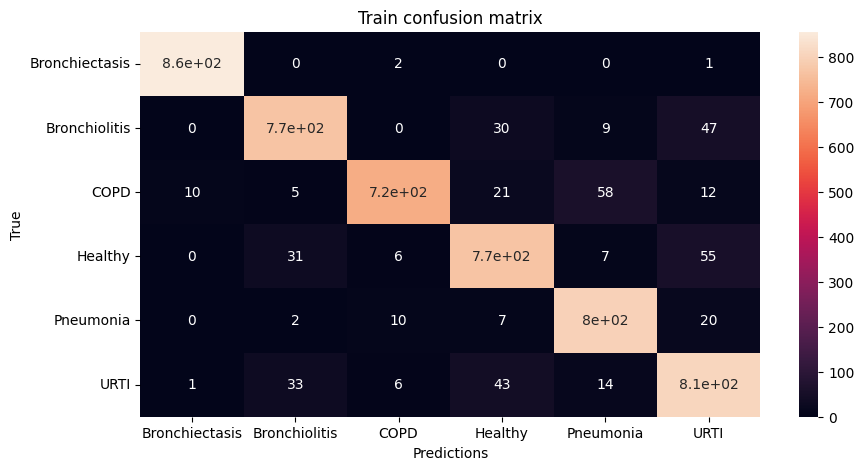

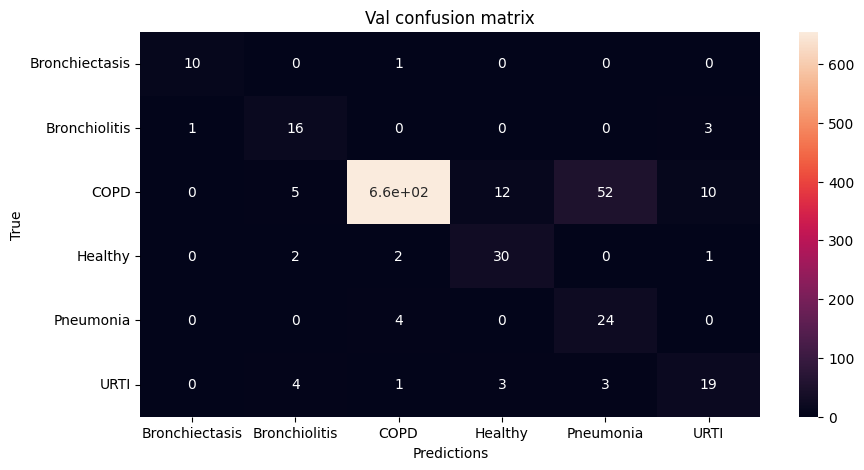


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 42:

Train Accuracy: 0.9034239130434781

Train Loss: 0.2845624514294337

Train F1 Score: 0.8884008456461178

Val Accuracy: 0.8794515669515669
\Val Loss: 0.3437598549105503

Val F1 Score: 0.6188065669050923




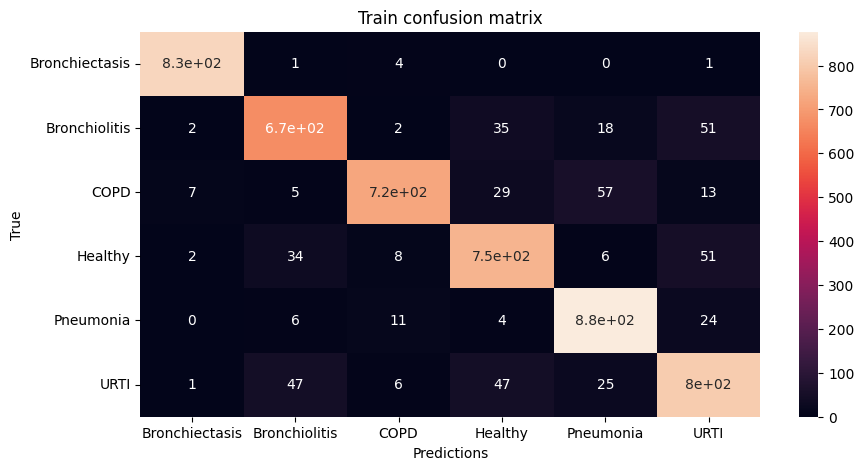

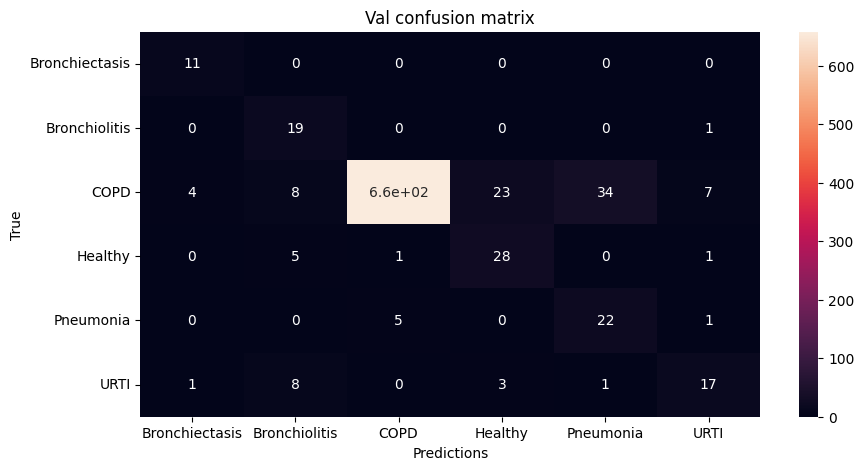


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 43:

Train Accuracy: 0.9186723602484472

Train Loss: 0.2390457153181482

Train F1 Score: 0.9082498054326691

Val Accuracy: 0.9131944444444444
\Val Loss: 0.3424864695579917

Val F1 Score: 0.6629826371316556




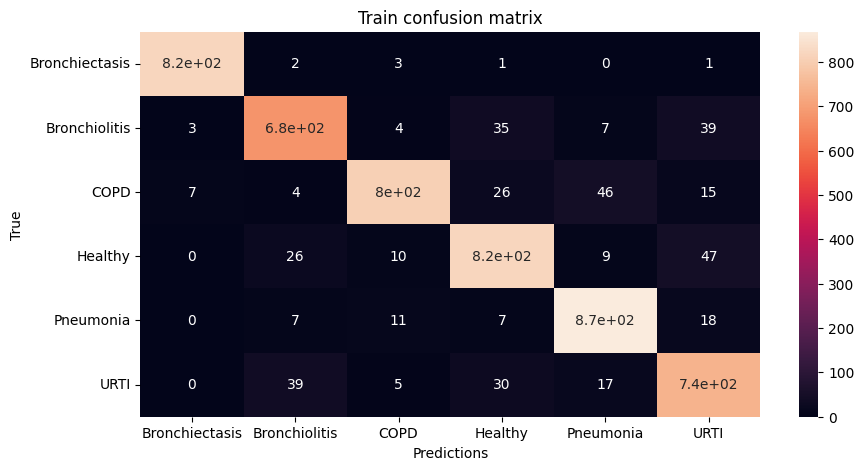

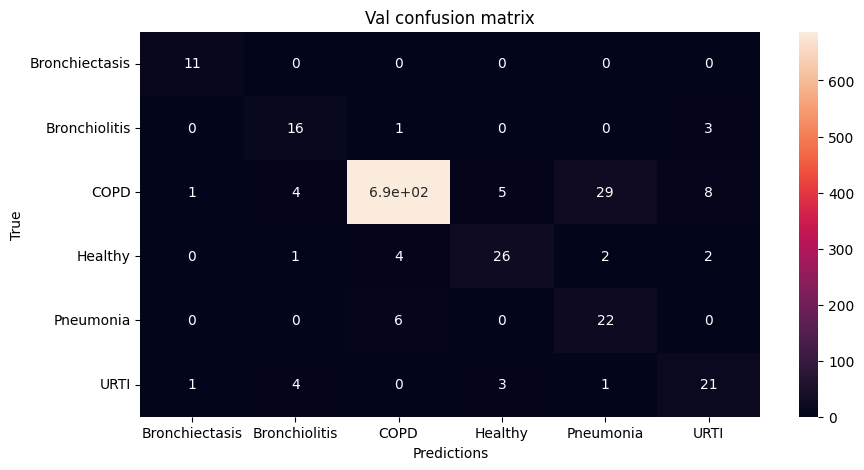


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 44:

Train Accuracy: 0.9117701863354036

Train Loss: 0.2687013523410196

Train F1 Score: 0.9019441434315273

Val Accuracy: 0.8672542735042734
\Val Loss: 0.3640399815307723

Val F1 Score: 0.5975418046668723




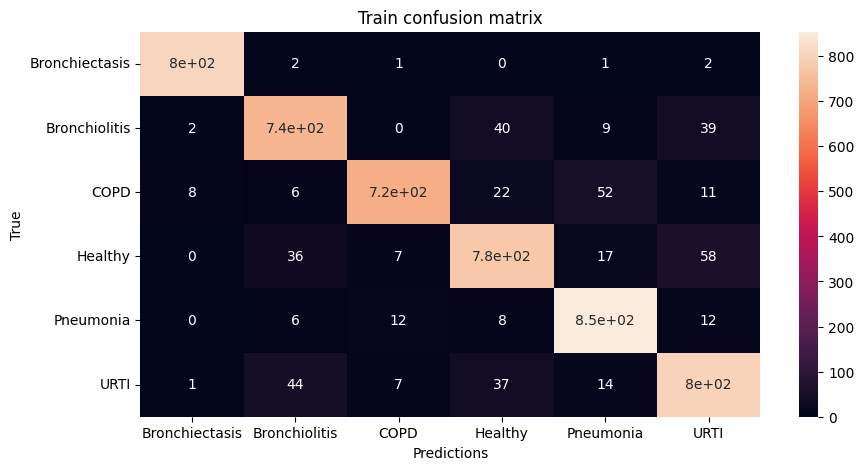

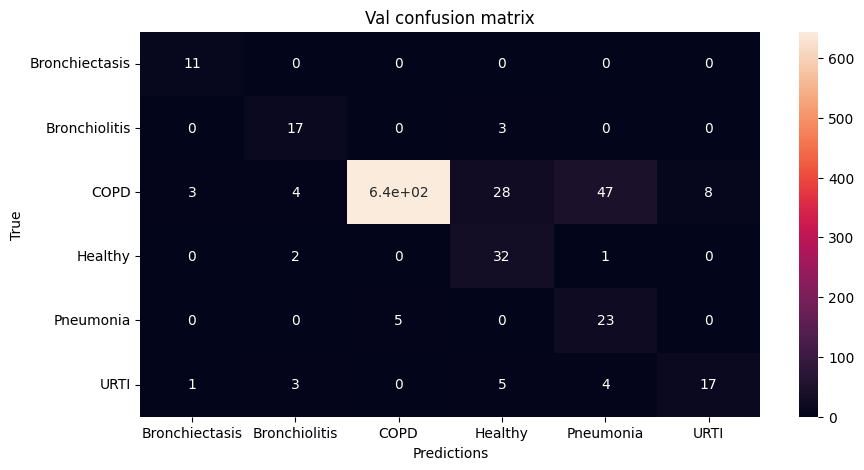


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 45:

Train Accuracy: 0.9307919254658384

Train Loss: 0.21694817630030352

Train F1 Score: 0.920929767700456

Val Accuracy: 0.8976139601139601
\Val Loss: 0.3402597479246281

Val F1 Score: 0.6656383750615297




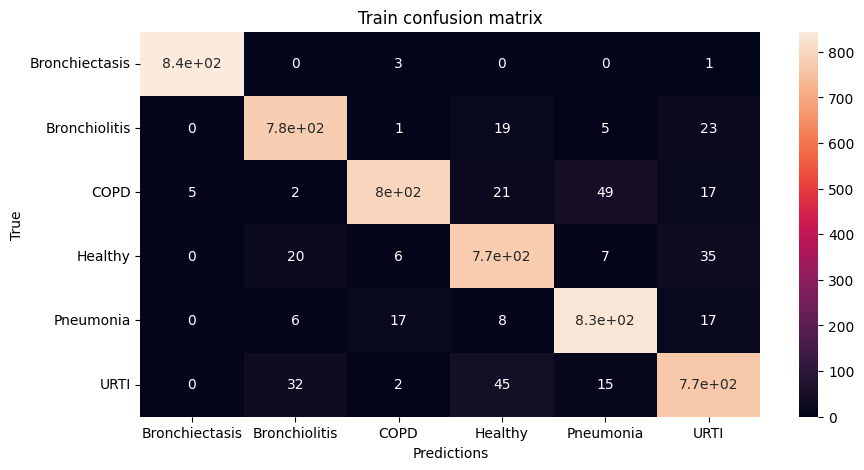

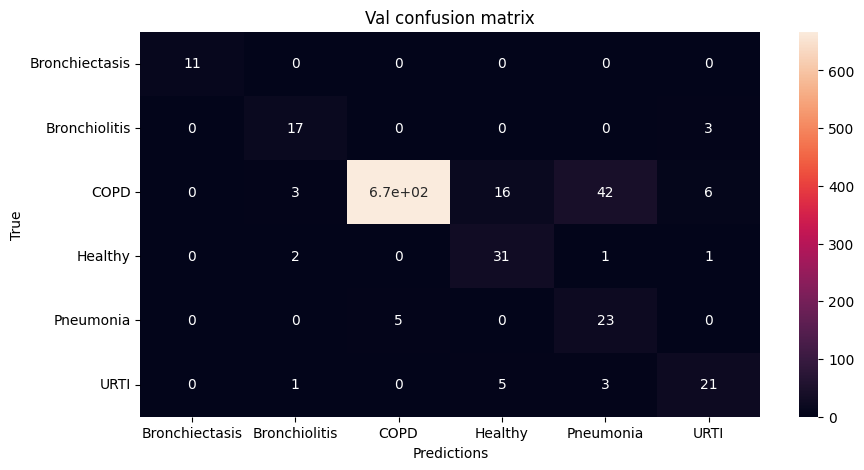


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 46:

Train Accuracy: 0.9366149068322981

Train Loss: 0.18953480989157412

Train F1 Score: 0.9314205035659837

Val Accuracy: 0.8854166666666666
\Val Loss: 0.41901547206496753

Val F1 Score: 0.6425079118322443




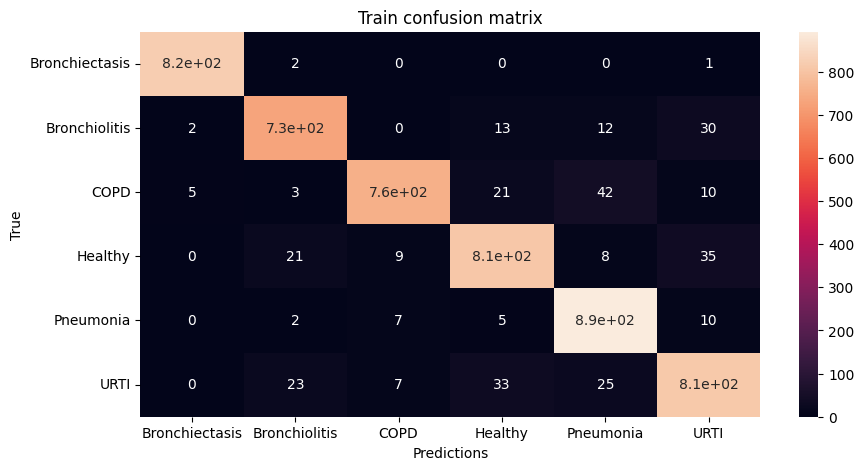

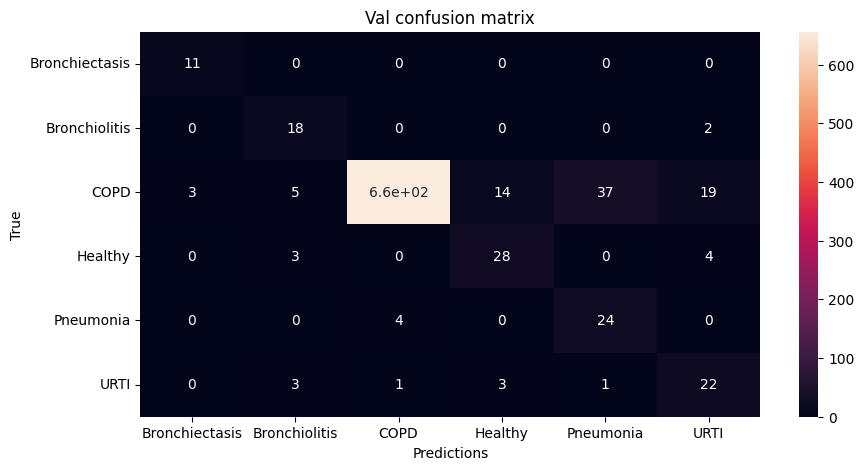


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 47:

Train Accuracy: 0.9223059006211181

Train Loss: 0.22452525644684615

Train F1 Score: 0.914877010058172

Val Accuracy: 0.8929843304843305
\Val Loss: 0.3454240301141032

Val F1 Score: 0.6722825268904368




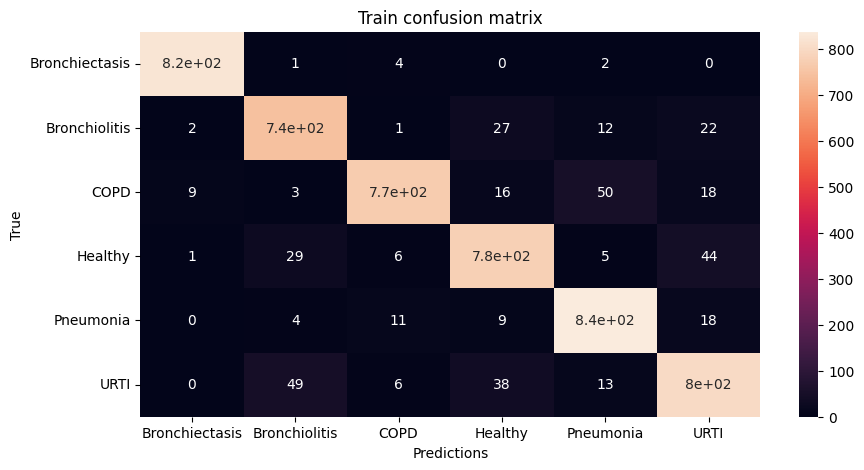

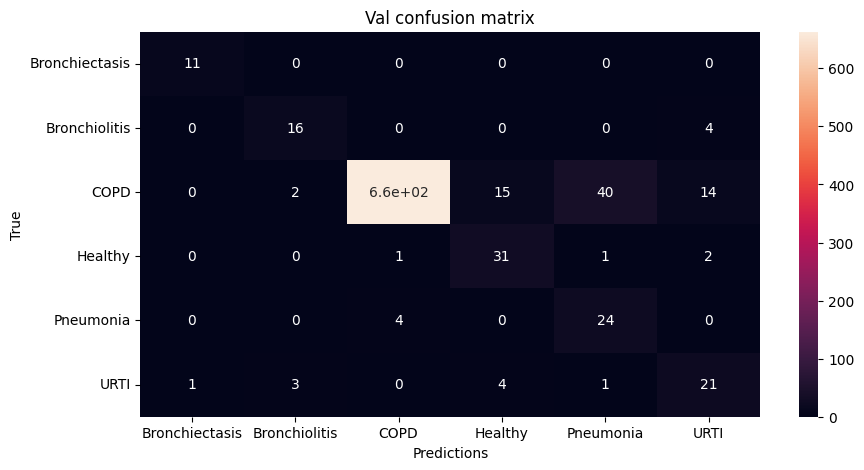


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 48:

Train Accuracy: 0.9330667701863353

Train Loss: 0.19214686713765683

Train F1 Score: 0.9268180305913368

Val Accuracy: 0.8955662393162392
\Val Loss: 0.34292919050764153

Val F1 Score: 0.6902508437633514




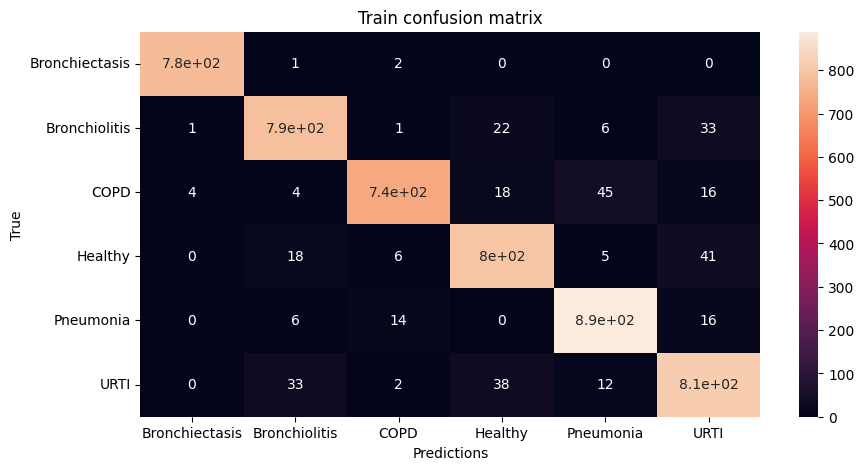

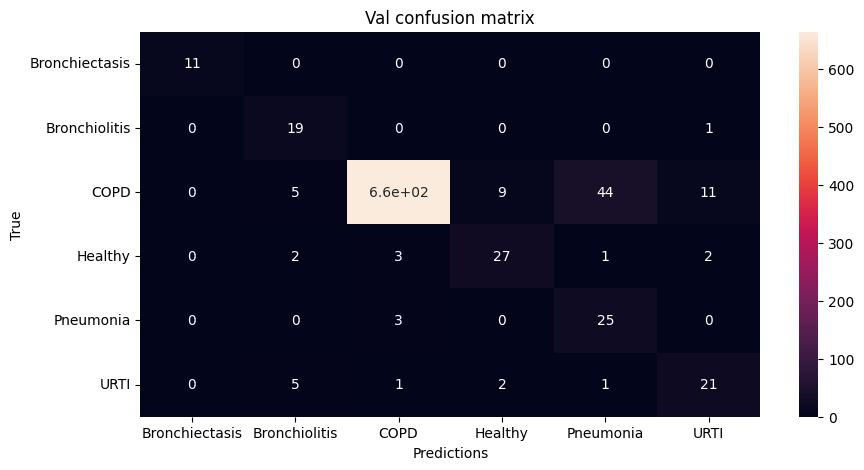


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 49:

Train Accuracy: 0.9333695652173913

Train Loss: 0.2081627907428127

Train F1 Score: 0.9281806316434967

Val Accuracy: 0.8924501424501424
\Val Loss: 0.37021990561926804

Val F1 Score: 0.6279864167725598




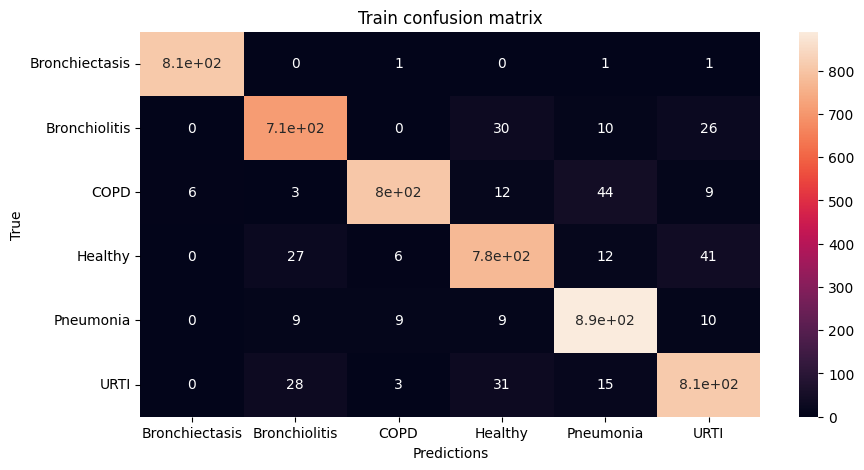

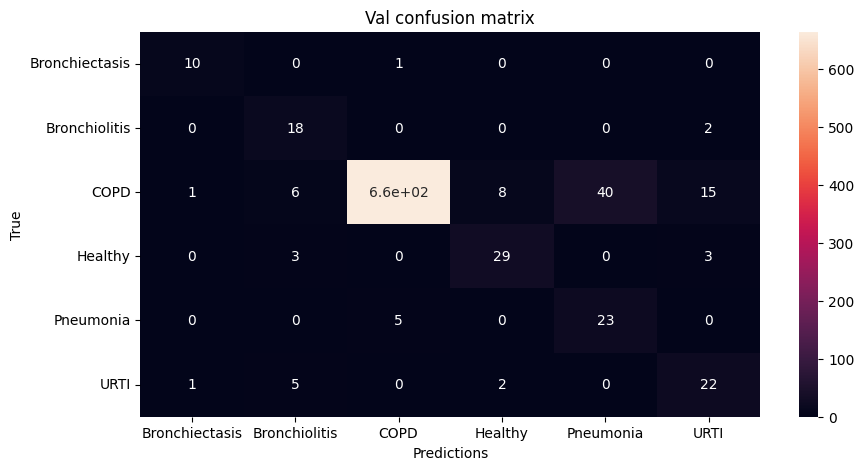


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 50:

Train Accuracy: 0.9407453416149069

Train Loss: 0.19427788478571065

Train F1 Score: 0.9366025084294147

Val Accuracy: 0.8745548433048433
\Val Loss: 0.49672526288432656

Val F1 Score: 0.6231251800501788




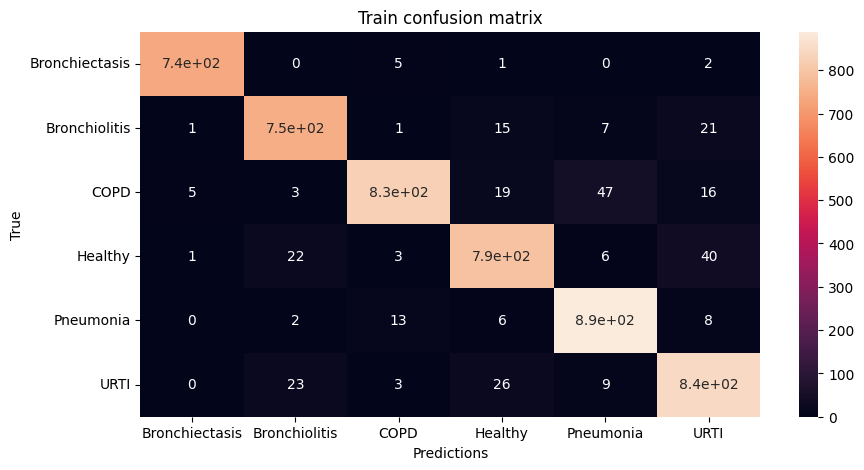

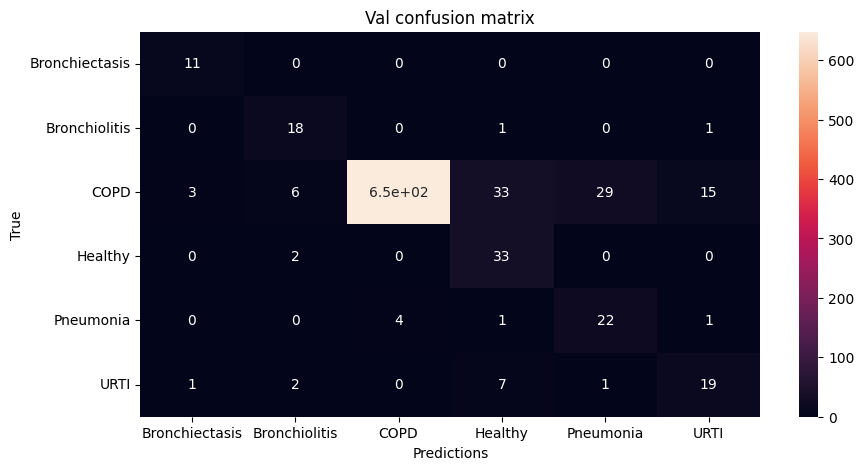


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 51:

Train Accuracy: 0.9369487577639751

Train Loss: 0.2054675471801195

Train F1 Score: 0.9276467150782947

Val Accuracy: 0.9113247863247863
\Val Loss: 0.31826673192834415

Val F1 Score: 0.6772294828185329




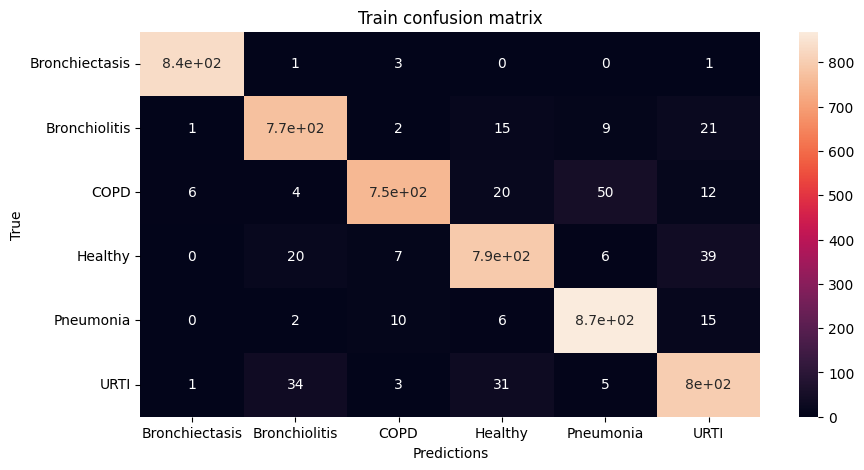

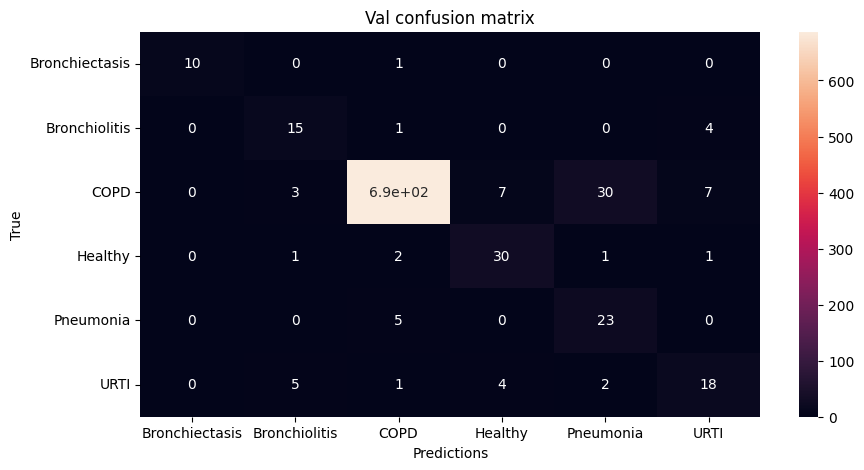


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 52:

Train Accuracy: 0.9342934782608695

Train Loss: 0.2040458328165808

Train F1 Score: 0.9280360515073219

Val Accuracy: 0.8923611111111112
\Val Loss: 0.387863889336586

Val F1 Score: 0.6850336834236428




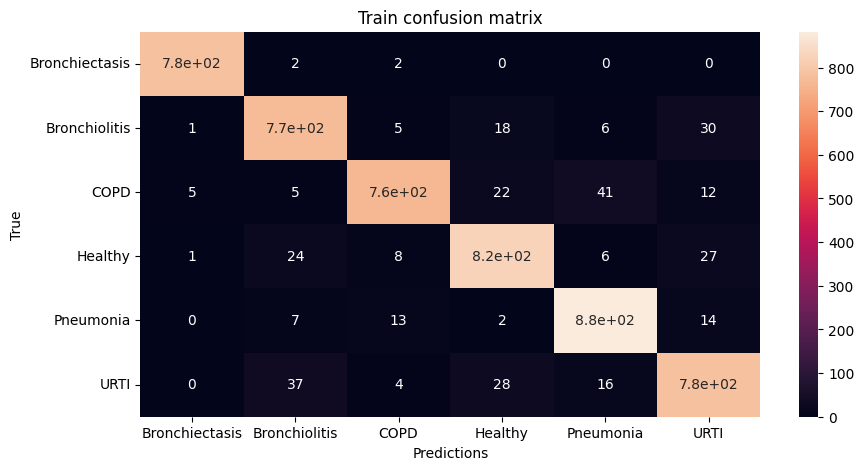

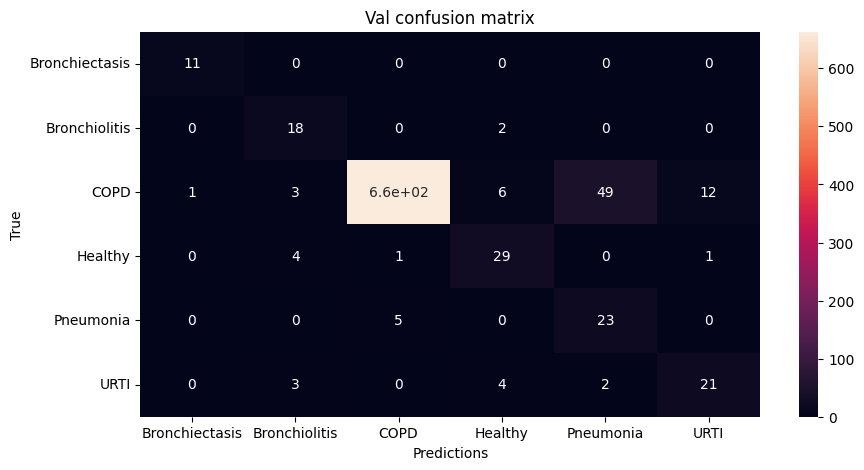


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 53:

Train Accuracy: 0.9172593167701864

Train Loss: 0.2485082889473216

Train F1 Score: 0.9102477116614395

Val Accuracy: 0.9091880341880342
\Val Loss: 0.26546244309456263

Val F1 Score: 0.6817988046893367




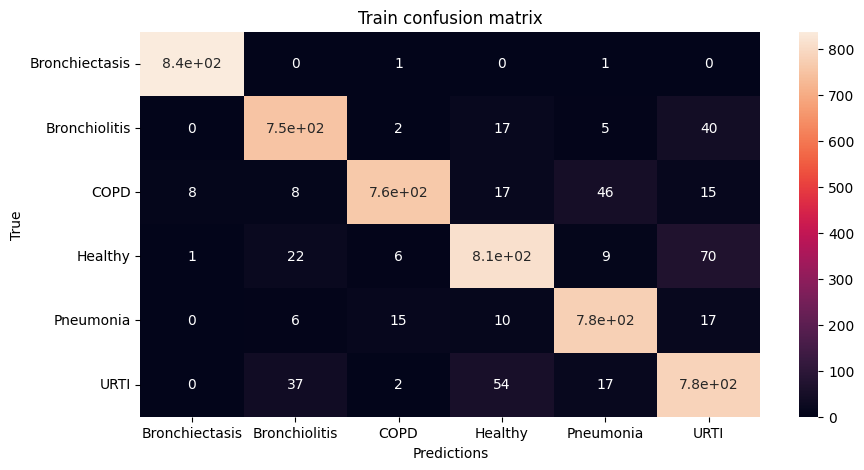

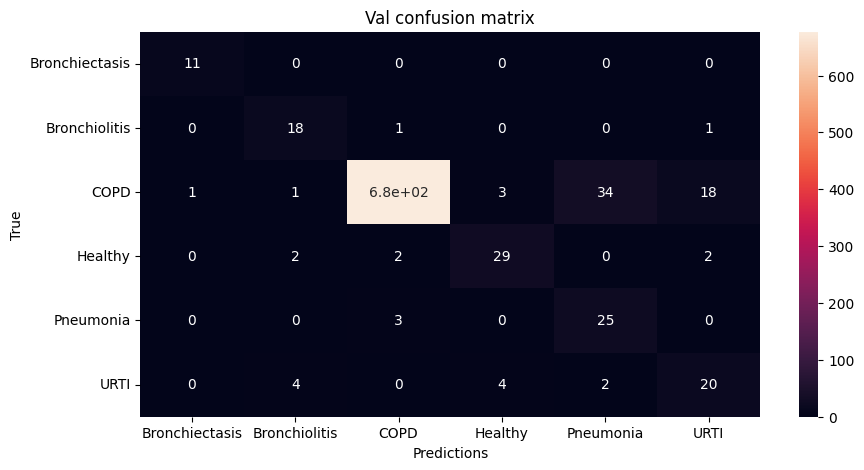


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 54:

Train Accuracy: 0.9417158385093168

Train Loss: 0.18009464958717364

Train F1 Score: 0.9365078251554358

Val Accuracy: 0.9187143874643874
\Val Loss: 0.3003617523720971

Val F1 Score: 0.7003303589644255




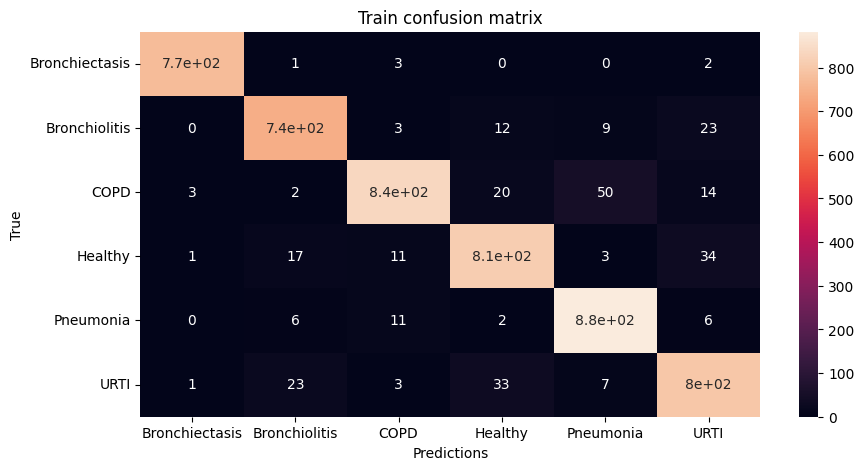

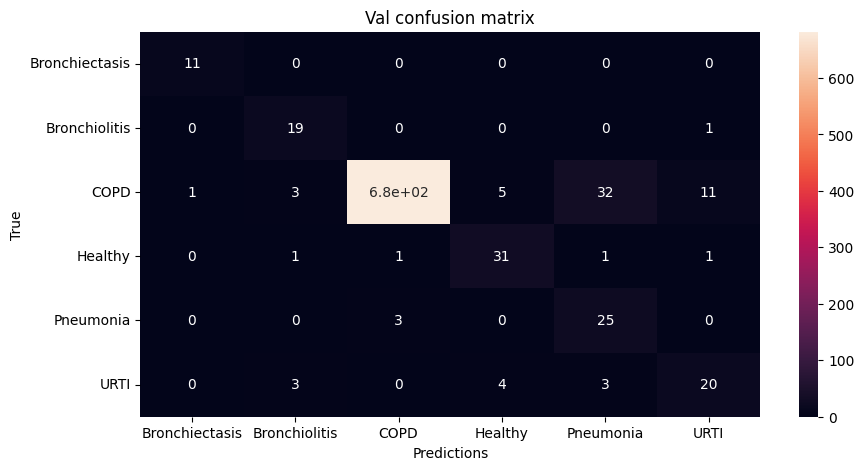


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 55:

Train Accuracy: 0.9440450310559007

Train Loss: 0.1834554279870961

Train F1 Score: 0.9360212620741092

Val Accuracy: 0.916755698005698
\Val Loss: 0.30340655868941985

Val F1 Score: 0.7258453181496373




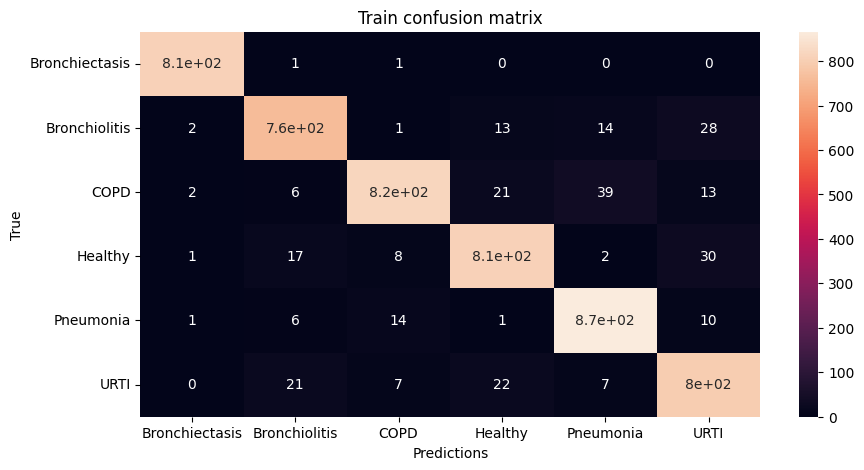

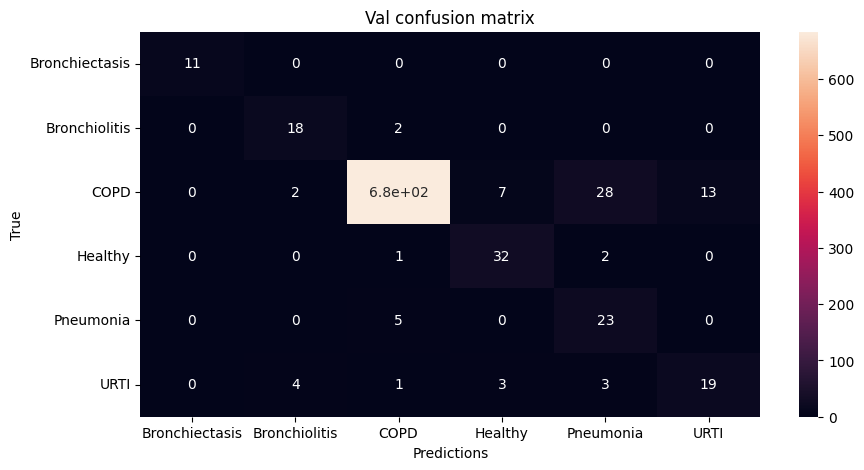


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 56:

Train Accuracy: 0.9169254658385093

Train Loss: 0.25260190637955754

Train F1 Score: 0.9107889407169745

Val Accuracy: 0.9155982905982906
\Val Loss: 0.3391647928359884

Val F1 Score: 0.7280807009449711




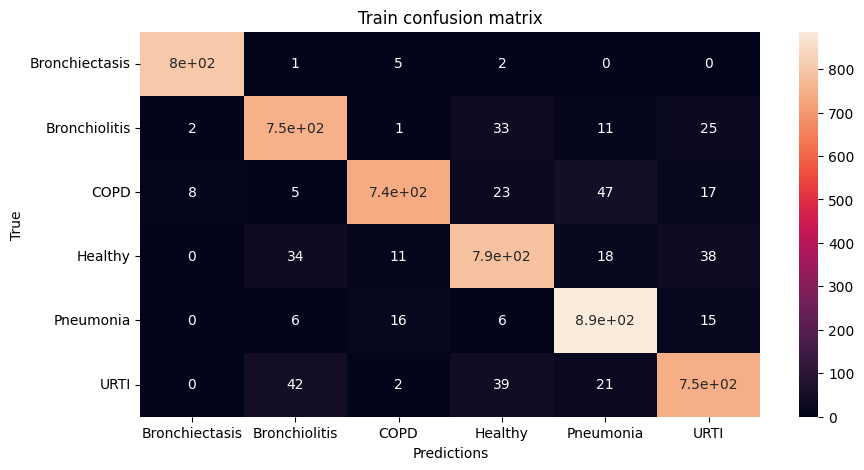

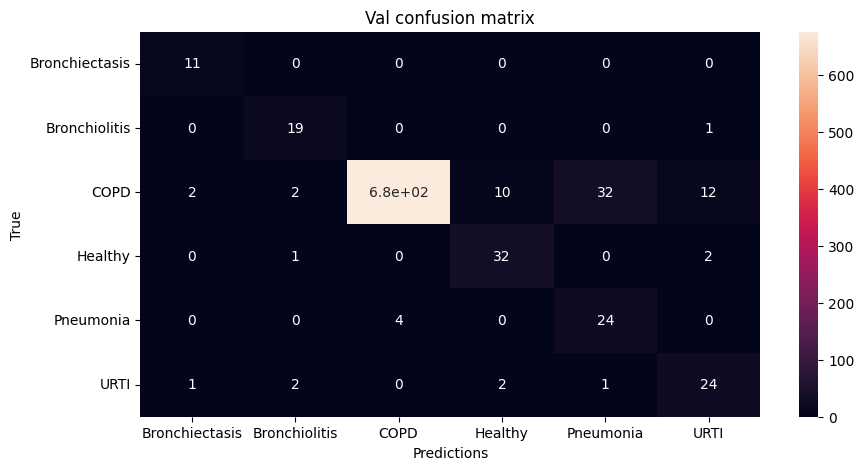


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 57:

Train Accuracy: 0.953416149068323

Train Loss: 0.14408878692836494

Train F1 Score: 0.9459616390074262

Val Accuracy: 0.9149750712250713
\Val Loss: 0.29355715380774605

Val F1 Score: 0.691530281746829




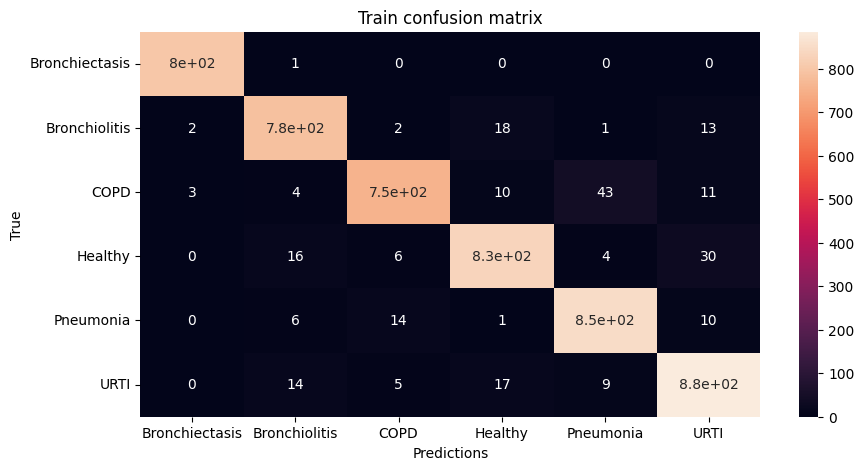

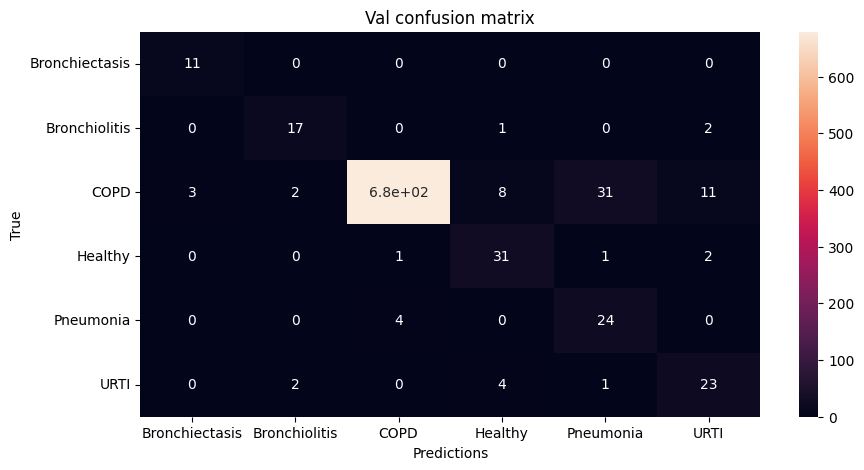


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 58:

Train Accuracy: 0.9450155279503106

Train Loss: 0.16103528221340283

Train F1 Score: 0.9395171833334502

Val Accuracy: 0.8974358974358974
\Val Loss: 0.4349214136643611

Val F1 Score: 0.6632742881774902




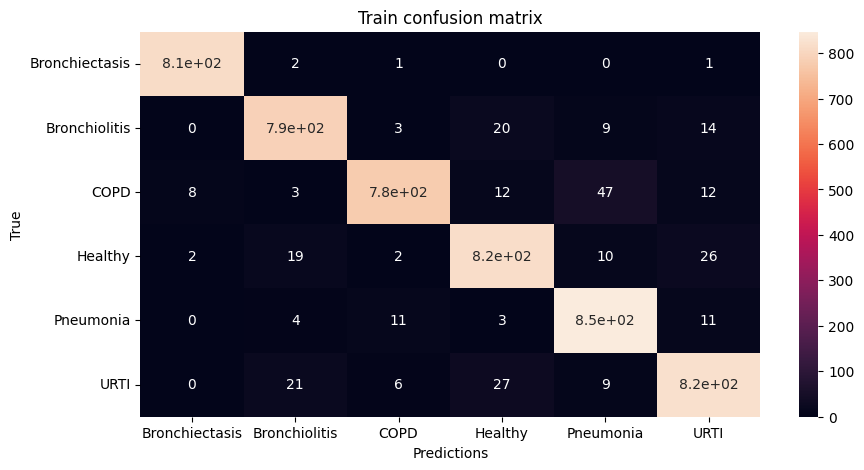

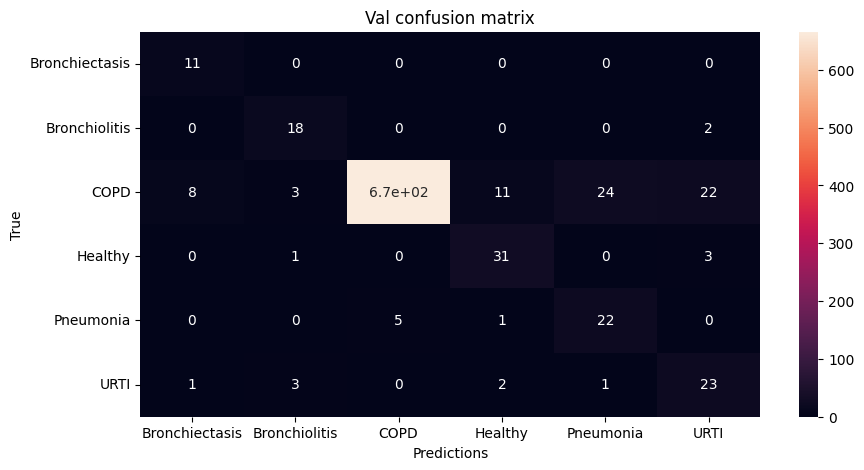


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 59:

Train Accuracy: 0.9446273291925467

Train Loss: 0.17599357207022284

Train F1 Score: 0.9391560210204273

Val Accuracy: 0.9115028490028491
\Val Loss: 0.3338414233315874

Val F1 Score: 0.6871147939452419




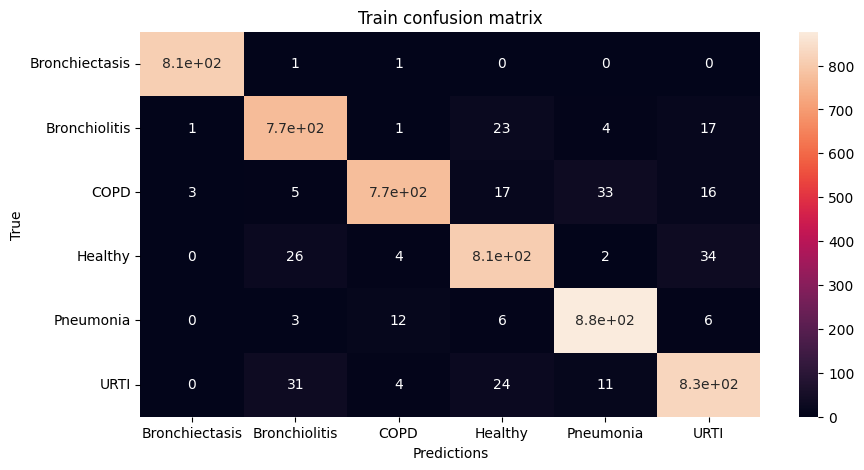

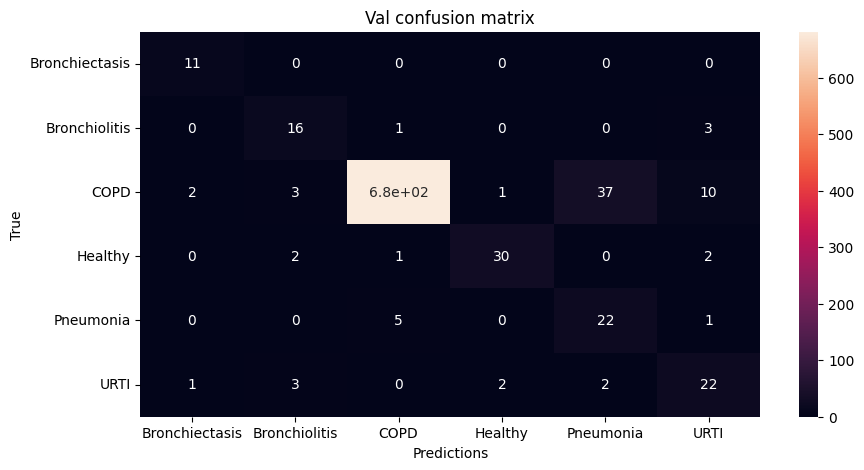


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 60:

Train Accuracy: 0.9418012422360248

Train Loss: 0.17675356703422826

Train F1 Score: 0.9345228790496447

Val Accuracy: 0.8794515669515669
\Val Loss: 0.41311327299034156

Val F1 Score: 0.64270912165995




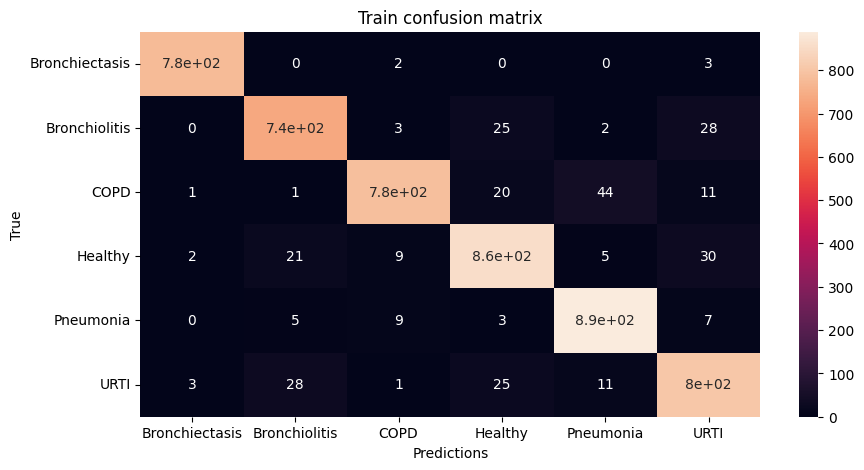

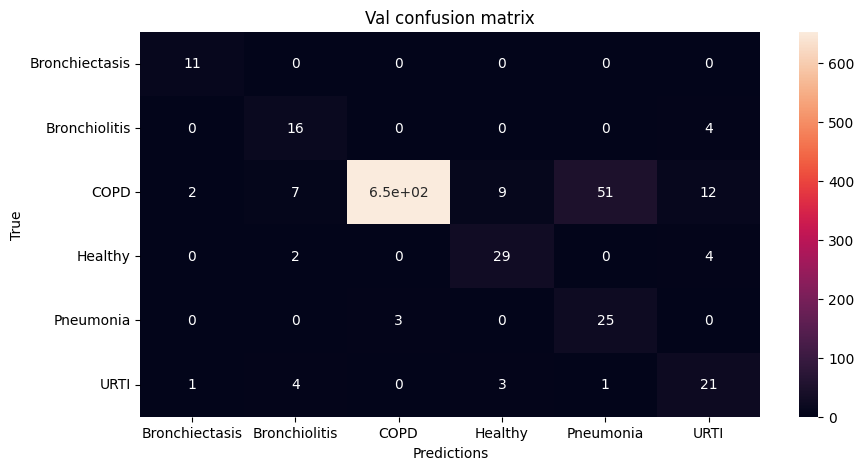


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 61:

Train Accuracy: 0.9549689440993789

Train Loss: 0.1380746302351078

Train F1 Score: 0.9495051780842846

Val Accuracy: 0.9010861823361823
\Val Loss: 0.3222310997683693

Val F1 Score: 0.686111189700939




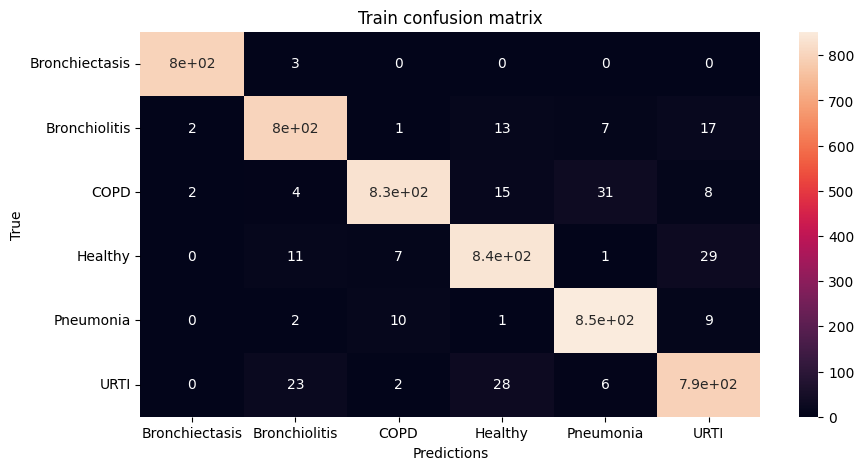

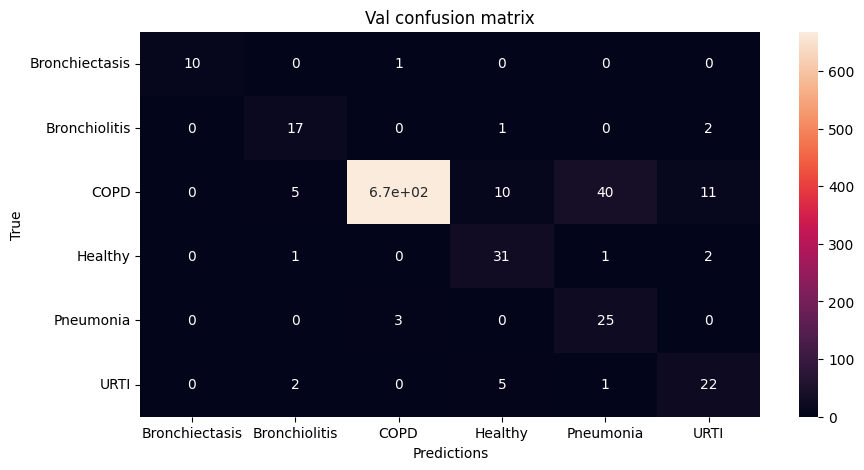


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 62:

Train Accuracy: 0.9597670807453417

Train Loss: 0.12927362281158103

Train F1 Score: 0.9539968952629136

Val Accuracy: 0.9002849002849003
\Val Loss: 0.36137989190993486

Val F1 Score: 0.6628797926284649




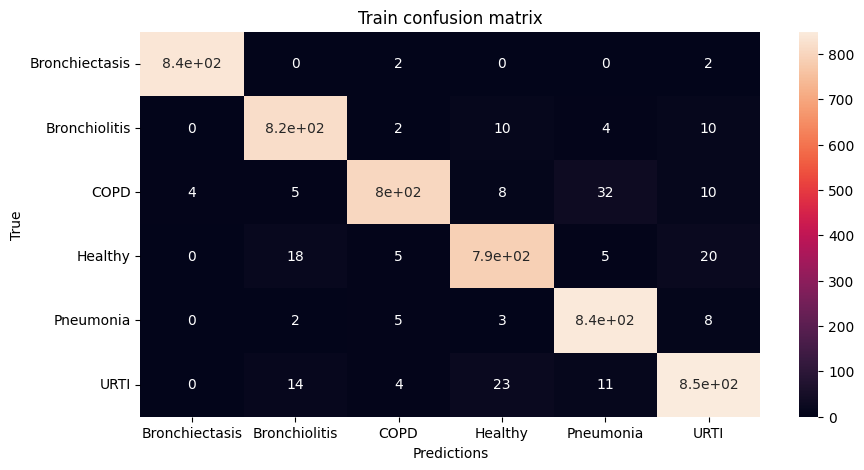

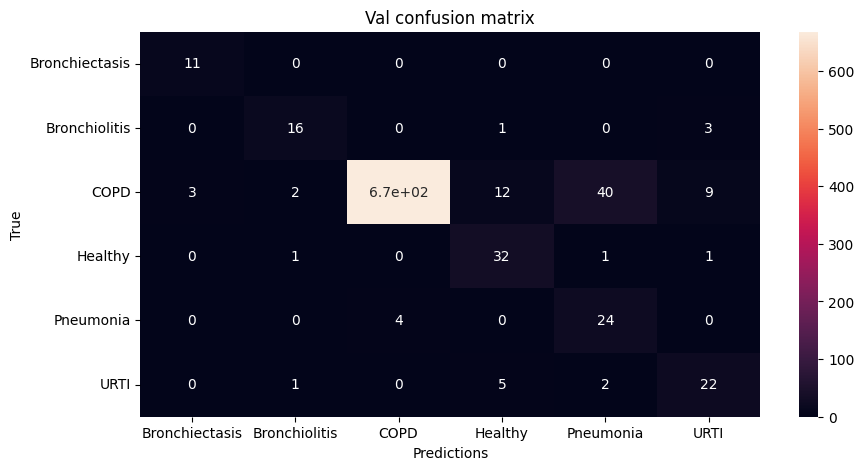


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 63:

Train Accuracy: 0.9393866459627329

Train Loss: 0.19869948054160574

Train F1 Score: 0.9310349740597031

Val Accuracy: 0.9077635327635327
\Val Loss: 0.3218915513544171

Val F1 Score: 0.6910278929604424




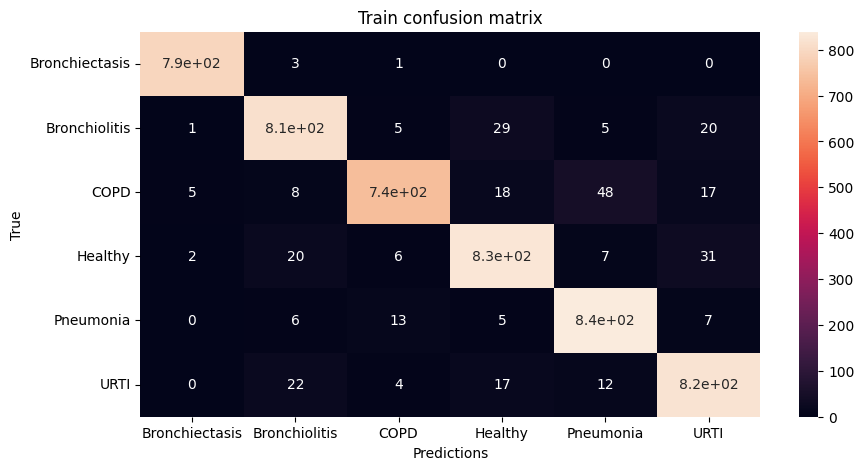

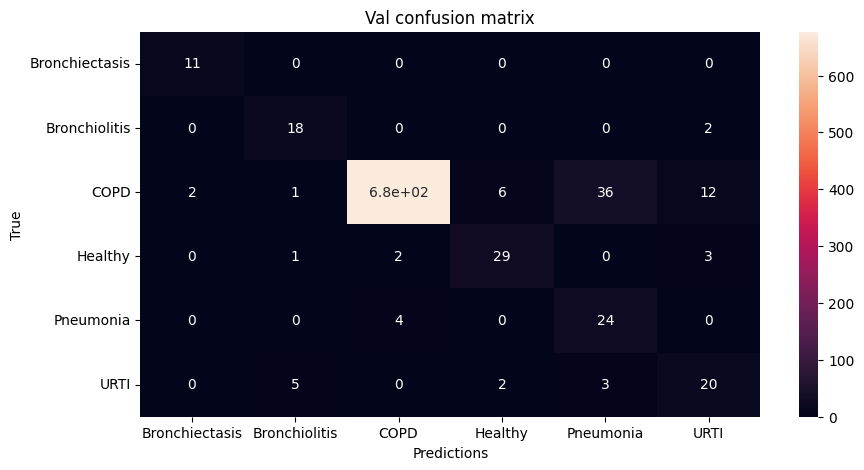


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 64:

Train Accuracy: 0.9631211180124224

Train Loss: 0.12126920652222929

Train F1 Score: 0.9576635690209288

Val Accuracy: 0.9010861823361823
\Val Loss: 0.39104446175473706

Val F1 Score: 0.7155858874320984




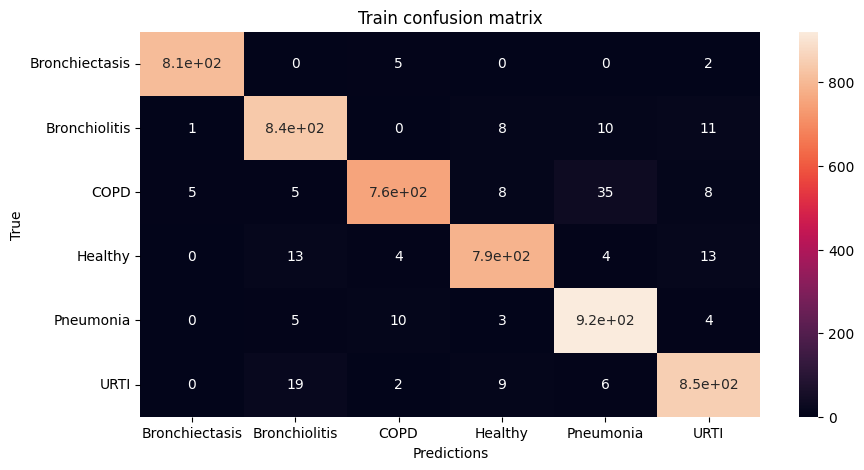

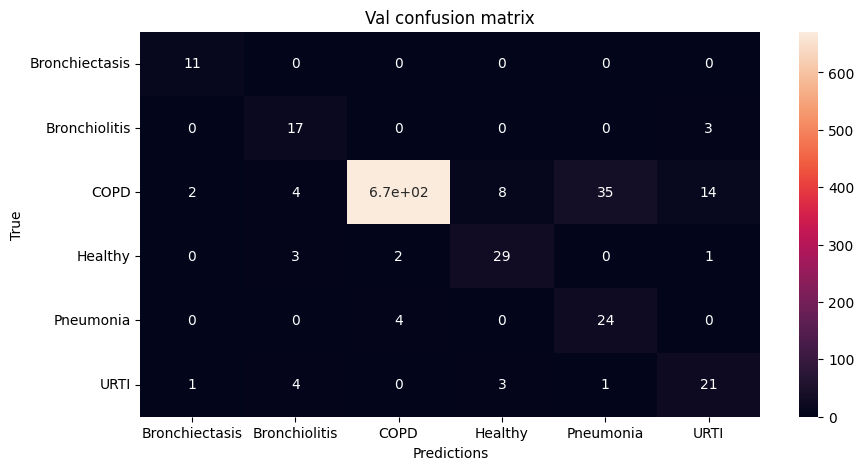


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 65:

Train Accuracy: 0.9530590062111801

Train Loss: 0.14157577528276985

Train F1 Score: 0.9459662452247573

Val Accuracy: 0.9005519943019943
\Val Loss: 0.4216788386305173

Val F1 Score: 0.6650262210104201




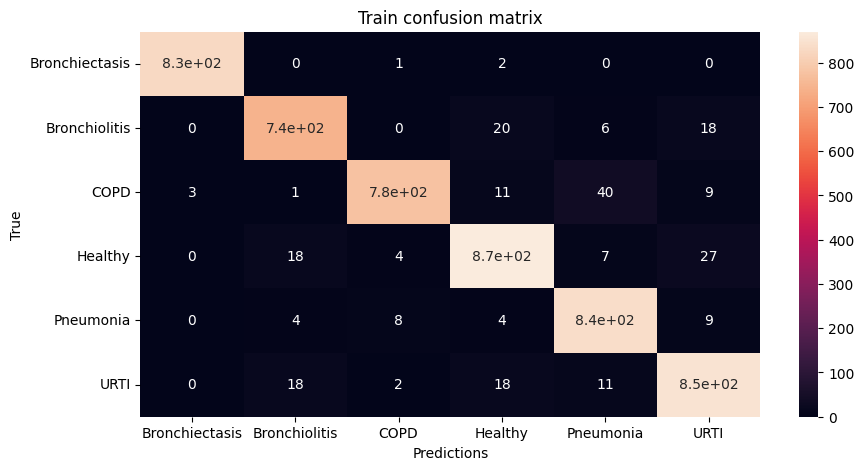

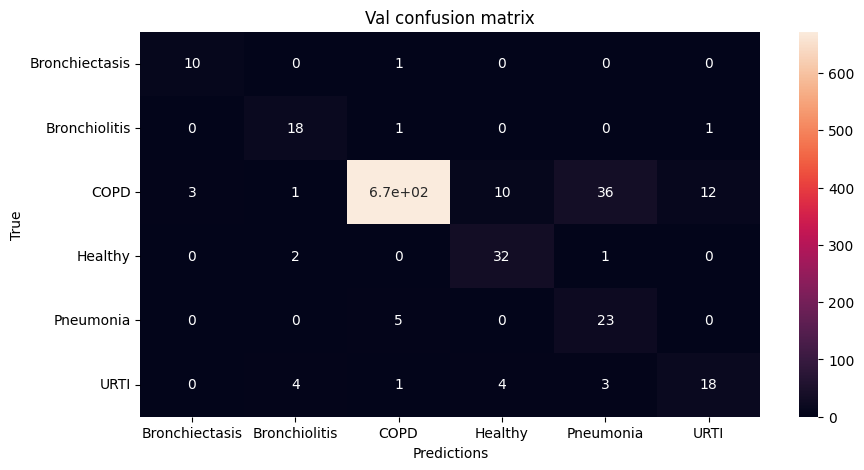


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 66:

Train Accuracy: 0.9348680124223602

Train Loss: 0.20525581409333285

Train F1 Score: 0.9256769007777575

Val Accuracy: 0.9077635327635327
\Val Loss: 0.36085176091917137

Val F1 Score: 0.6779119582087906




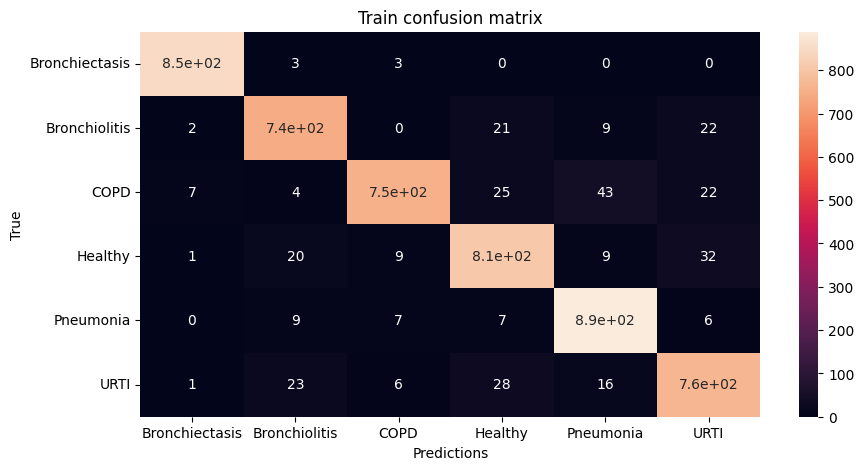

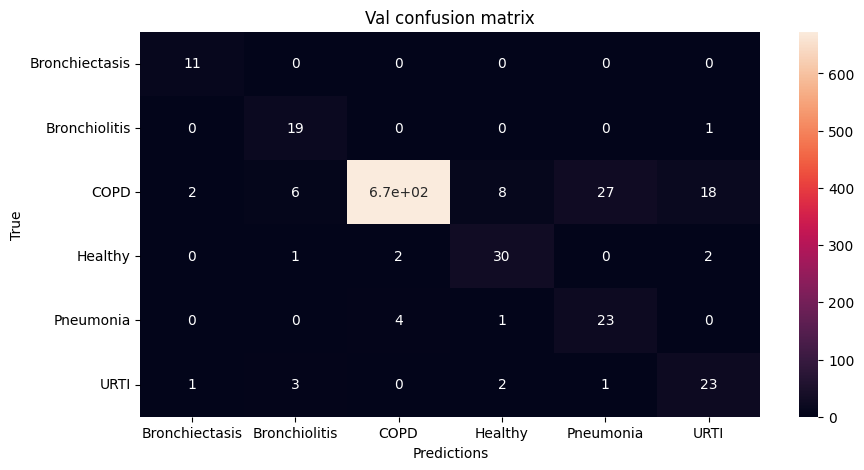


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 67:

Train Accuracy: 0.9571894409937888

Train Loss: 0.14737920798303455

Train F1 Score: 0.9520347788467171

Val Accuracy: 0.899928774928775
\Val Loss: 0.33568625897169113

Val F1 Score: 0.6737733008684935




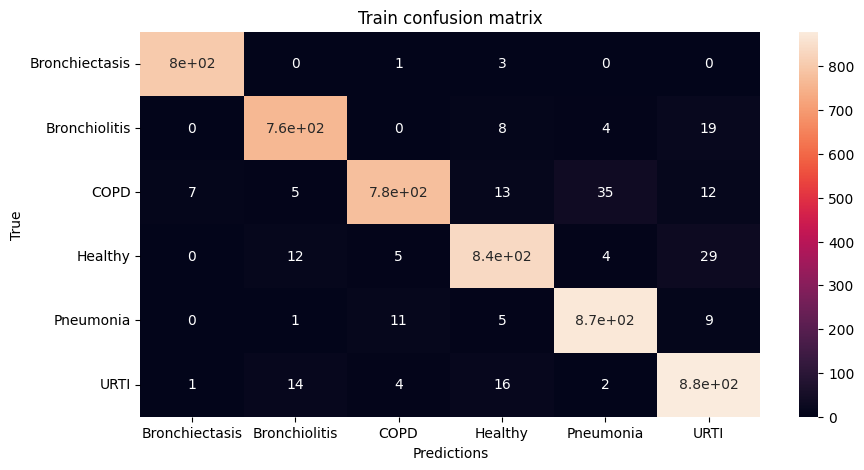

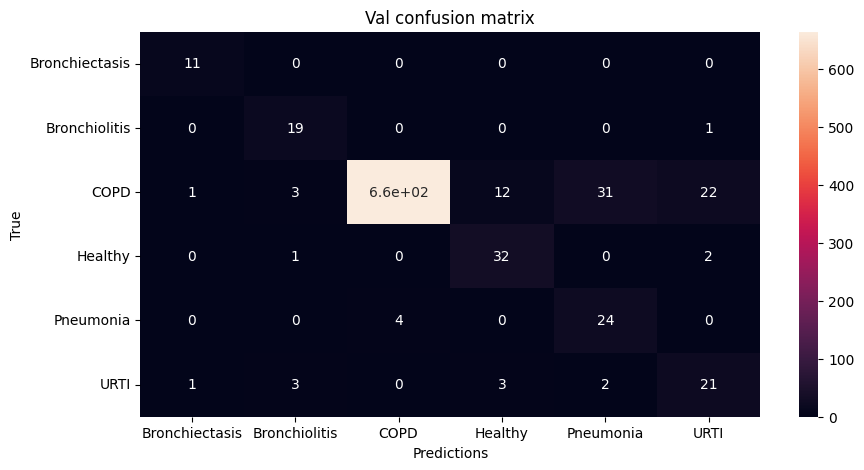


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 68:

Train Accuracy: 0.9485636645962733

Train Loss: 0.1666974412647556

Train F1 Score: 0.9434266375458759

Val Accuracy: 0.9253917378917379
\Val Loss: 0.3288148084172496

Val F1 Score: 0.7129554008996045




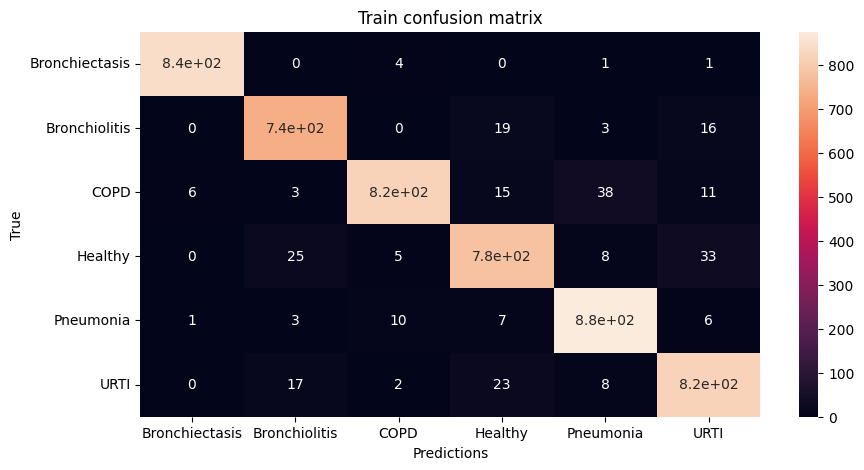

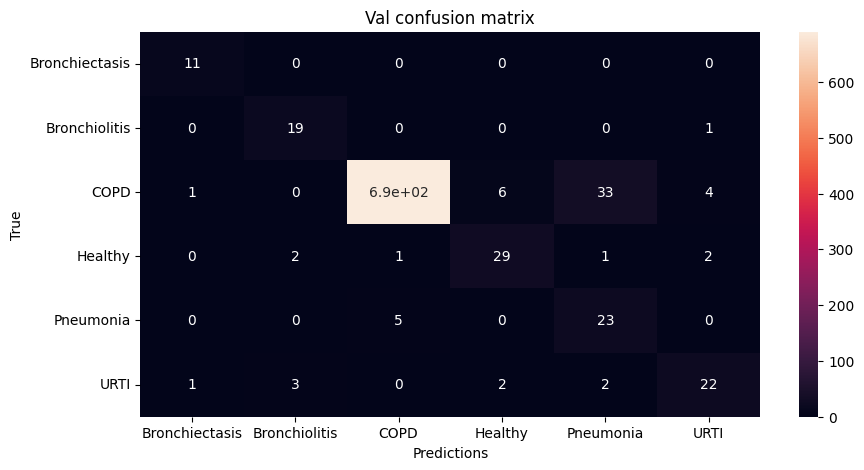


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 69:

Train Accuracy: 0.9502018633540372

Train Loss: 0.1525793666286128

Train F1 Score: 0.9400668651420877

Val Accuracy: 0.8973468660968661
\Val Loss: 0.36486288463627853

Val F1 Score: 0.6359921815218749




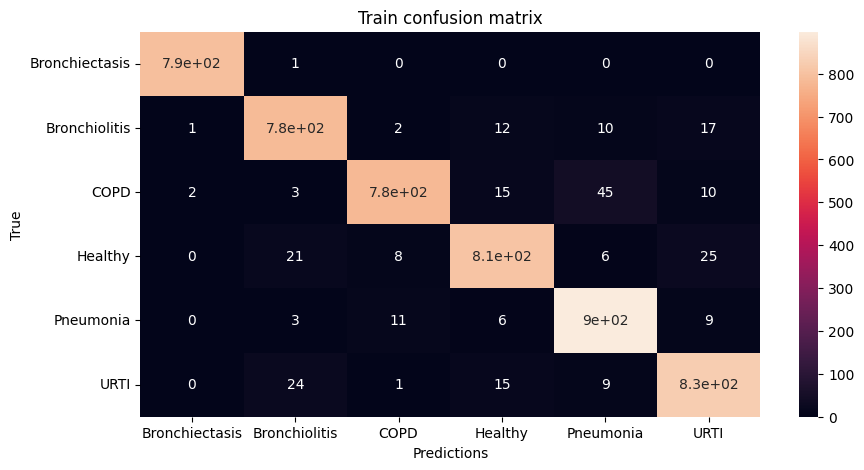

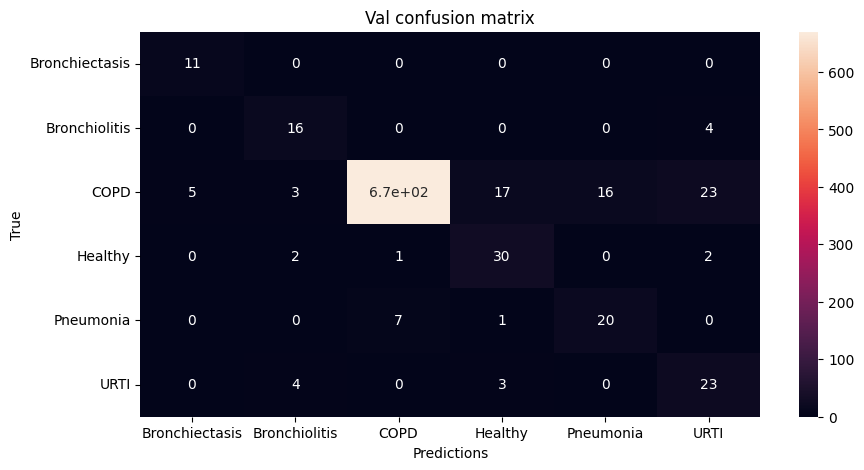


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 70:

Train Accuracy: 0.9633152173913043

Train Loss: 0.11200491971804859

Train F1 Score: 0.9584375264481728

Val Accuracy: 0.9350071225071225
\Val Loss: 0.3103670572206654

Val F1 Score: 0.7474190140212024




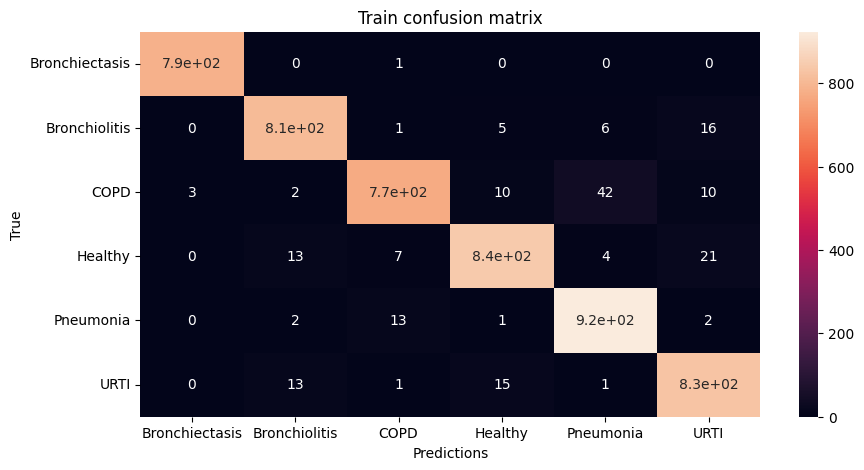

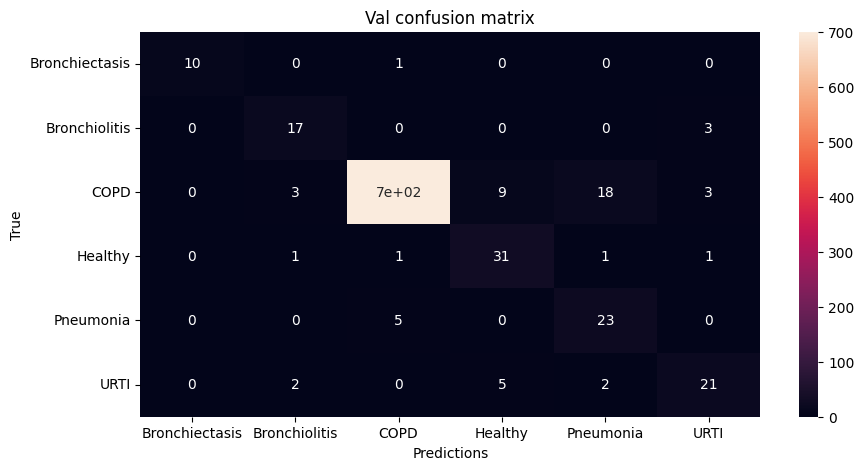


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 71:

Train Accuracy: 0.9419642857142857

Train Loss: 0.17867457009389165

Train F1 Score: 0.9371767388367505

Val Accuracy: 0.9184472934472935
\Val Loss: 0.4147868337178672

Val F1 Score: 0.687502247315866




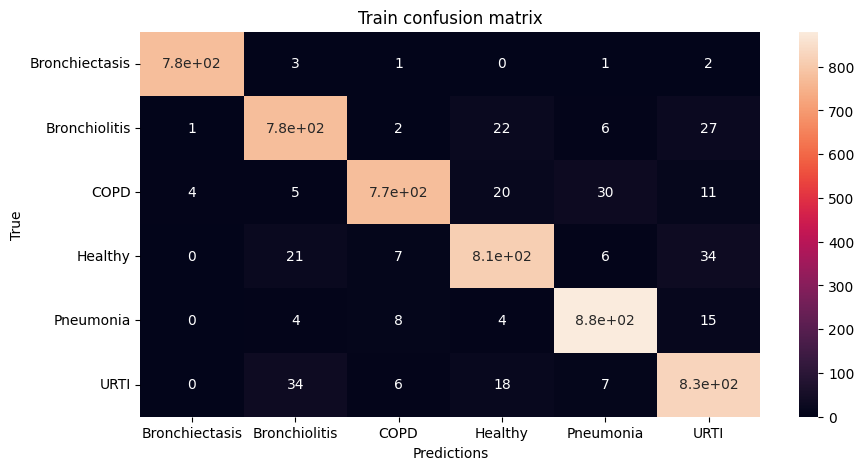

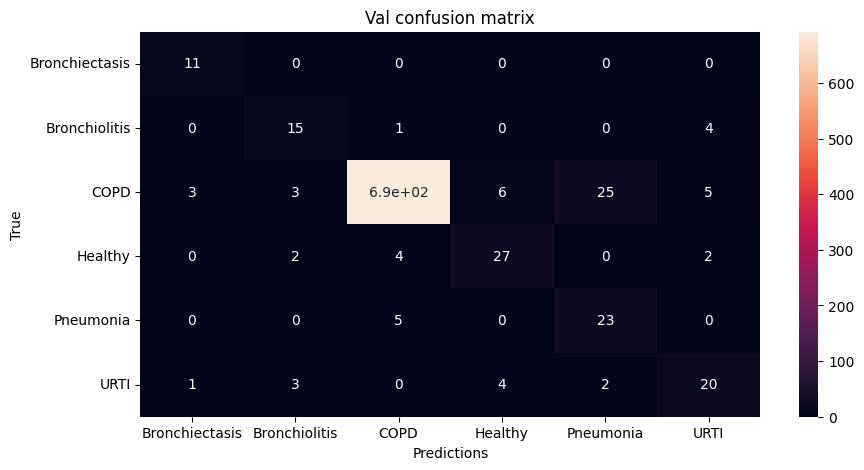


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 72:

Train Accuracy: 0.956638198757764

Train Loss: 0.1387509003119624

Train F1 Score: 0.9522952652125625

Val Accuracy: 0.9135505698005697
\Val Loss: 0.32482581295900875

Val F1 Score: 0.7197012194880733




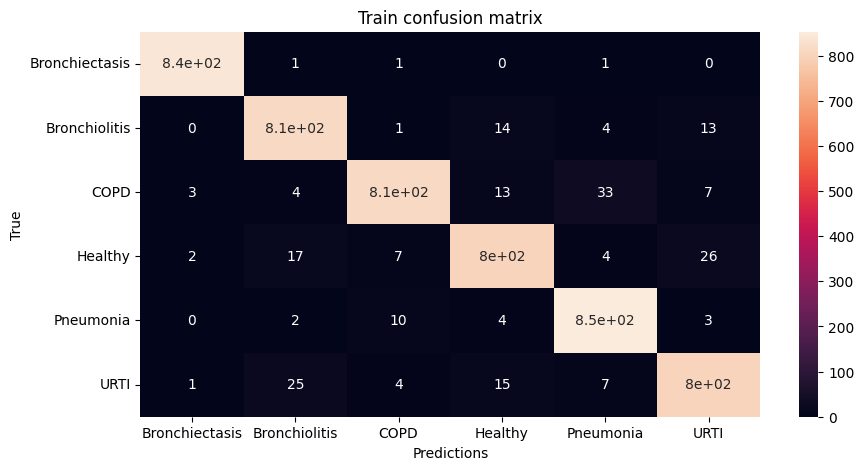

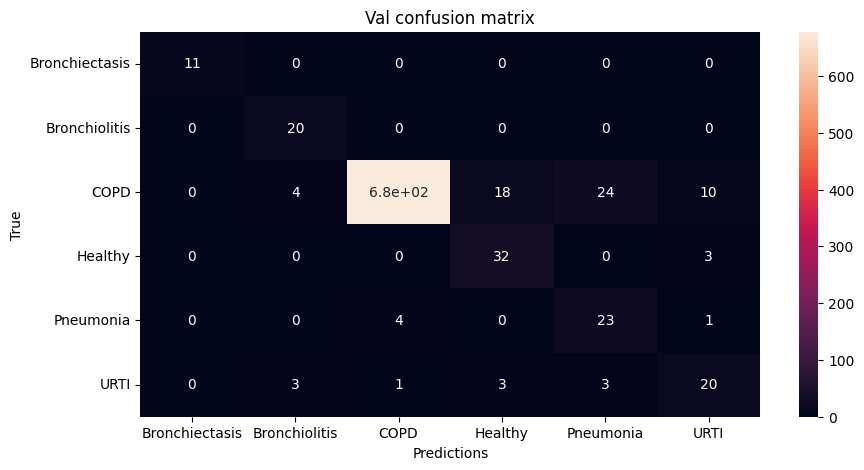


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 73:

Train Accuracy: 0.9544720496894409

Train Loss: 0.1434301927292384

Train F1 Score: 0.9497126692570514

Val Accuracy: 0.8834579772079771
\Val Loss: 0.4538751572922424

Val F1 Score: 0.6979061149888568




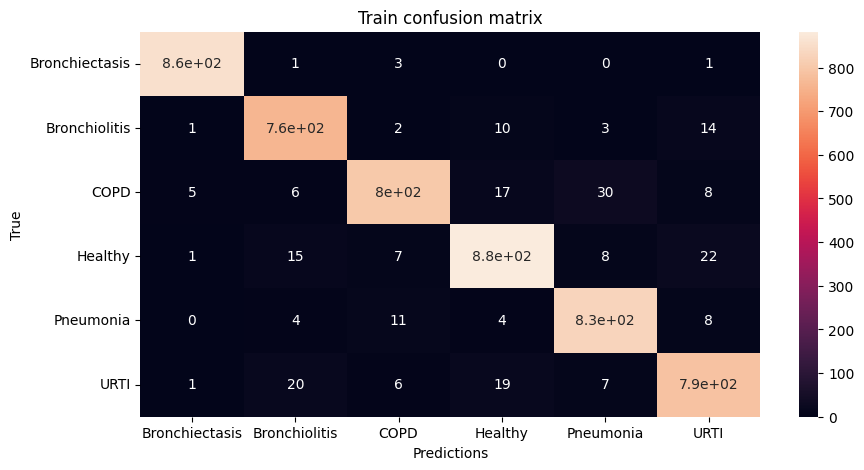

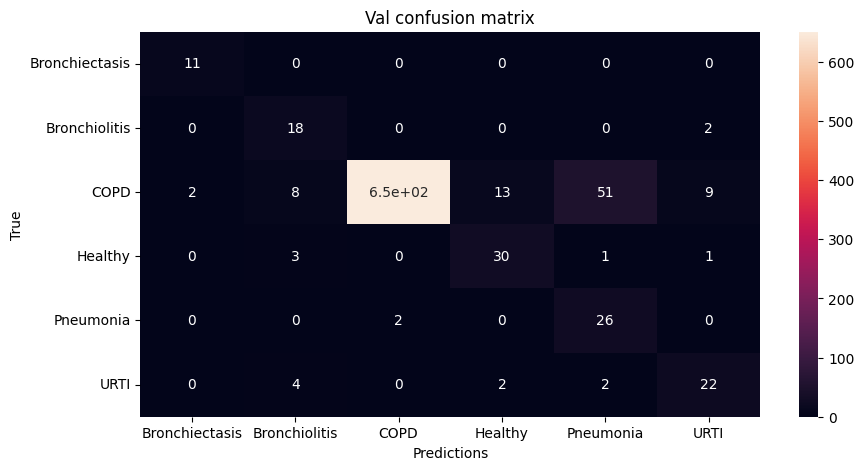


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 74:

Train Accuracy: 0.9584083850931677

Train Loss: 0.13331142929816467

Train F1 Score: 0.9553733779036481

Val Accuracy: 0.9138176638176638
\Val Loss: 0.33106191206240543

Val F1 Score: 0.6998422267260375




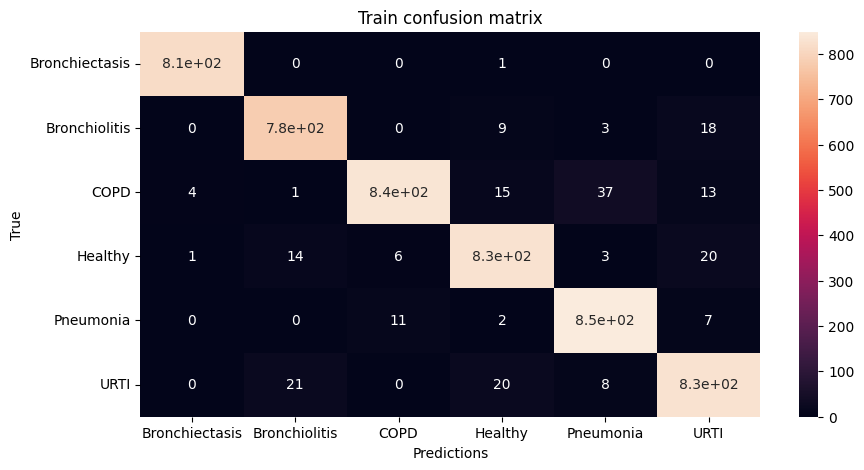

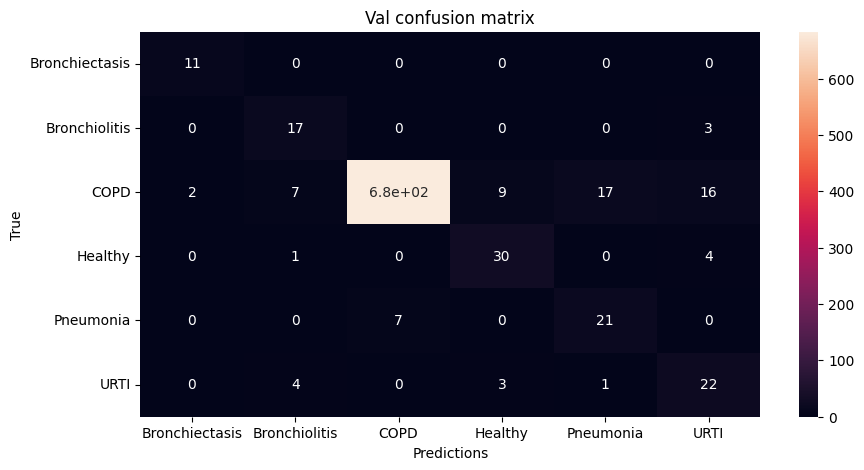


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 75:

Train Accuracy: 0.9580745341614907

Train Loss: 0.13033127149000115

Train F1 Score: 0.9500467392228404

Val Accuracy: 0.8814102564102564
\Val Loss: 0.40050317691984

Val F1 Score: 0.6579820248815749




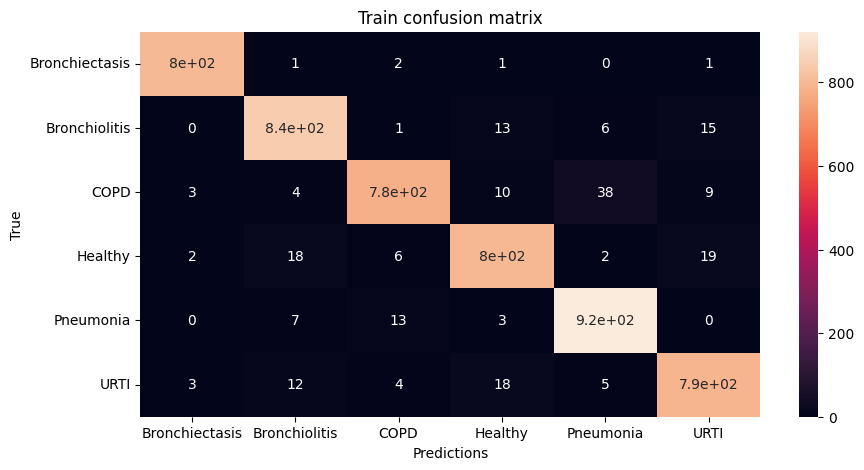

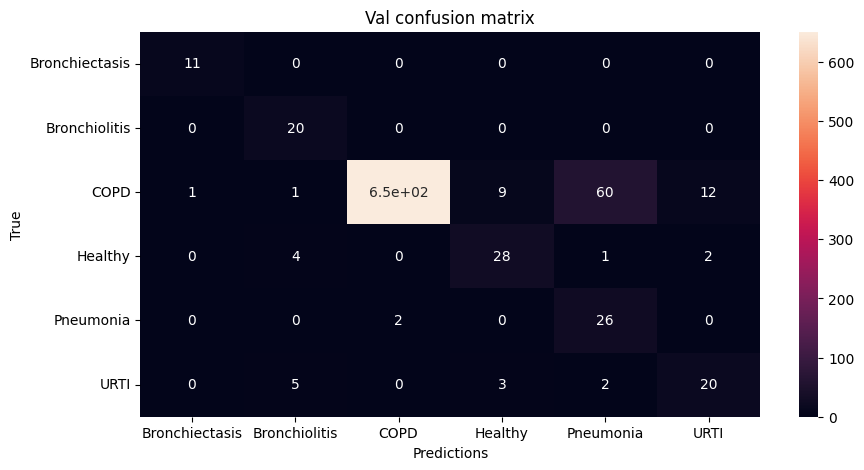


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 76:

Train Accuracy: 0.940163043478261

Train Loss: 0.19297160621246565

Train F1 Score: 0.9348935595950725

Val Accuracy: 0.9346509971509972
\Val Loss: 0.29284002631040357

Val F1 Score: 0.7424937906088652




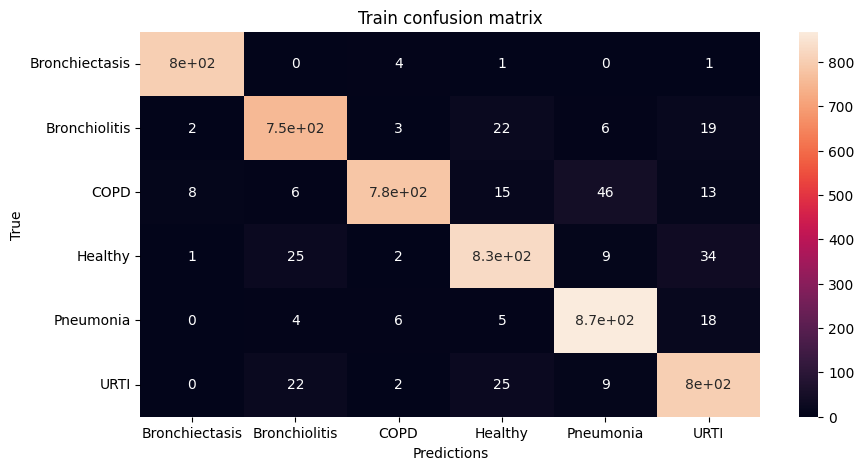

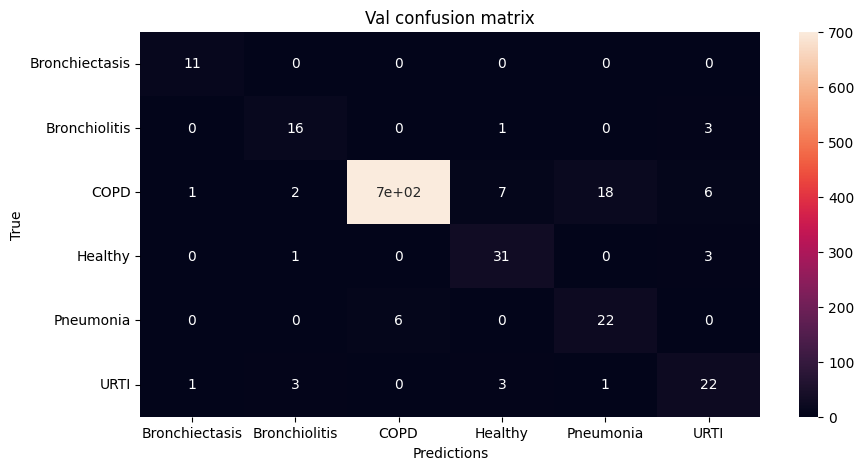


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 77:

Train Accuracy: 0.9598214285714286

Train Loss: 0.12944130212508187

Train F1 Score: 0.9527442936571489

Val Accuracy: 0.9340277777777778
\Val Loss: 0.31106698099109864

Val F1 Score: 0.7116096510931298




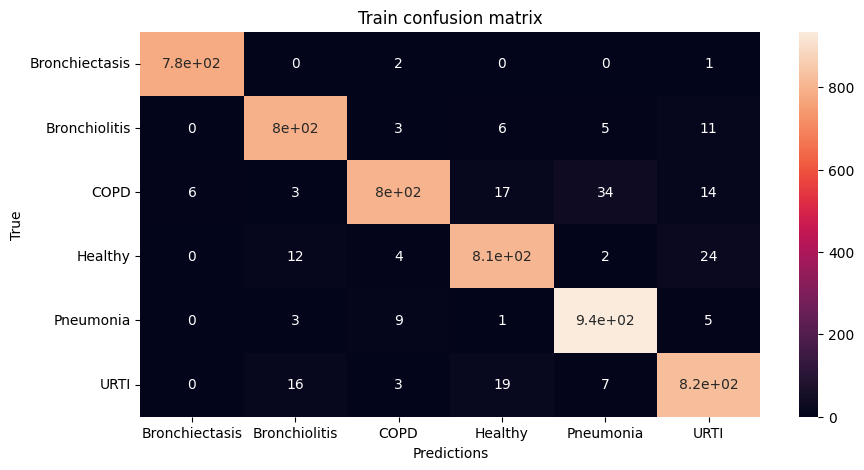

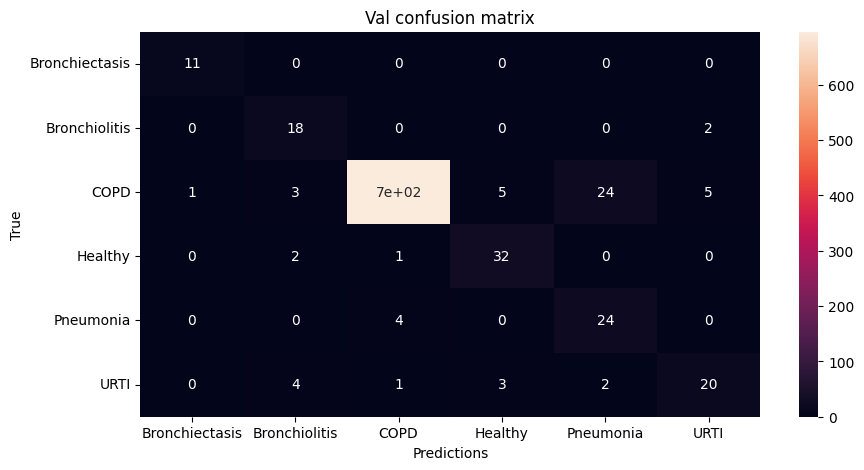


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 78:

Train Accuracy: 0.9643711180124223

Train Loss: 0.11140663183427282

Train F1 Score: 0.9584291677297272

Val Accuracy: 0.8929843304843305
\Val Loss: 0.366365626592327

Val F1 Score: 0.6638304447686231




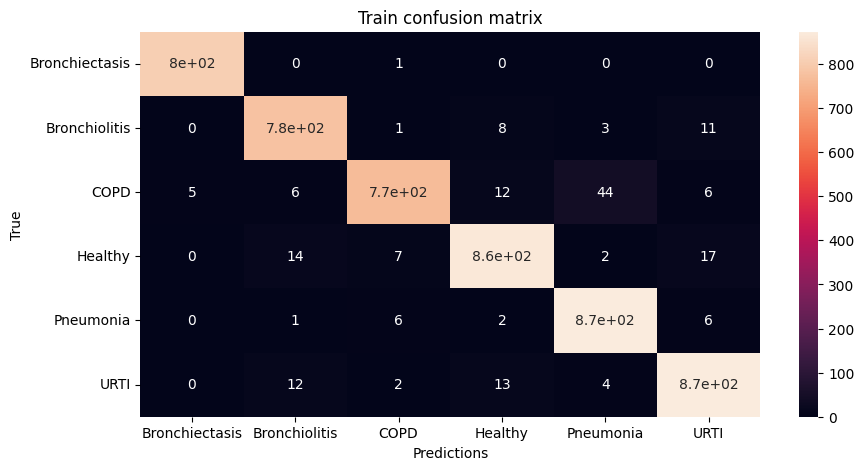

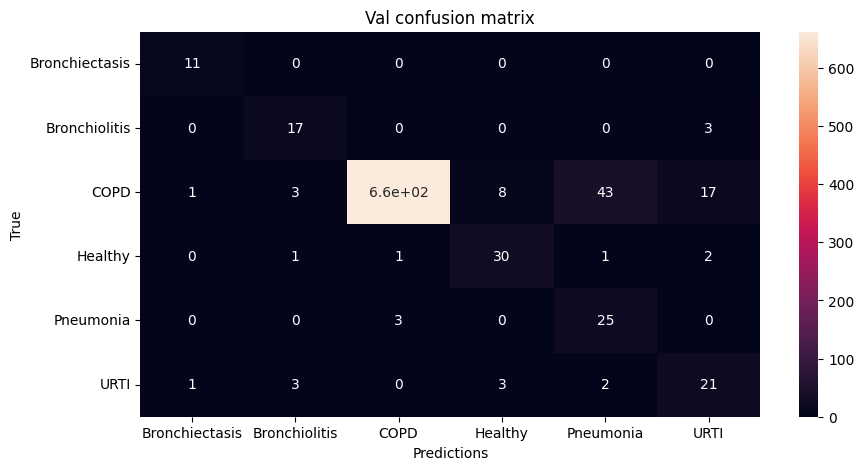


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 79:

Train Accuracy: 0.9622903726708075

Train Loss: 0.11646398213570533

Train F1 Score: 0.9596604682643961

Val Accuracy: 0.9042913105413105
\Val Loss: 0.33468937984219305

Val F1 Score: 0.7024538781907823




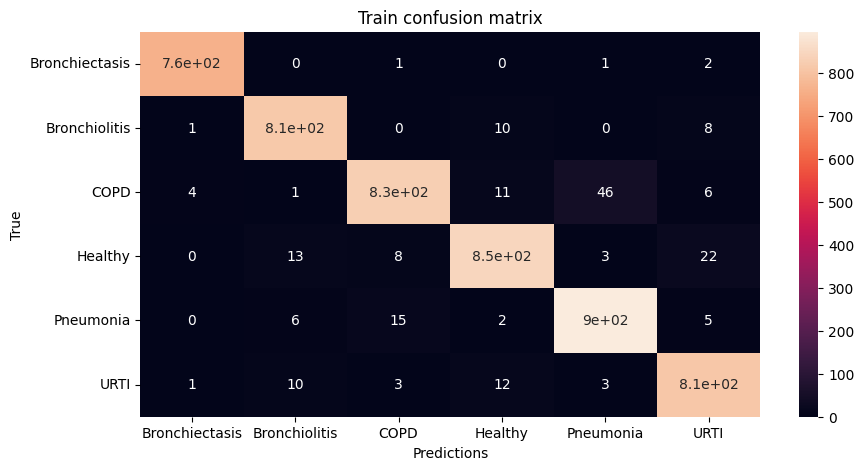

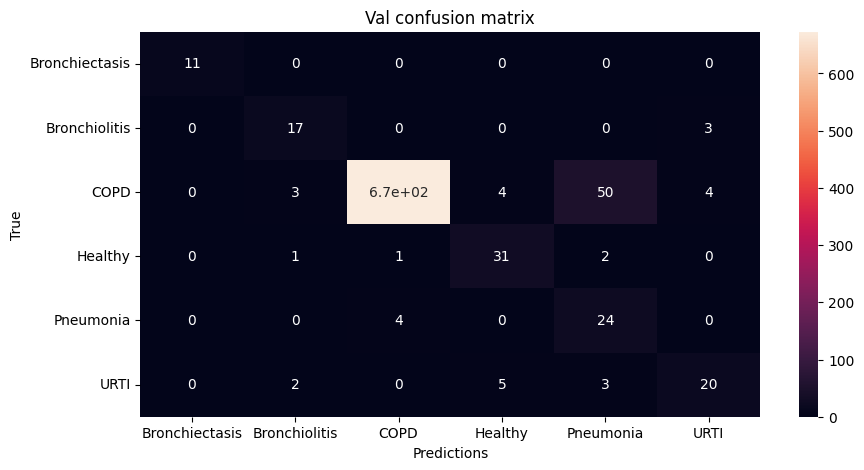


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 80:

Train Accuracy: 0.9670885093167702

Train Loss: 0.10694148272611433

Train F1 Score: 0.9632064818595507

Val Accuracy: 0.899928774928775
\Val Loss: 0.4086522277858522

Val F1 Score: 0.6580536365509033




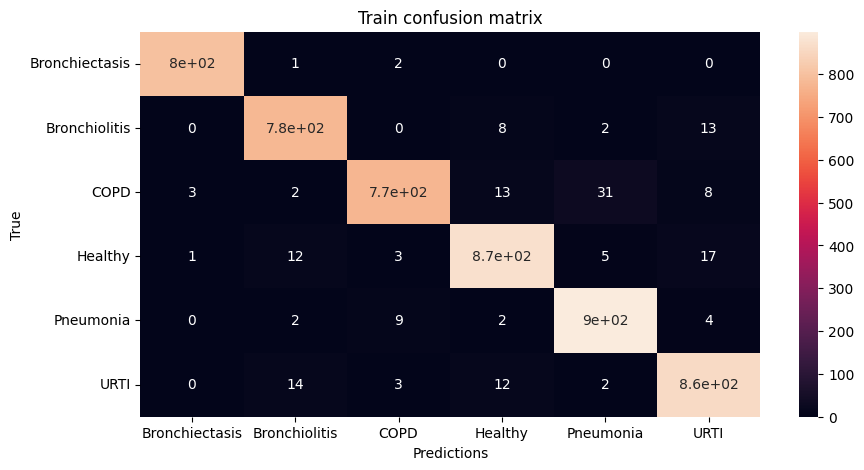

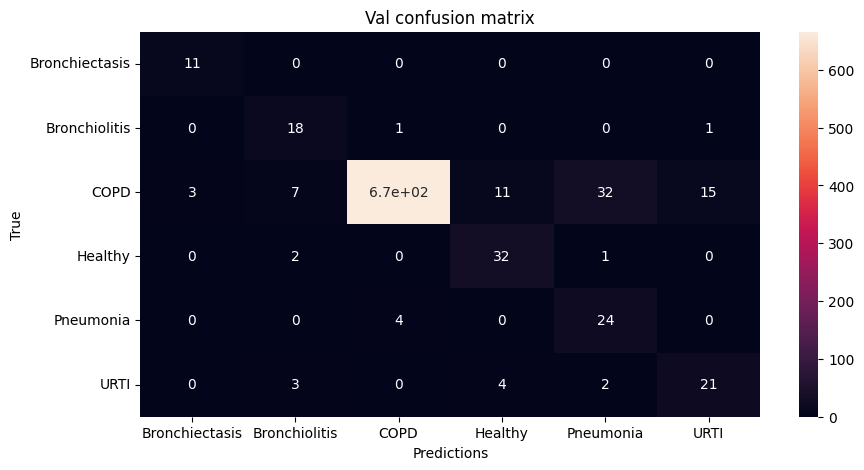


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 81:

Train Accuracy: 0.9401086956521738

Train Loss: 0.20478356735468467

Train F1 Score: 0.9340150071227032

Val Accuracy: 0.9161324786324786
\Val Loss: 0.3835022756484924

Val F1 Score: 0.7229329369686268




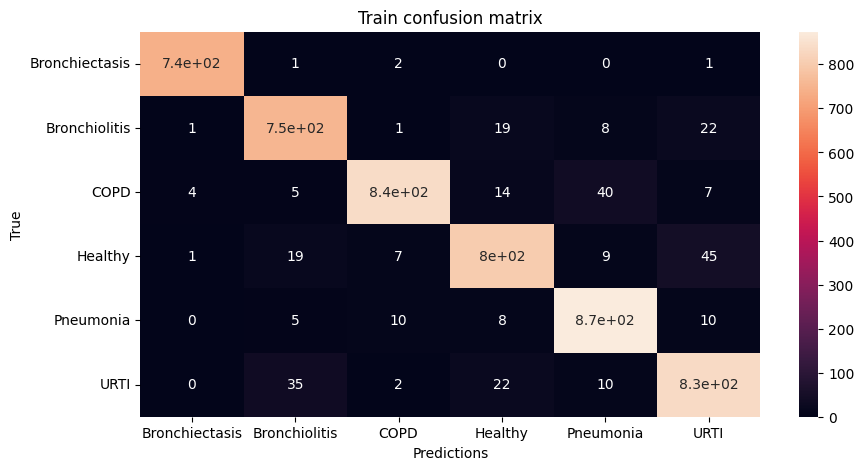

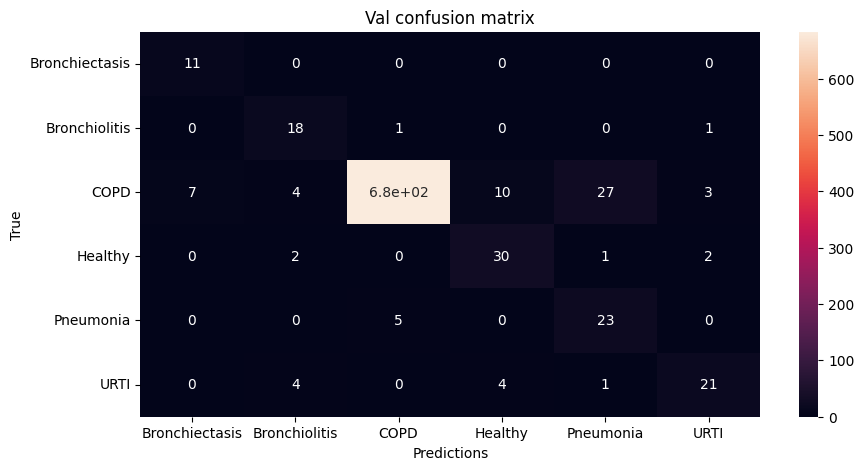


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 82:

Train Accuracy: 0.9612655279503105

Train Loss: 0.14107037144163564

Train F1 Score: 0.9578654632805297

Val Accuracy: 0.9123931623931624
\Val Loss: 0.32456745931671727

Val F1 Score: 0.6952009322466673




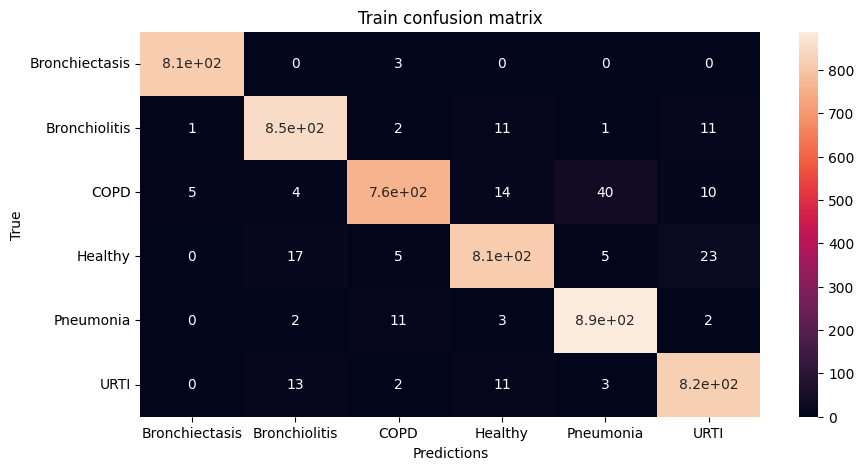

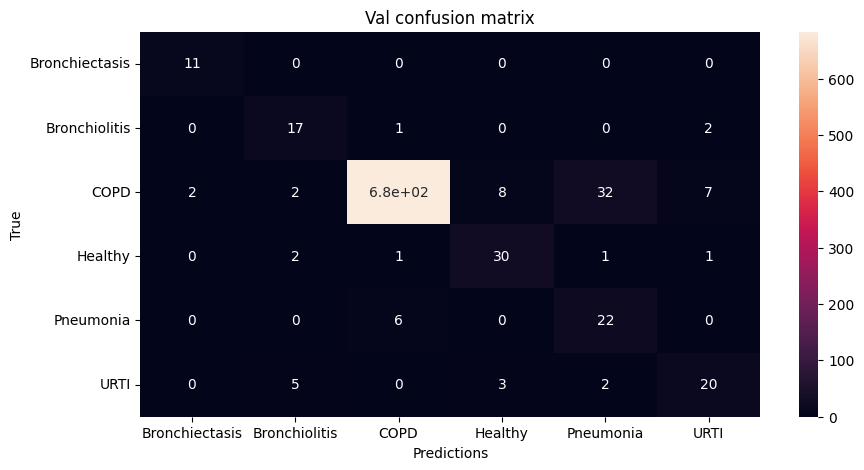


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 83:

Train Accuracy: 0.9576863354037267

Train Loss: 0.13936650771532

Train F1 Score: 0.9503333146527687

Val Accuracy: 0.9300213675213675
\Val Loss: 0.29388602366843436

Val F1 Score: 0.7638973262574937




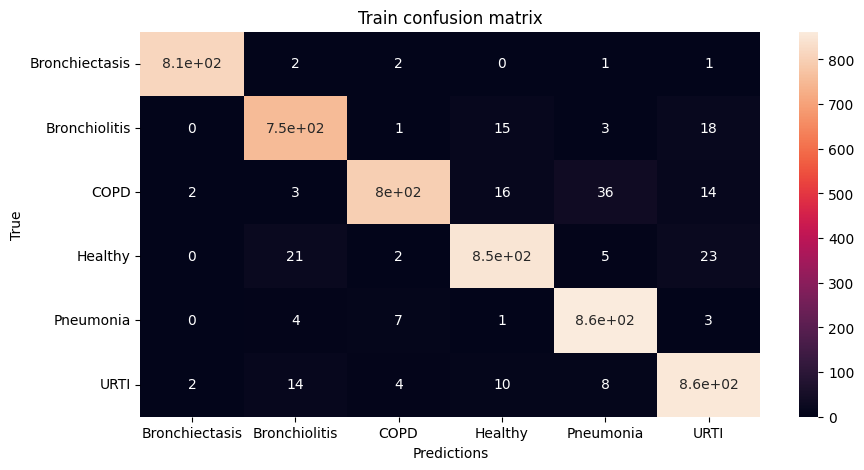

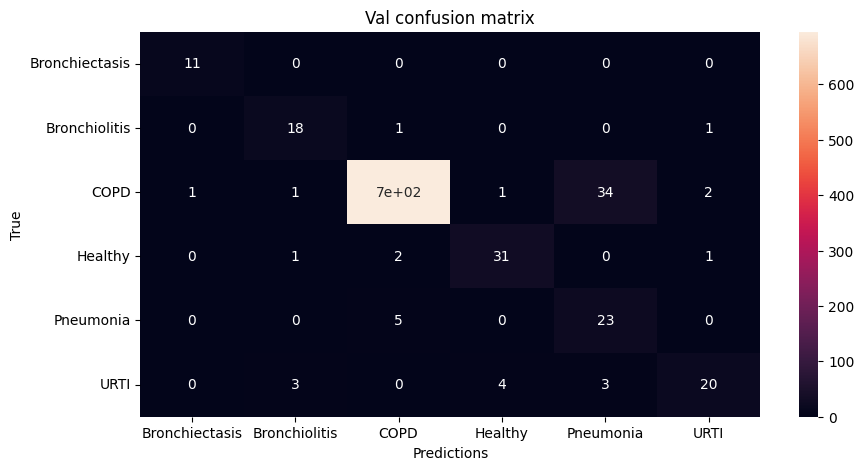


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 84:

Train Accuracy: 0.9615993788819875

Train Loss: 0.12414695888393275

Train F1 Score: 0.9569060236030484

Val Accuracy: 0.9234330484330484
\Val Loss: 0.358580409652657

Val F1 Score: 0.6885016593668196




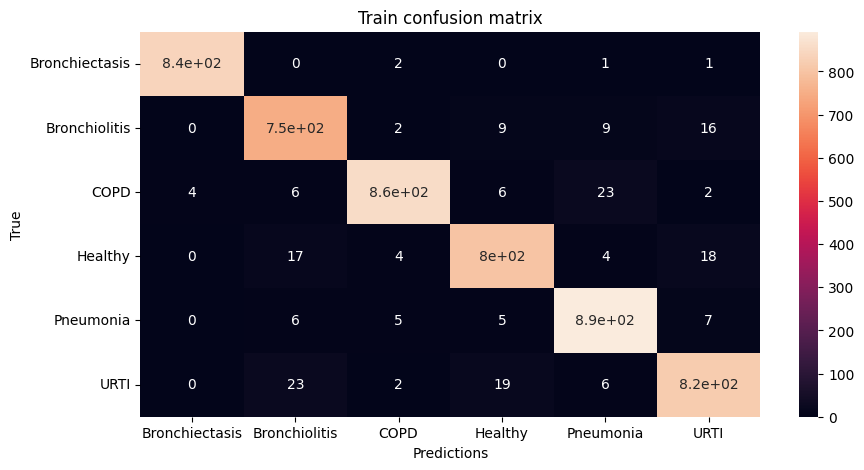

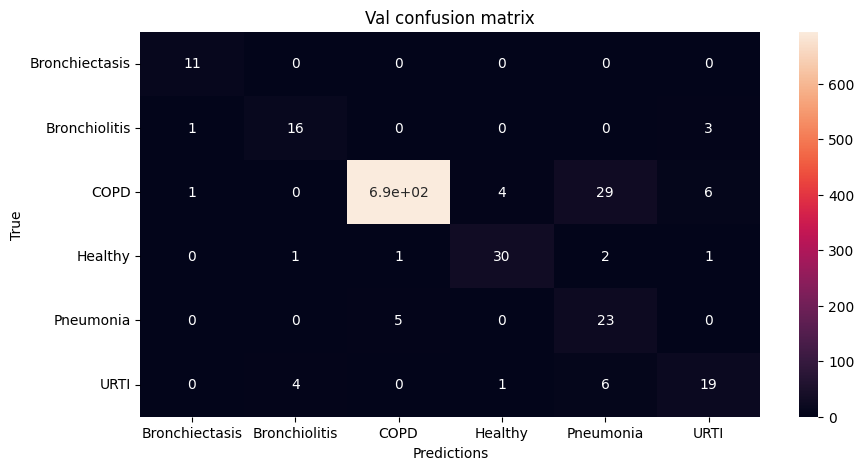


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 85:

Train Accuracy: 0.9645652173913043

Train Loss: 0.1198082521170239

Train F1 Score: 0.9611618244870109

Val Accuracy: 0.9360754985754985
\Val Loss: 0.30563971241591154

Val F1 Score: 0.7191539362624839




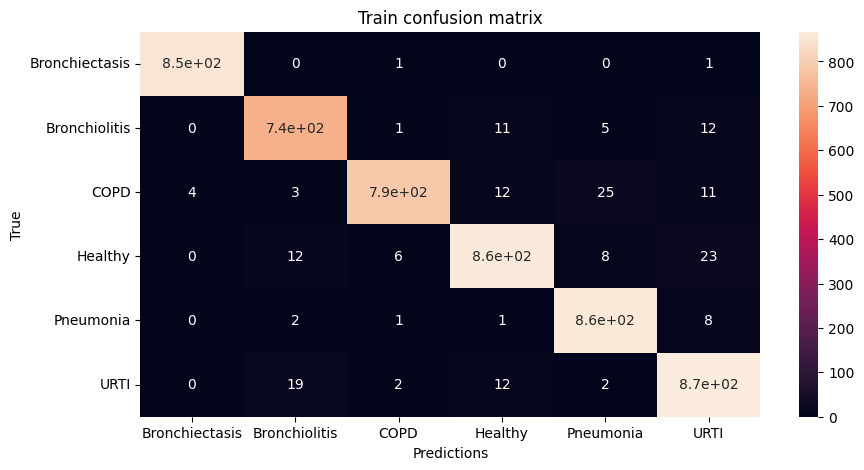

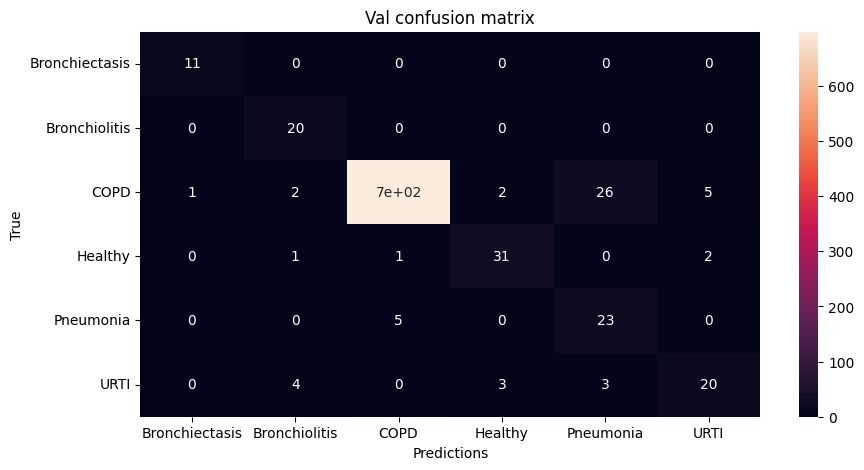


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 86:

Train Accuracy: 0.970442546583851

Train Loss: 0.08593298056342216

Train F1 Score: 0.9674753976164397

Val Accuracy: 0.9239672364672364
\Val Loss: 0.33151833715210494

Val F1 Score: 0.7102578591417383




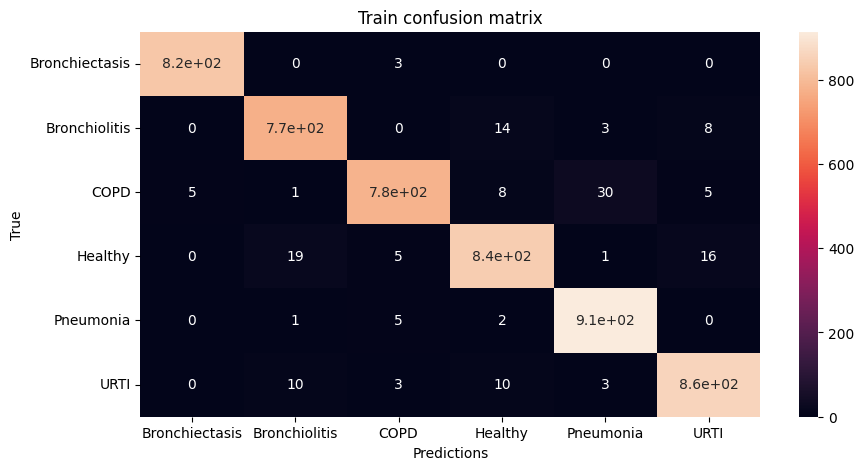

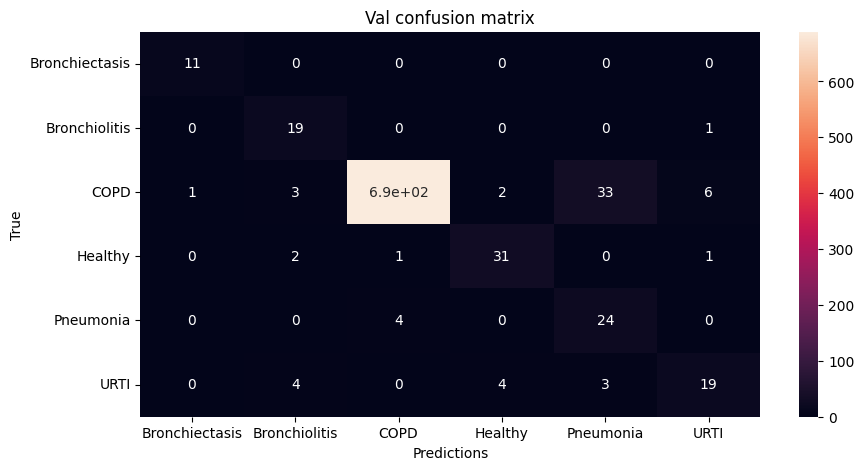


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 87:

Train Accuracy: 0.9634549689440994

Train Loss: 0.1139016799839873

Train F1 Score: 0.9591082101282866

Val Accuracy: 0.9221866096866096
\Val Loss: 0.34019403697715866

Val F1 Score: 0.702123024949321




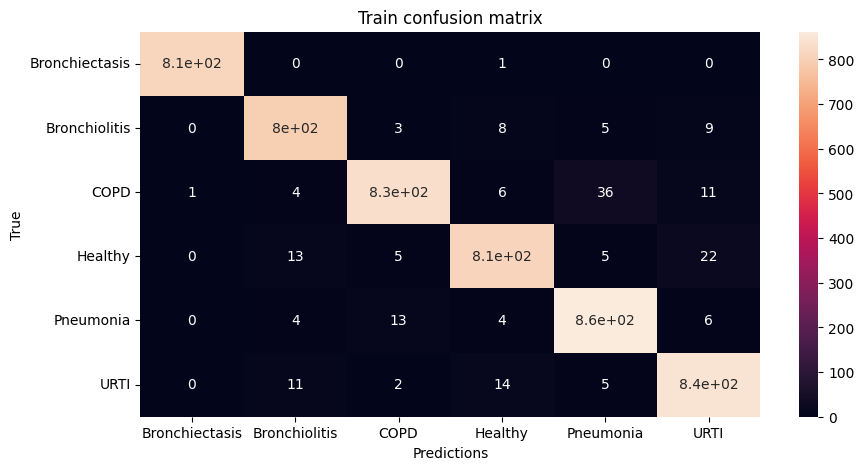

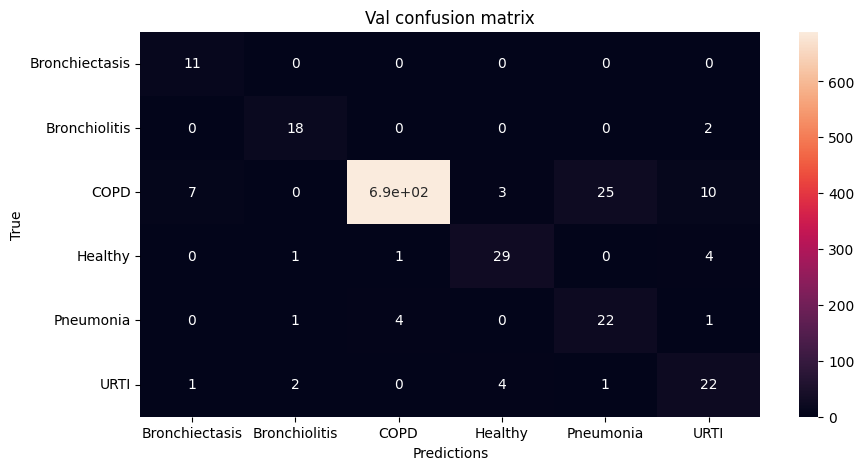


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 88:

Train Accuracy: 0.9587965838509317

Train Loss: 0.14223627785440557

Train F1 Score: 0.952931955734395

Val Accuracy: 0.9427528490028491
\Val Loss: 0.29198930896732406

Val F1 Score: 0.7442448139190674




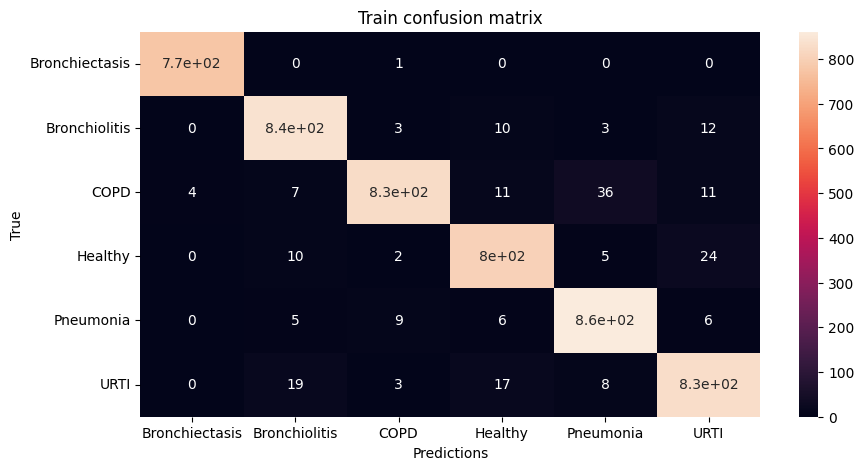

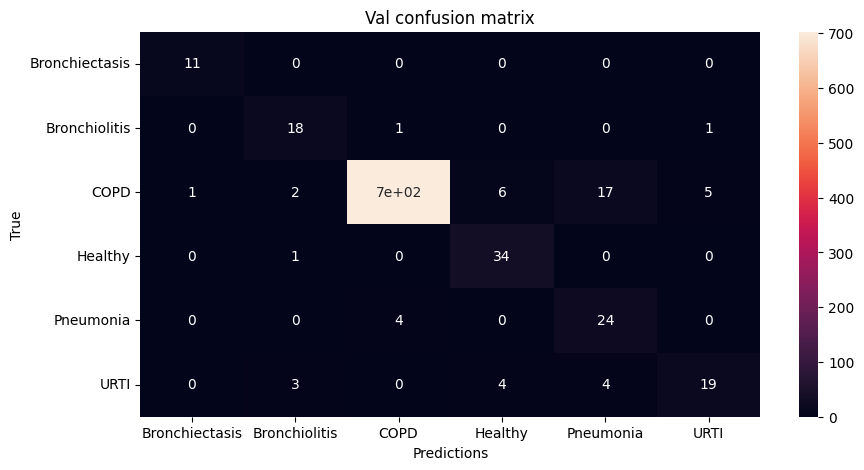


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 89:

Train Accuracy: 0.9518090062111801

Train Loss: 0.14969924387308012

Train F1 Score: 0.9432543316242857

Val Accuracy: 0.9188034188034188
\Val Loss: 0.31604279505295885

Val F1 Score: 0.713132361570994




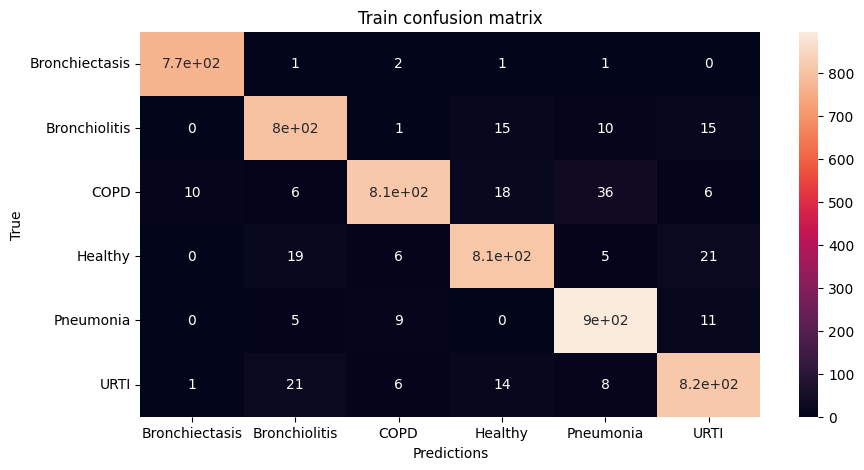

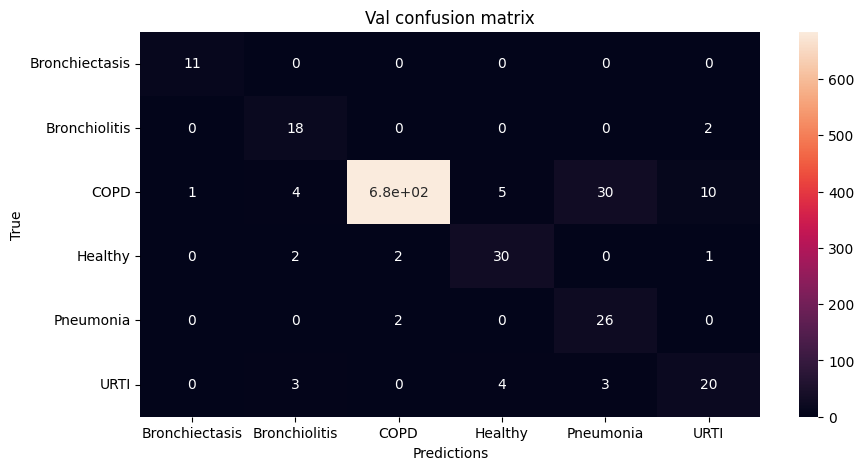


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 90:

Train Accuracy: 0.9597127329192546

Train Loss: 0.1314490524869736

Train F1 Score: 0.9563850405053322

Val Accuracy: 0.917289886039886
\Val Loss: 0.3610582546917377

Val F1 Score: 0.7190778001591012




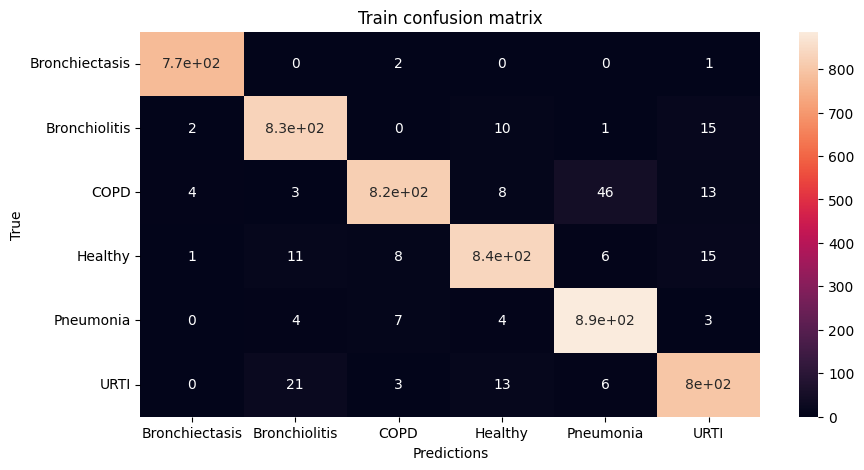

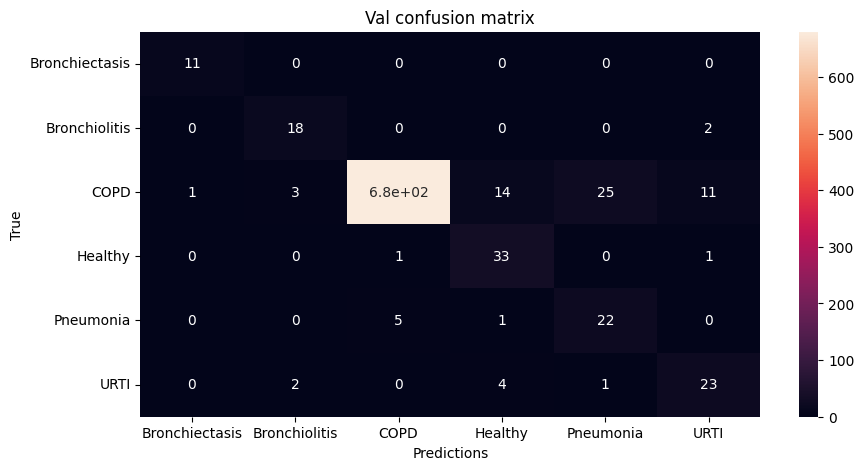


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 91:

Train Accuracy: 0.9602950310559005

Train Loss: 0.14127054549059512

Train F1 Score: 0.9561038028379405

Val Accuracy: 0.8996616809116809
\Val Loss: 0.325285312305722

Val F1 Score: 0.6713998328756403




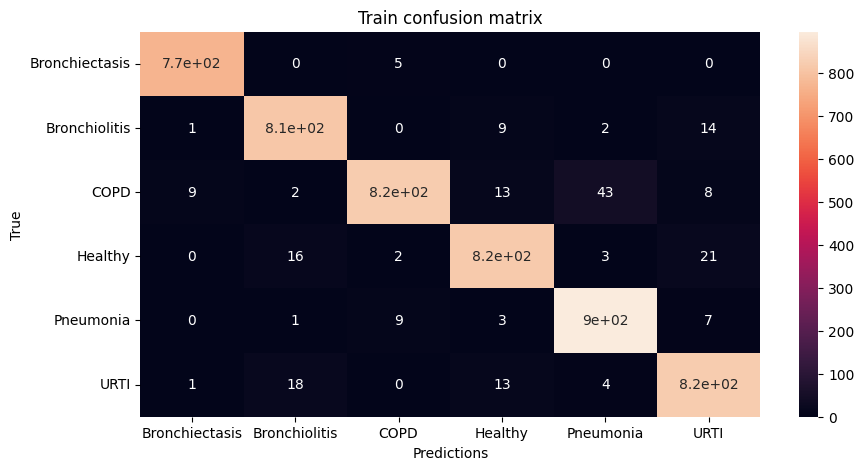

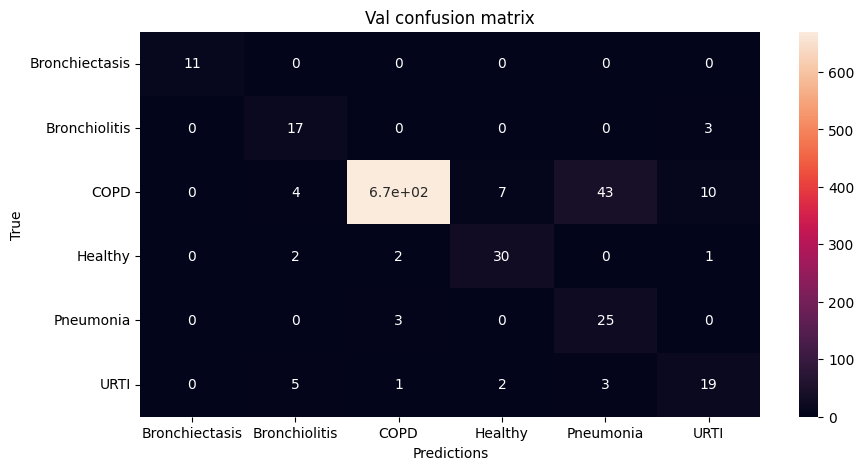


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 92:

Train Accuracy: 0.9656444099378882

Train Loss: 0.10647354149172858

Train F1 Score: 0.9599589412997228

Val Accuracy: 0.905715811965812
\Val Loss: 0.49321421409991606

Val F1 Score: 0.7016927025936268




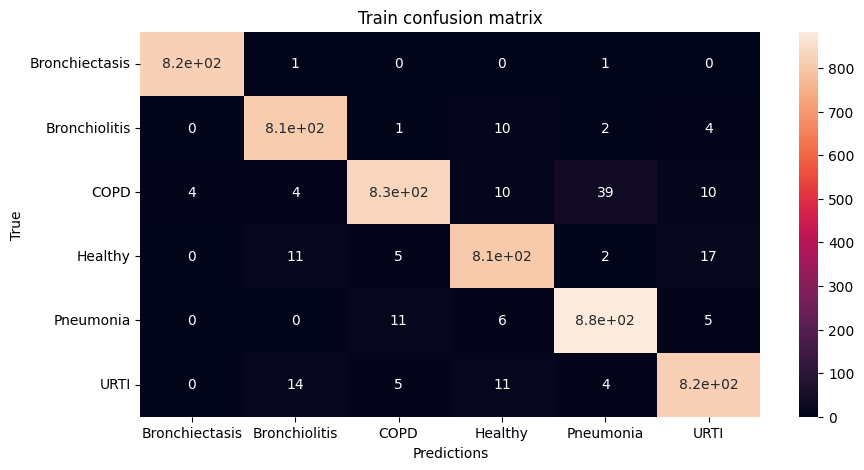

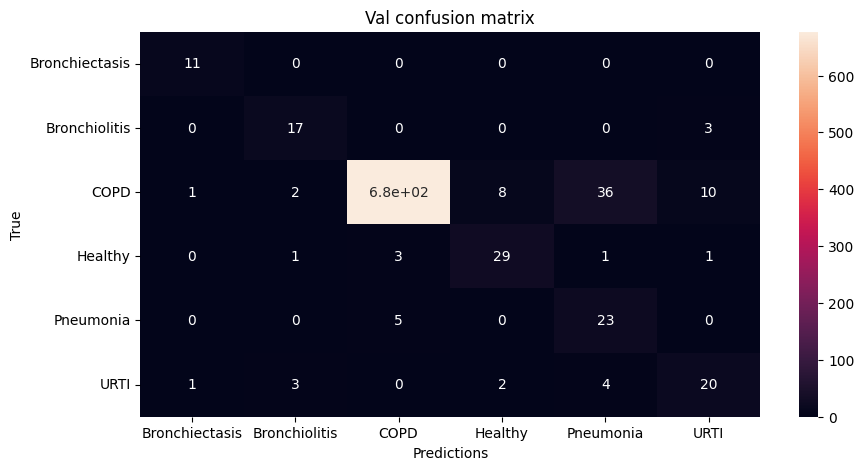


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 93:

Train Accuracy: 0.9726319875776398

Train Loss: 0.0965500486065975

Train F1 Score: 0.9698607362575412

Val Accuracy: 0.9131944444444444
\Val Loss: 0.3833670860967012

Val F1 Score: 0.7085902779190628




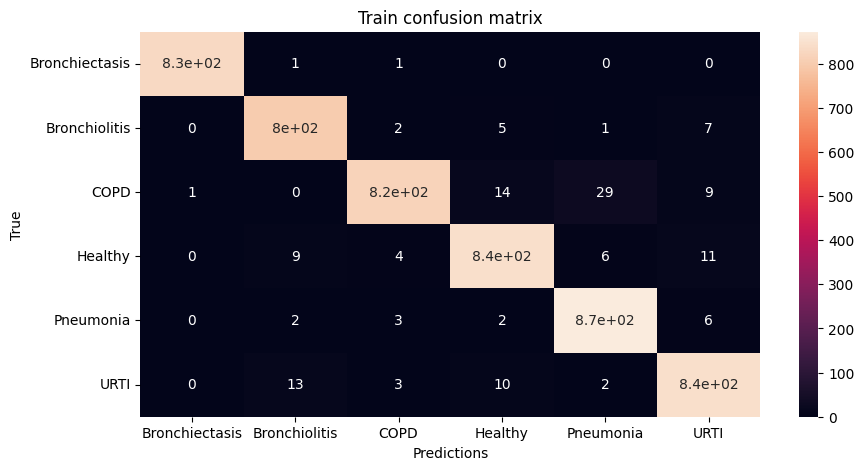

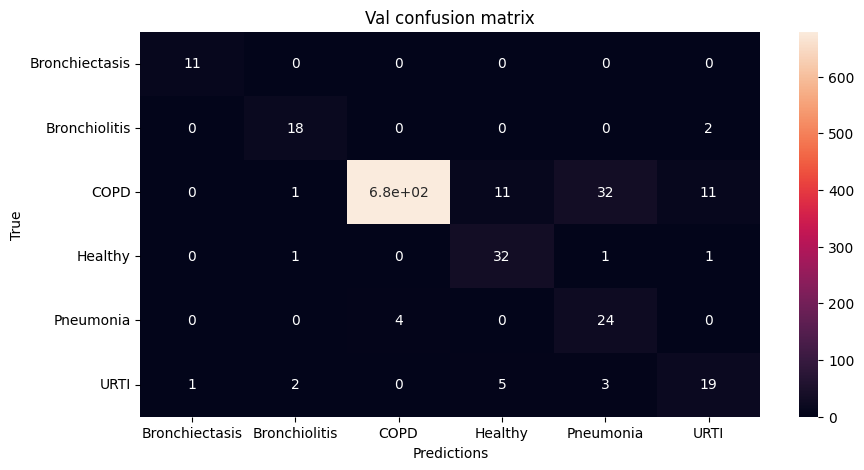


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 94:

Train Accuracy: 0.9763198757763976

Train Loss: 0.0814356485104061

Train F1 Score: 0.9745334301676069

Val Accuracy: 0.9260149572649573
\Val Loss: 0.3576935039902175

Val F1 Score: 0.7385538970982587




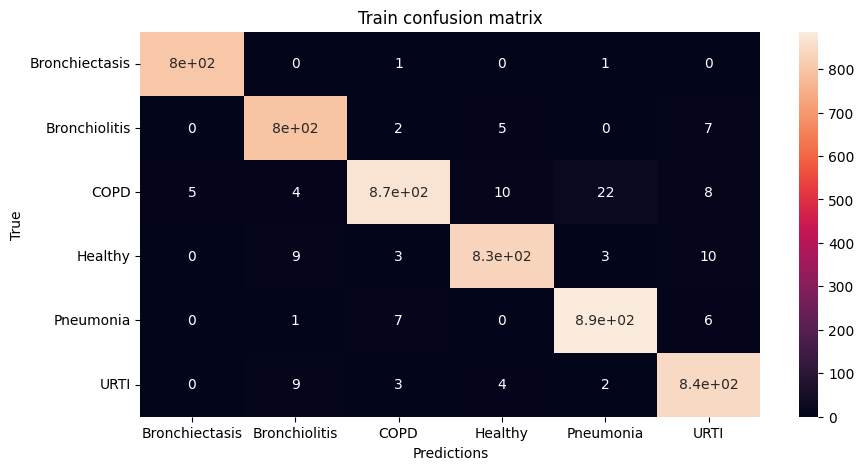

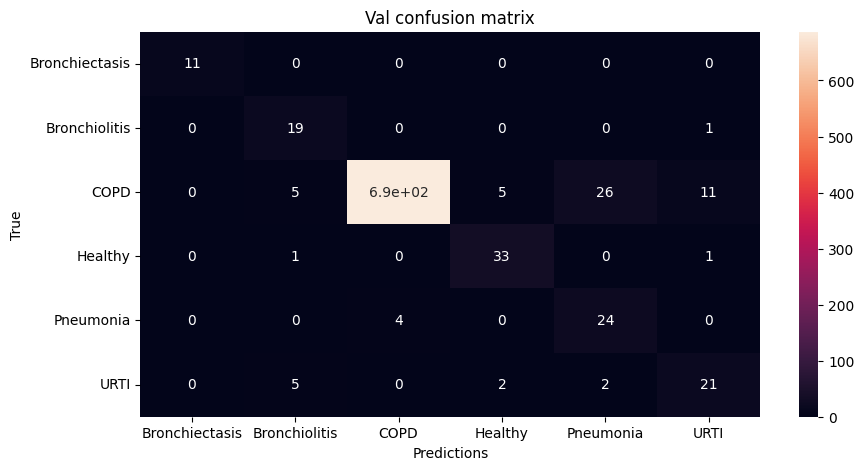


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 95:

Train Accuracy: 0.9561645962732919

Train Loss: 0.14258810005480457

Train F1 Score: 0.9506079269492108

Val Accuracy: 0.9149750712250713
\Val Loss: 0.3829305788019189

Val F1 Score: 0.7136560126587197




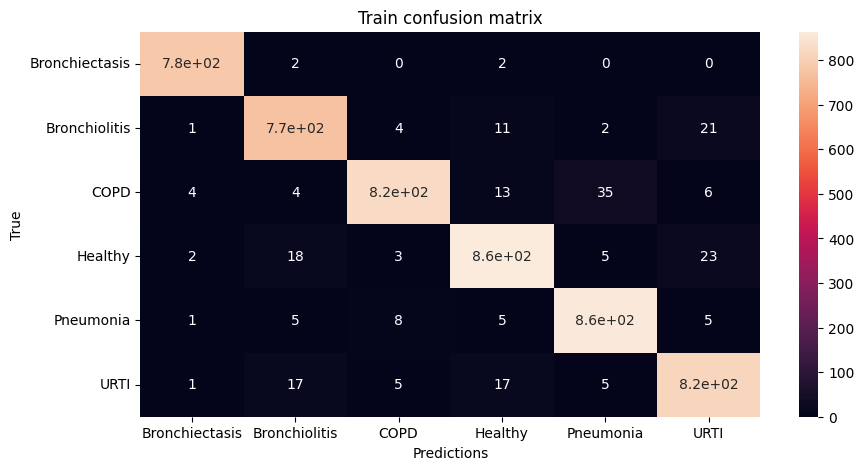

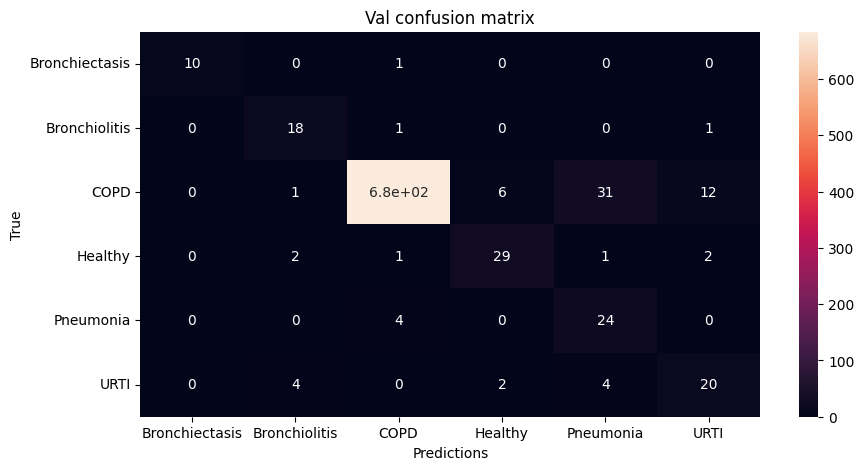


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 96:

Train Accuracy: 0.9703027950310559

Train Loss: 0.0992105016224549

Train F1 Score: 0.9667489373165629

Val Accuracy: 0.9212962962962963
\Val Loss: 0.35556939653017455

Val F1 Score: 0.7019660174846649




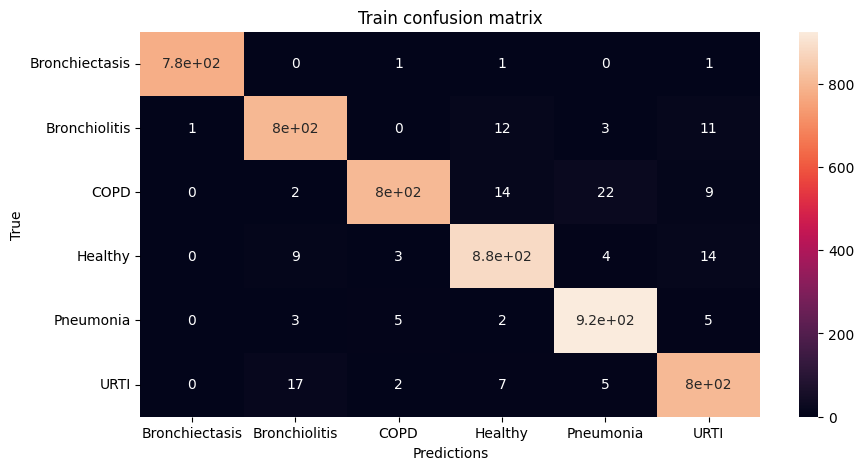

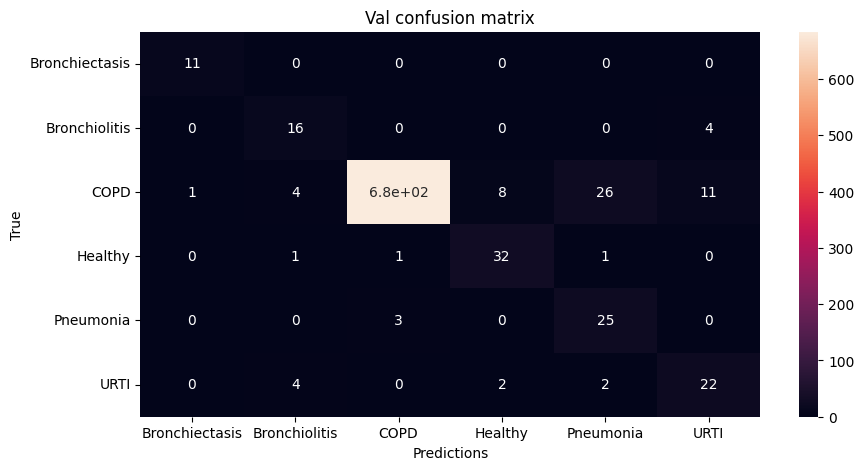


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 97:

Train Accuracy: 0.9681133540372672

Train Loss: 0.10461500849826436

Train F1 Score: 0.9642275882803876

Val Accuracy: 0.9017094017094017
\Val Loss: 0.3825474556673456

Val F1 Score: 0.6475813973833013




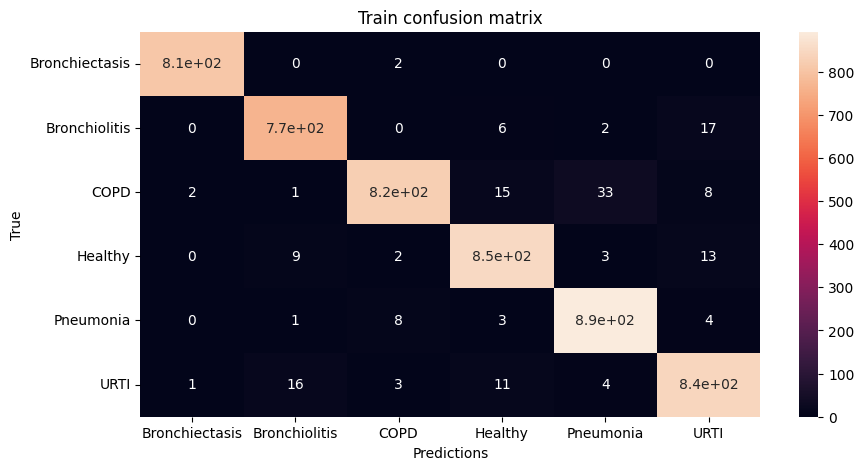

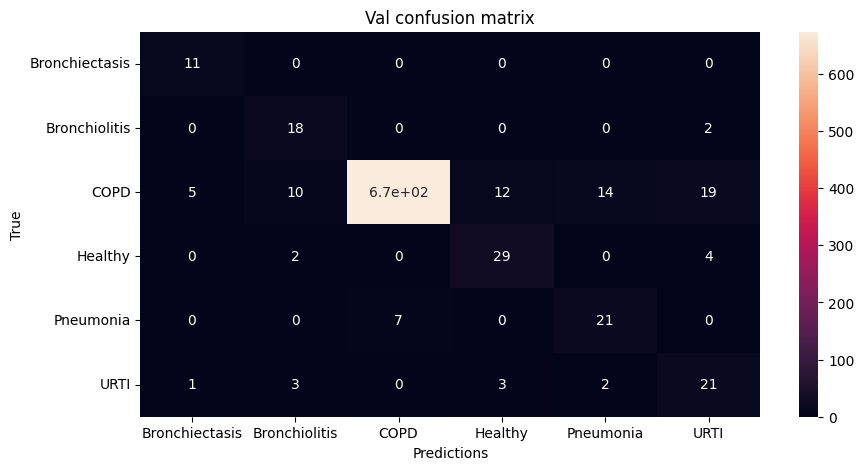


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 98:

Train Accuracy: 0.968361801242236

Train Loss: 0.10078081311310948

Train F1 Score: 0.965515721288527

Val Accuracy: 0.9261039886039887
\Val Loss: 0.3309797171365332

Val F1 Score: 0.7358691173571127




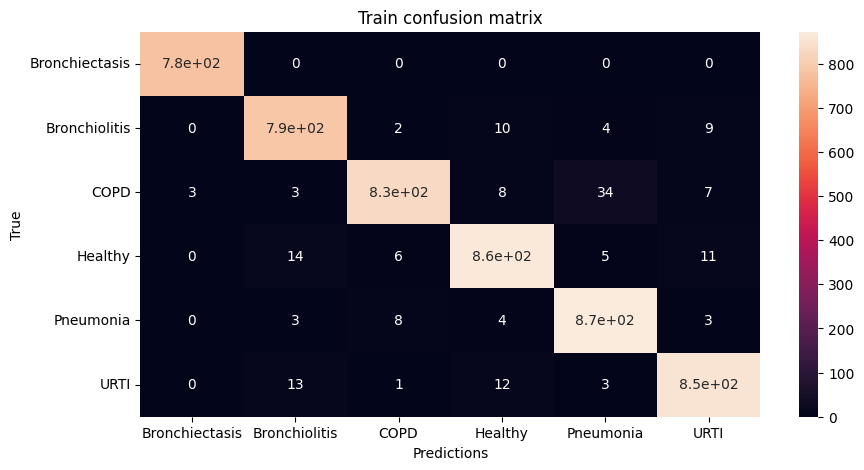

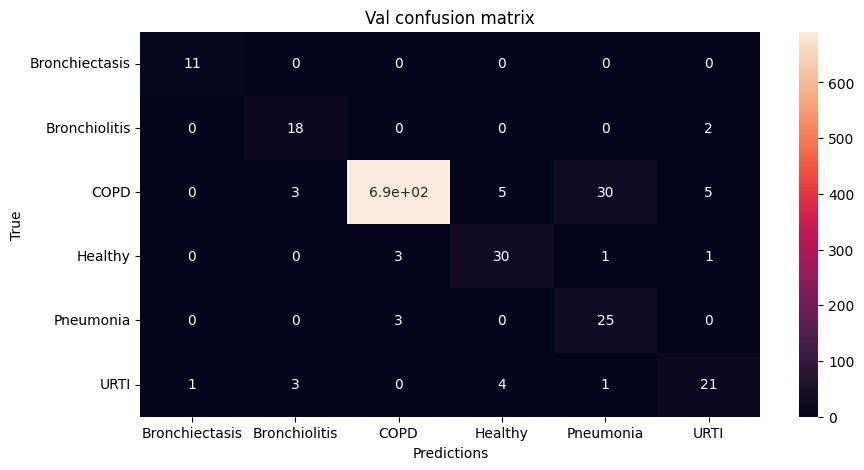


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 99:

Train Accuracy: 0.9526708074534161

Train Loss: 0.15361011853753964

Train F1 Score: 0.9475499769175275

Val Accuracy: 0.9022435897435898
\Val Loss: 0.33574277466094055

Val F1 Score: 0.6575394184501083




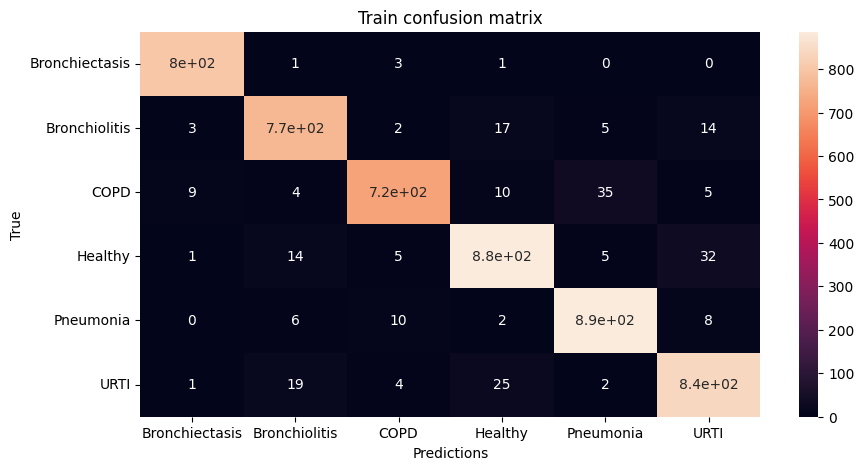

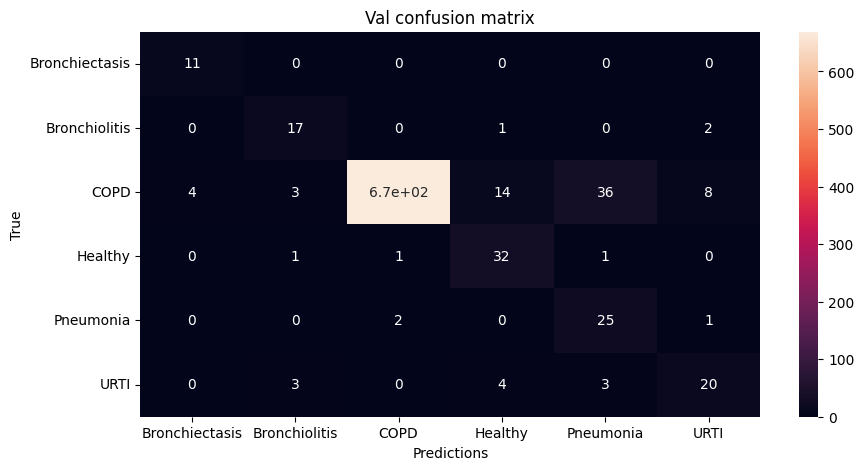


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 100:

Train Accuracy: 0.95472049689441

Train Loss: 0.14433742443573958

Train F1 Score: 0.9484752316652618

Val Accuracy: 0.9378561253561253
\Val Loss: 0.32955875896193365

Val F1 Score: 0.7384414297563059




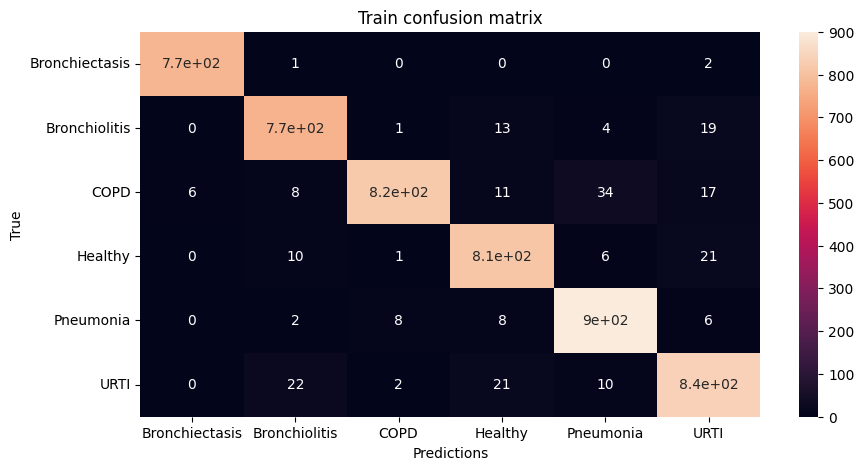

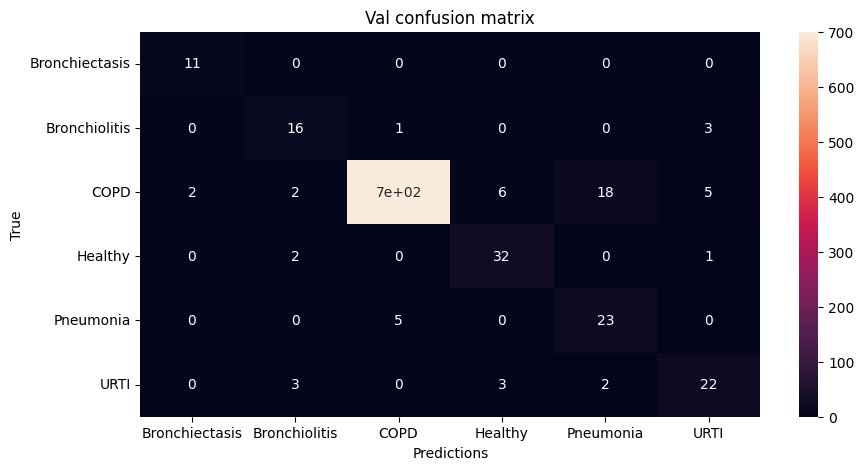

In [21]:
epochs=100
train_model(model1,epochs)


Training:


  0%|          | 0/27 [00:00<?, ?it/s]


Test Accuracy: 0.9267592592592593

Test Loss: 0.31708464945700987

Test F1 Score: 0.7700087361865573




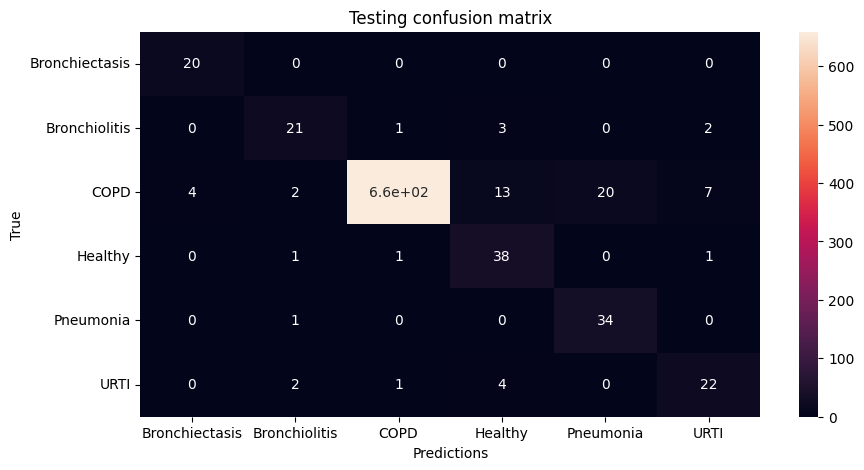

In [25]:
test_model(model1)

In [27]:
torch.save(model1.state_dict(),"../models/model_conv1d_77f1.pt")

#### Training LSTM

  0%|          | 0/100 [00:00<?, ?it/s]


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 1:

Train Accuracy: 0.29579192546583855

Train Loss: 1.6439129824964156

Train F1 Score: 0.2030520856449878

Val Accuracy: 0.5104166666666666

Val Loss: 1.24854310353597

Val F1 Score: 0.20428889217200102




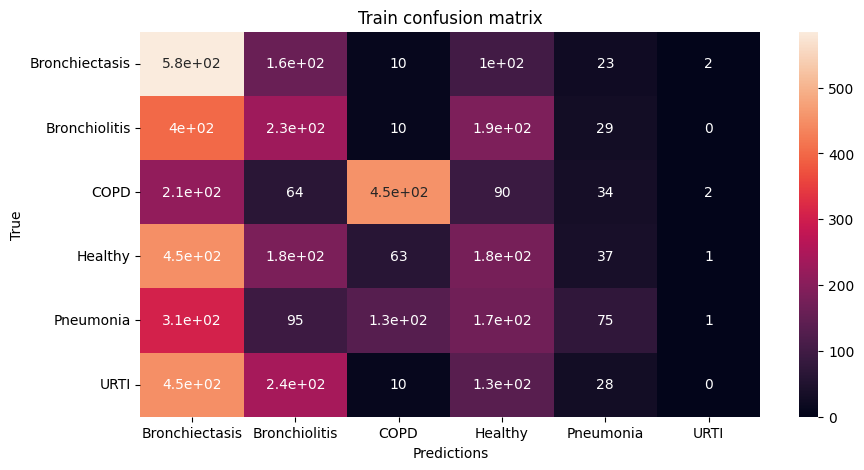

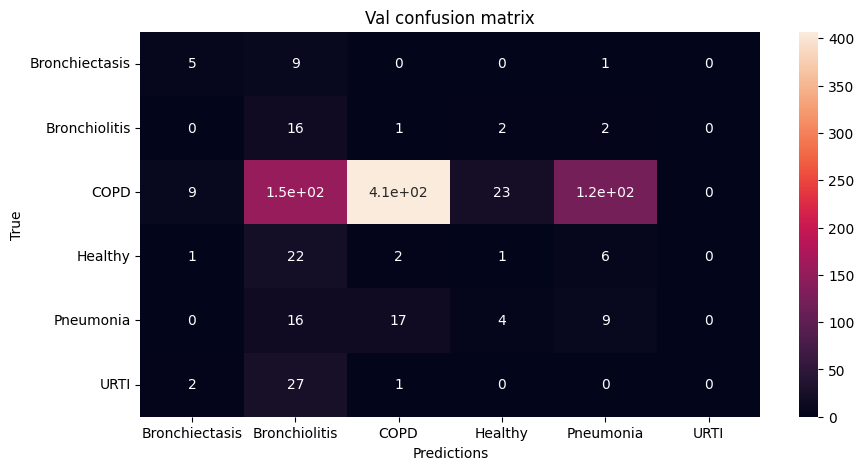


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 2:

Train Accuracy: 0.4430900621118013

Train Loss: 1.3713388402269493

Train F1 Score: 0.37473719395835947

Val Accuracy: 0.5364138176638177

Val Loss: 1.1240598647682756

Val F1 Score: 0.24236848702033362




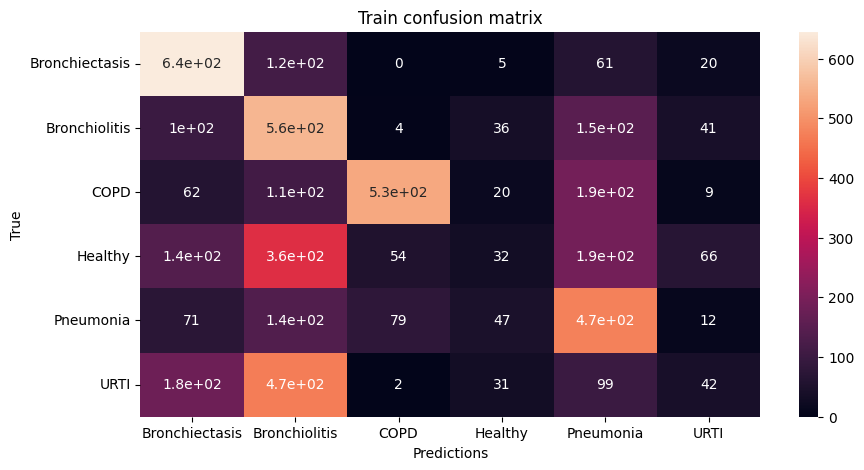

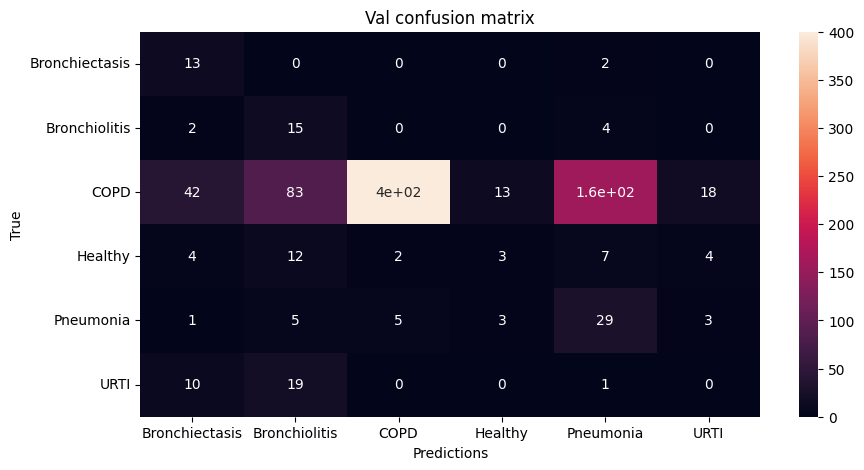


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 3:

Train Accuracy: 0.47958074534161493

Train Loss: 1.286729577535428

Train F1 Score: 0.42648017091780716

Val Accuracy: 0.600071225071225

Val Loss: 1.027357856432597

Val F1 Score: 0.28949592345290714




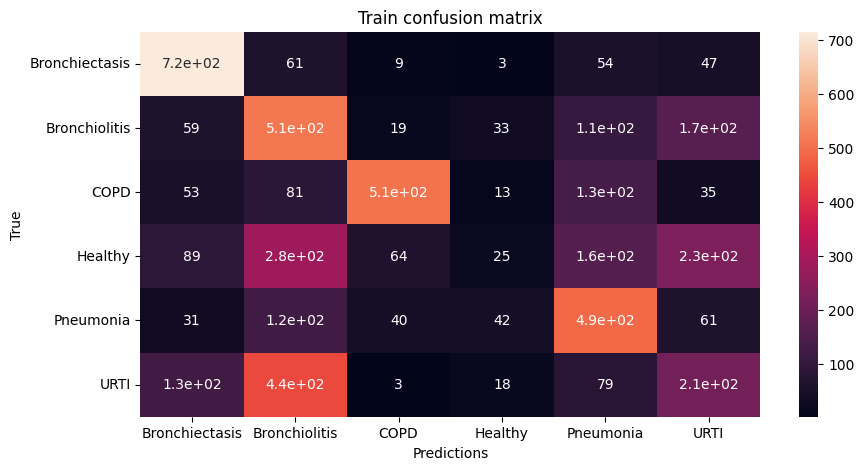

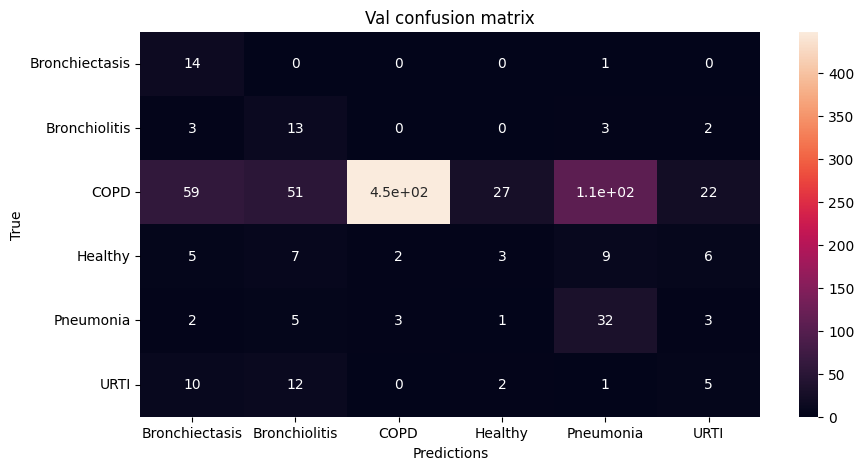


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 4:

Train Accuracy: 0.5244177018633541

Train Loss: 1.184575751331282

Train F1 Score: 0.47865669586643667

Val Accuracy: 0.6185897435897436

Val Loss: 1.0022845290325306

Val F1 Score: 0.291809543967247




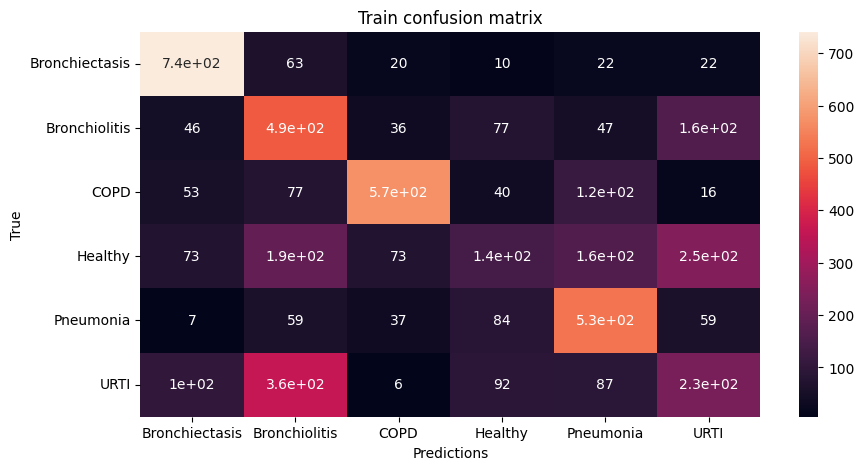

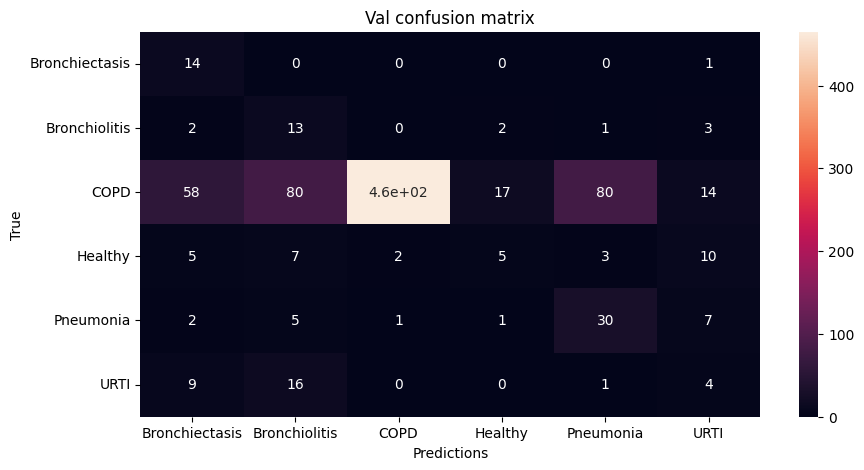


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 5:

Train Accuracy: 0.5366149068322981

Train Loss: 1.1421210873201026

Train F1 Score: 0.4893836486413612

Val Accuracy: 0.6292735042735044

Val Loss: 0.9828036824862162

Val F1 Score: 0.29681403659008165




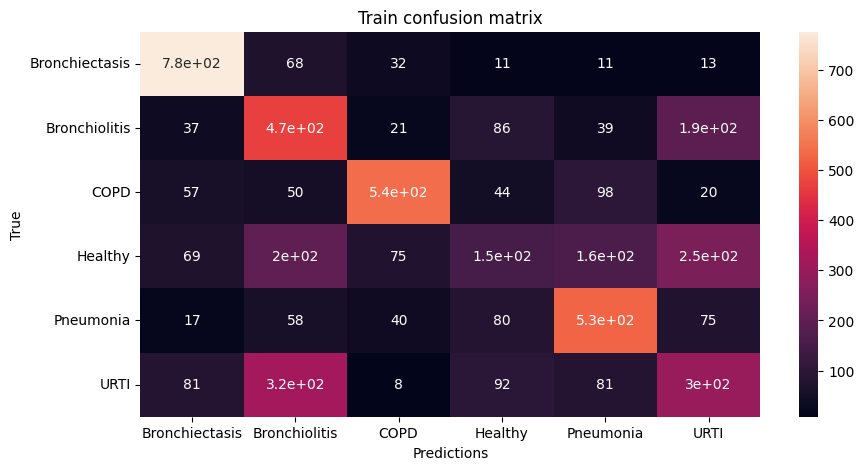

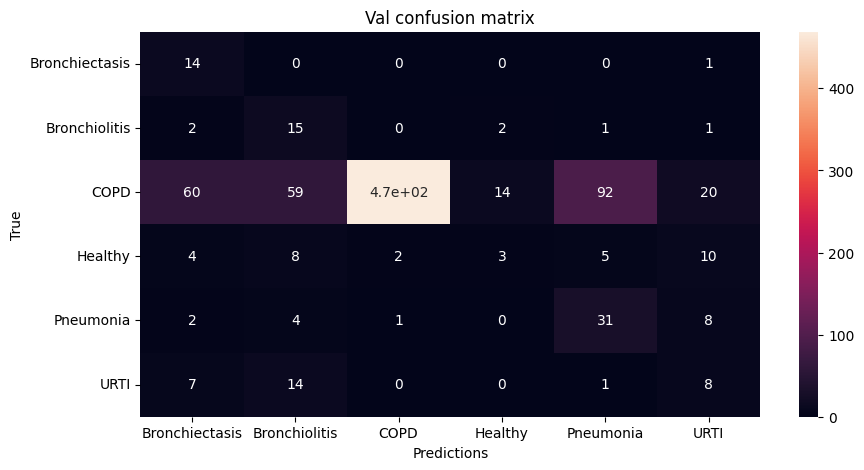


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 6:

Train Accuracy: 0.5821428571428571

Train Loss: 1.0489350164899174

Train F1 Score: 0.5429639675602409

Val Accuracy: 0.6481481481481481

Val Loss: 0.9180491986098113

Val F1 Score: 0.3081571702603941




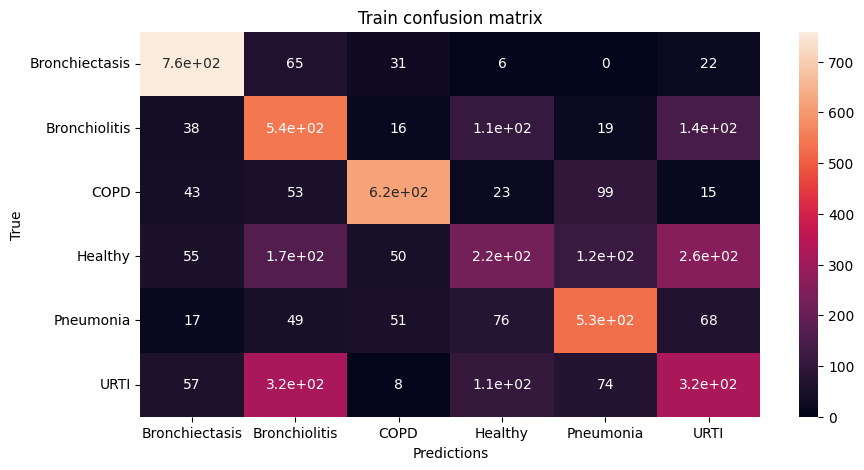

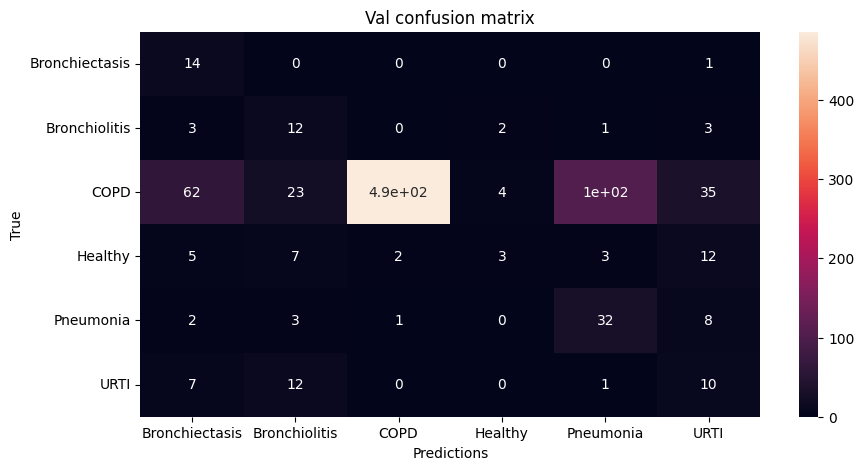


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 7:

Train Accuracy: 0.615527950310559

Train Loss: 0.9657564781467367

Train F1 Score: 0.575190080804114

Val Accuracy: 0.7062856125356126

Val Loss: 0.7468764494966578

Val F1 Score: 0.3925086143943999




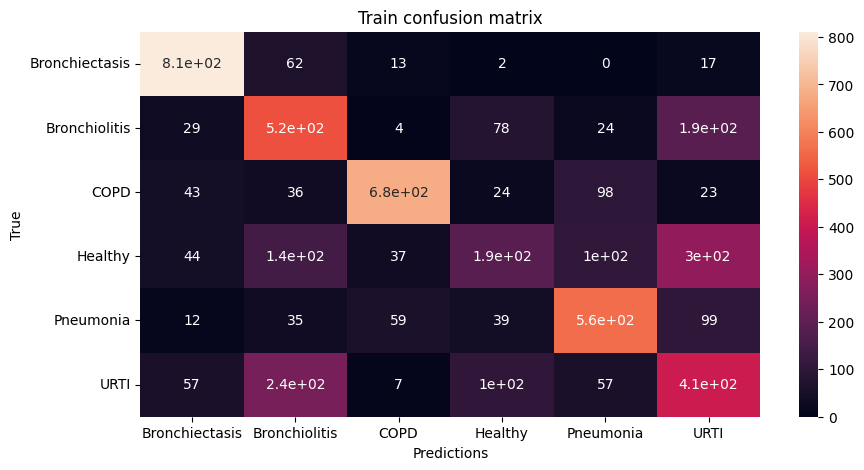

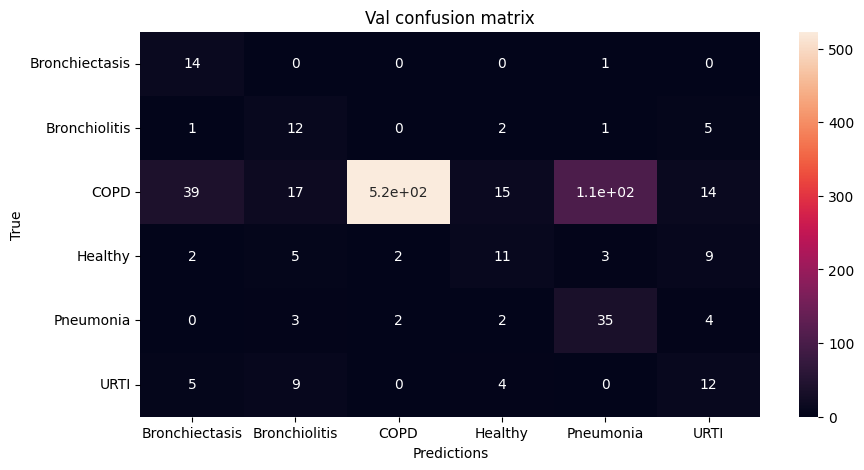


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 8:

Train Accuracy: 0.6371506211180124

Train Loss: 0.8960790397217555

Train F1 Score: 0.6054429335994009

Val Accuracy: 0.7148326210826211

Val Loss: 0.7617422121542471

Val F1 Score: 0.41217637724346584




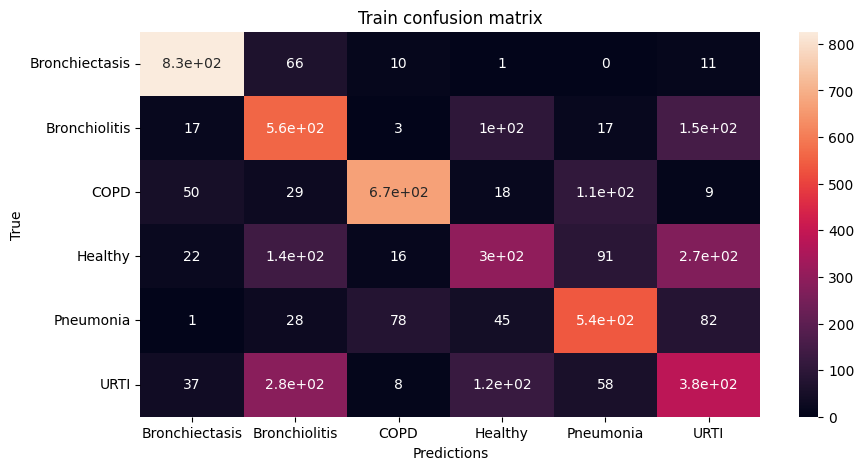

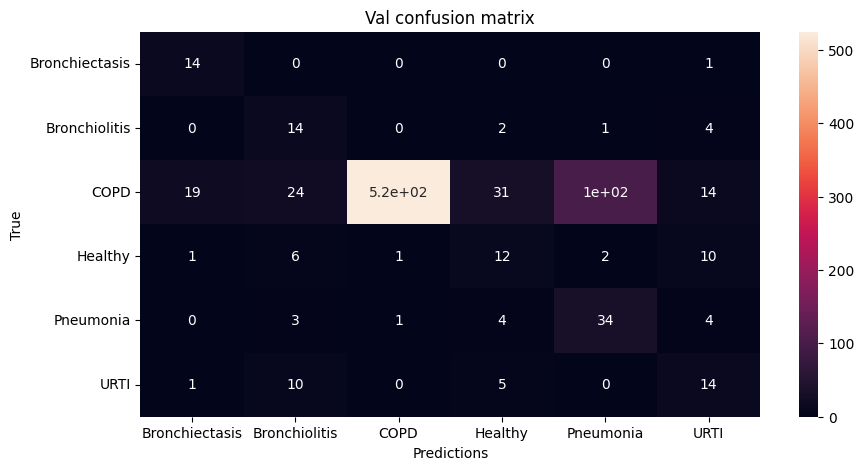


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 9:

Train Accuracy: 0.6526242236024845

Train Loss: 0.8549194106404086

Train F1 Score: 0.6217737466281985

Val Accuracy: 0.7047720797720798

Val Loss: 0.7259887324439155

Val F1 Score: 0.37223842960816844




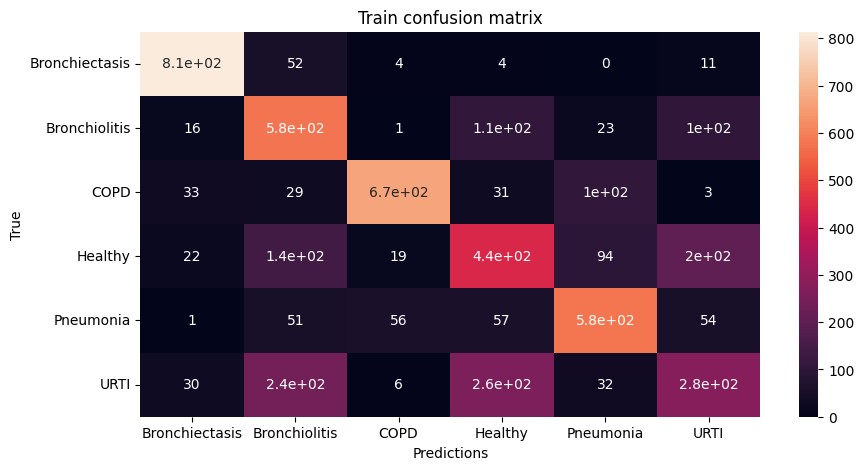

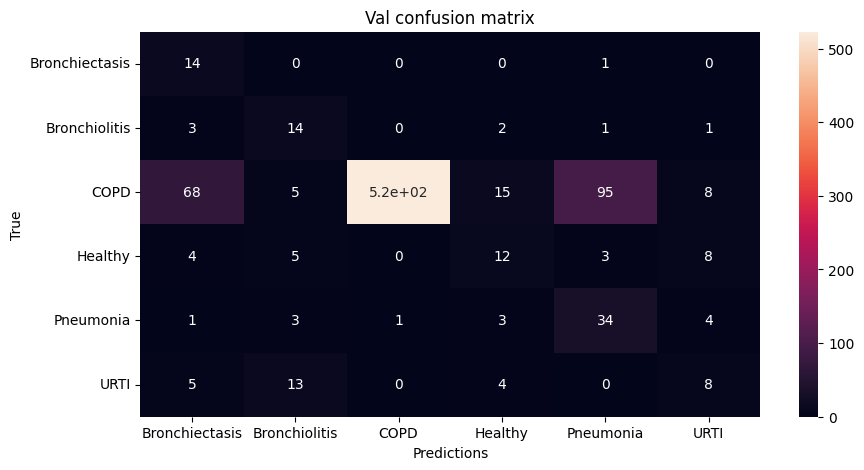


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 10:

Train Accuracy: 0.6661568322981366

Train Loss: 0.8239940410445196

Train F1 Score: 0.6288507473394738

Val Accuracy: 0.7451923076923076

Val Loss: 0.6825812723901536

Val F1 Score: 0.39607302127061067




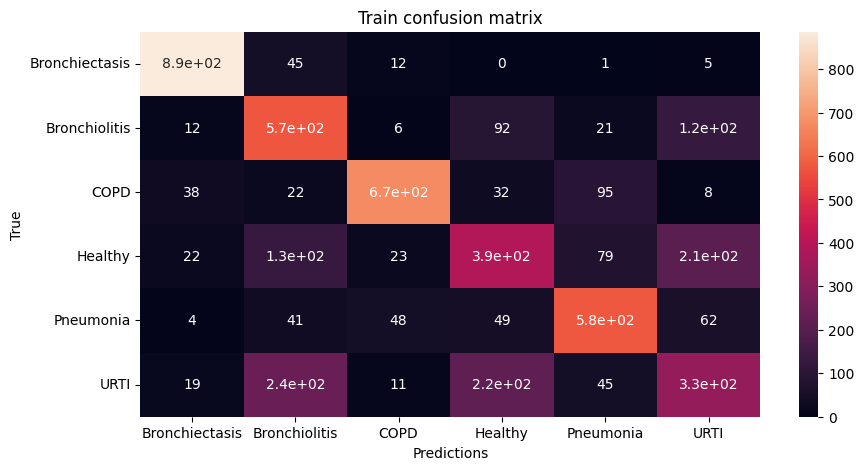

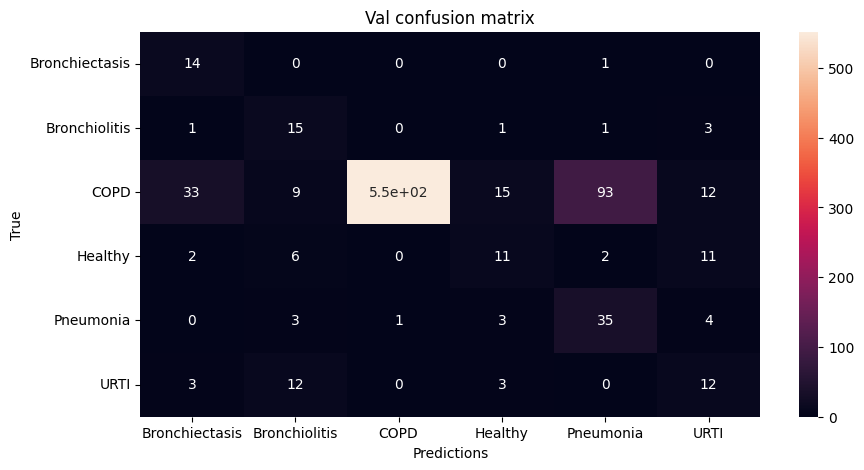


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 11:

Train Accuracy: 0.6843167701863354

Train Loss: 0.7830413354109533

Train F1 Score: 0.648148530758686

Val Accuracy: 0.8178418803418803

Val Loss: 0.4961556615652861

Val F1 Score: 0.5122080588782275




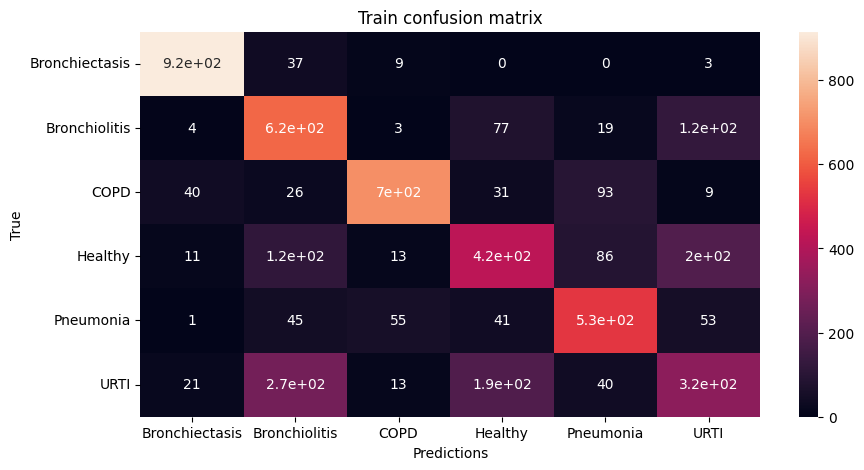

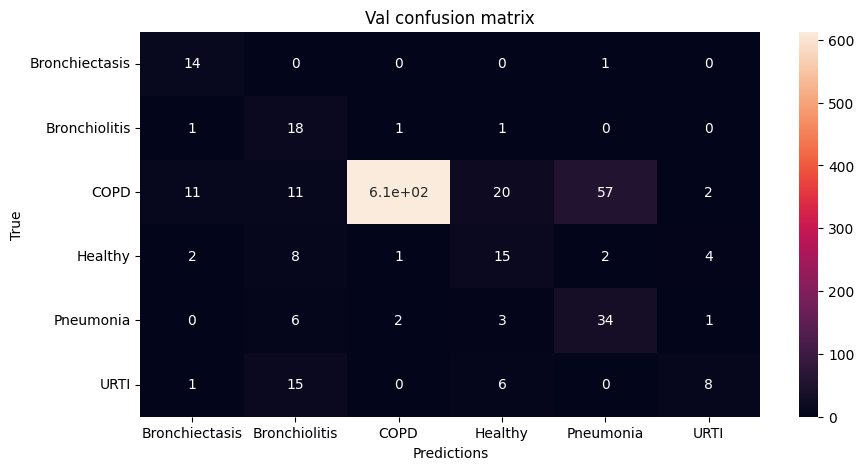


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 12:

Train Accuracy: 0.676110248447205

Train Loss: 0.7871541830693712

Train F1 Score: 0.6491936908005187

Val Accuracy: 0.7935363247863249

Val Loss: 0.6047550737857819

Val F1 Score: 0.4508645964993371




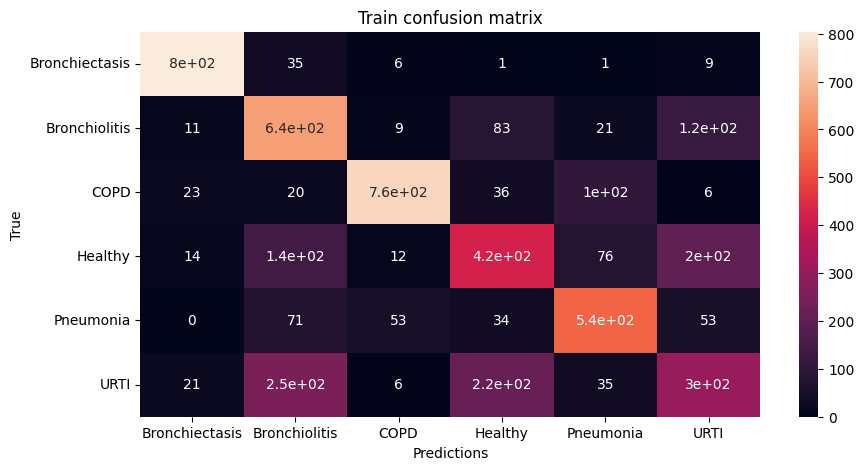

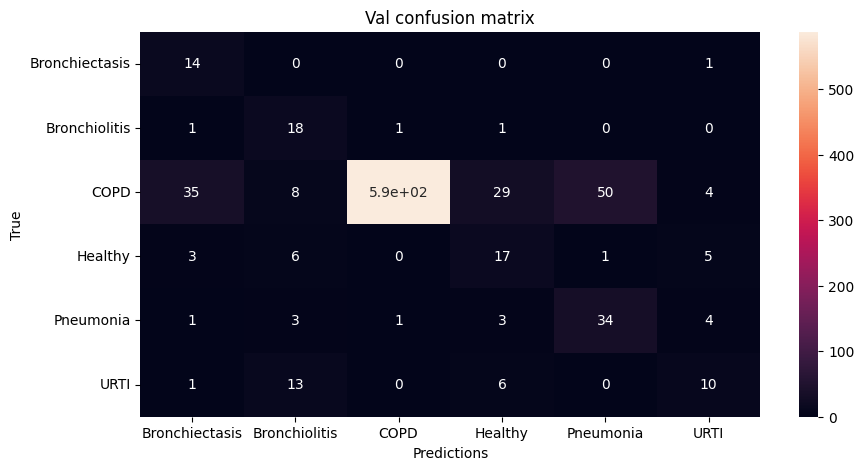


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 13:

Train Accuracy: 0.7025931677018634

Train Loss: 0.744393332219272

Train F1 Score: 0.6769562470986976

Val Accuracy: 0.754184472934473

Val Loss: 0.7512944771183862

Val F1 Score: 0.4536834905544917




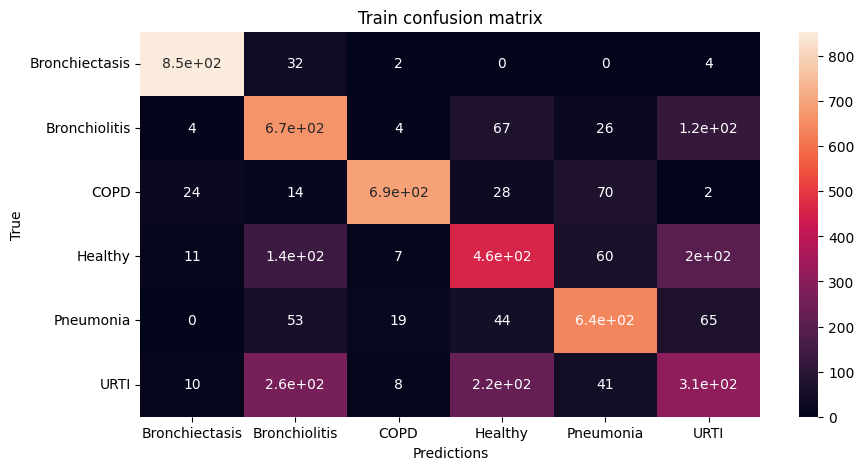

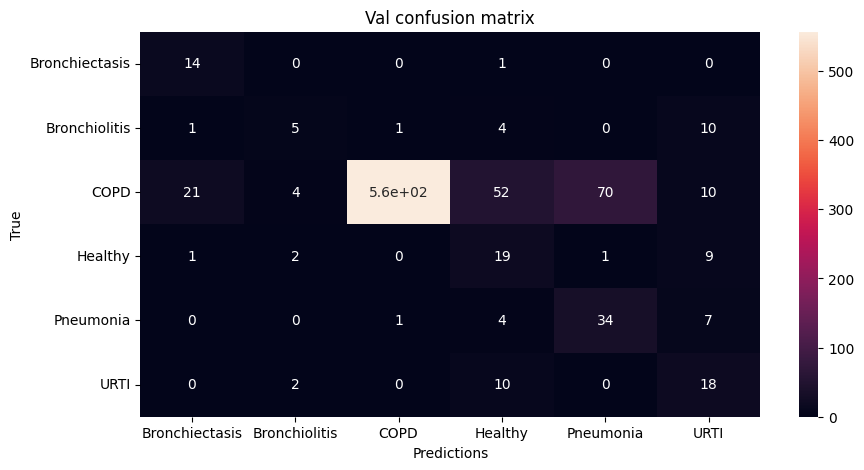


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 14:

Train Accuracy: 0.7035403726708074

Train Loss: 0.7485357160153596

Train F1 Score: 0.6666046034845506

Val Accuracy: 0.766025641025641

Val Loss: 0.6647628490571622

Val F1 Score: 0.4481523511586366




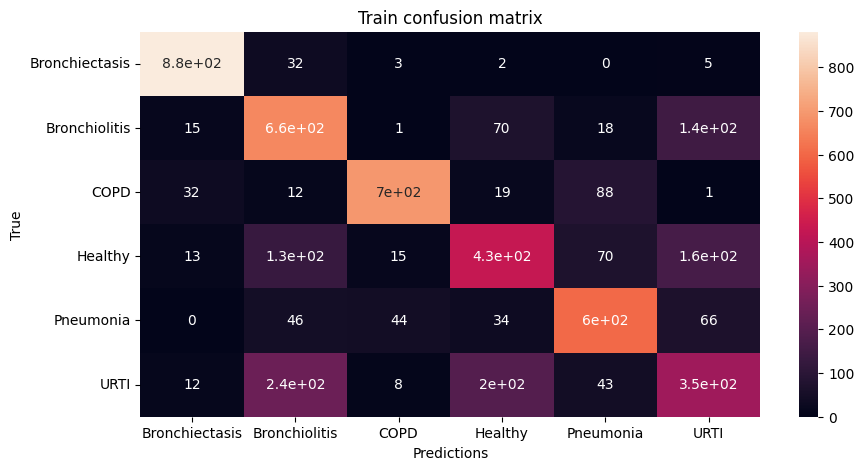

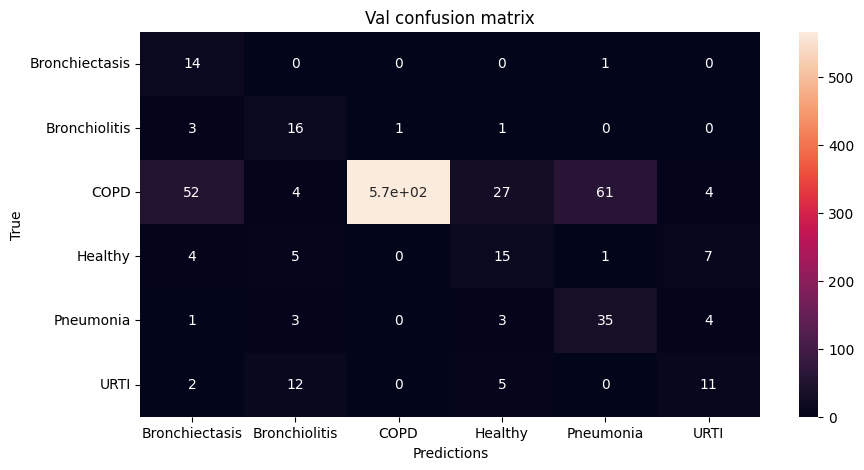


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 15:

Train Accuracy: 0.7188664596273292

Train Loss: 0.7127029205331151

Train F1 Score: 0.6974549863649451

Val Accuracy: 0.7888176638176638

Val Loss: 0.5798613638789566

Val F1 Score: 0.4618948295160576




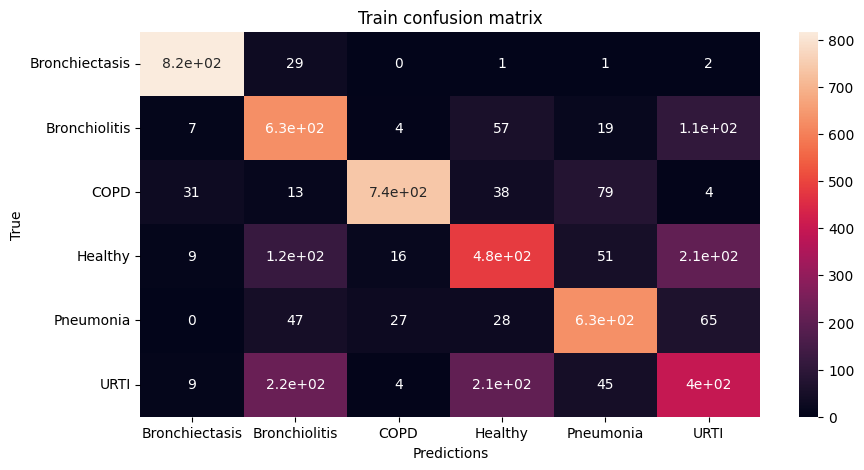

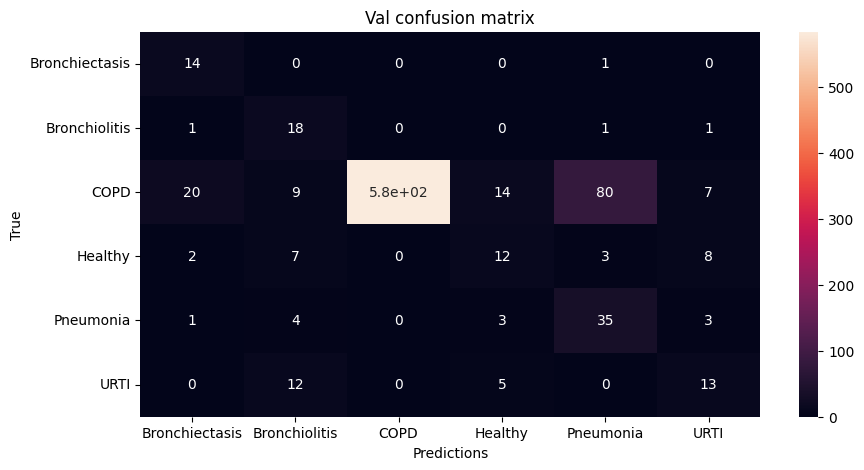


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 16:

Train Accuracy: 0.7288742236024844

Train Loss: 0.697213183648838

Train F1 Score: 0.7096295752880736

Val Accuracy: 0.816150284900285

Val Loss: 0.5414461250658389

Val F1 Score: 0.4850661622153388




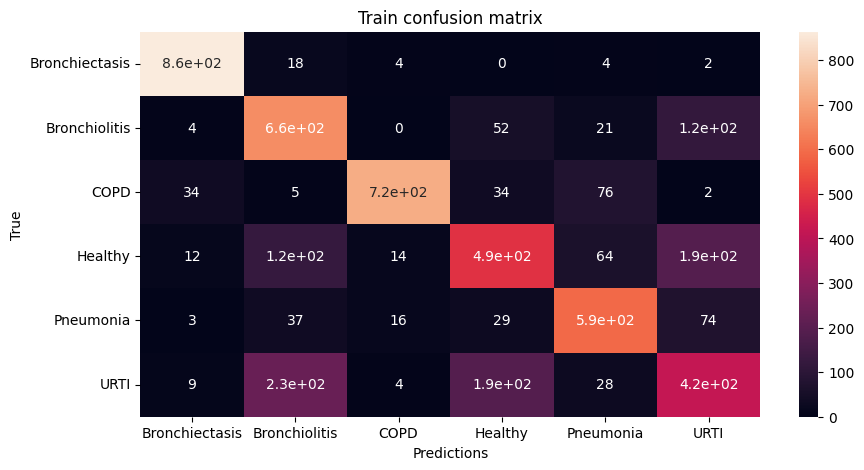

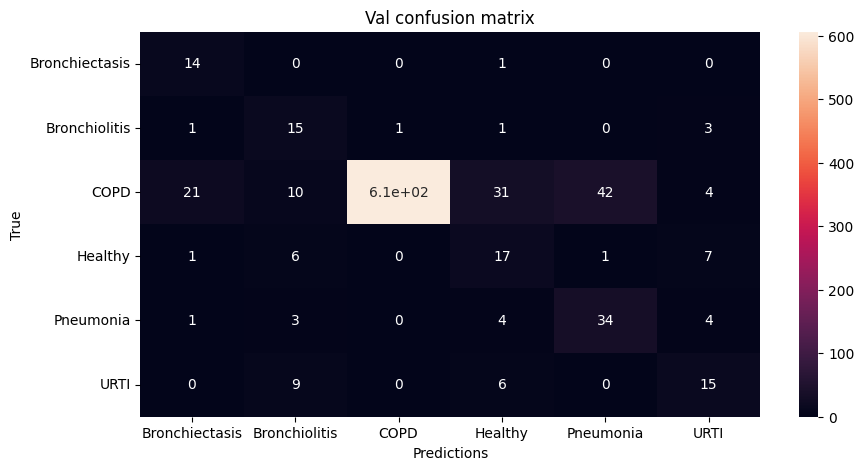


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 17:

Train Accuracy: 0.7389130434782609

Train Loss: 0.6741169828065434

Train F1 Score: 0.713615326037318

Val Accuracy: 0.8568376068376068

Val Loss: 0.40820168565820764

Val F1 Score: 0.5690670322488856




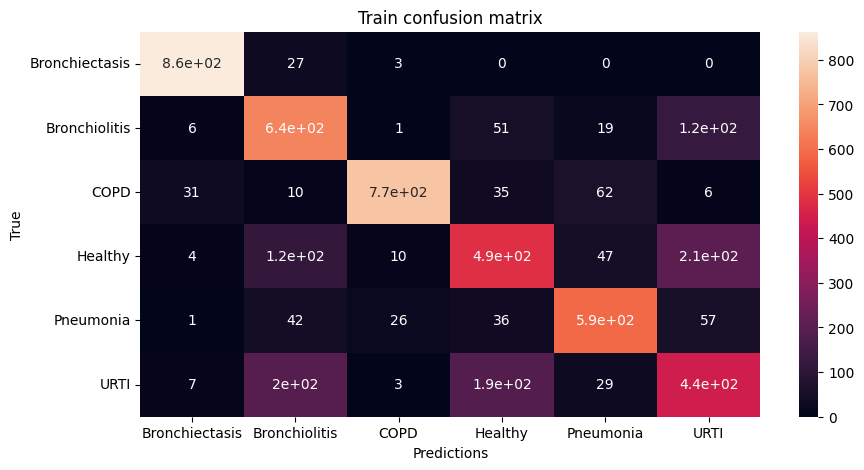

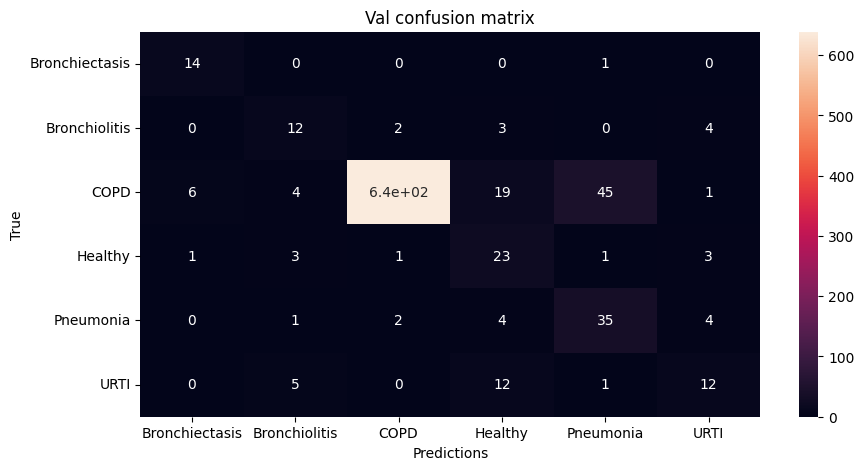


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 18:

Train Accuracy: 0.7278493788819876

Train Loss: 0.7033439615498418

Train F1 Score: 0.7052435575064665

Val Accuracy: 0.8264779202279202

Val Loss: 0.4473295758167903

Val F1 Score: 0.4799662017159992




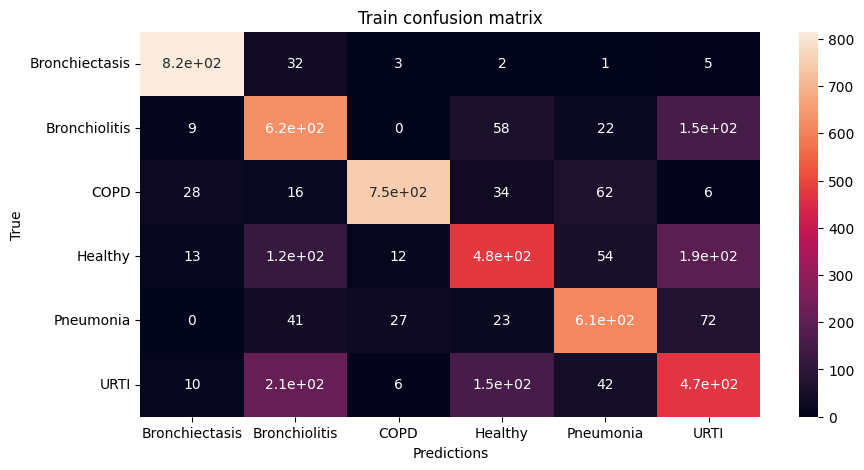

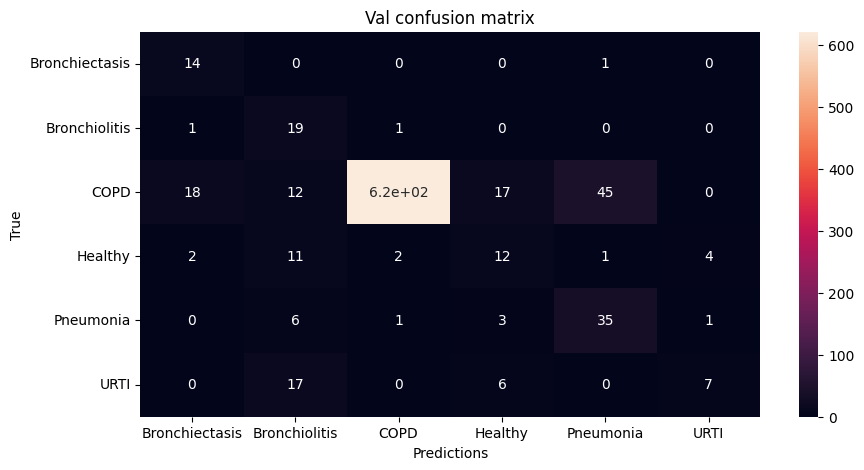


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 19:

Train Accuracy: 0.7256366459627329

Train Loss: 0.6936106911357145

Train F1 Score: 0.7090208996897158

Val Accuracy: 0.8264779202279202

Val Loss: 0.5133002588042507

Val F1 Score: 0.5189491791857613




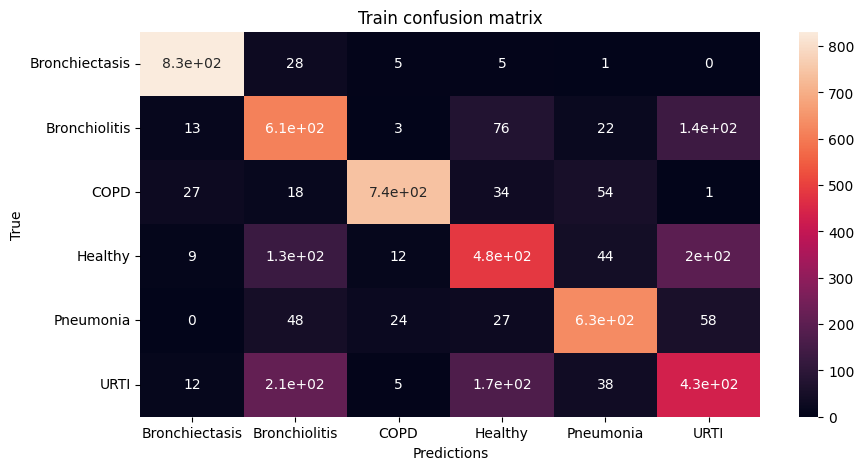

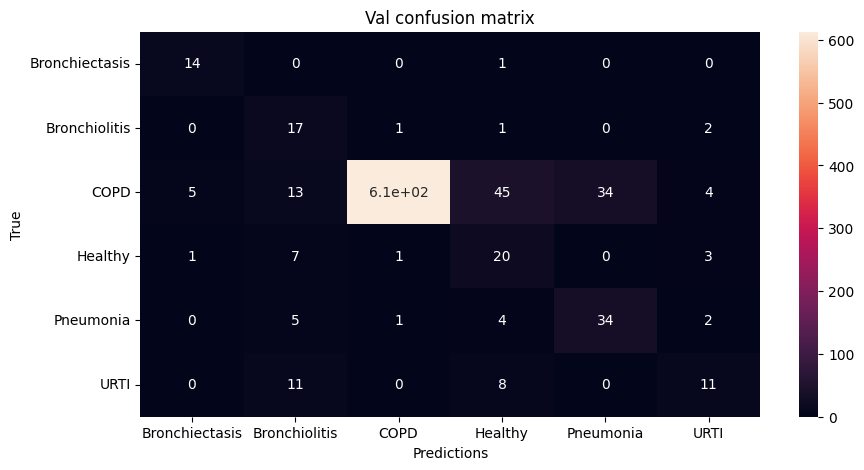


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 20:

Train Accuracy: 0.7475931677018633

Train Loss: 0.6553140525121867

Train F1 Score: 0.7228494662305583

Val Accuracy: 0.8317307692307693

Val Loss: 0.4879901850665057

Val F1 Score: 0.5196740820452019




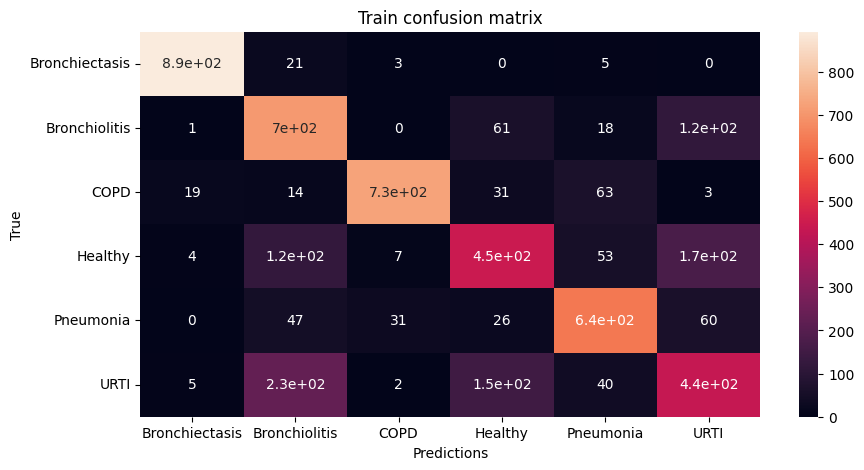

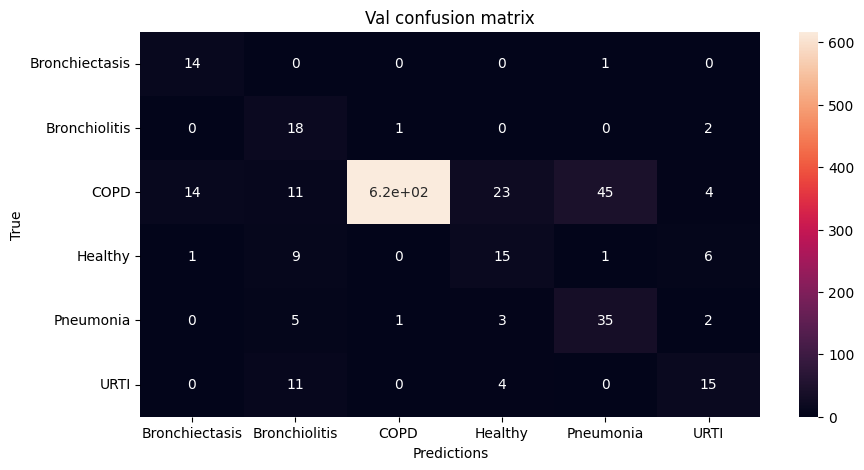


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 21:

Train Accuracy: 0.7431288819875776

Train Loss: 0.6452103962439187

Train F1 Score: 0.7213649305497637

Val Accuracy: 0.7845441595441595

Val Loss: 0.626573606773659

Val F1 Score: 0.4743608087301254




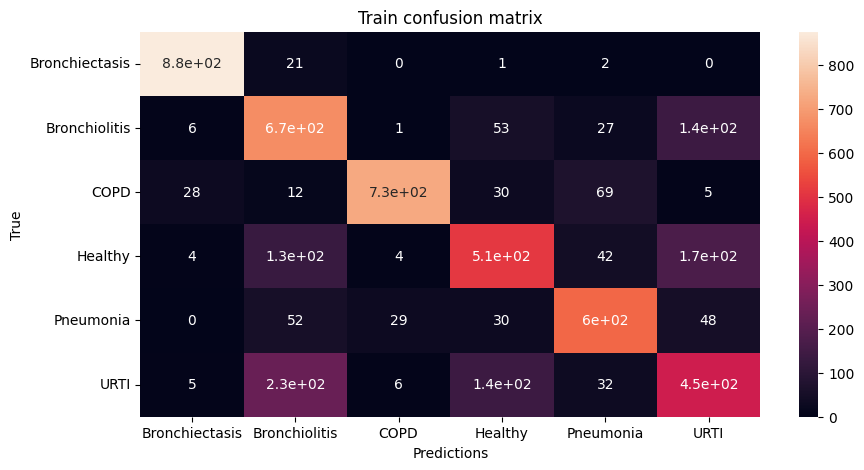

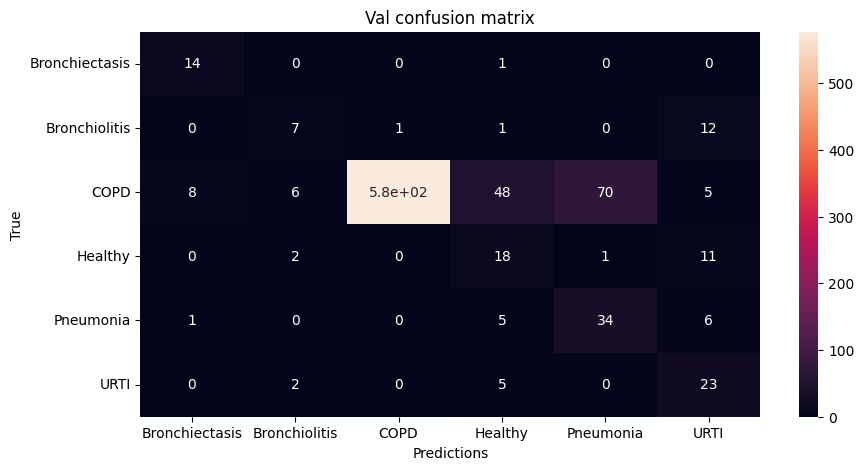


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 22:

Train Accuracy: 0.7651708074534161

Train Loss: 0.6169197674123397

Train F1 Score: 0.7433700576332045

Val Accuracy: 0.8392094017094017

Val Loss: 0.4033236332513668

Val F1 Score: 0.5047743601931466




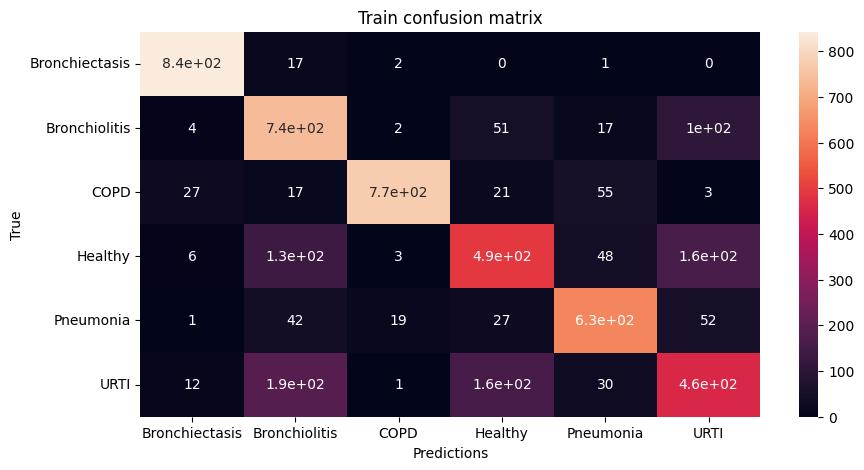

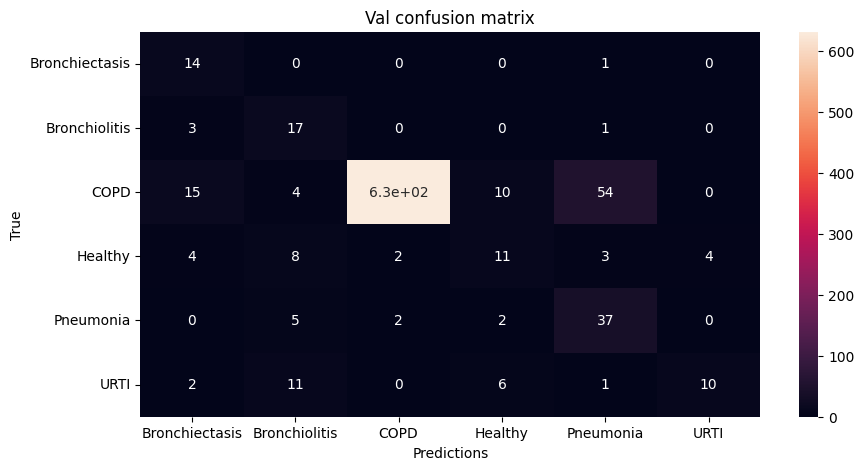


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 23:

Train Accuracy: 0.7656754658385093

Train Loss: 0.6062822678814763

Train F1 Score: 0.7431897874574483

Val Accuracy: 0.8473112535612536

Val Loss: 0.4137530517246988

Val F1 Score: 0.5157036532958349




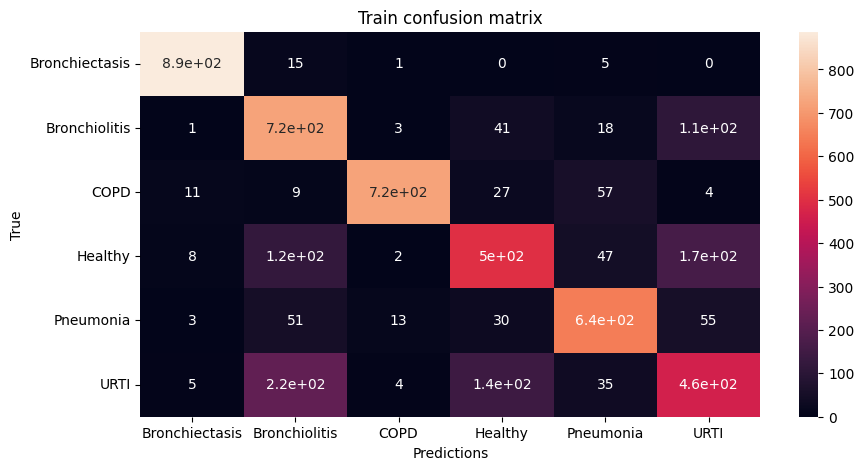

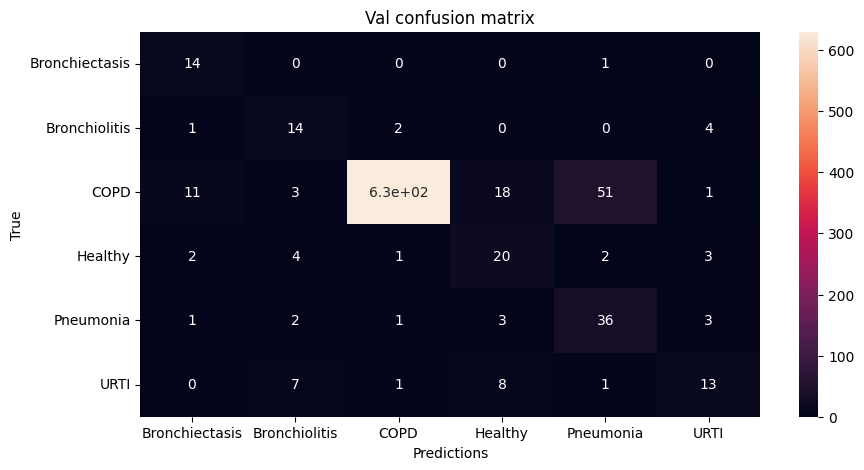


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 24:

Train Accuracy: 0.7651242236024844

Train Loss: 0.6083199002357743

Train F1 Score: 0.748811556870893

Val Accuracy: 0.8194444444444444

Val Loss: 0.5244742195915293

Val F1 Score: 0.5090542568100823




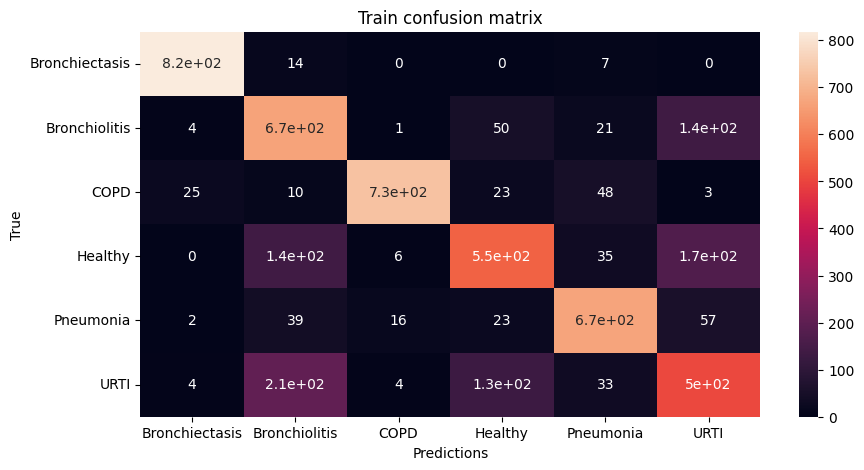

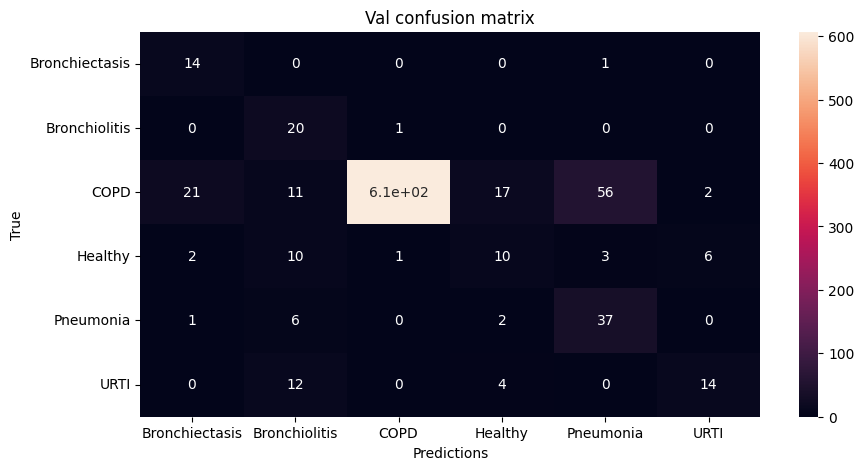


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 25:

Train Accuracy: 0.769860248447205

Train Loss: 0.5775052064694233

Train F1 Score: 0.7547804857633129

Val Accuracy: 0.8519408831908832

Val Loss: 0.4492152327740634

Val F1 Score: 0.5360423850792425




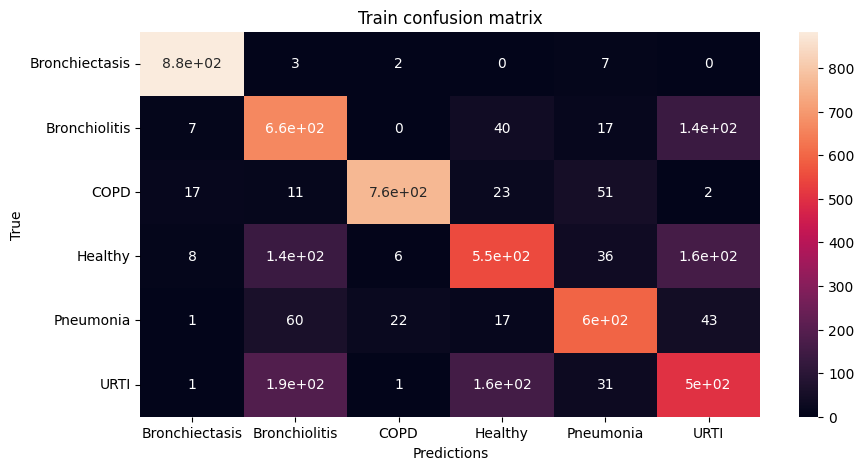

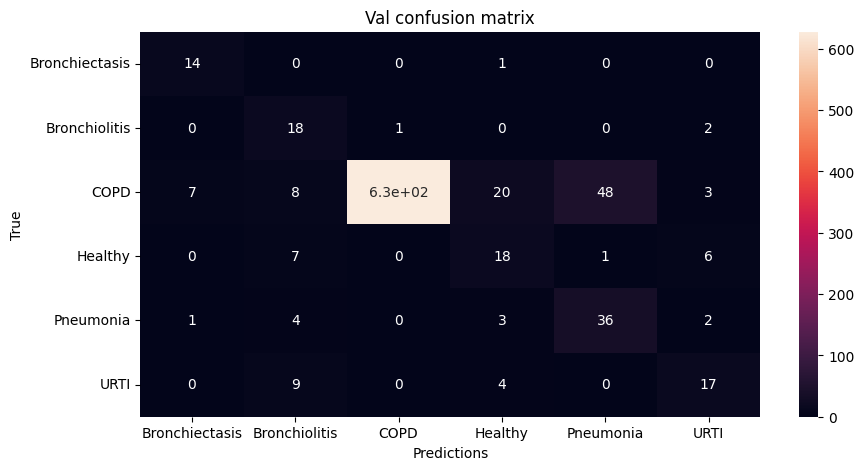


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 26:

Train Accuracy: 0.7687499999999999

Train Loss: 0.5985948487838603

Train F1 Score: 0.747742848366684

Val Accuracy: 0.842948717948718

Val Loss: 0.485252524415652

Val F1 Score: 0.5653122481372621




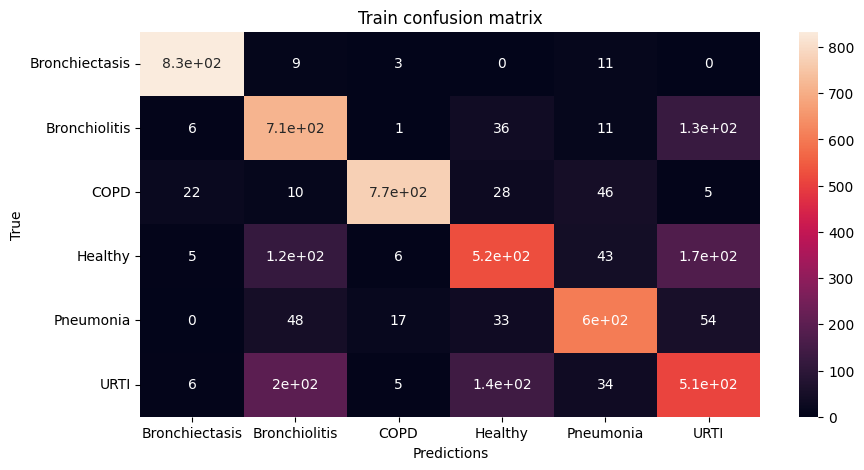

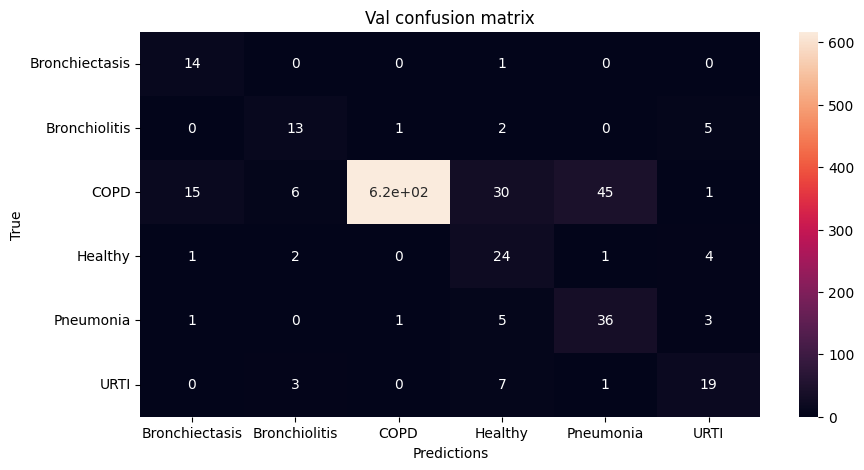


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 27:

Train Accuracy: 0.7694487577639751

Train Loss: 0.5961237051842375

Train F1 Score: 0.7487021817924073

Val Accuracy: 0.8424145299145299

Val Loss: 0.44198473349765494

Val F1 Score: 0.5425824379479444




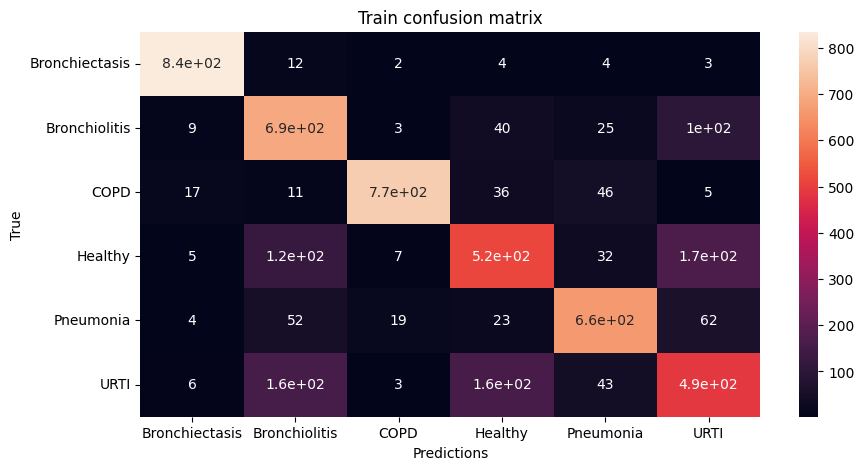

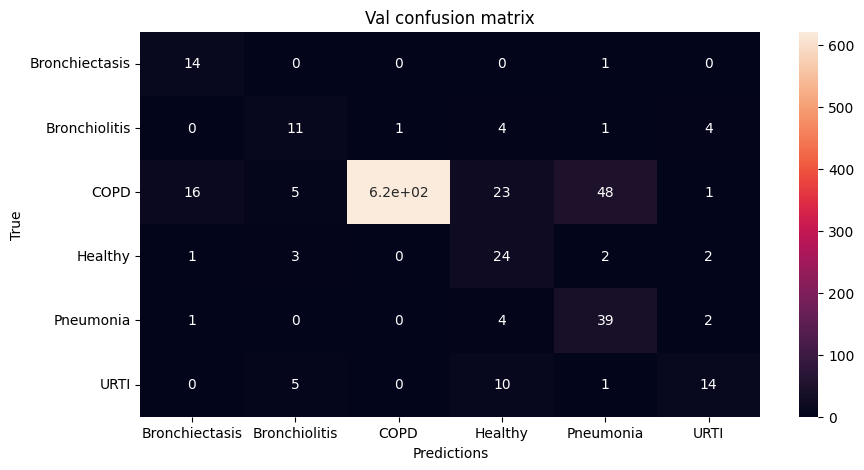


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 28:

Train Accuracy: 0.7873835403726708

Train Loss: 0.552818485853835

Train F1 Score: 0.7681983701931023

Val Accuracy: 0.840099715099715

Val Loss: 0.4216137997530125

Val F1 Score: 0.502561722640638




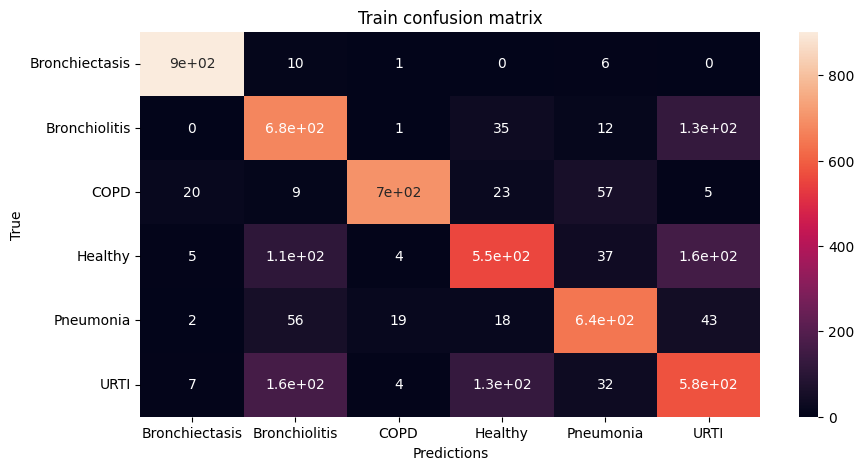

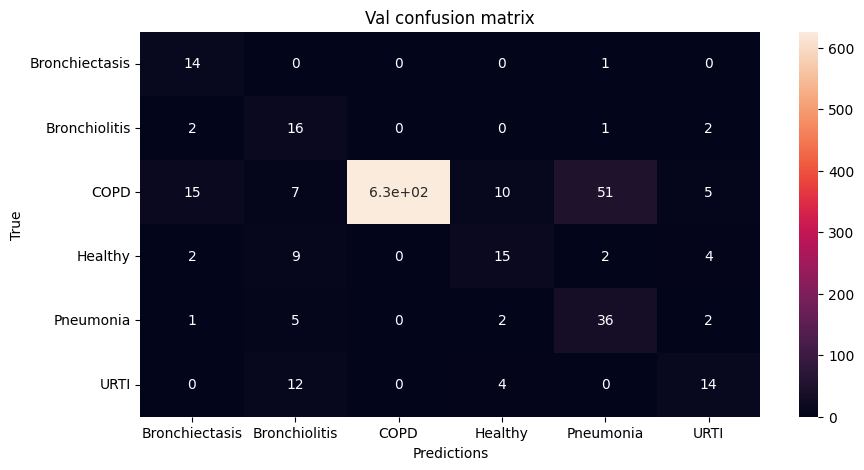


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 29:

Train Accuracy: 0.7751009316770187

Train Loss: 0.5642583914425062

Train F1 Score: 0.750352427270842

Val Accuracy: 0.8097400284900286

Val Loss: 0.5523089937589787

Val F1 Score: 0.47982090877162087




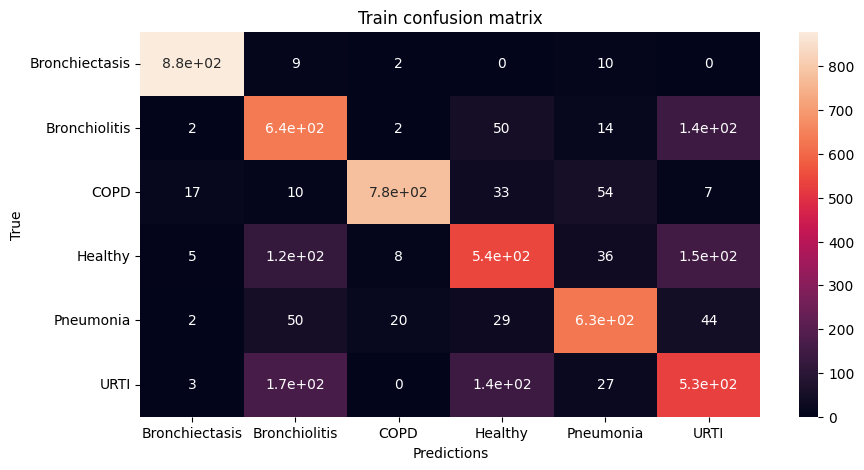

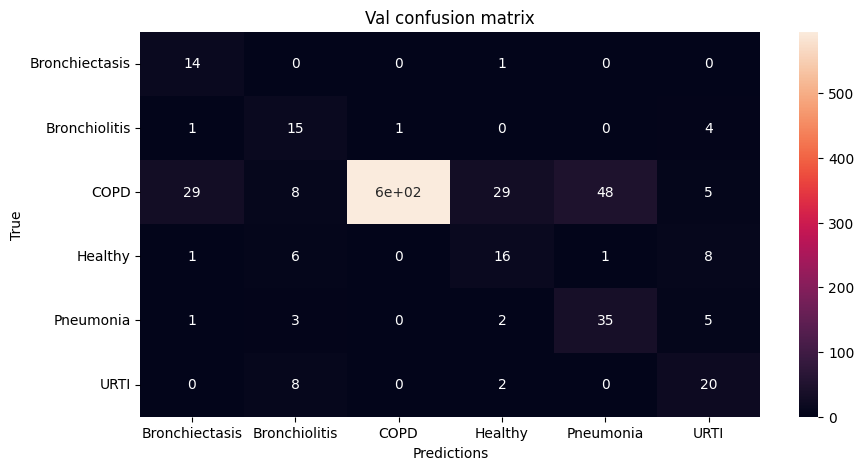


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 30:

Train Accuracy: 0.7925698757763976

Train Loss: 0.5485729288240397

Train F1 Score: 0.7774197562881138

Val Accuracy: 0.8565705128205129

Val Loss: 0.384624392622047

Val F1 Score: 0.5392905920743942




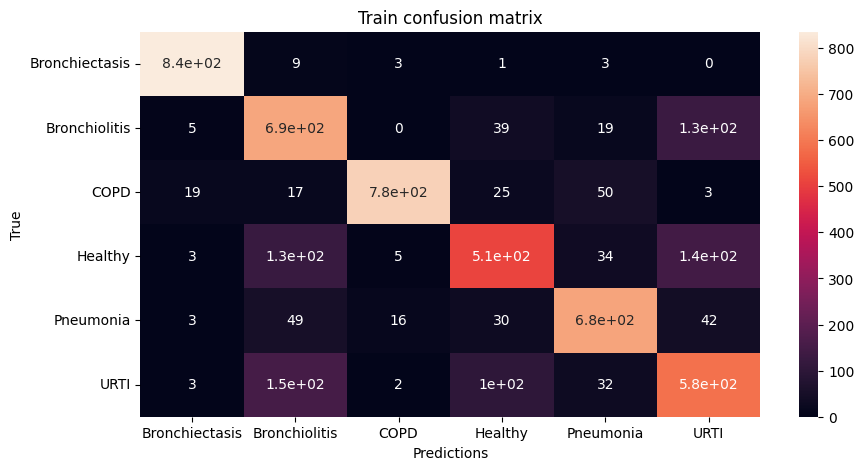

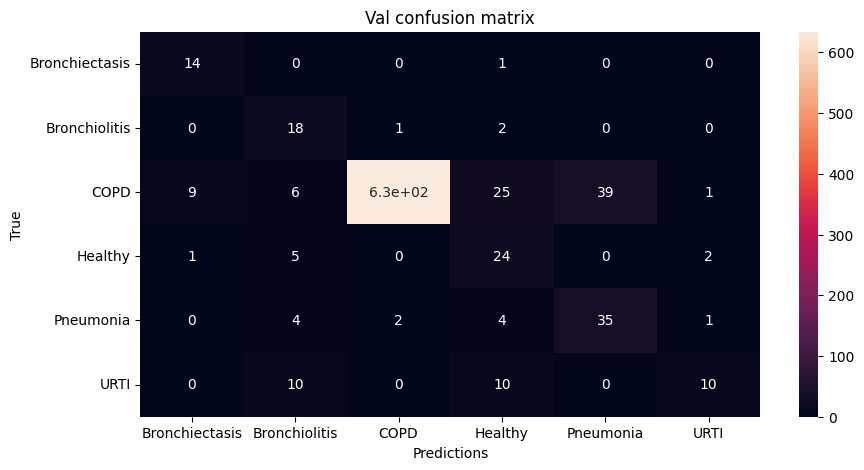


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 31:

Train Accuracy: 0.7760170807453416

Train Loss: 0.5677741025545582

Train F1 Score: 0.7585684560840915

Val Accuracy: 0.8538995726495726

Val Loss: 0.4022360005312496

Val F1 Score: 0.5633330632139135




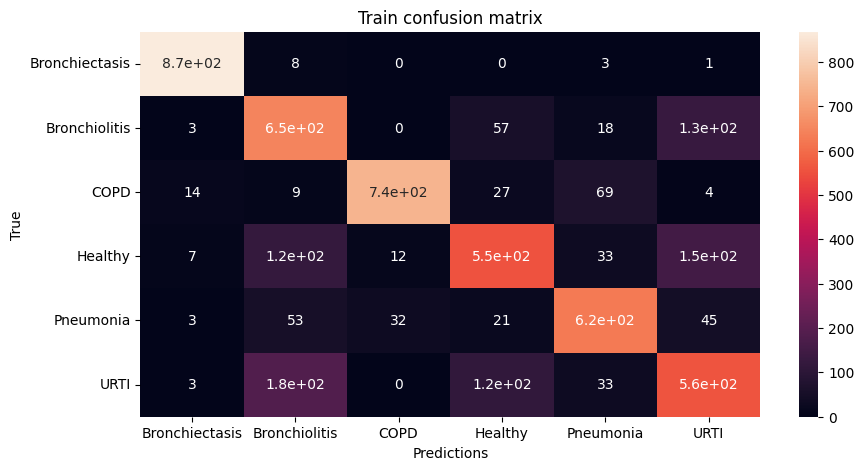

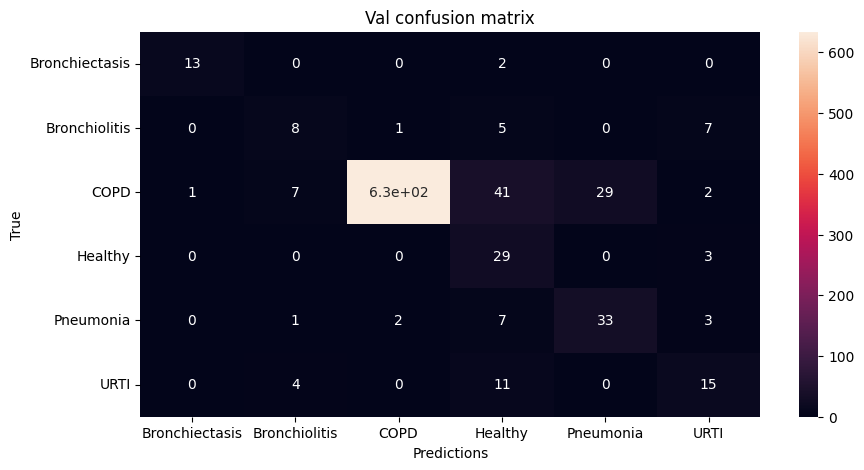


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 32:

Train Accuracy: 0.7765683229813665

Train Loss: 0.5627129101975364

Train F1 Score: 0.7554385195607725

Val Accuracy: 0.8389423076923076

Val Loss: 0.48785462423607157

Val F1 Score: 0.5234662327501509




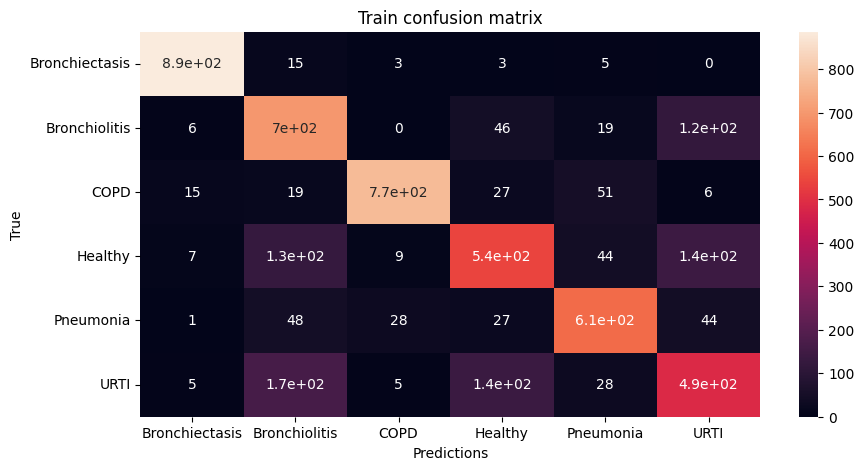

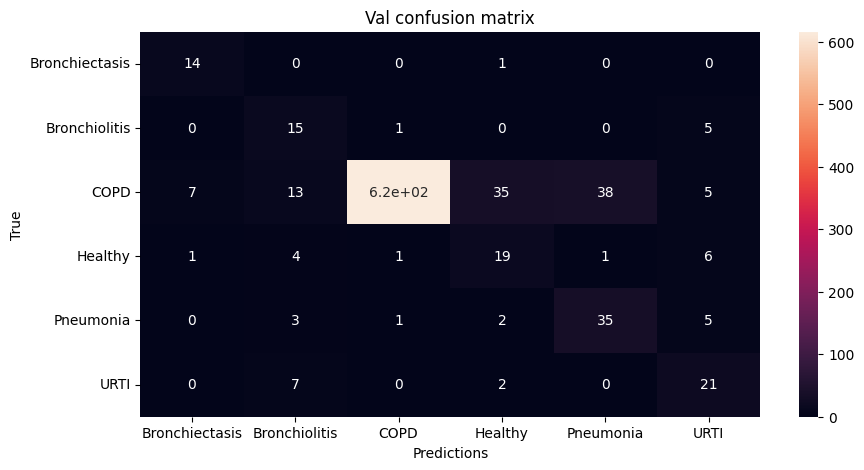


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 33:

Train Accuracy: 0.7981444099378882

Train Loss: 0.523747987443616

Train F1 Score: 0.7808143118893878

Val Accuracy: 0.8577279202279202

Val Loss: 0.4180602999749007

Val F1 Score: 0.5985446903440688




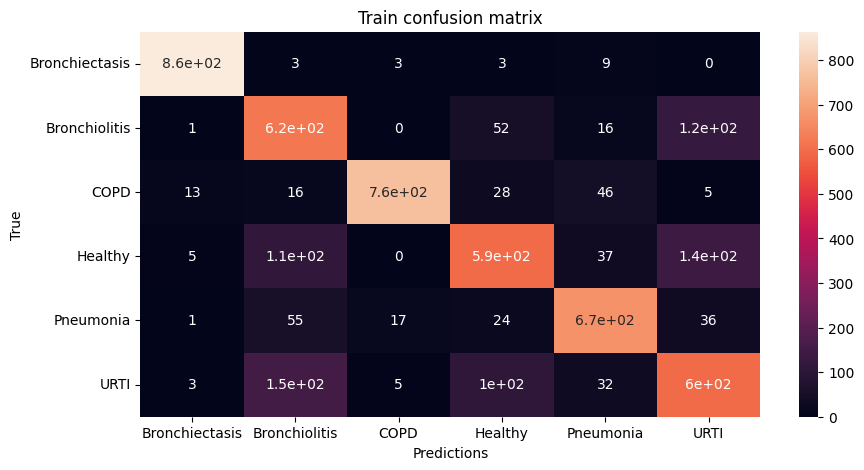

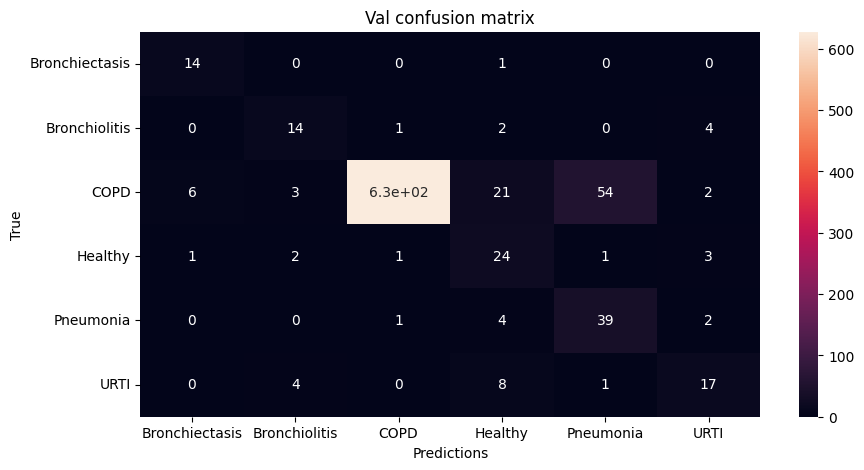


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 34:

Train Accuracy: 0.7947593167701863

Train Loss: 0.5439747543253514

Train F1 Score: 0.7791527517093635

Val Accuracy: 0.8271011396011396

Val Loss: 0.47308934066030717

Val F1 Score: 0.5239247326497678




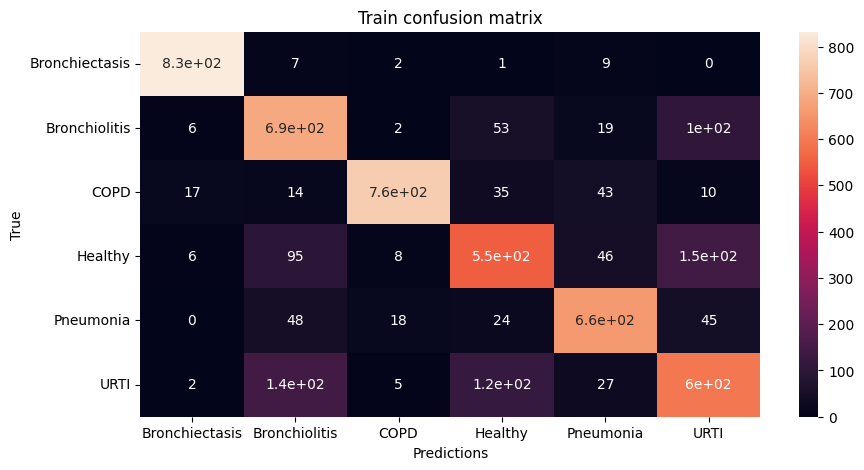

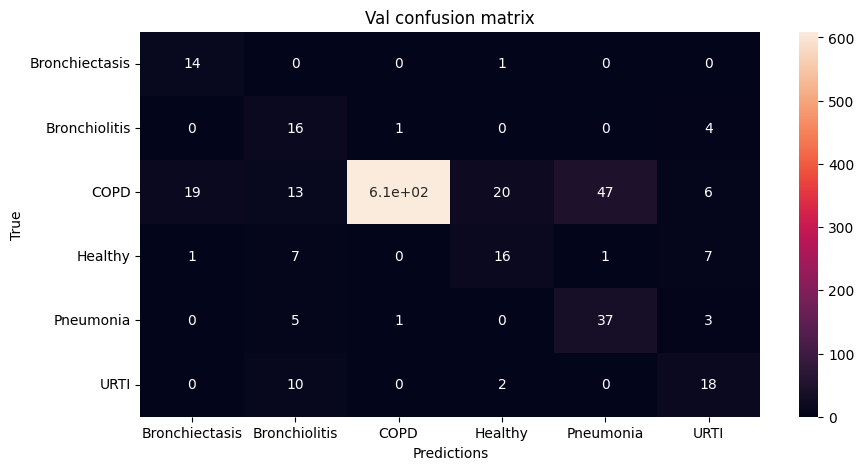


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 35:

Train Accuracy: 0.8062655279503106

Train Loss: 0.5042836809565562

Train F1 Score: 0.7911124947648611

Val Accuracy: 0.8641381766381767

Val Loss: 0.3984198768933614

Val F1 Score: 0.5884730197765209




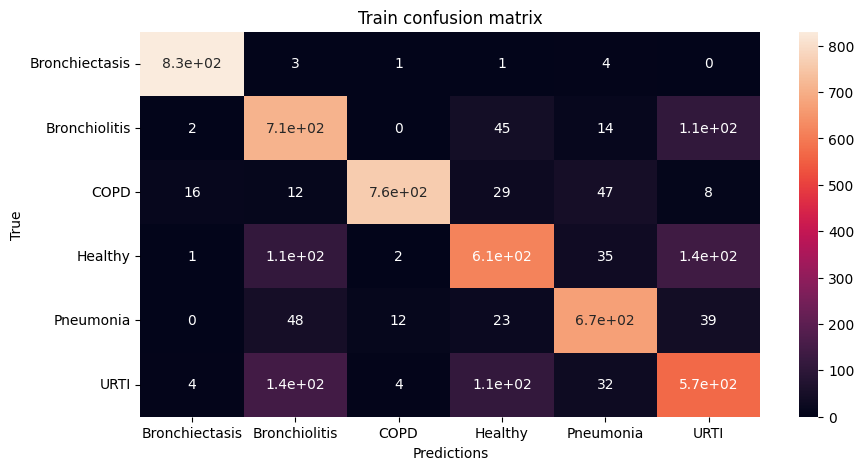

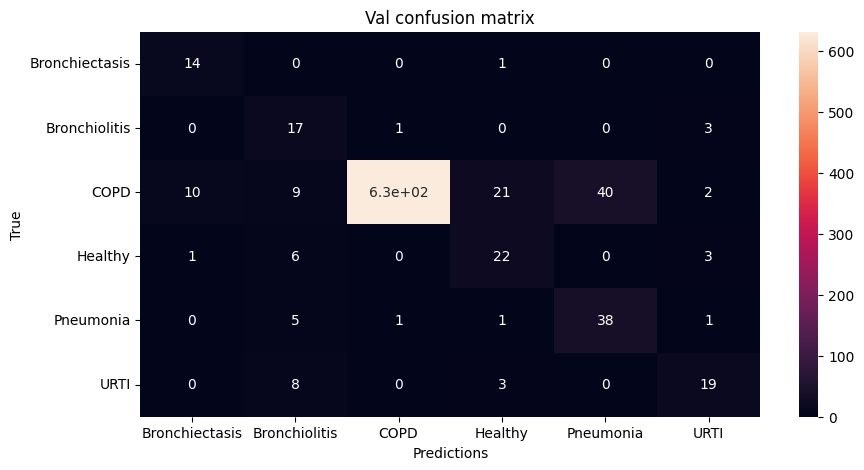


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 36:

Train Accuracy: 0.8222670807453416

Train Loss: 0.48759124330852344

Train F1 Score: 0.80241395560851

Val Accuracy: 0.859775641025641

Val Loss: 0.40043997378261004

Val F1 Score: 0.570887044624046




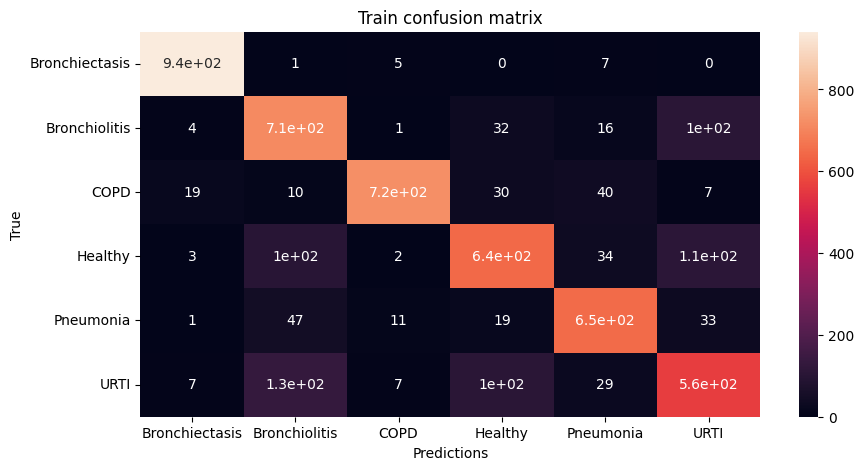

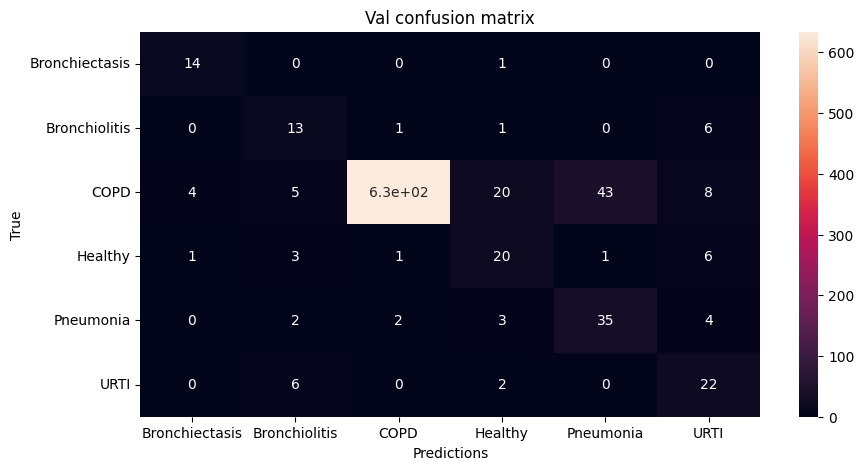


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 37:

Train Accuracy: 0.8180512422360249

Train Loss: 0.488255152420968

Train F1 Score: 0.8058092705211284

Val Accuracy: 0.8546118233618233

Val Loss: 0.4086156266706961

Val F1 Score: 0.5888224729785213




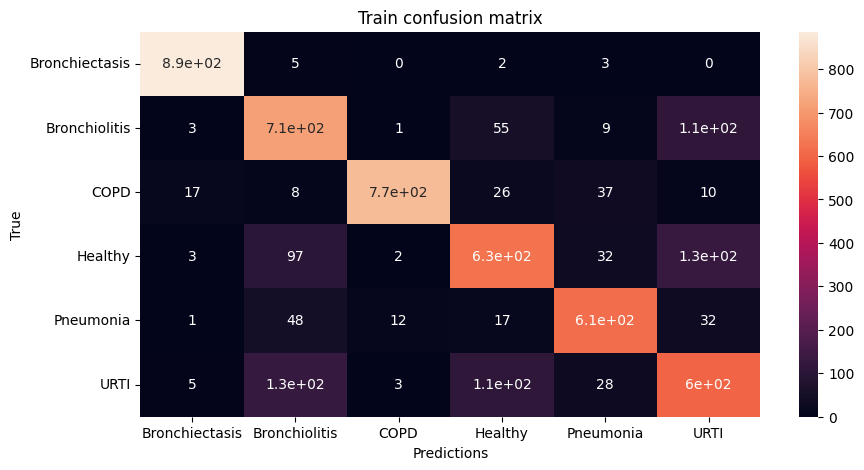

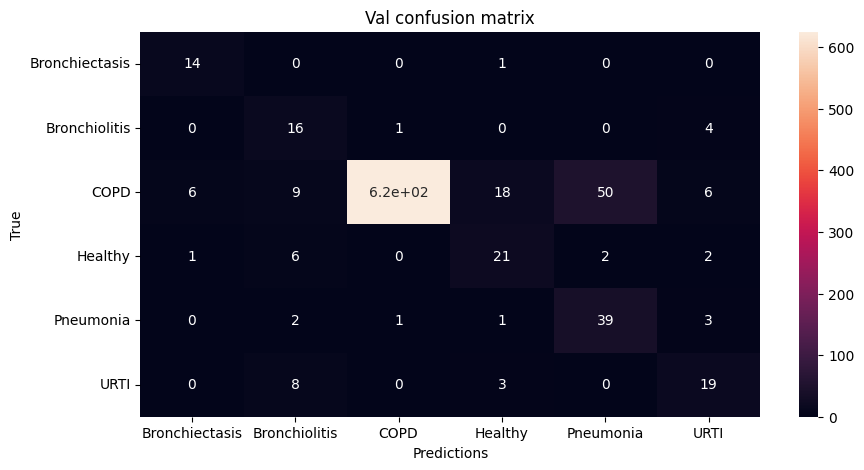


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 38:

Train Accuracy: 0.8192701863354037

Train Loss: 0.47917943387668327

Train F1 Score: 0.8015471519150349

Val Accuracy: 0.8707264957264956

Val Loss: 0.3473523300555017

Val F1 Score: 0.5689882647108149




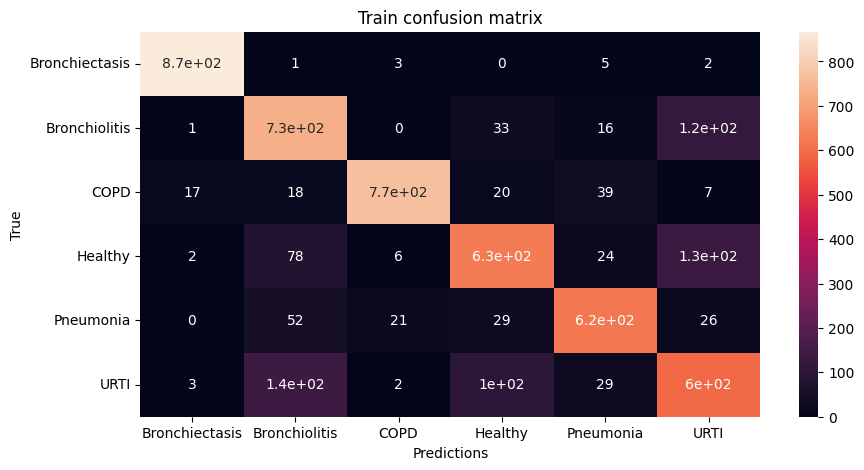

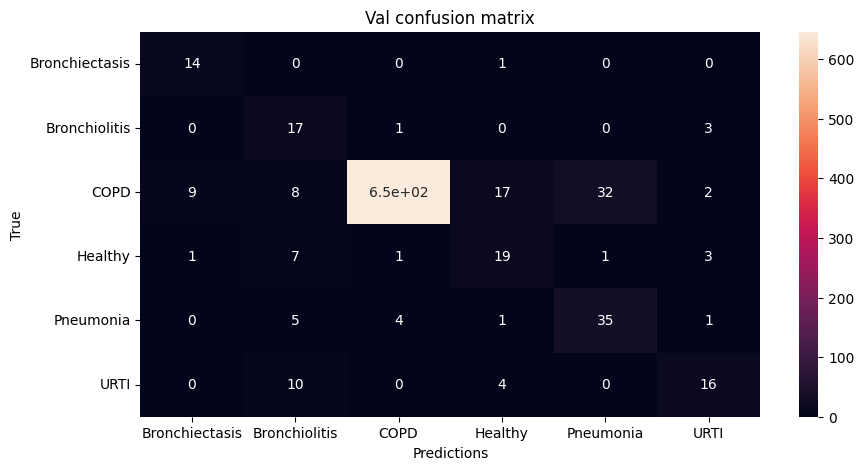


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 39:

Train Accuracy: 0.8375155279503106

Train Loss: 0.4619588308637927

Train F1 Score: 0.8232695278914078

Val Accuracy: 0.8756232193732194

Val Loss: 0.3411978687401171

Val F1 Score: 0.5775030983818902




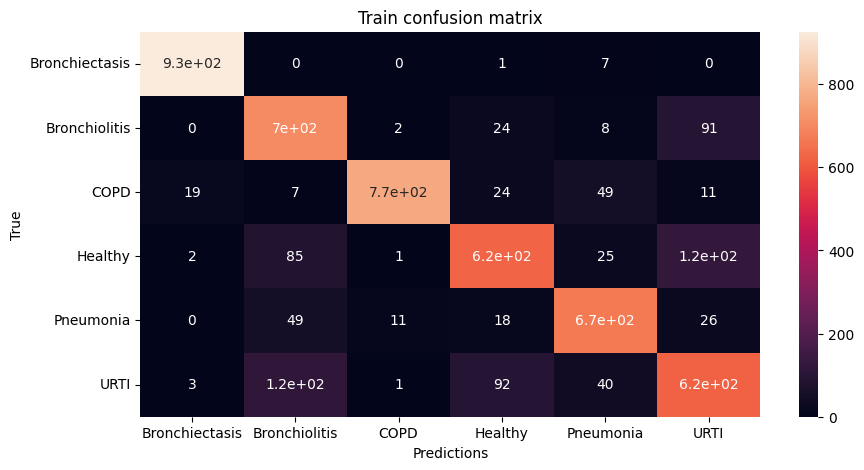

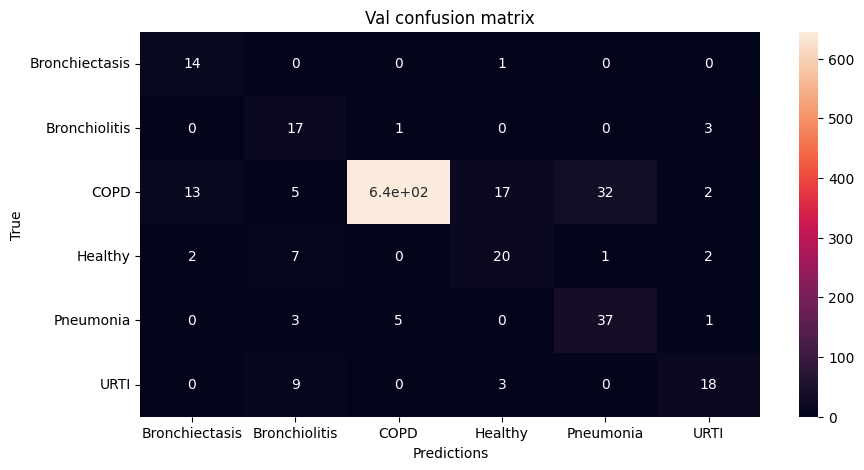


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 40:

Train Accuracy: 0.8319409937888198

Train Loss: 0.4586559400795409

Train F1 Score: 0.8167565775954205

Val Accuracy: 0.8420584045584045

Val Loss: 0.46753974893578776

Val F1 Score: 0.5274774189348574




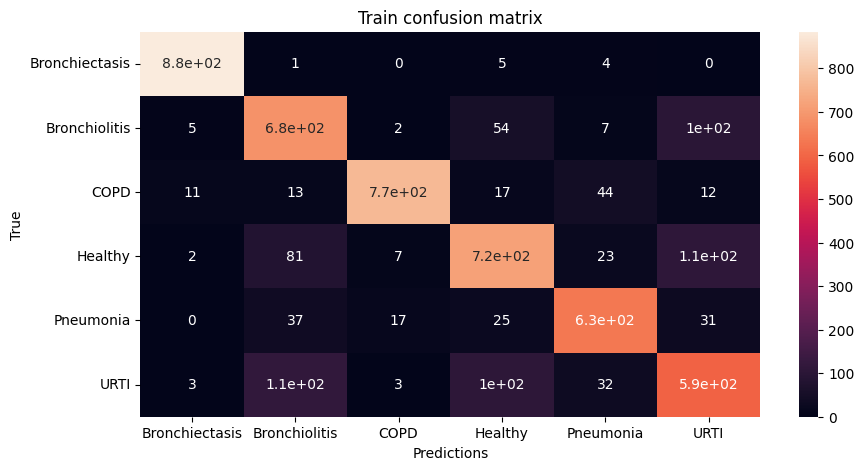

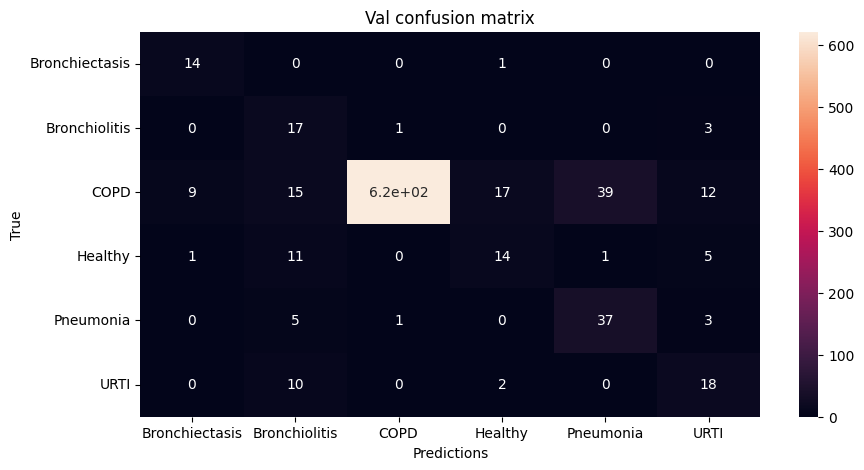


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 41:

Train Accuracy: 0.8333540372670807

Train Loss: 0.44976669688772714

Train F1 Score: 0.8158042142109841

Val Accuracy: 0.8363603988603989

Val Loss: 0.4453369958533181

Val F1 Score: 0.5370904698416039




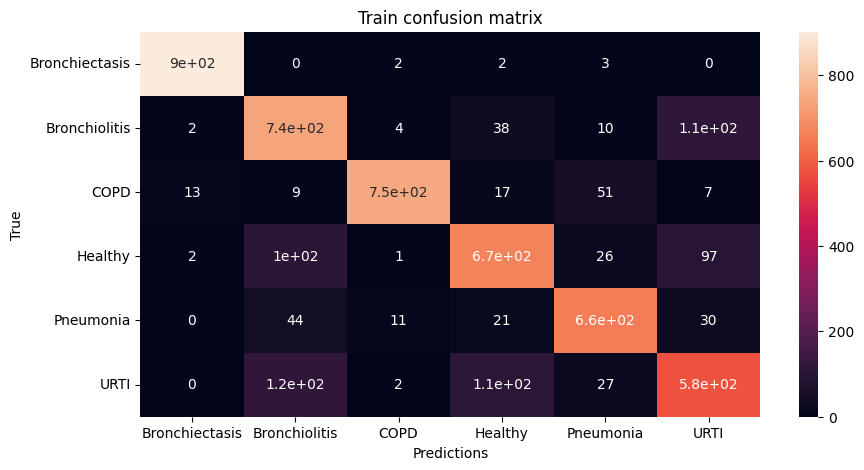

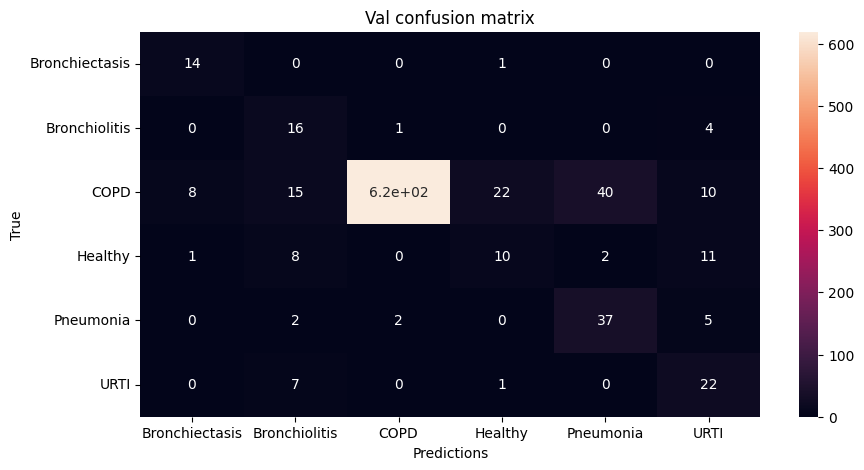


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 42:

Train Accuracy: 0.829836956521739

Train Loss: 0.46279528838877354

Train F1 Score: 0.8133320027256604

Val Accuracy: 0.8927172364672364

Val Loss: 0.2851516571309831

Val F1 Score: 0.6329896461080622




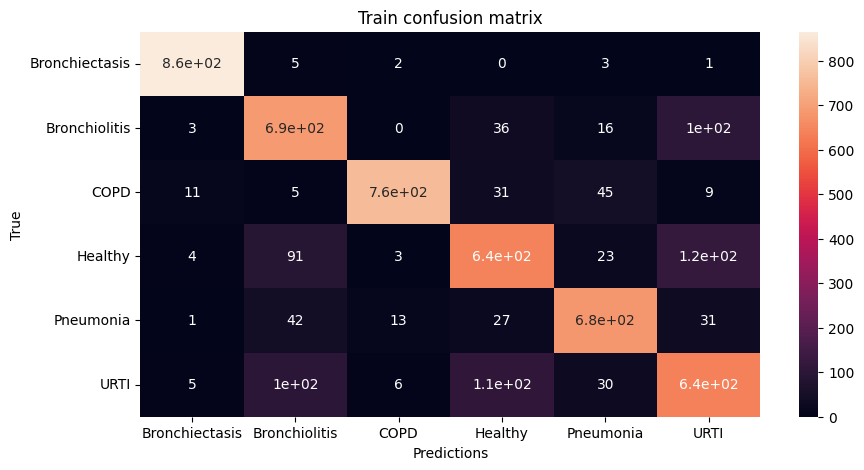

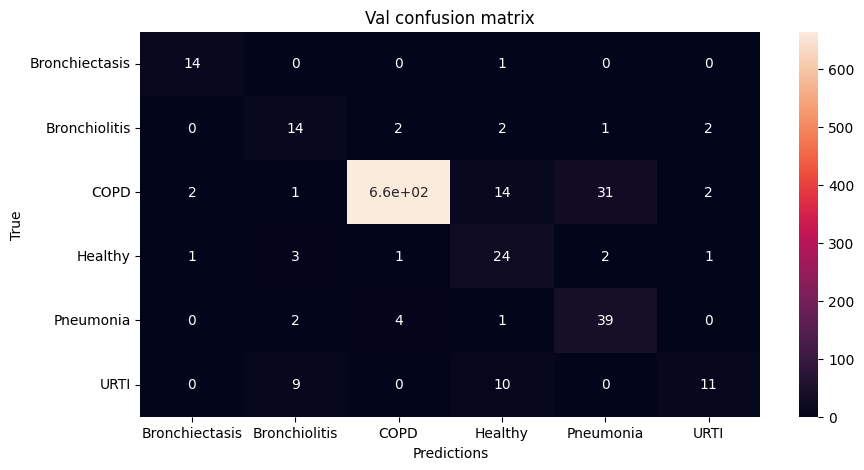


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 43:

Train Accuracy: 0.8343555900621119

Train Loss: 0.4401435054237058

Train F1 Score: 0.8167130547280638

Val Accuracy: 0.8565705128205129

Val Loss: 0.3926338705199736

Val F1 Score: 0.5962167316012912




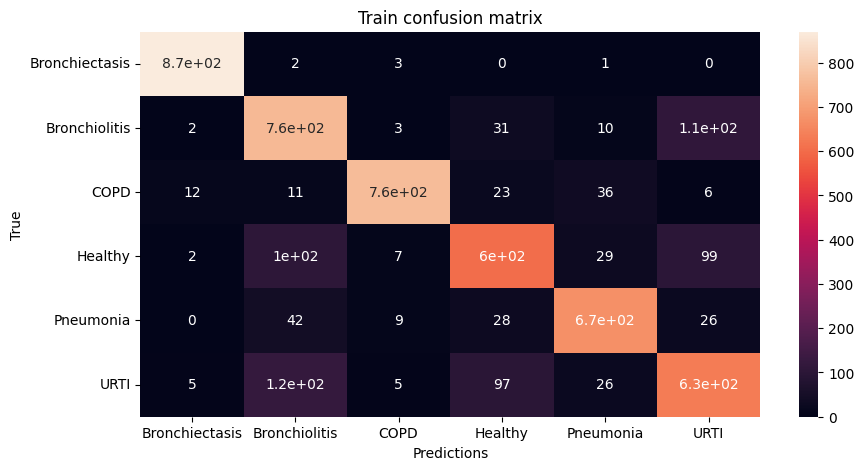

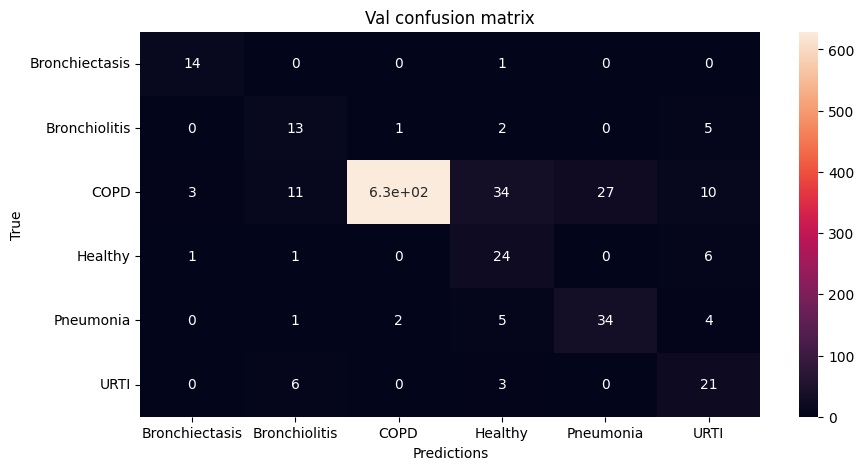


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 44:

Train Accuracy: 0.8379037267080746

Train Loss: 0.4381781946057859

Train F1 Score: 0.8203299856333999

Val Accuracy: 0.8730413105413105

Val Loss: 0.3588550857923649

Val F1 Score: 0.603288789038305




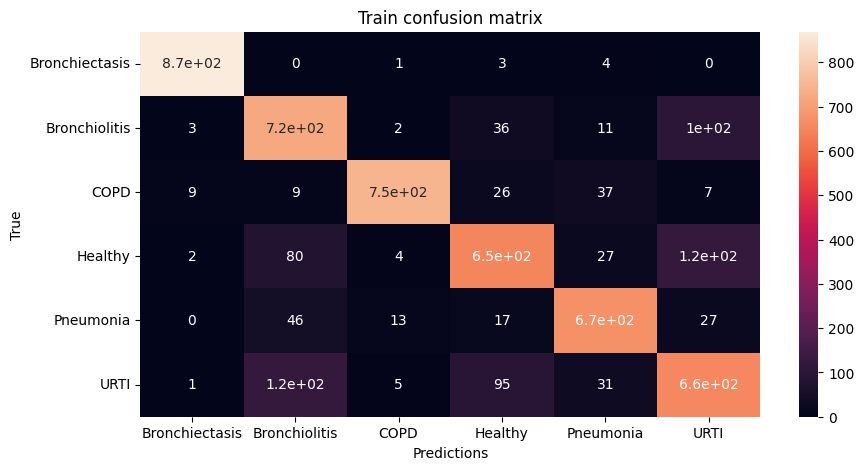

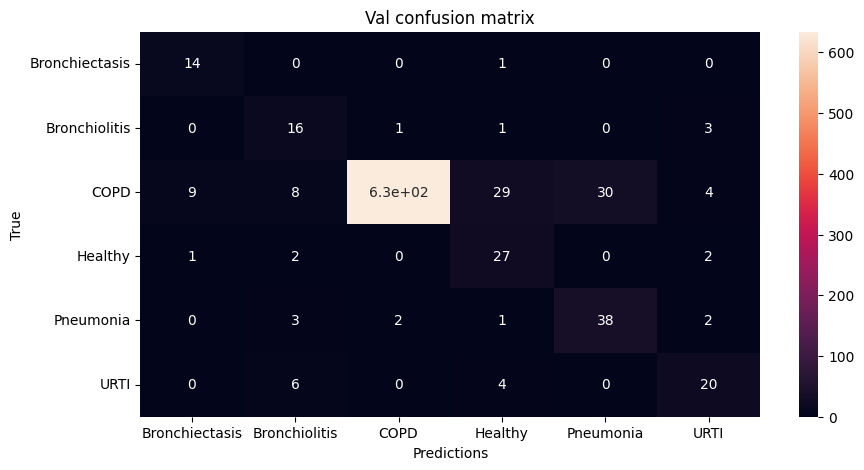


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 45:

Train Accuracy: 0.8546816770186335

Train Loss: 0.4144953013577076

Train F1 Score: 0.8431577160491707

Val Accuracy: 0.8725071225071225

Val Loss: 0.35957907995692007

Val F1 Score: 0.620910988913642




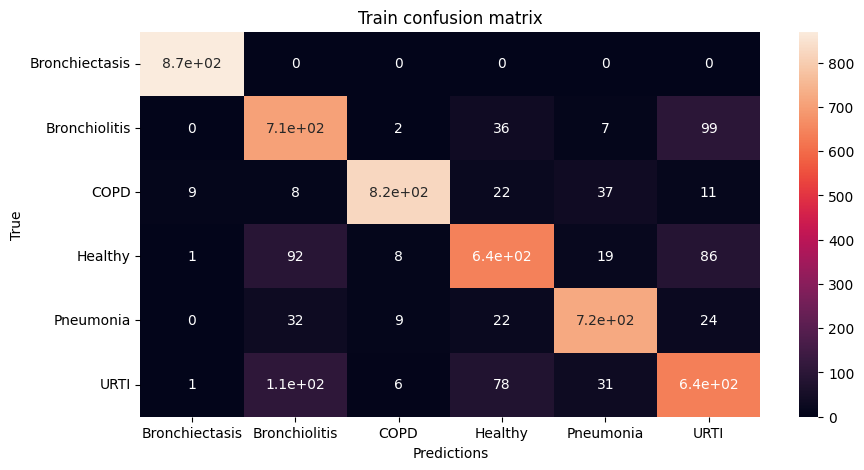

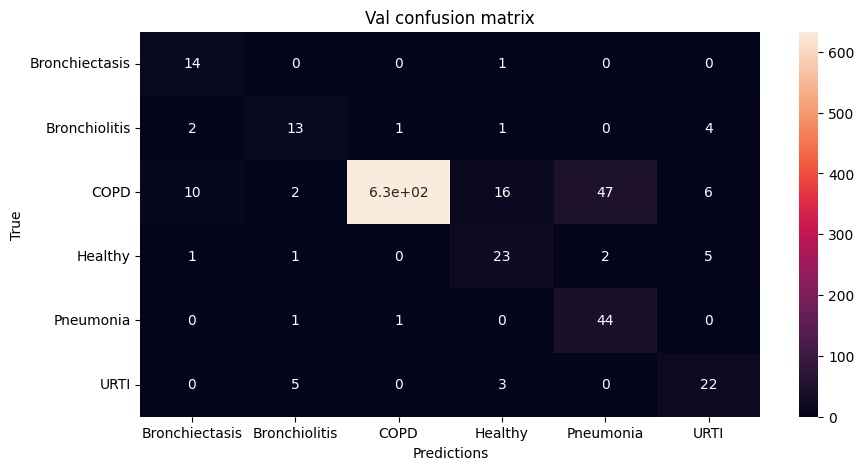


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 46:

Train Accuracy: 0.8509083850931677

Train Loss: 0.4053895973270724

Train F1 Score: 0.8372263923194838

Val Accuracy: 0.8730413105413105

Val Loss: 0.3432114212601273

Val F1 Score: 0.5515765889927193




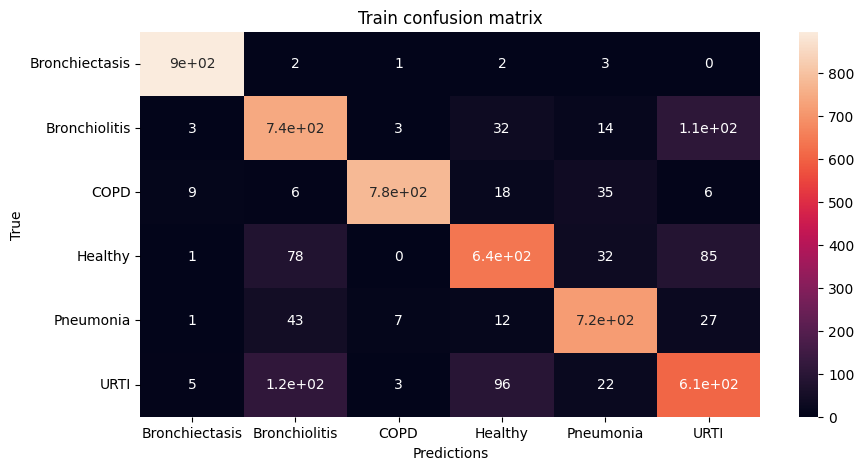

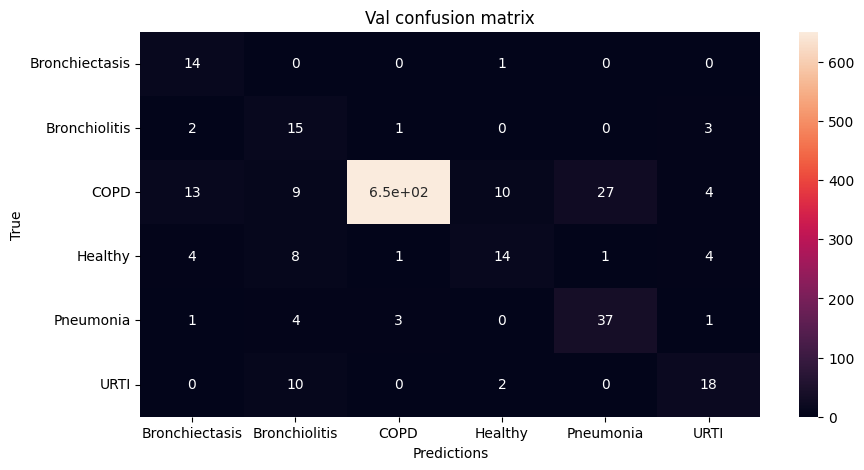


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 47:

Train Accuracy: 0.8576708074534162

Train Loss: 0.40343296638927106

Train F1 Score: 0.8417249347852624

Val Accuracy: 0.8985042735042734

Val Loss: 0.29055337193939423

Val F1 Score: 0.6427257795024801




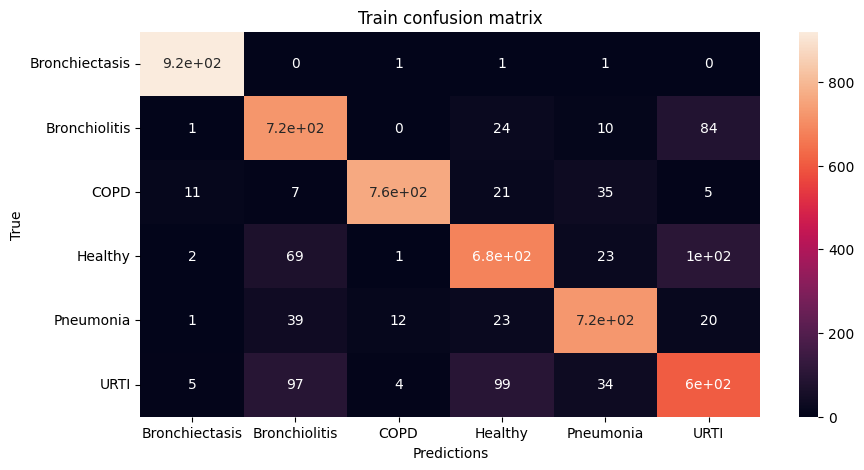

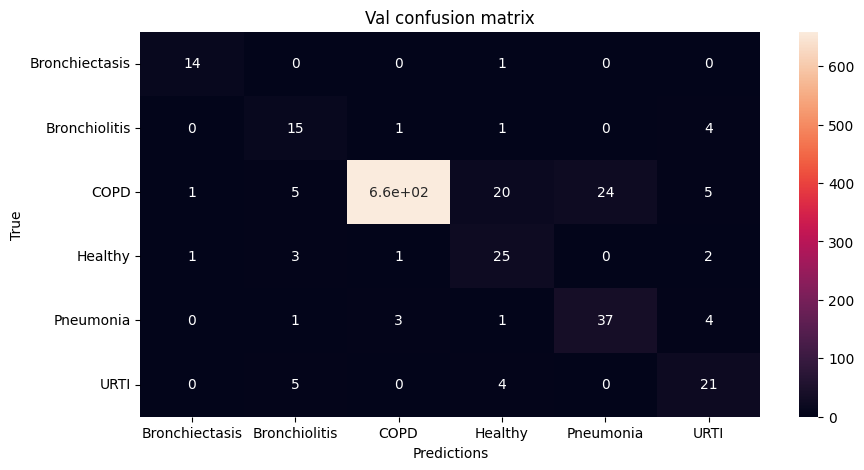


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 48:

Train Accuracy: 0.8432531055900621

Train Loss: 0.4297527346922004

Train F1 Score: 0.8290510099867116

Val Accuracy: 0.8808760683760684

Val Loss: 0.33980319262654696

Val F1 Score: 0.6307099649199733




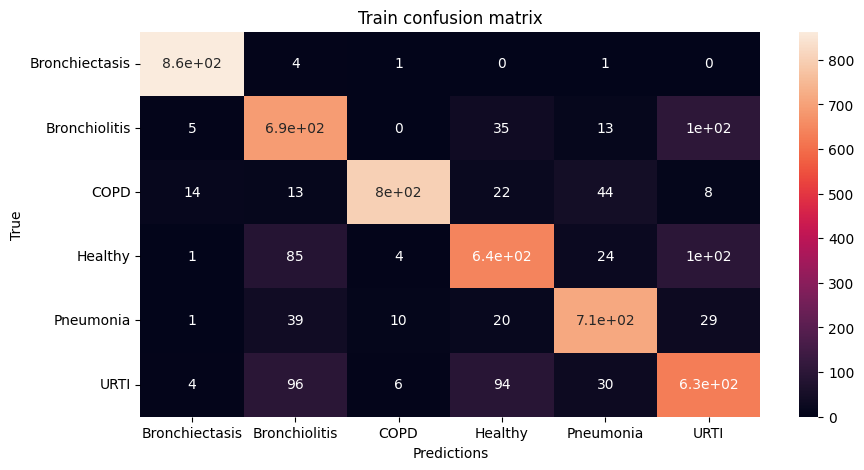

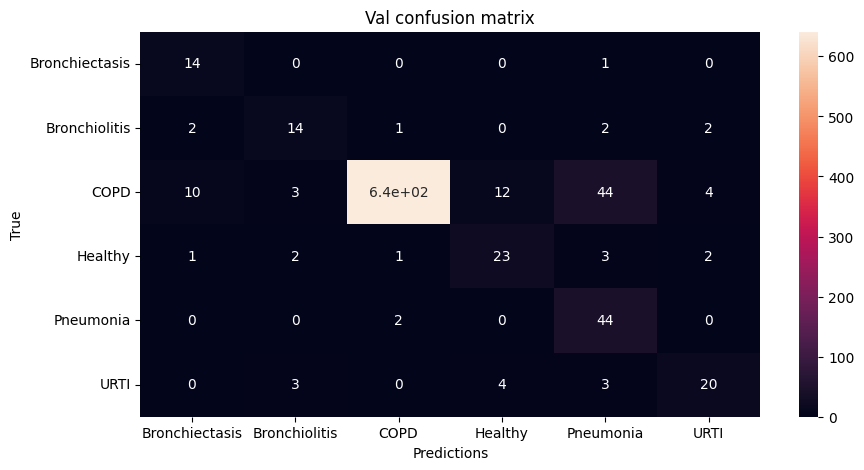


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 49:

Train Accuracy: 0.8469953416149069

Train Loss: 0.4083887673683048

Train F1 Score: 0.8311662411097414

Val Accuracy: 0.9004629629629629

Val Loss: 0.28424155629343456

Val F1 Score: 0.6558647851149241




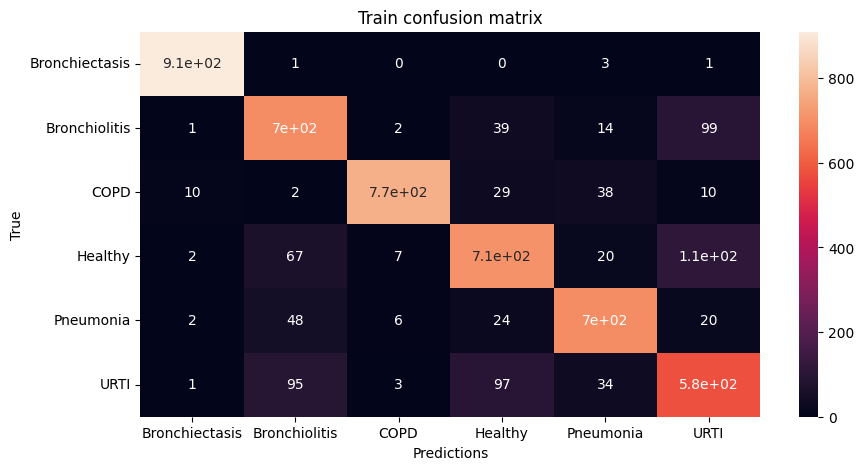

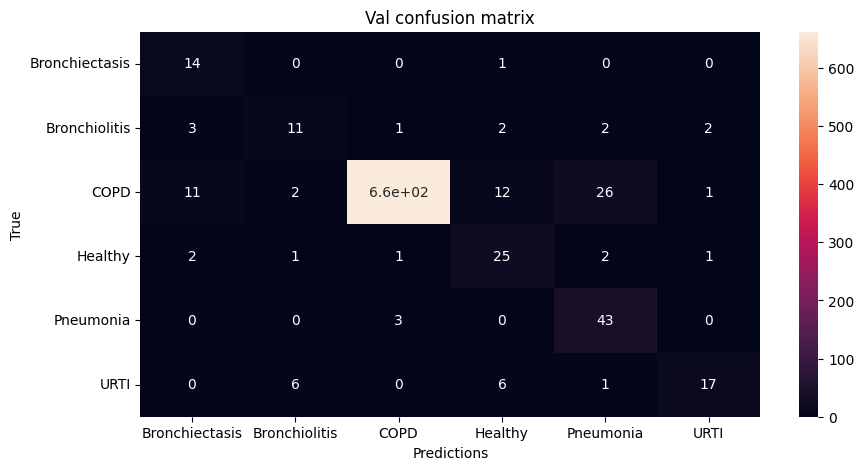


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 50:

Train Accuracy: 0.8432531055900621

Train Loss: 0.4212970448576886

Train F1 Score: 0.8238759907136052

Val Accuracy: 0.8839921652421652

Val Loss: 0.33365214671249743

Val F1 Score: 0.6342412884588595




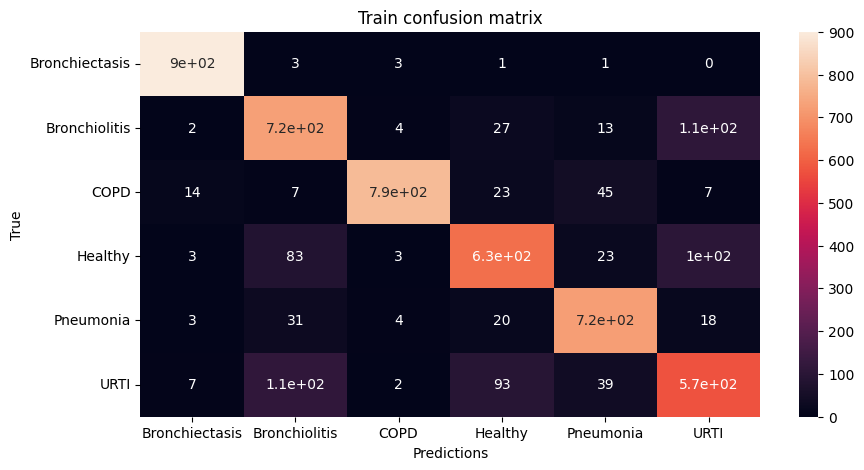

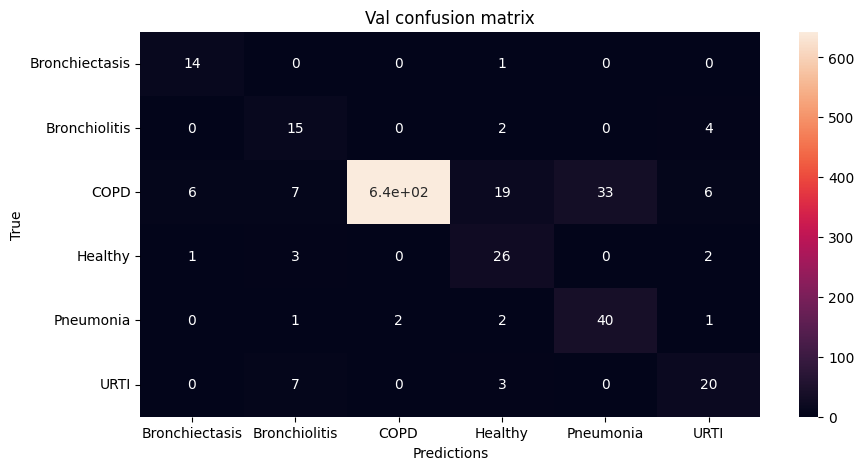


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 51:

Train Accuracy: 0.8542624223602484

Train Loss: 0.41856464558506606

Train F1 Score: 0.8437940511644256

Val Accuracy: 0.8475783475783475

Val Loss: 0.43747363046363547

Val F1 Score: 0.5588868304535195




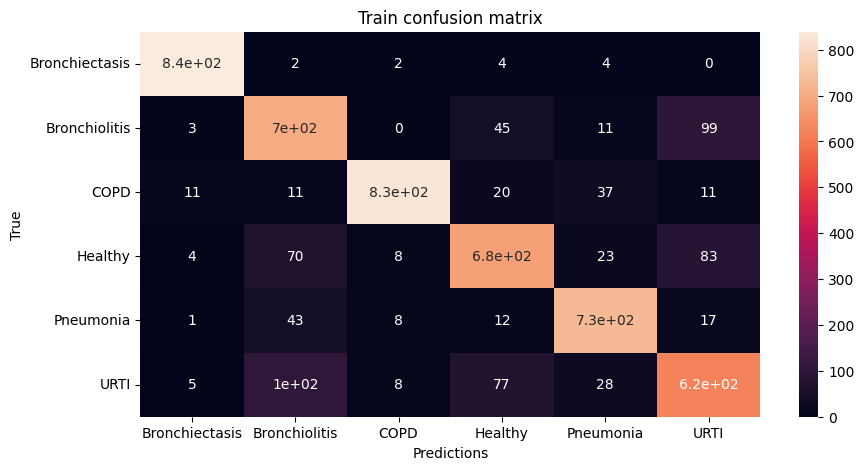

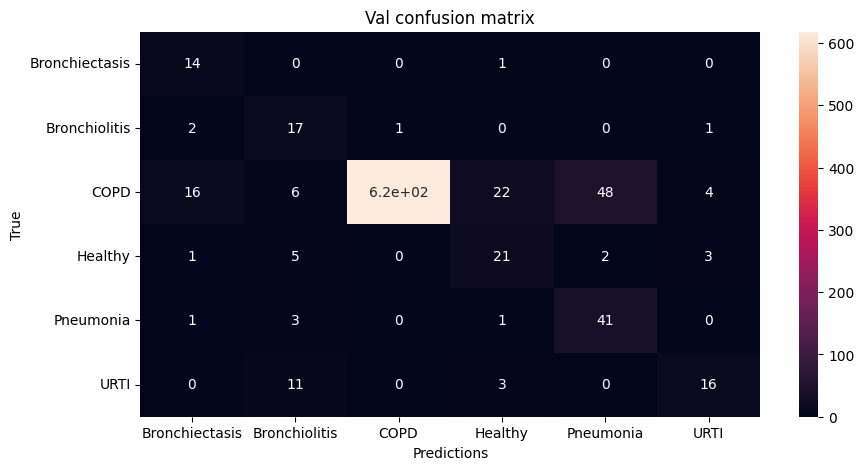


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 52:

Train Accuracy: 0.8640527950310559

Train Loss: 0.3891183956069236

Train F1 Score: 0.8535066502434867

Val Accuracy: 0.8556801994301994

Val Loss: 0.41667017892554953

Val F1 Score: 0.5955116980605655




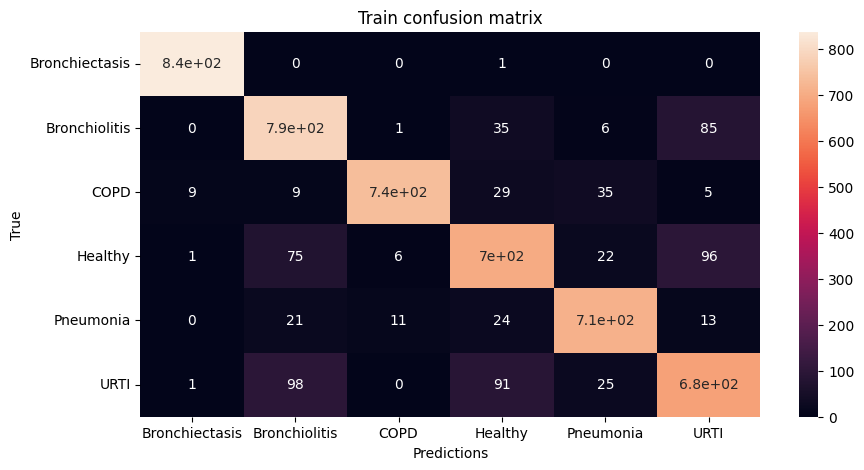

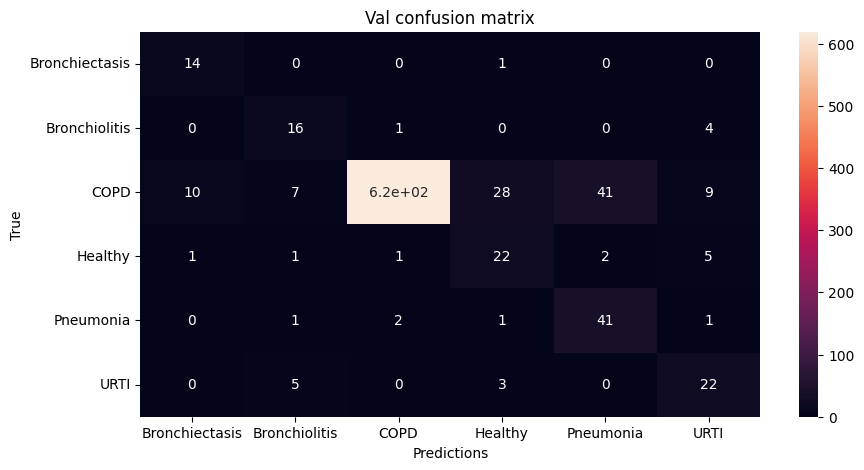


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 53:

Train Accuracy: 0.8651319875776398

Train Loss: 0.381339572508883

Train F1 Score: 0.8499249786323642

Val Accuracy: 0.870815527065527

Val Loss: 0.3675695417655839

Val F1 Score: 0.6243201582520096




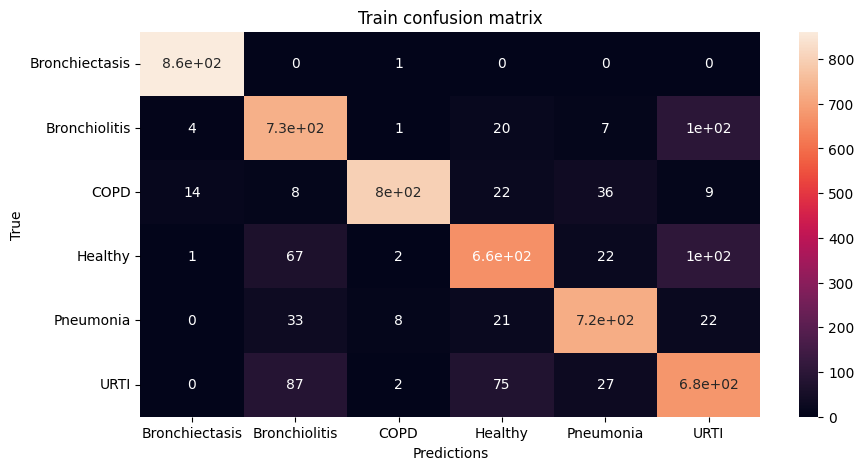

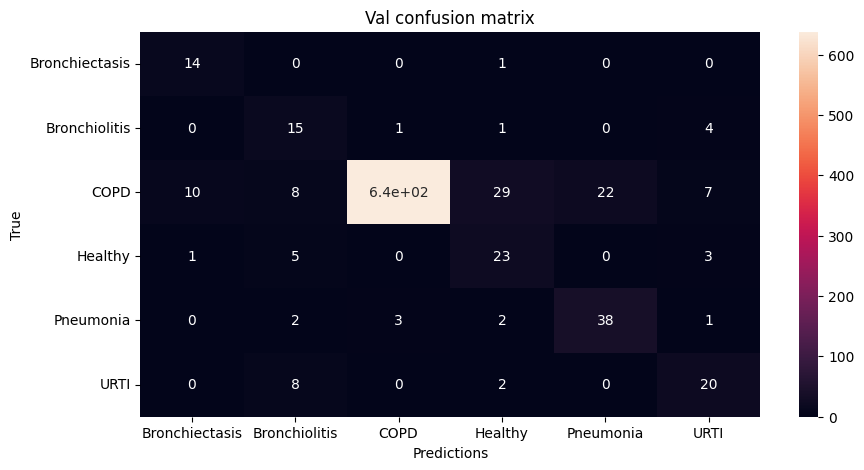


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 54:

Train Accuracy: 0.861777950310559

Train Loss: 0.3914380990292715

Train F1 Score: 0.8511823286180911

Val Accuracy: 0.8770477207977208

Val Loss: 0.3486874448480429

Val F1 Score: 0.6360520654254489




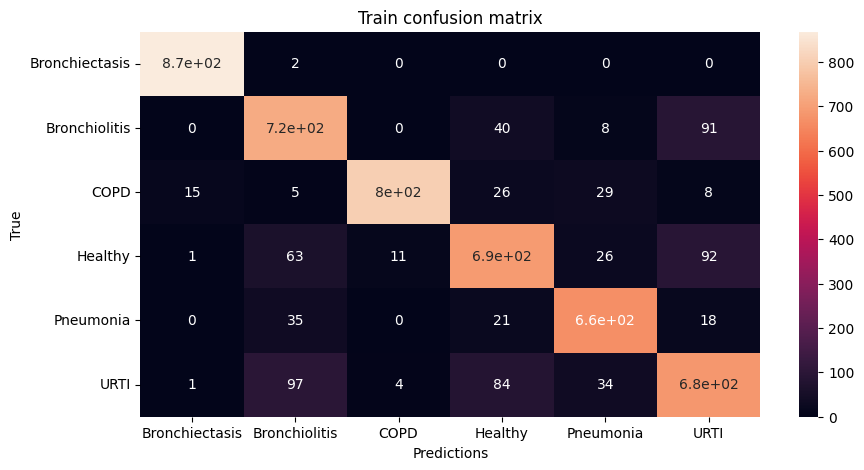

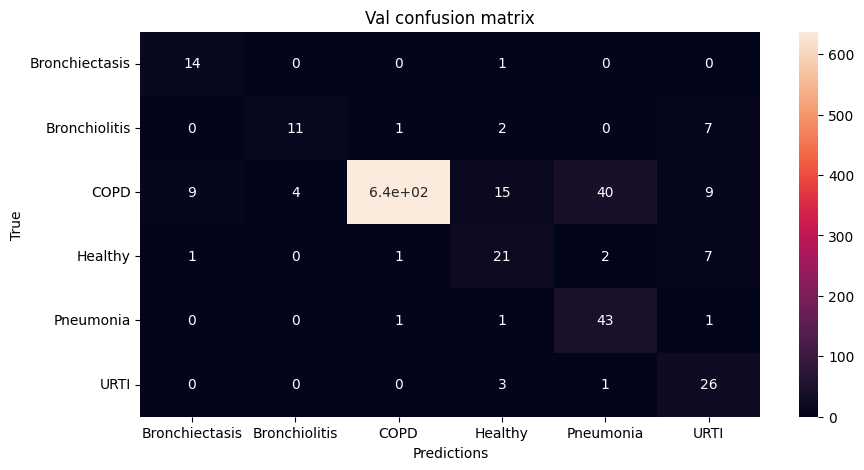


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 55:

Train Accuracy: 0.8723136645962732

Train Loss: 0.377796750446284

Train F1 Score: 0.8570297515910604

Val Accuracy: 0.8985042735042734

Val Loss: 0.3012779992487695

Val F1 Score: 0.6311255025642889




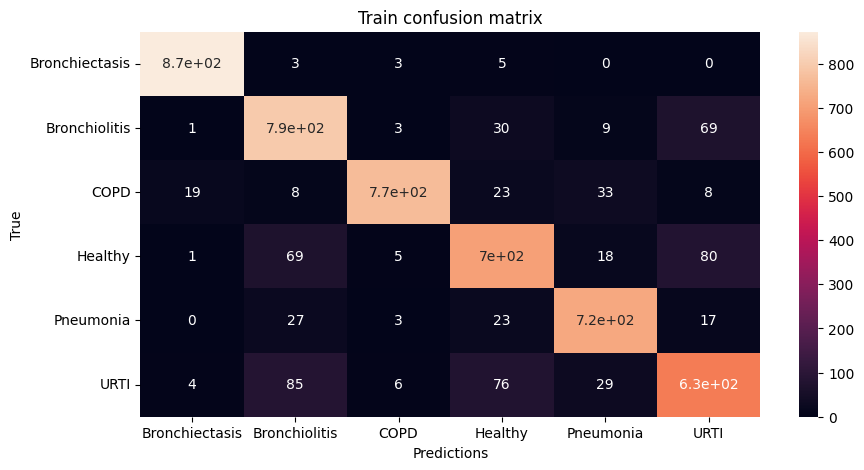

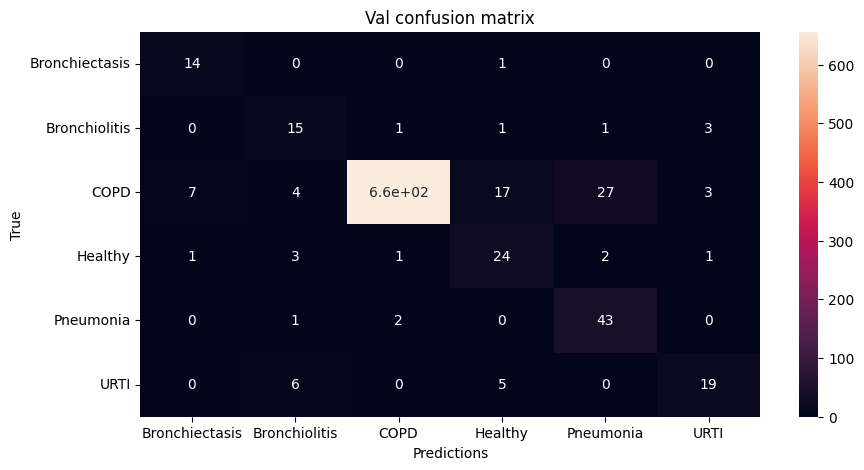


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 56:

Train Accuracy: 0.8709316770186335

Train Loss: 0.3682799973287938

Train F1 Score: 0.8611848887449466

Val Accuracy: 0.8487357549857549

Val Loss: 0.4689500629901886

Val F1 Score: 0.5918593671586778




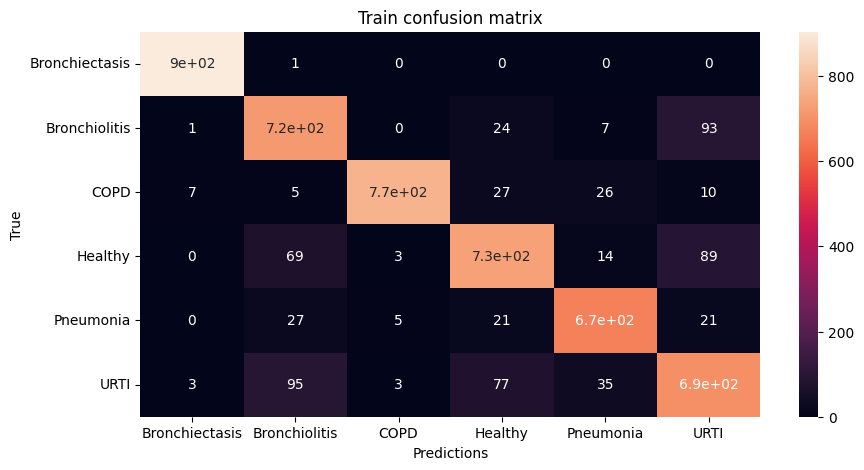

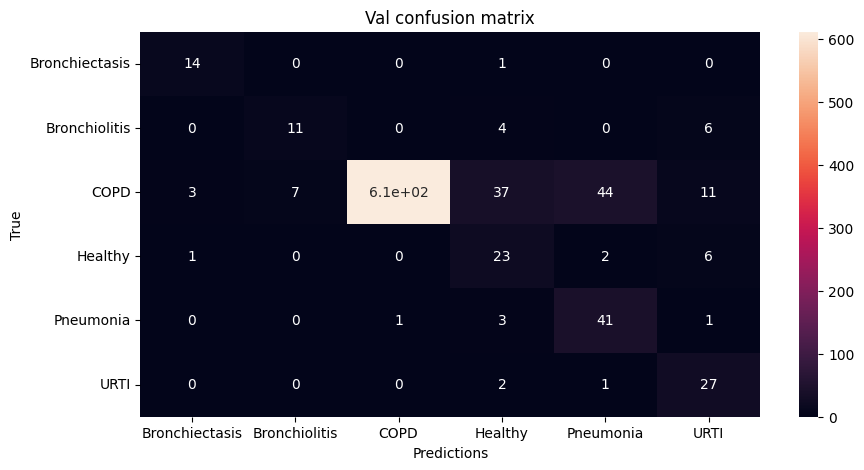


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 57:

Train Accuracy: 0.8702329192546583

Train Loss: 0.36163580454654576

Train F1 Score: 0.8556797745064919

Val Accuracy: 0.891559829059829

Val Loss: 0.3248142278580754

Val F1 Score: 0.6143698339109067




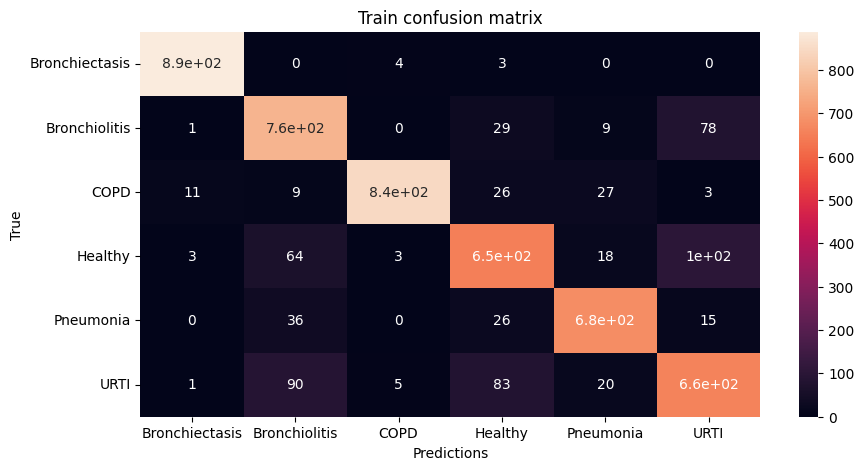

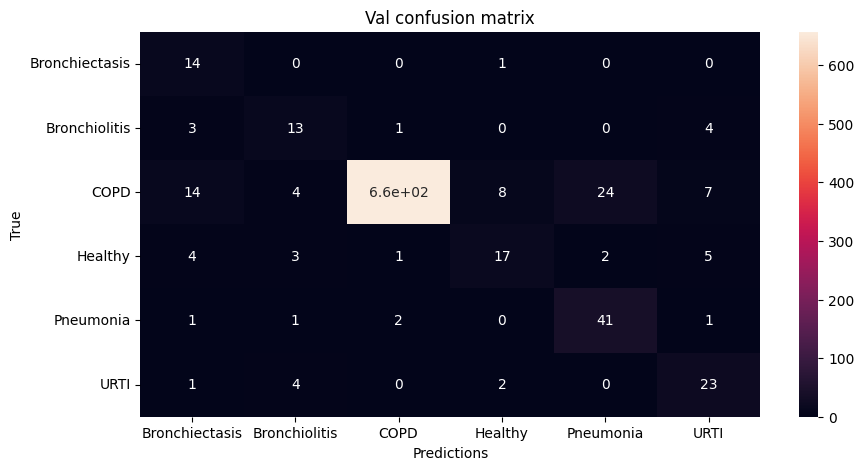


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 58:

Train Accuracy: 0.8698757763975156

Train Loss: 0.3718564308115414

Train F1 Score: 0.8575976631656197

Val Accuracy: 0.854255698005698

Val Loss: 0.4595696766067434

Val F1 Score: 0.601787727188181




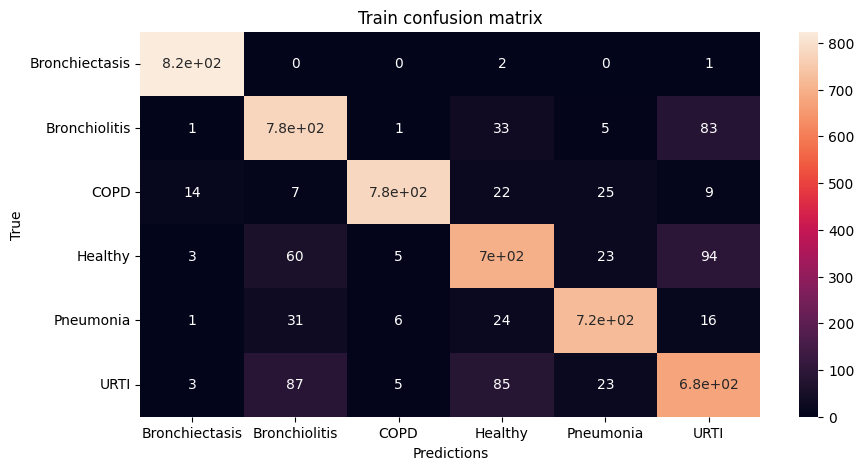

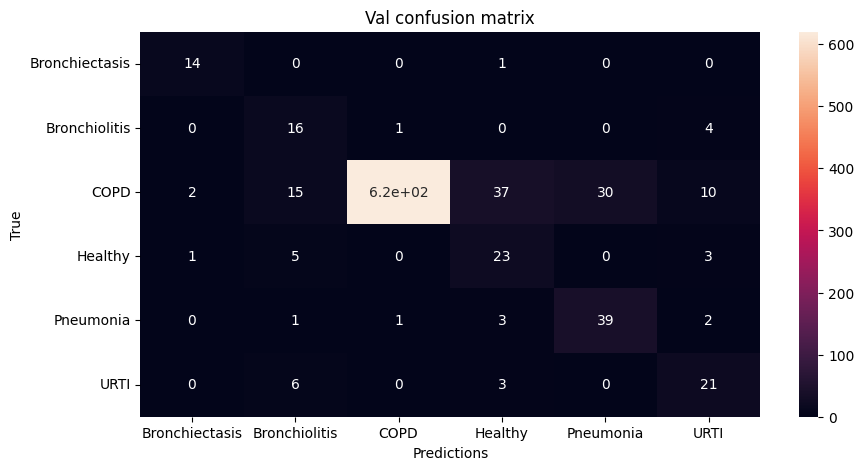


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 59:

Train Accuracy: 0.8714285714285716

Train Loss: 0.36177094123378306

Train F1 Score: 0.8600566050280696

Val Accuracy: 0.8964565527065527

Val Loss: 0.31581026039741655

Val F1 Score: 0.6729485502949467




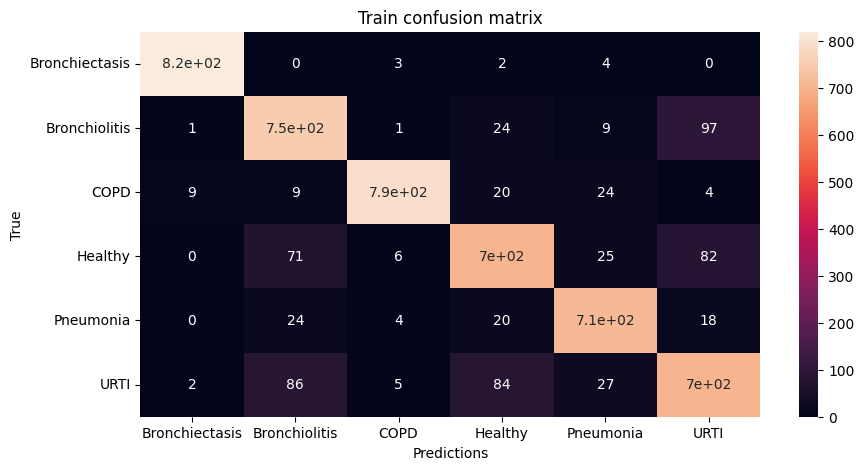

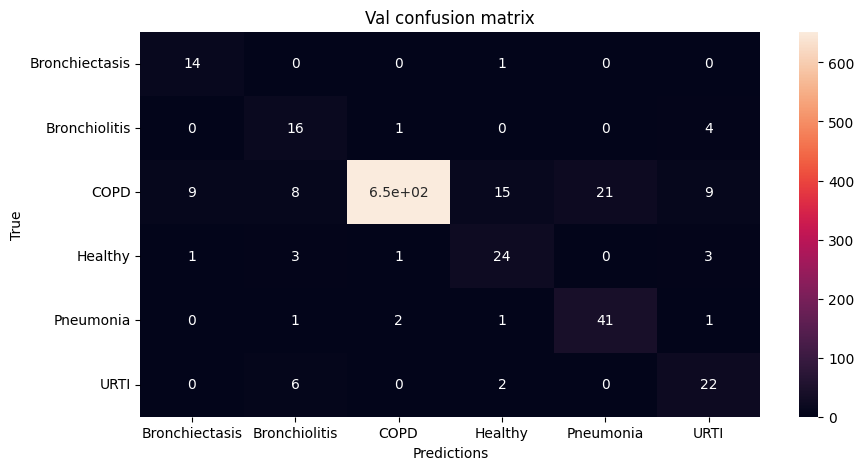


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 60:

Train Accuracy: 0.8757298136645963

Train Loss: 0.34545502524753535

Train F1 Score: 0.8627774493294473

Val Accuracy: 0.9141737891737891

Val Loss: 0.24983908898300594

Val F1 Score: 0.7088088415287159




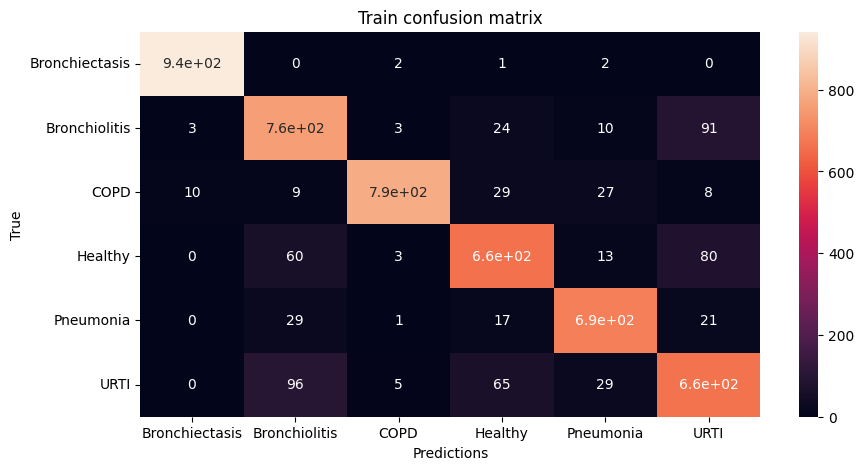

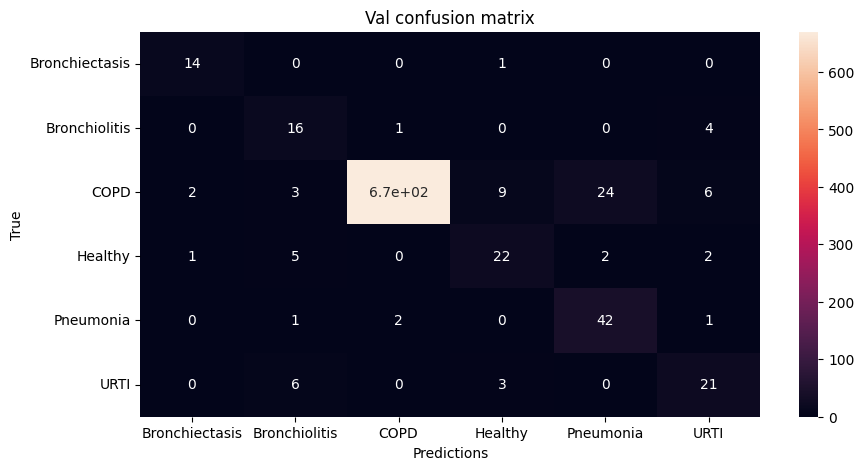


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 61:

Train Accuracy: 0.8812422360248446

Train Loss: 0.3366979048211382

Train F1 Score: 0.868865994933229

Val Accuracy: 0.9051816239316239

Val Loss: 0.2707033044210187

Val F1 Score: 0.6307702428764768




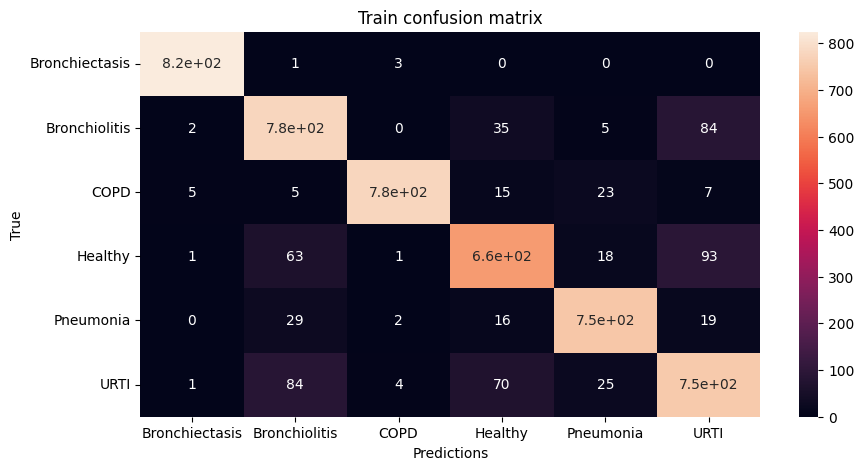

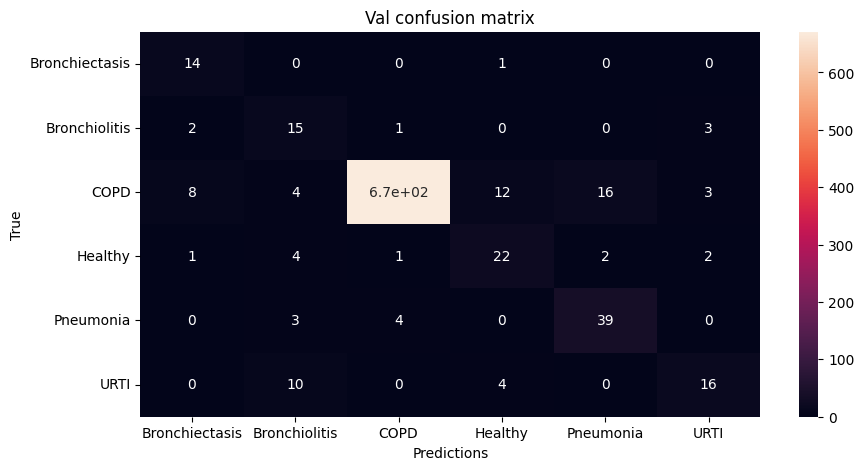


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 62:

Train Accuracy: 0.8783307453416149

Train Loss: 0.3418196927964317

Train F1 Score: 0.86487779261903

Val Accuracy: 0.9010861823361823

Val Loss: 0.26732093399321594

Val F1 Score: 0.640456133418613




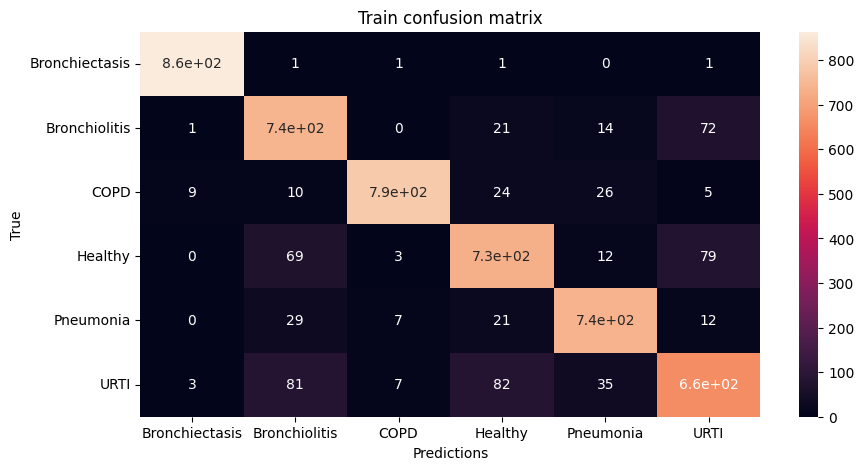

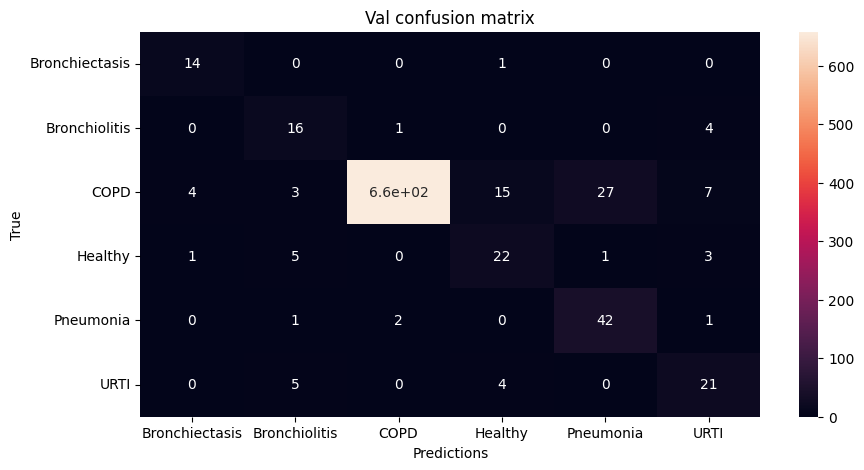


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 63:

Train Accuracy: 0.8714829192546584

Train Loss: 0.34936113539874925

Train F1 Score: 0.8592159100200819

Val Accuracy: 0.8635149572649573

Val Loss: 0.39516741782426834

Val F1 Score: 0.627238126816573




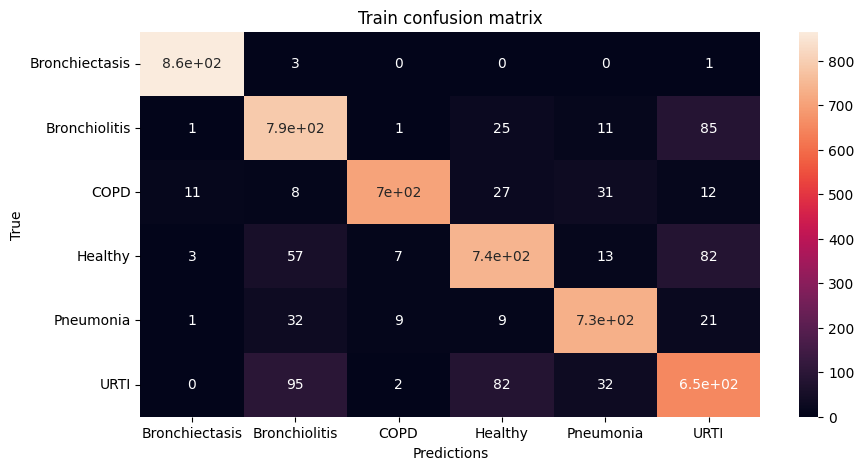

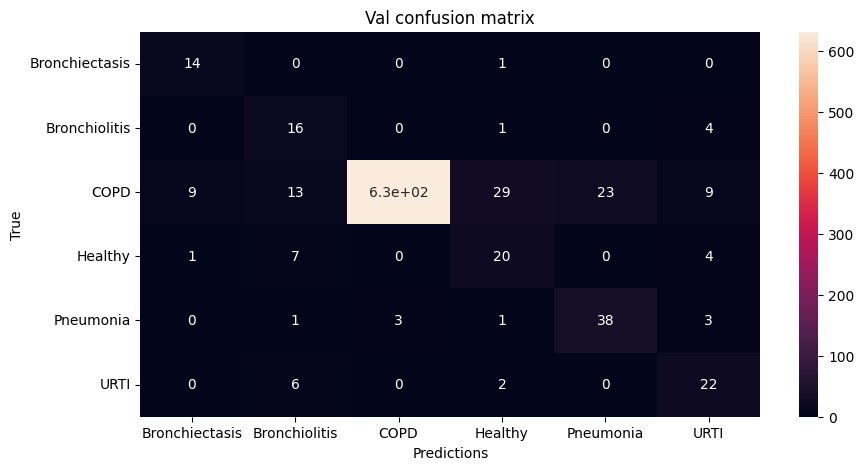


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 64:

Train Accuracy: 0.8895885093167701

Train Loss: 0.3178611893368804

Train F1 Score: 0.8774274247033256

Val Accuracy: 0.892094017094017

Val Loss: 0.3014194228582912

Val F1 Score: 0.6384616240307137




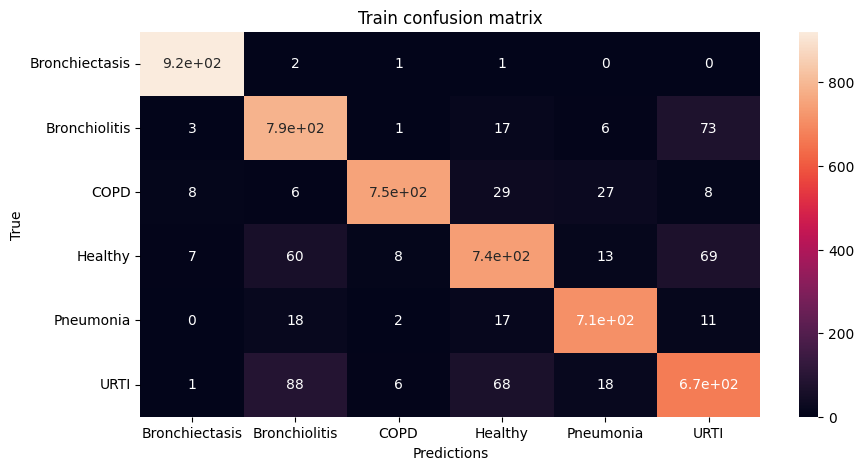

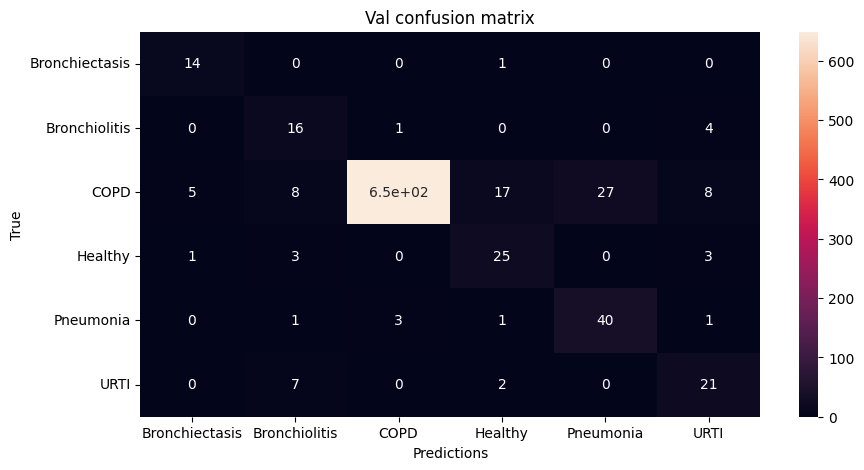


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 65:

Train Accuracy: 0.892694099378882

Train Loss: 0.30482476412879755

Train F1 Score: 0.8818262137981675

Val Accuracy: 0.8828347578347577

Val Loss: 0.3393006711094468

Val F1 Score: 0.6060833980639776




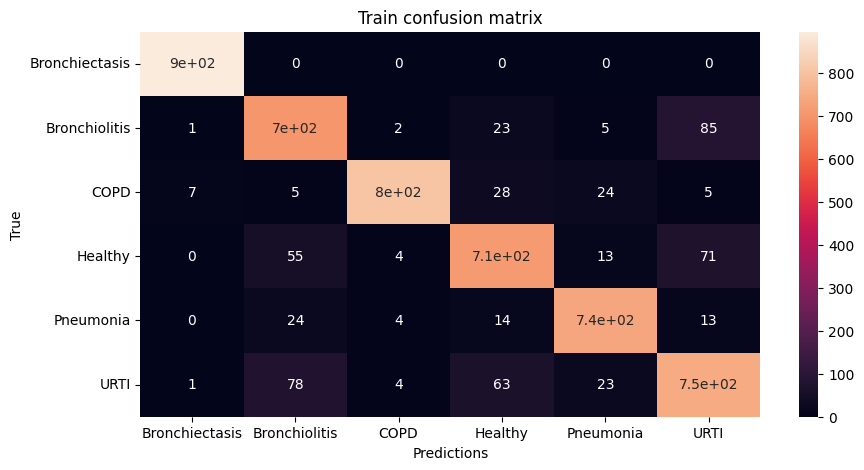

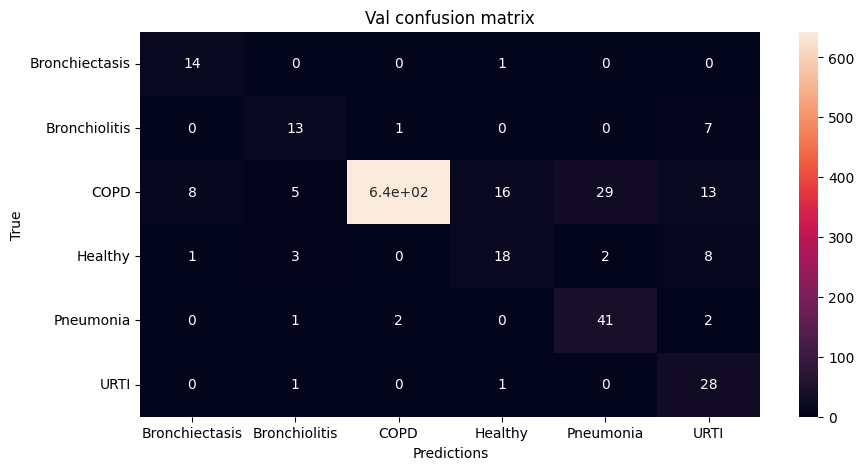


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 66:

Train Accuracy: 0.8896428571428571

Train Loss: 0.32641290600255407

Train F1 Score: 0.878594946787224

Val Accuracy: 0.9045584045584045

Val Loss: 0.2645212206299658

Val F1 Score: 0.6655101014508141




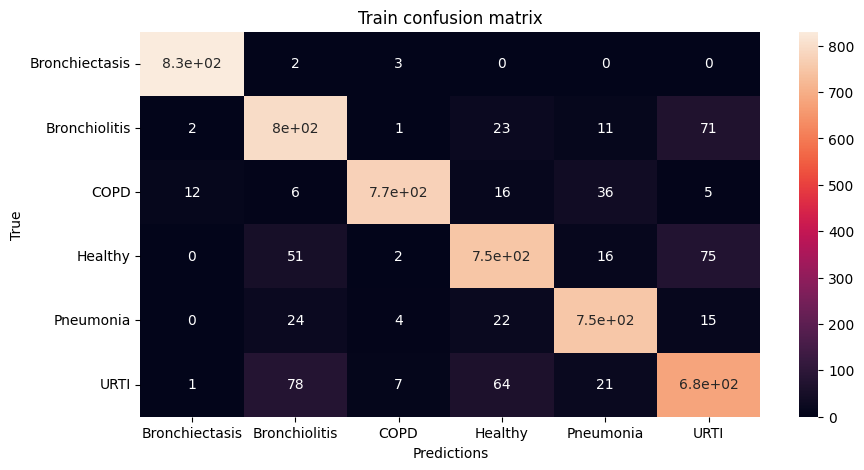

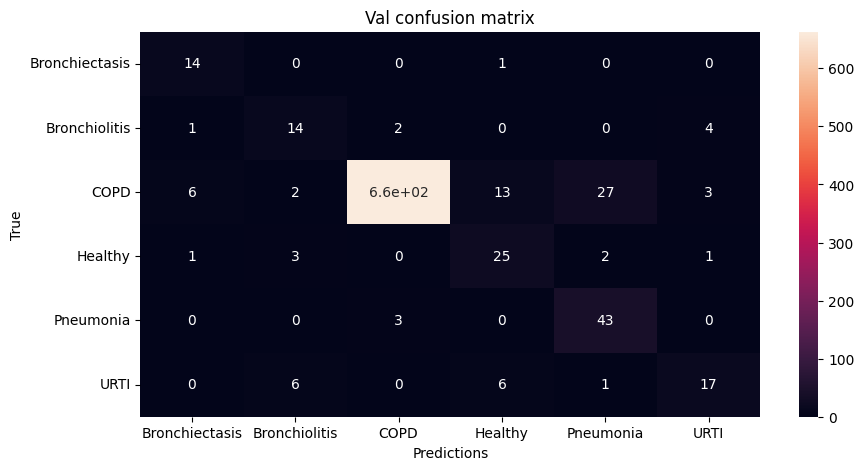


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 67:

Train Accuracy: 0.8878959627329192

Train Loss: 0.31402508683086183

Train F1 Score: 0.8745844930595492

Val Accuracy: 0.9039351851851852

Val Loss: 0.28144207251844583

Val F1 Score: 0.6316597251980393




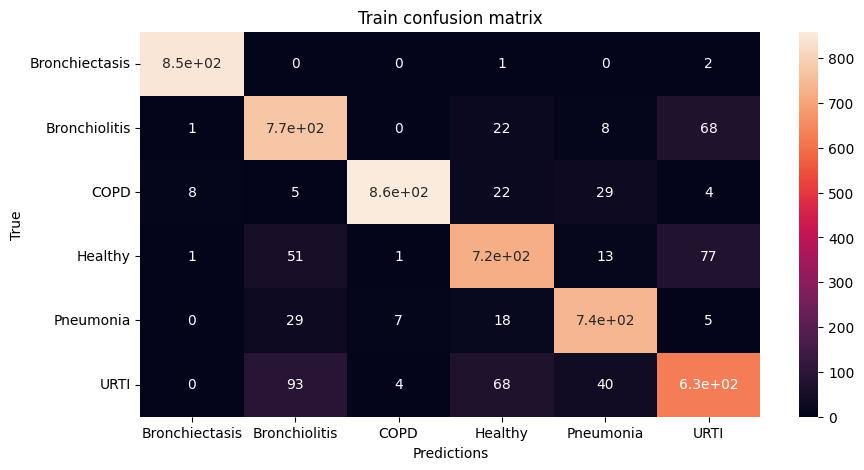

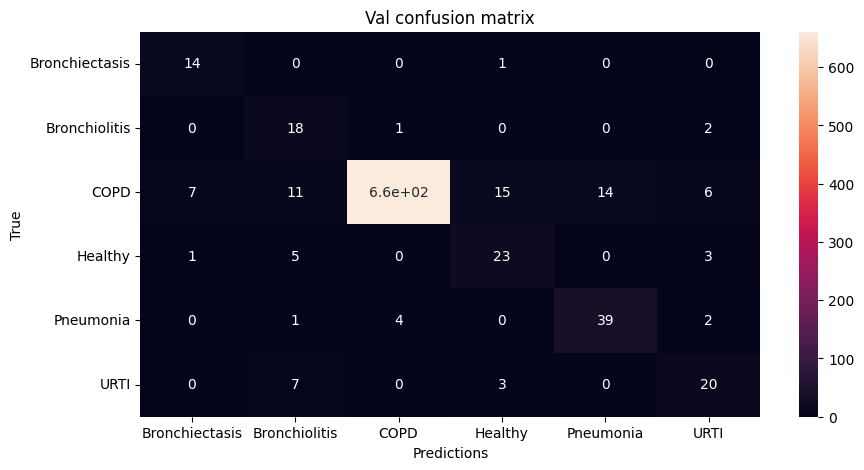


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 68:

Train Accuracy: 0.893082298136646

Train Loss: 0.31296892788099206

Train F1 Score: 0.8844558852059501

Val Accuracy: 0.9083867521367521

Val Loss: 0.25949110201111547

Val F1 Score: 0.6671706140041351




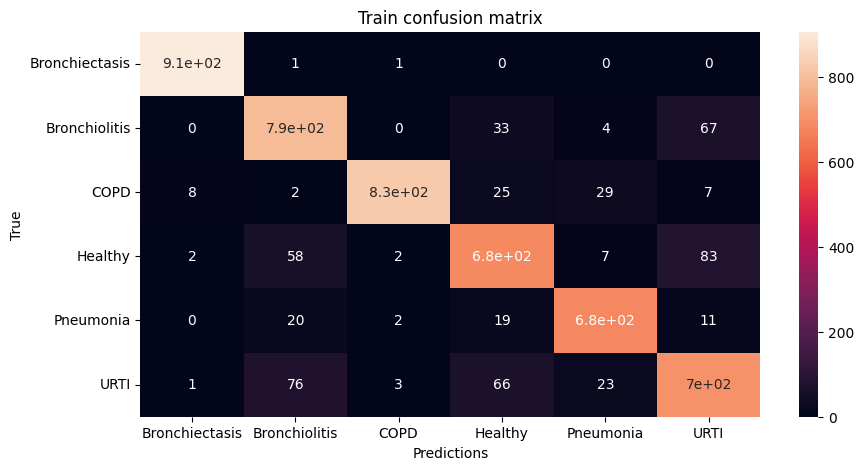

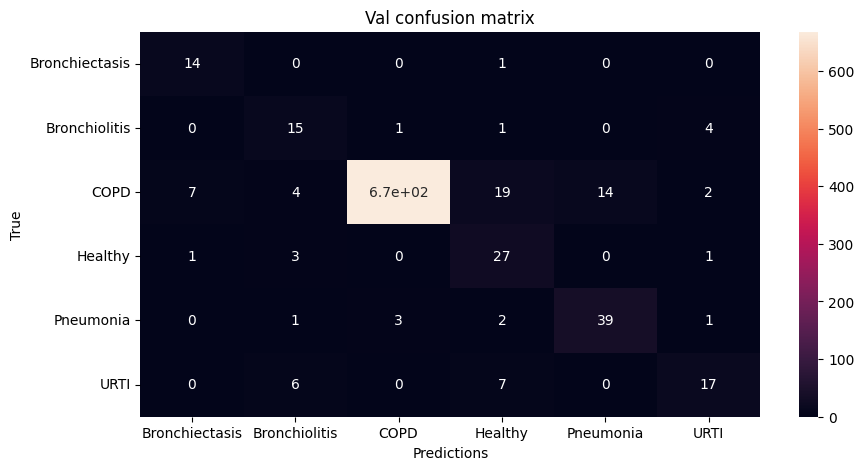


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 69:

Train Accuracy: 0.8906444099378883

Train Loss: 0.30971896643779295

Train F1 Score: 0.8791679225352981

Val Accuracy: 0.8982371794871795

Val Loss: 0.28125442288540026

Val F1 Score: 0.658458348777559




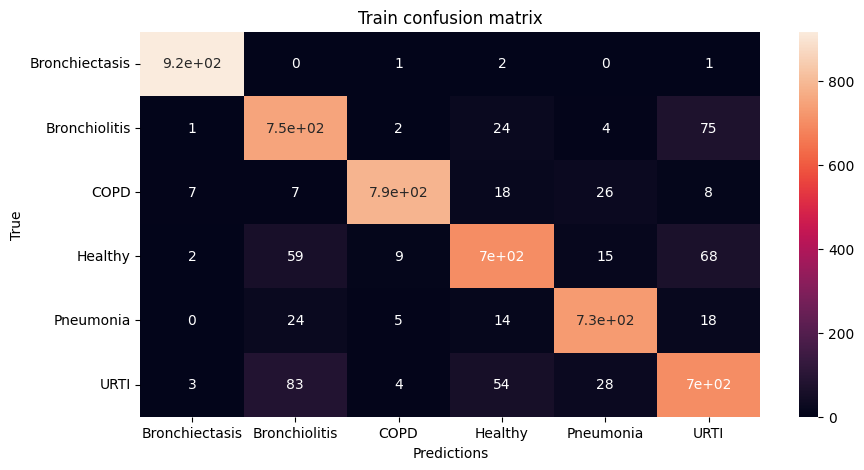

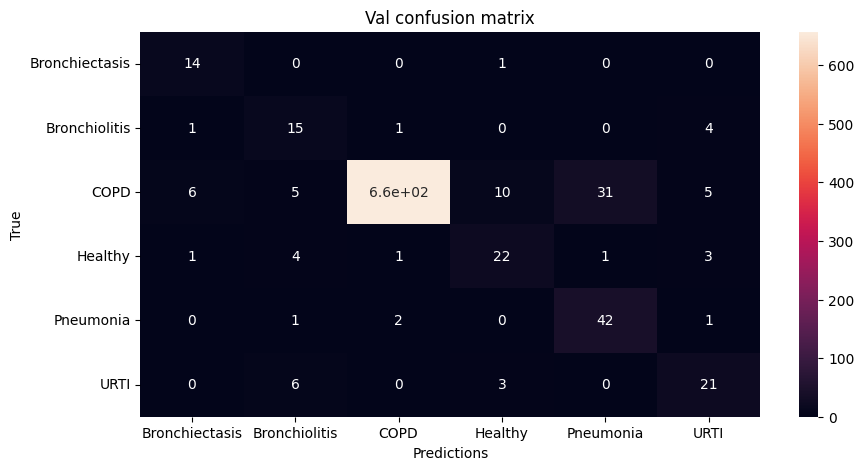


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 70:

Train Accuracy: 0.8994332298136646

Train Loss: 0.2989661674136701

Train F1 Score: 0.8873483953268632

Val Accuracy: 0.8820334757834758

Val Loss: 0.3556070955539191

Val F1 Score: 0.6355448883992655




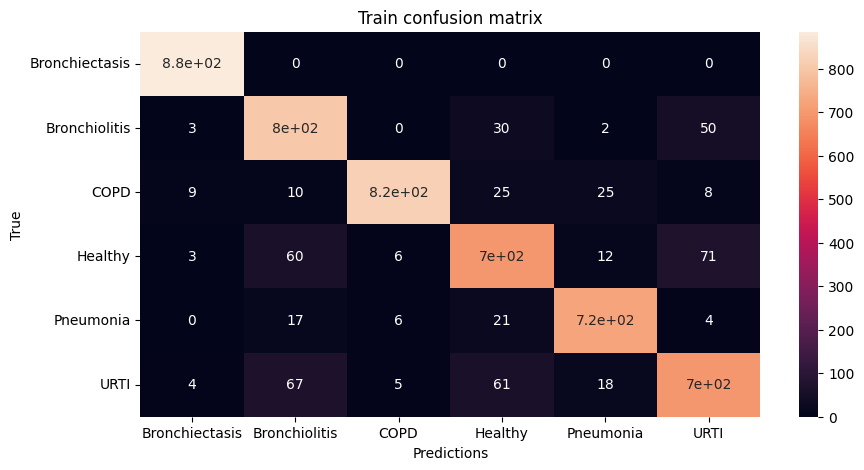

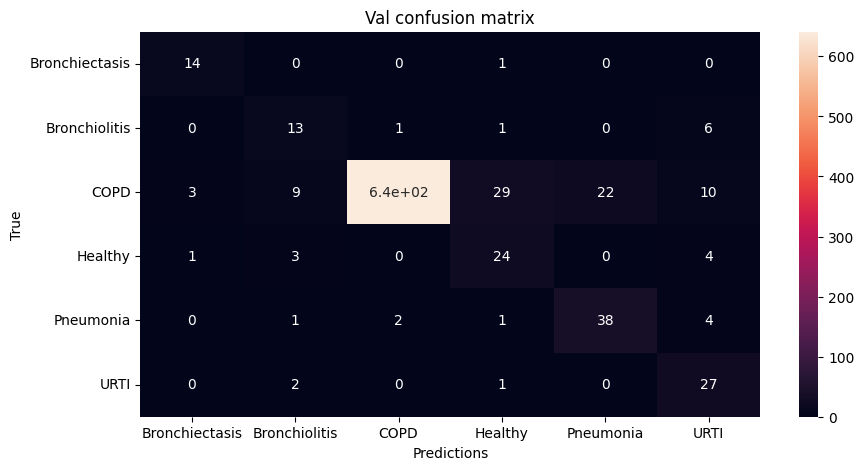


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 71:

Train Accuracy: 0.8982375776397516

Train Loss: 0.2900153672473031

Train F1 Score: 0.888441598933676

Val Accuracy: 0.9196047008547009

Val Loss: 0.23380739131459483

Val F1 Score: 0.6910514423140773




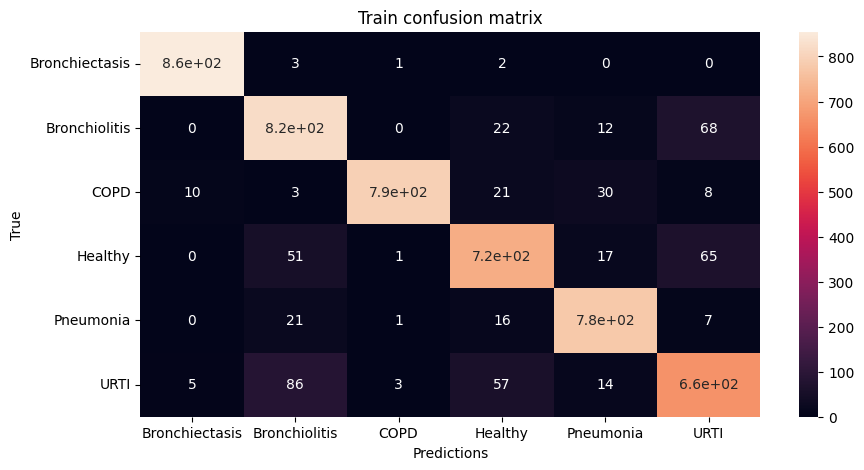

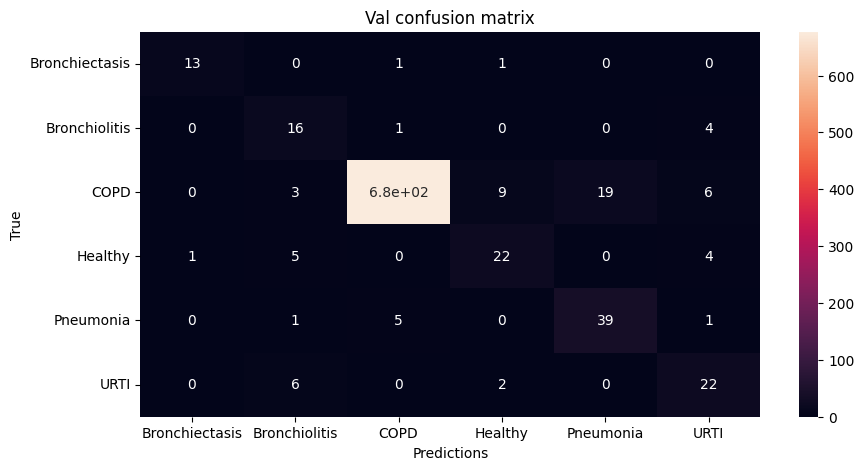


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 72:

Train Accuracy: 0.8829891304347826

Train Loss: 0.3137890453571859

Train F1 Score: 0.8691974582139009

Val Accuracy: 0.9066061253561253

Val Loss: 0.26313916235058393

Val F1 Score: 0.6859816561142603




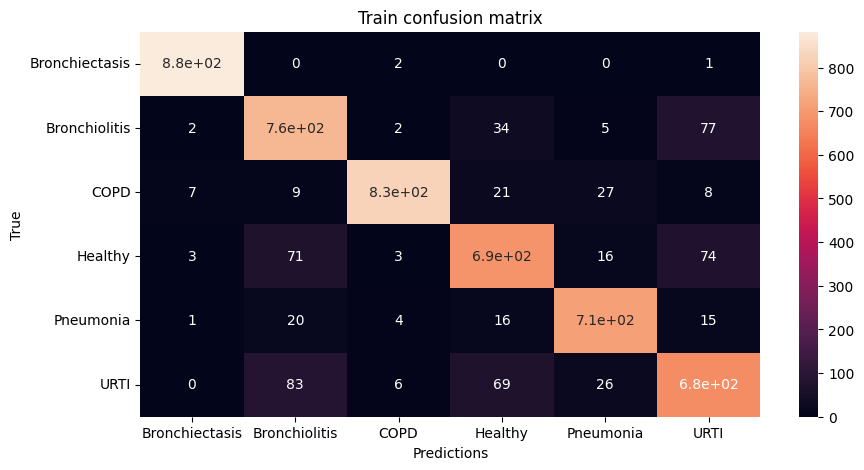

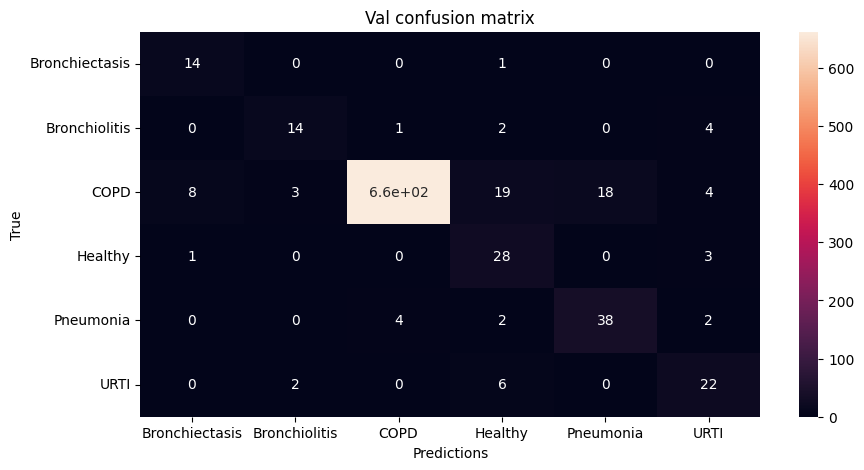


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 73:

Train Accuracy: 0.90527950310559

Train Loss: 0.2737862294690209

Train F1 Score: 0.8985842296055385

Val Accuracy: 0.8955662393162392

Val Loss: 0.3009827650255627

Val F1 Score: 0.6302512453662025




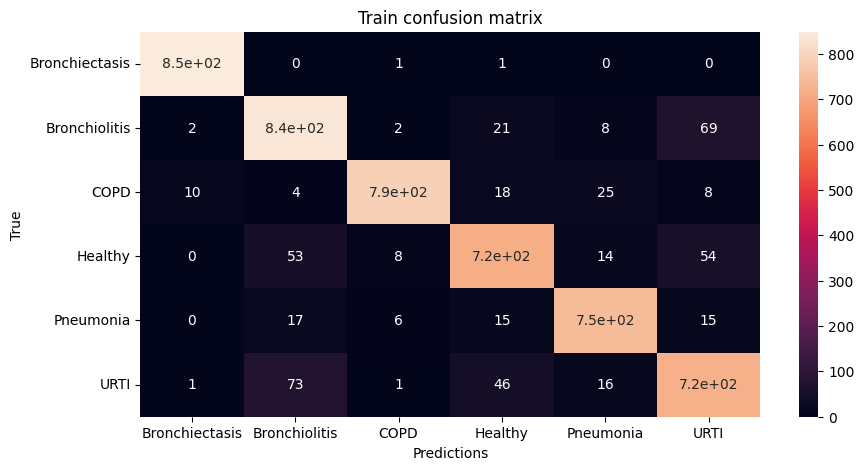

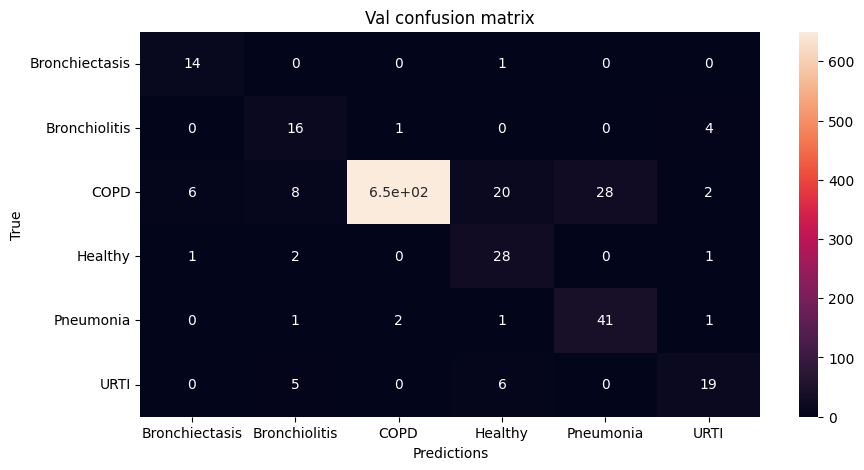


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 74:

Train Accuracy: 0.9016770186335403

Train Loss: 0.2876885425507652

Train F1 Score: 0.8922177008960558

Val Accuracy: 0.9212962962962963

Val Loss: 0.24240469104713863

Val F1 Score: 0.6319450614628969




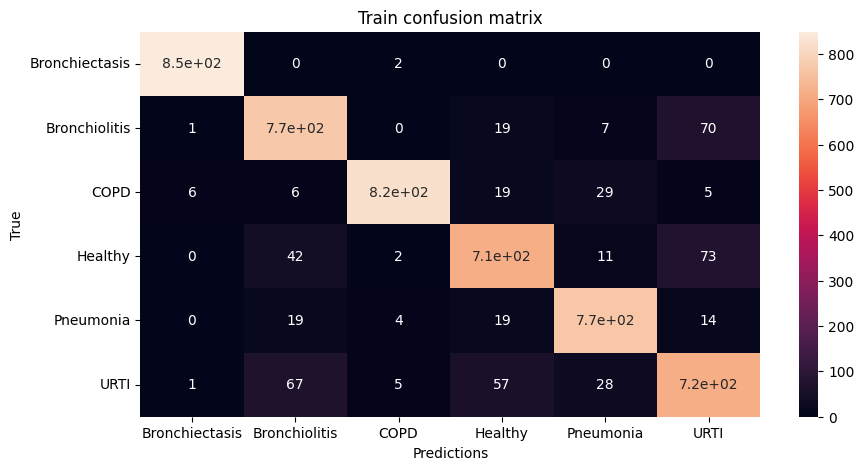

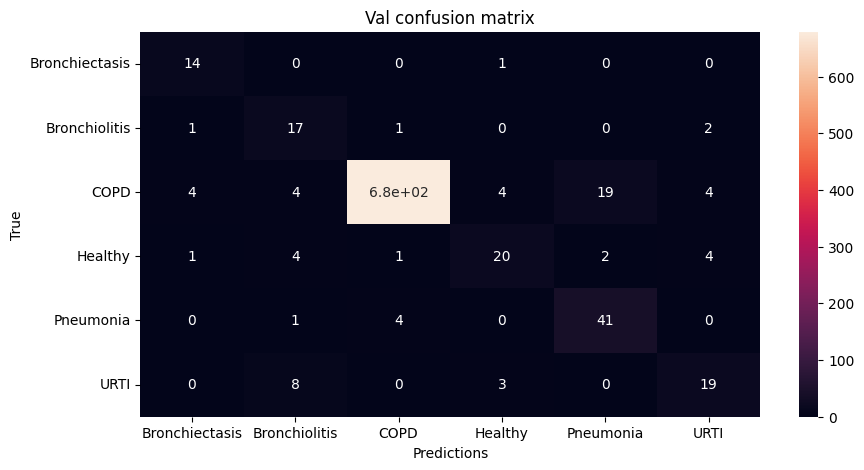


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 75:

Train Accuracy: 0.9067236024844719

Train Loss: 0.2650635027737351

Train F1 Score: 0.8960272473578127

Val Accuracy: 0.9123931623931624

Val Loss: 0.2669490023895546

Val F1 Score: 0.683762001770514




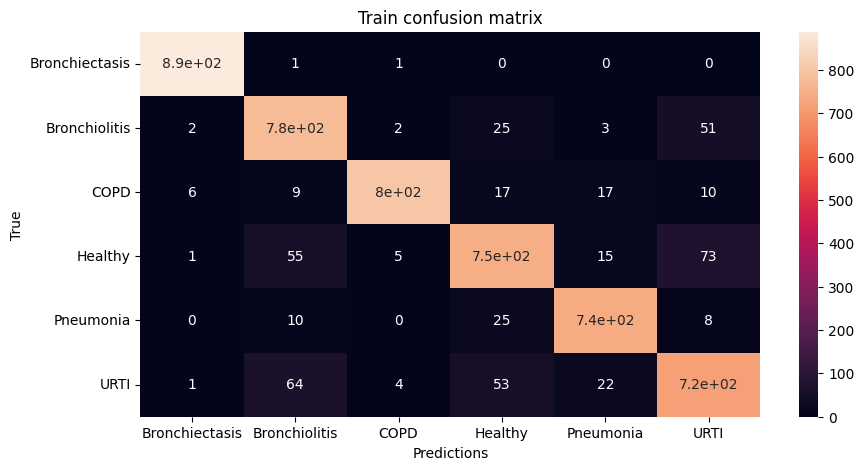

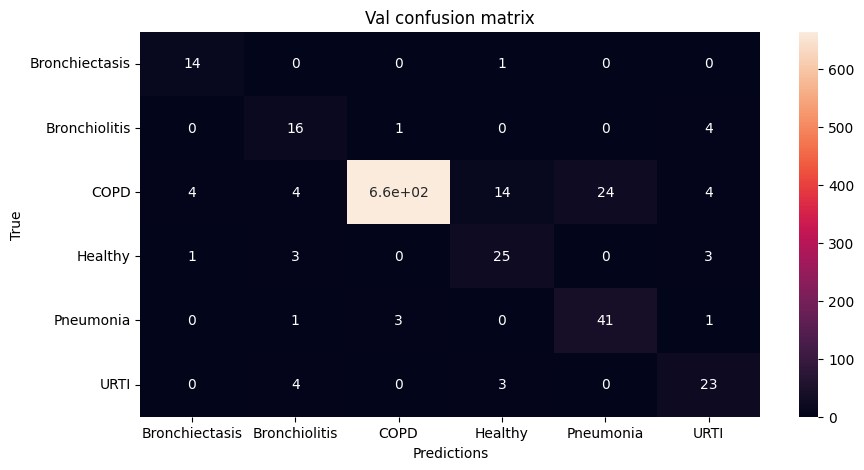


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 76:

Train Accuracy: 0.906917701863354

Train Loss: 0.28019109456250385

Train F1 Score: 0.8969995853323374

Val Accuracy: 0.9126602564102564

Val Loss: 0.2420410850878667

Val F1 Score: 0.6961598672248699




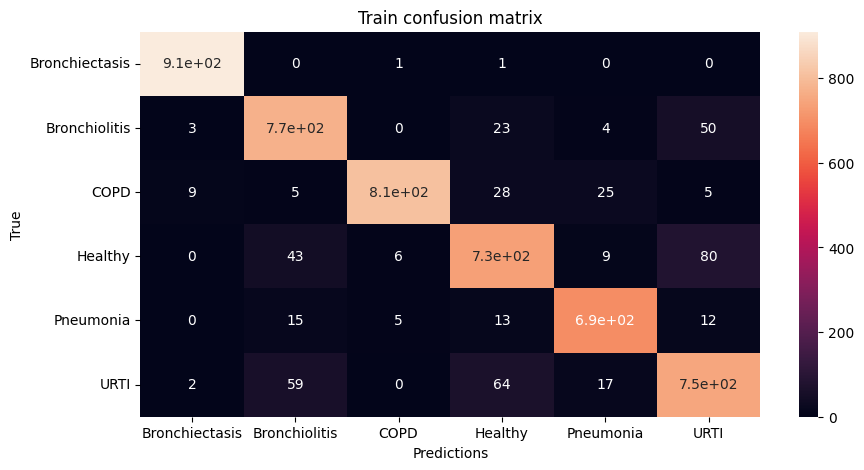

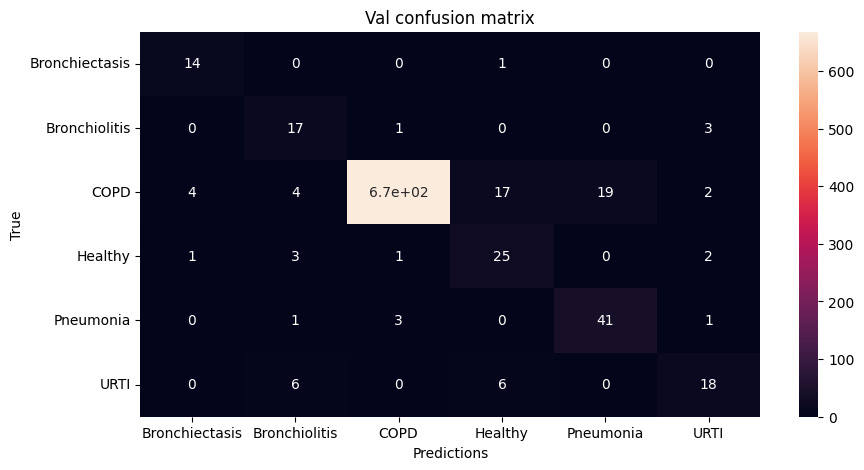


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 77:

Train Accuracy: 0.9079968944099379

Train Loss: 0.27492535202214435

Train F1 Score: 0.9009072162349772

Val Accuracy: 0.9013532763532763

Val Loss: 0.287428083933062

Val F1 Score: 0.6574347532457776




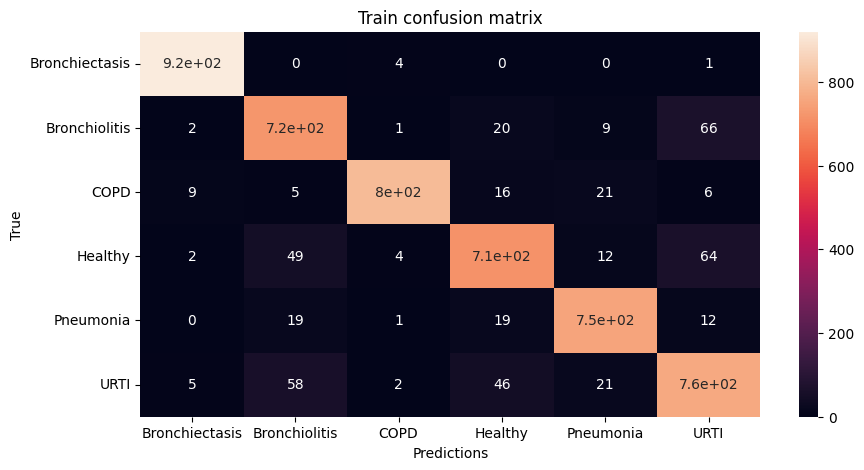

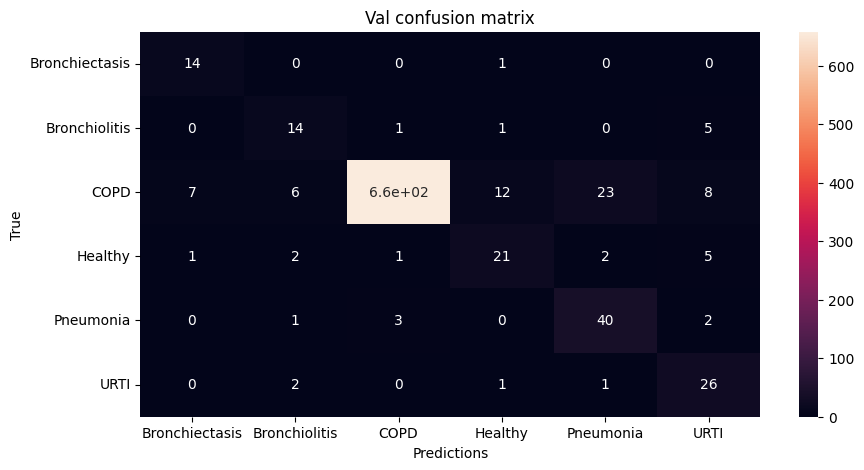


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 78:

Train Accuracy: 0.9060326086956522

Train Loss: 0.2763741590221476

Train F1 Score: 0.8953209323172243

Val Accuracy: 0.8990384615384615

Val Loss: 0.271419836346198

Val F1 Score: 0.60831301190235




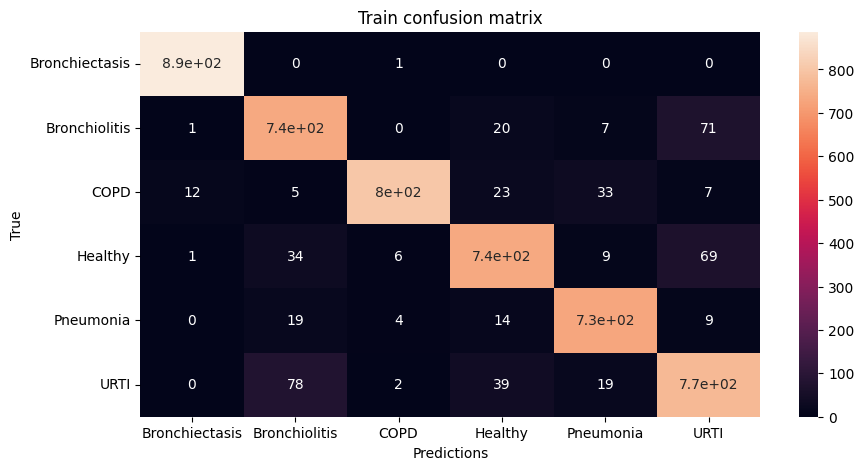

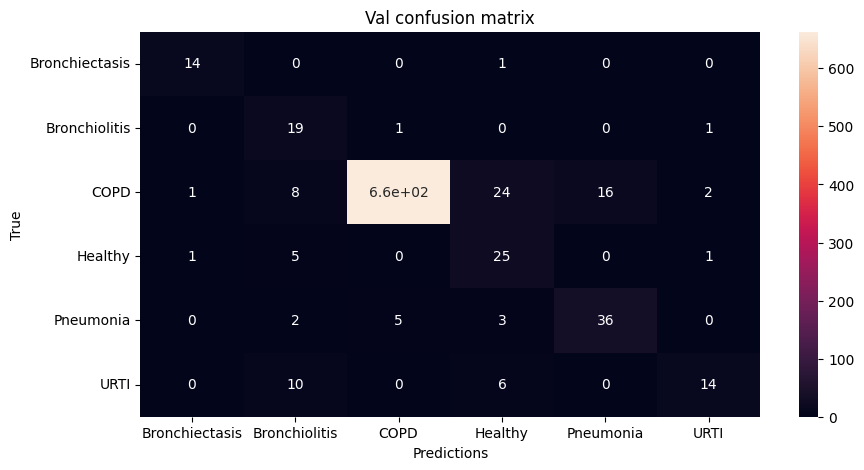


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 79:

Train Accuracy: 0.9116614906832299

Train Loss: 0.25615165720445027

Train F1 Score: 0.8996486189942923

Val Accuracy: 0.9112357549857549

Val Loss: 0.25328586830033195

Val F1 Score: 0.6866842320671788




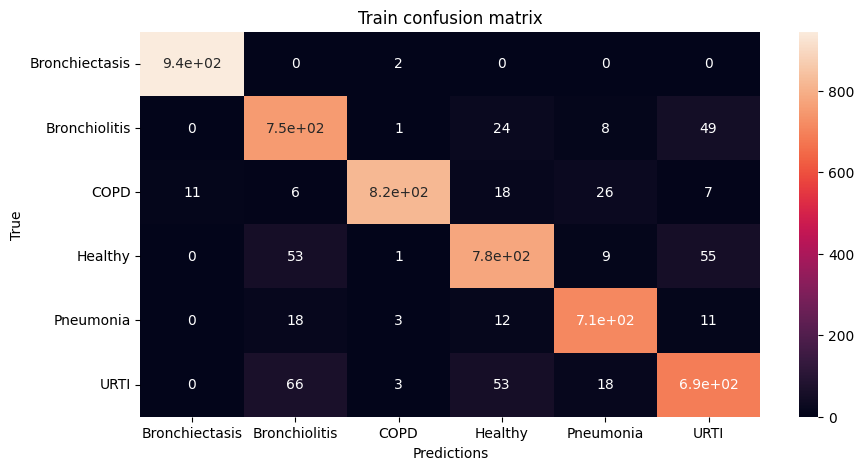

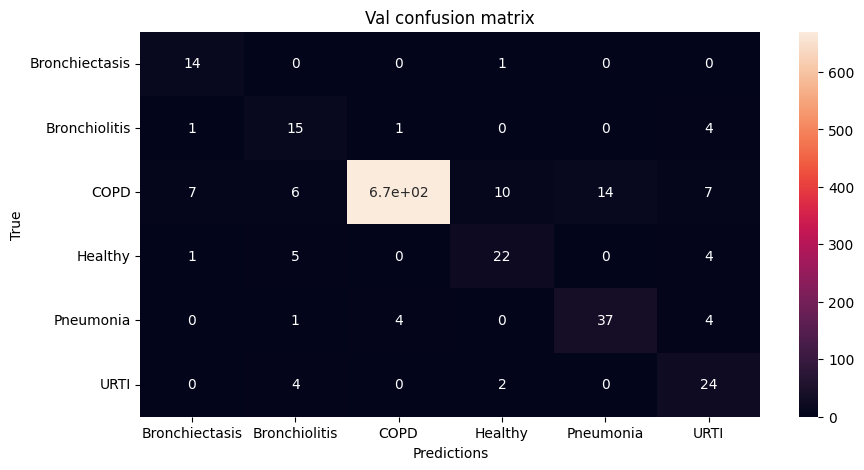


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 80:

Train Accuracy: 0.9105512422360248

Train Loss: 0.2510417747479048

Train F1 Score: 0.8994963369014101

Val Accuracy: 0.8861289173789174

Val Loss: 0.35082226484600043

Val F1 Score: 0.6504583491219414




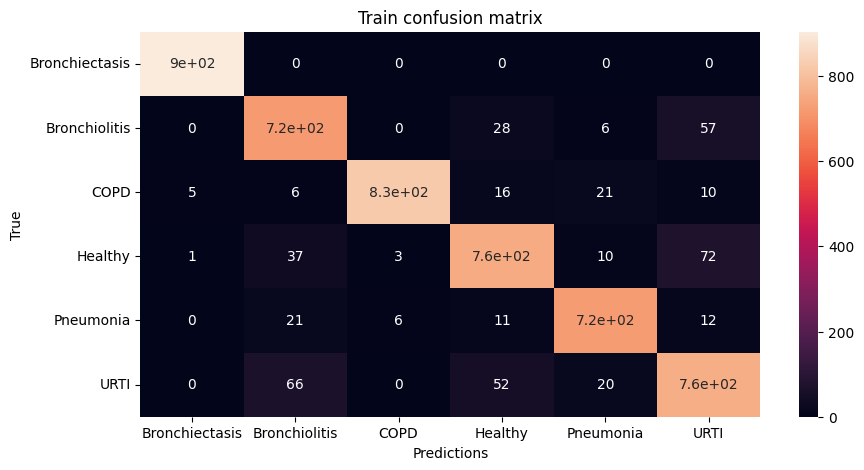

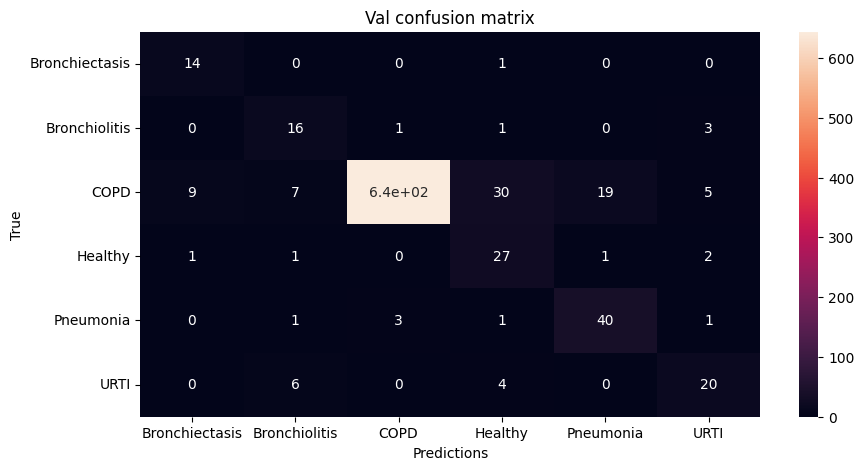


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 81:

Train Accuracy: 0.9122670807453416

Train Loss: 0.2629749092811383

Train F1 Score: 0.9016012815955263

Val Accuracy: 0.905715811965812

Val Loss: 0.26868614099091953

Val F1 Score: 0.6874795037287252




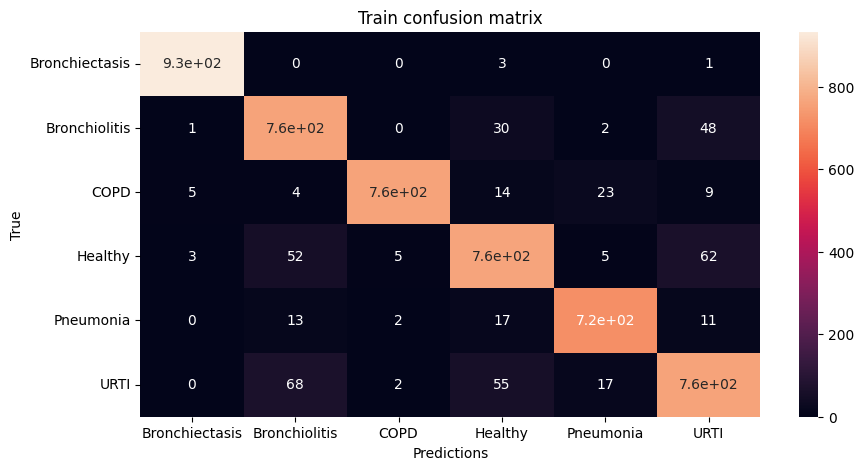

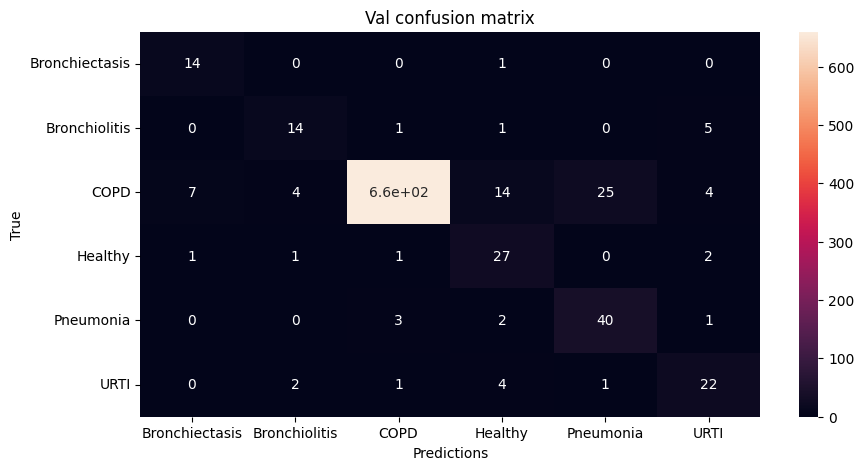


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 82:

Train Accuracy: 0.9202018633540373

Train Loss: 0.24601397121915167

Train F1 Score: 0.9096428407645374

Val Accuracy: 0.8935185185185185

Val Loss: 0.3319221272788666

Val F1 Score: 0.6532175883098885




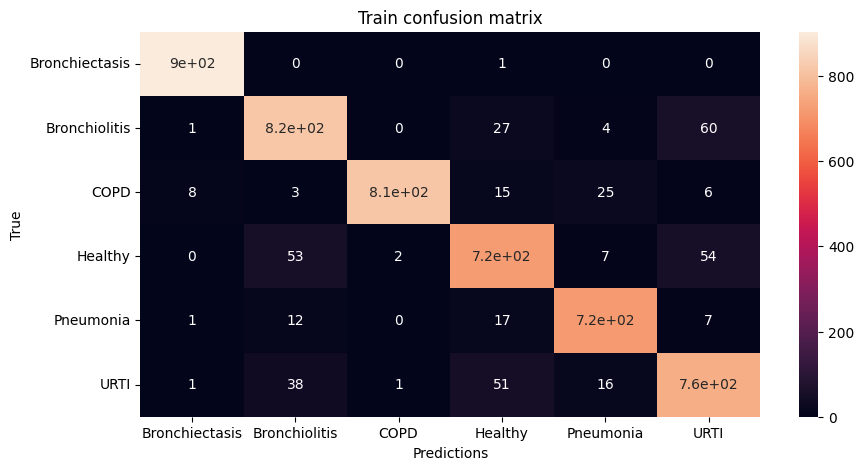

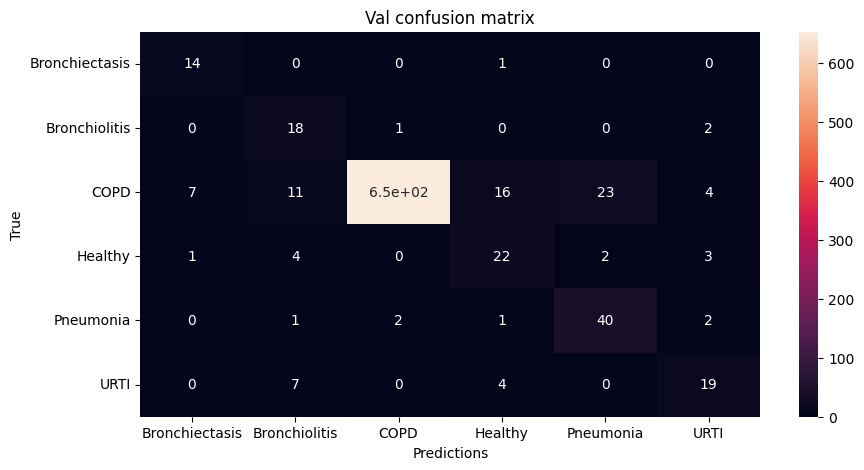


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 83:

Train Accuracy: 0.9184549689440994

Train Loss: 0.2466017614517893

Train F1 Score: 0.9095638198141726

Val Accuracy: 0.9196047008547009

Val Loss: 0.2273877601104754

Val F1 Score: 0.7064984838167826




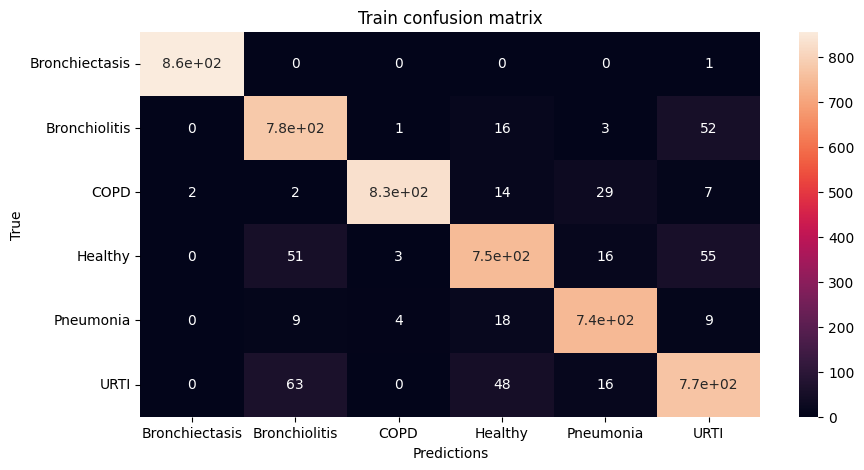

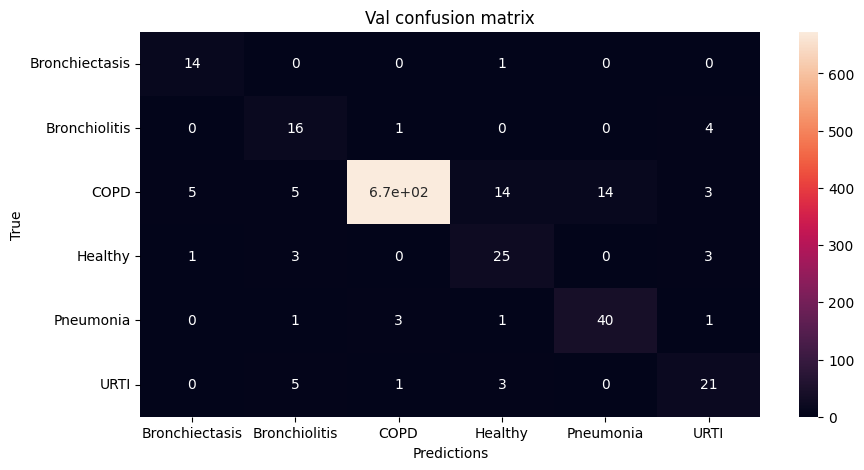


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 84:

Train Accuracy: 0.9101319875776398

Train Loss: 0.2568129808497355

Train F1 Score: 0.9018356726036308

Val Accuracy: 0.8958333333333334

Val Loss: 0.3209664662954984

Val F1 Score: 0.664739070115266




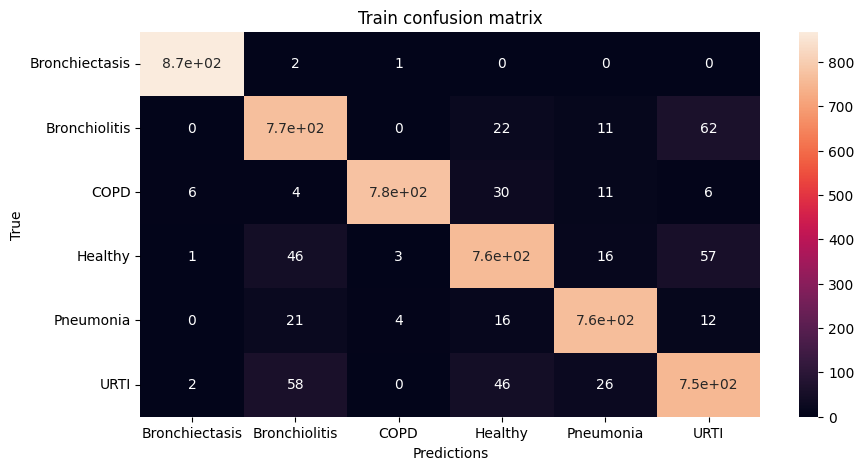

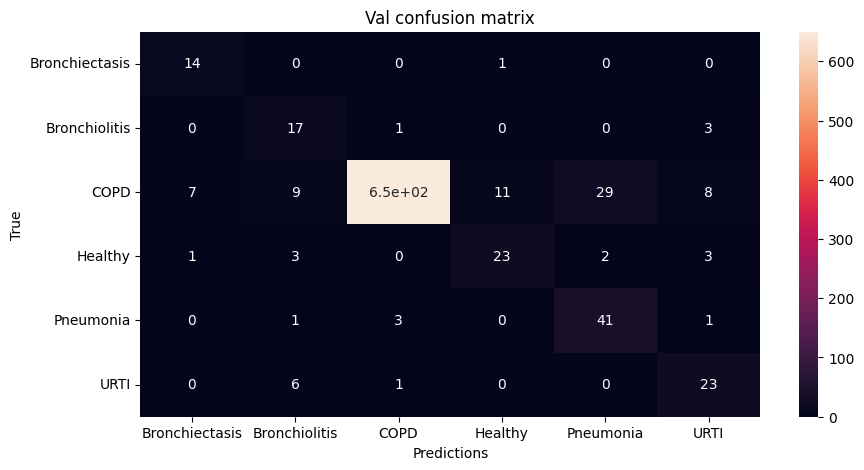


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 85:

Train Accuracy: 0.9160947204968944

Train Loss: 0.24875968928385225

Train F1 Score: 0.9072831672911318

Val Accuracy: 0.9083867521367521

Val Loss: 0.256668863542102

Val F1 Score: 0.7098272564234557




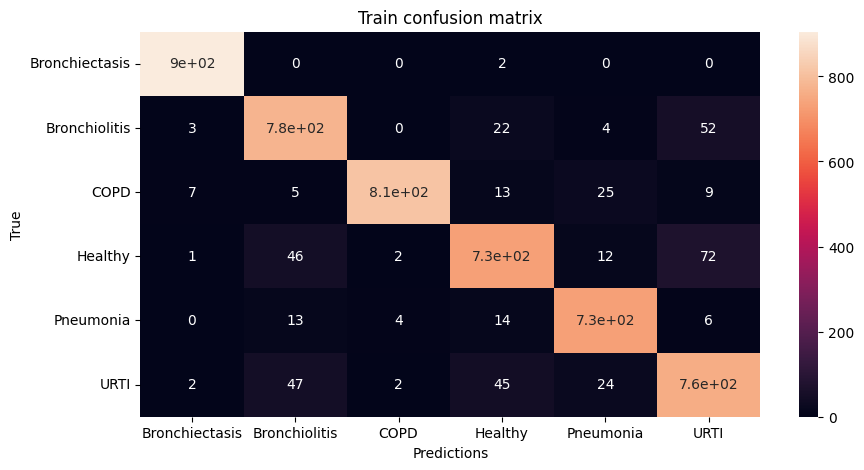

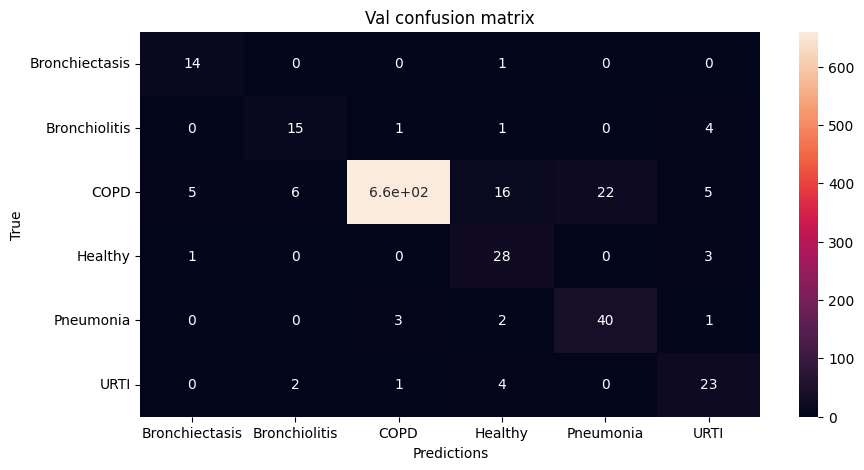


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 86:

Train Accuracy: 0.9147903726708074

Train Loss: 0.2419597687928573

Train F1 Score: 0.9035628885956284

Val Accuracy: 0.9155982905982906

Val Loss: 0.24837335978669148

Val F1 Score: 0.7102538490736926




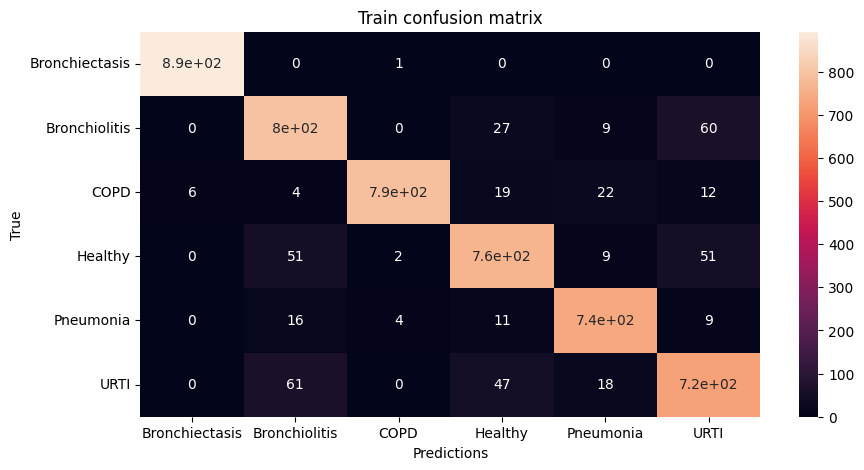

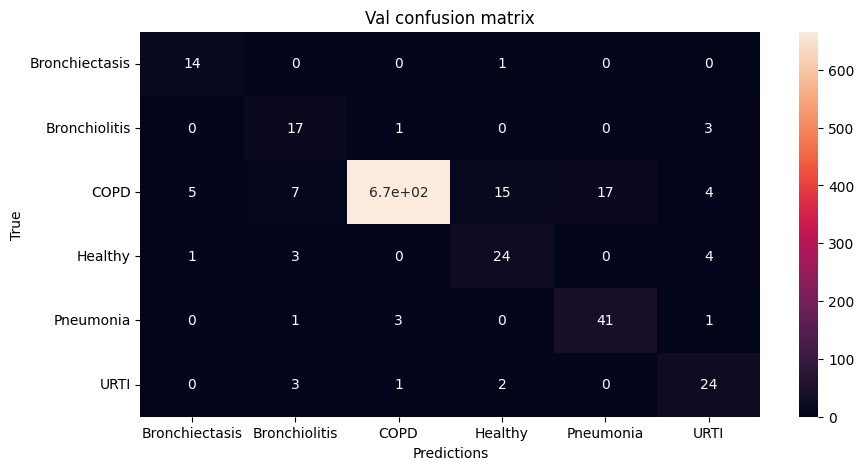


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 87:

Train Accuracy: 0.9287655279503105

Train Loss: 0.21541219905759237

Train F1 Score: 0.9230440647705741

Val Accuracy: 0.9115028490028491

Val Loss: 0.28018183095587623

Val F1 Score: 0.6855487150174601




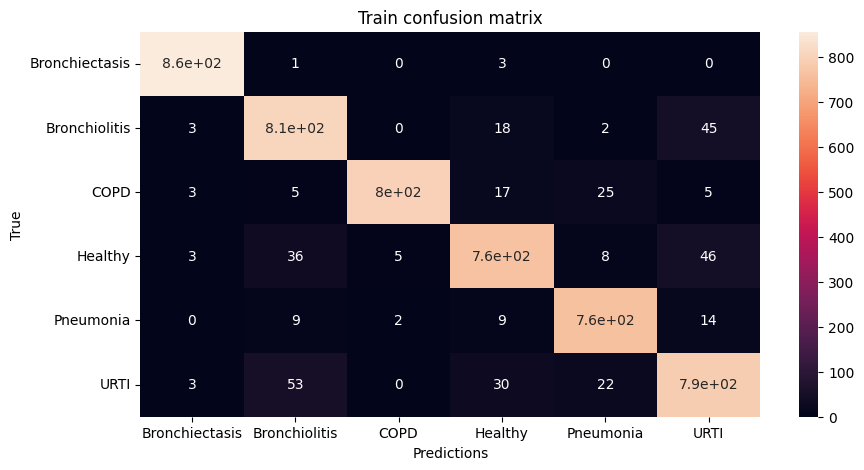

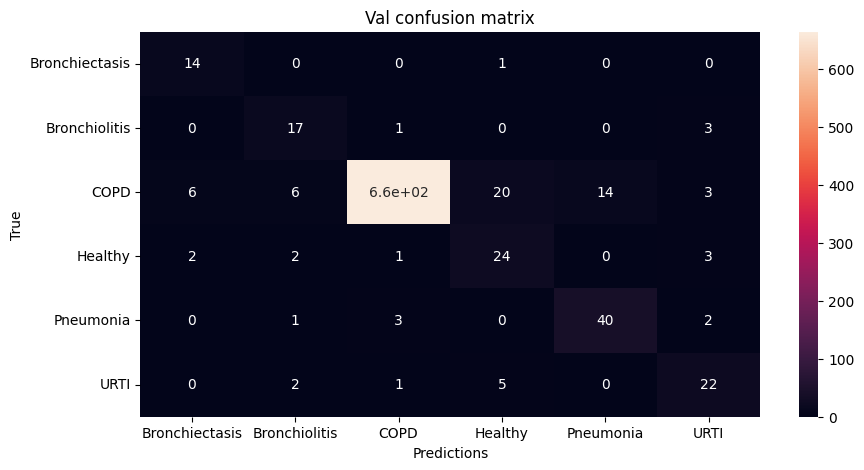


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 88:

Train Accuracy: 0.9264363354037267

Train Loss: 0.22103601830623906

Train F1 Score: 0.9143045322495218

Val Accuracy: 0.9008190883190883

Val Loss: 0.29680441685572817

Val F1 Score: 0.6760377519660525




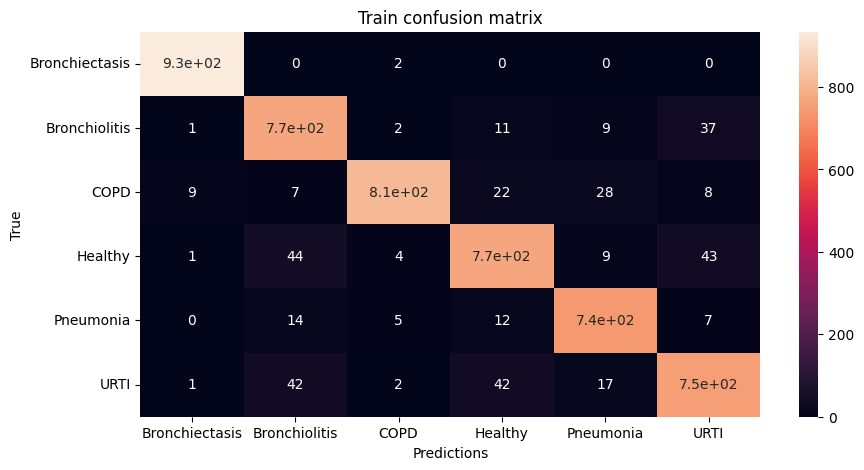

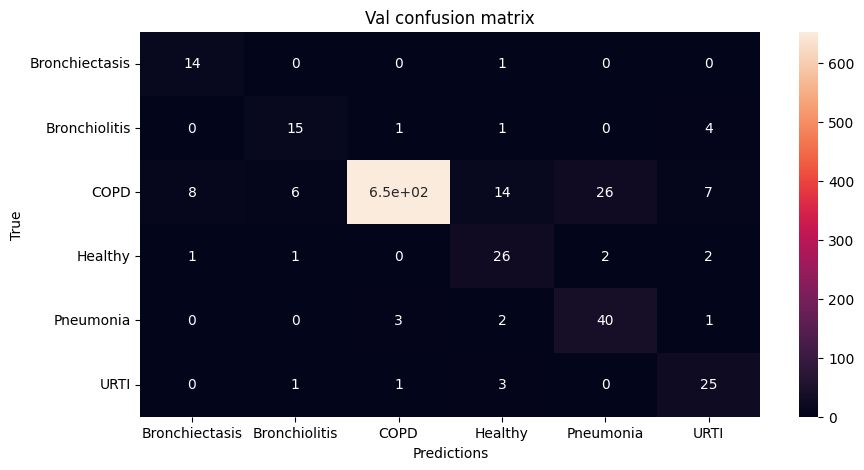


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 89:

Train Accuracy: 0.9304580745341615

Train Loss: 0.2098146521989603

Train F1 Score: 0.9233116329826924

Val Accuracy: 0.9141737891737891

Val Loss: 0.23654617438161815

Val F1 Score: 0.6703545489796886




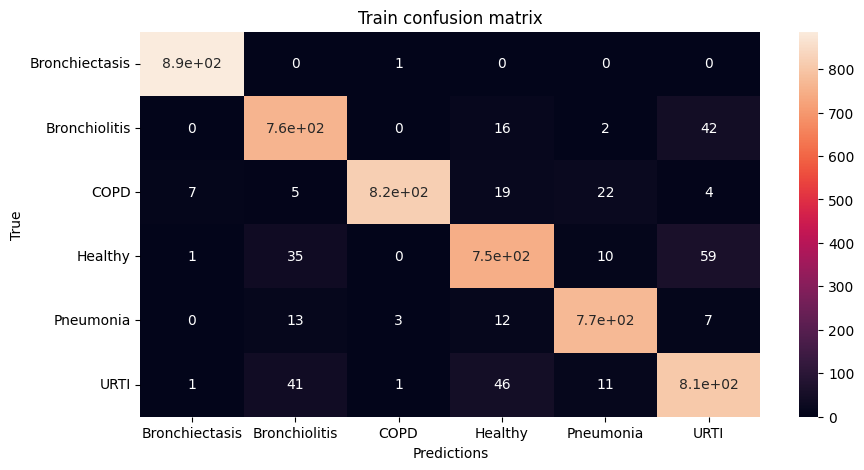

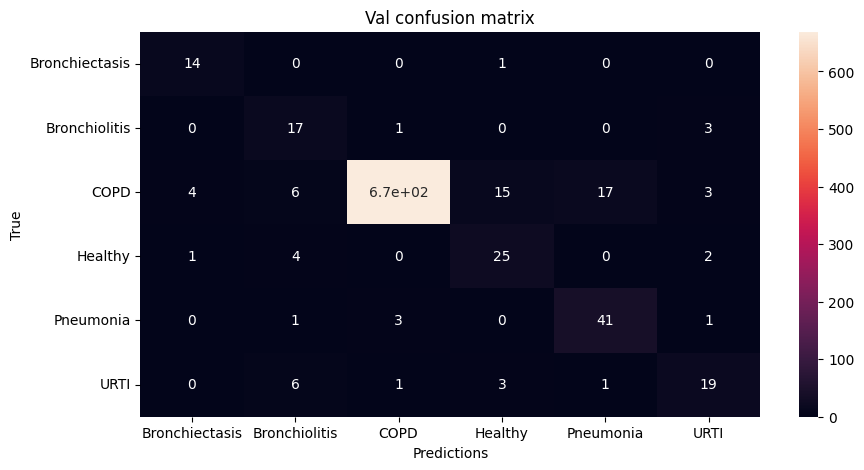


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 90:

Train Accuracy: 0.9216149068322981

Train Loss: 0.23400221718764452

Train F1 Score: 0.9137272953246691

Val Accuracy: 0.905715811965812

Val Loss: 0.2745481256257605

Val F1 Score: 0.6627715671503985




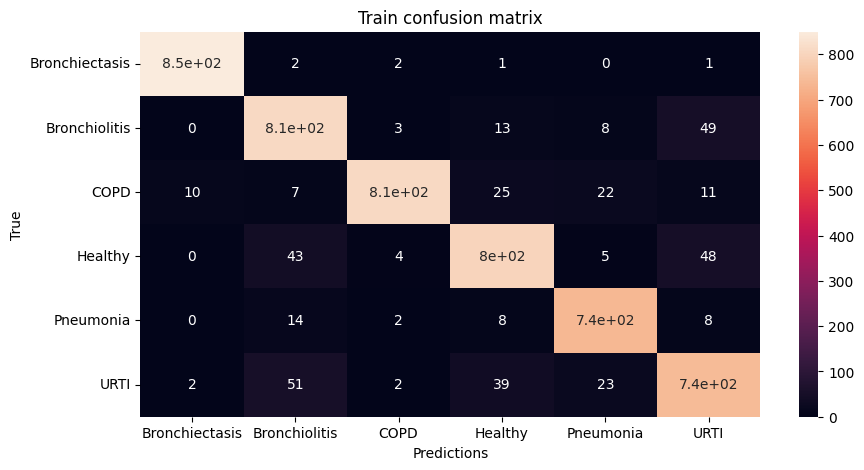

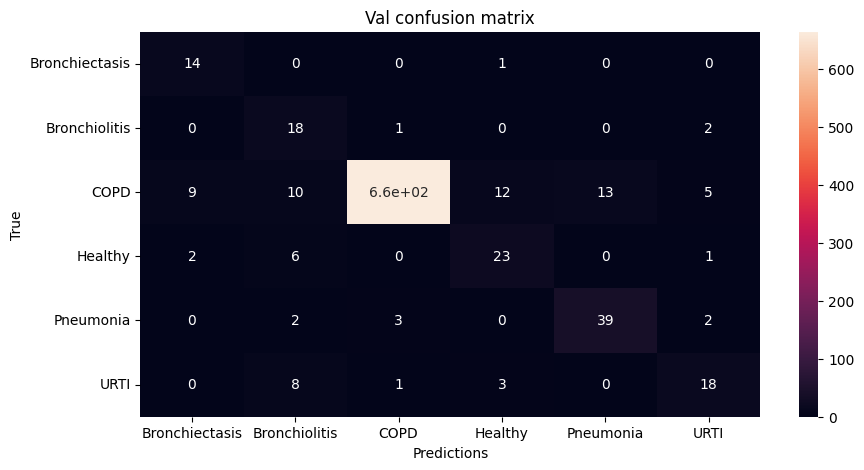


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 91:

Train Accuracy: 0.9209239130434783

Train Loss: 0.22470220673528518

Train F1 Score: 0.91350195348633

Val Accuracy: 0.9262820512820512

Val Loss: 0.2154450889814783

Val F1 Score: 0.6845045961715557




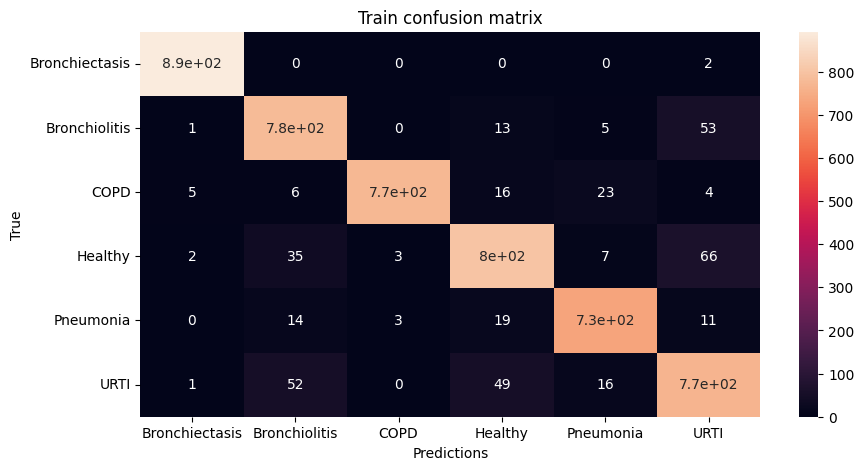

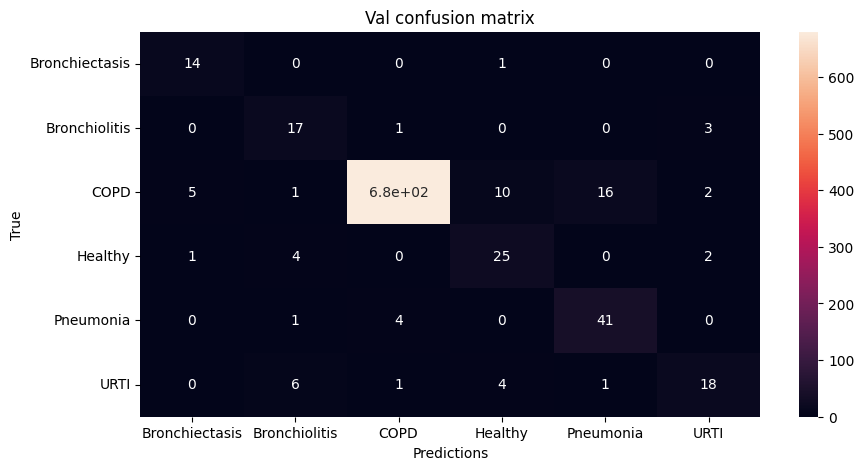


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 92:

Train Accuracy: 0.922166149068323

Train Loss: 0.22591339227575694

Train F1 Score: 0.9134131418251843

Val Accuracy: 0.9086538461538461

Val Loss: 0.2756356194063469

Val F1 Score: 0.6873035563362969




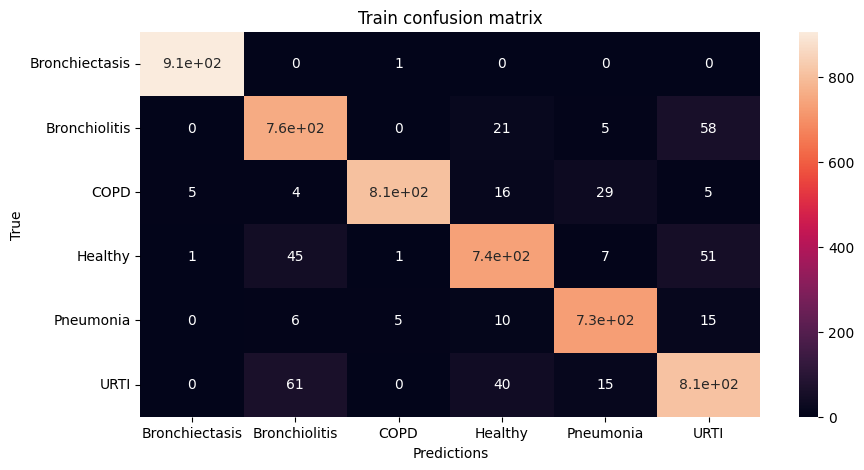

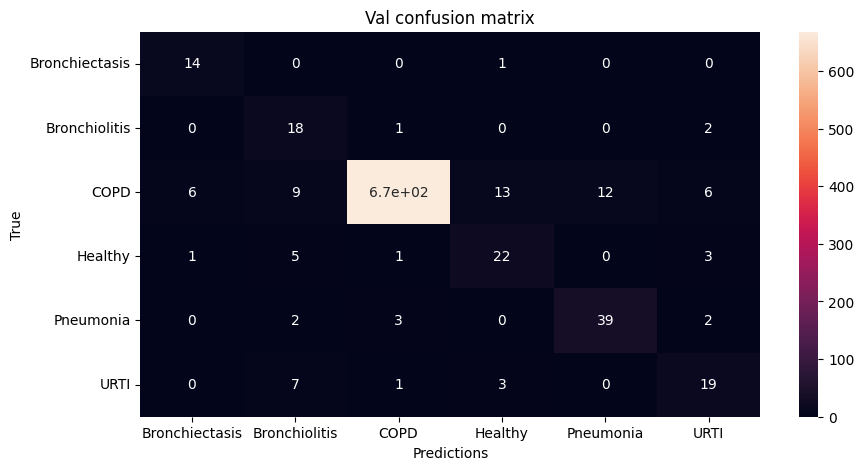


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 93:

Train Accuracy: 0.9291847826086956

Train Loss: 0.22285428286894507

Train F1 Score: 0.9208270155865214

Val Accuracy: 0.9130163817663818

Val Loss: 0.25045694397003565

Val F1 Score: 0.6827676329347823




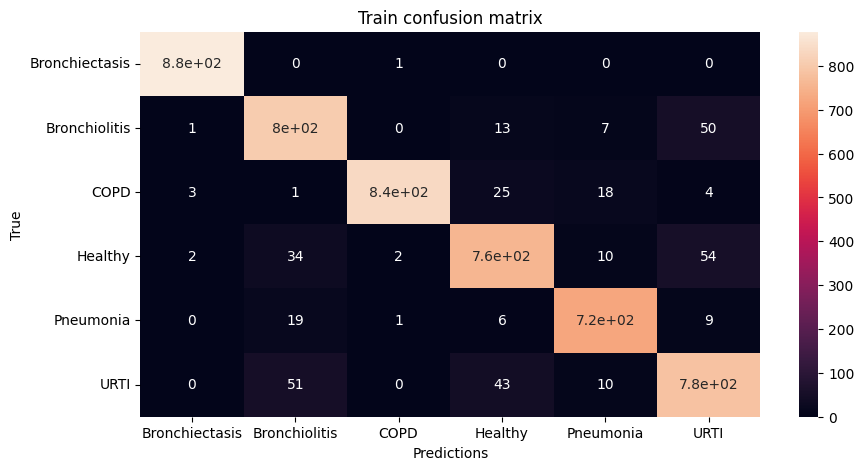

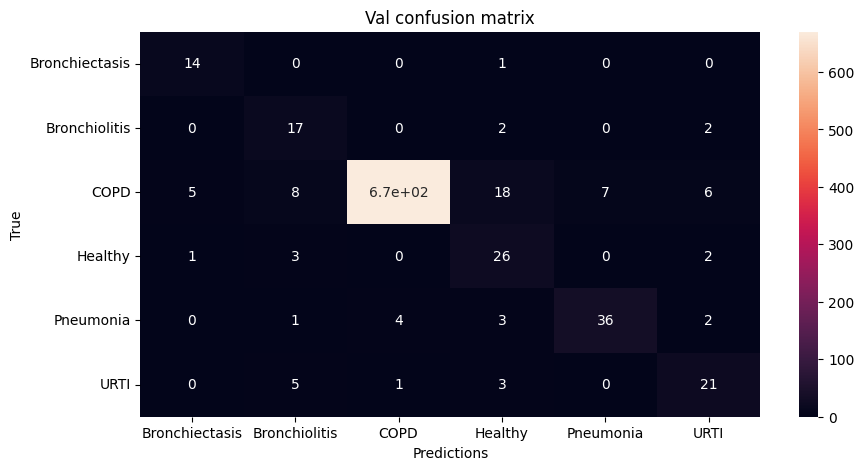


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 94:

Train Accuracy: 0.9249689440993788

Train Loss: 0.23141010026939168

Train F1 Score: 0.9167067445583225

Val Accuracy: 0.9123931623931624

Val Loss: 0.2679784778091643

Val F1 Score: 0.6896154703917327




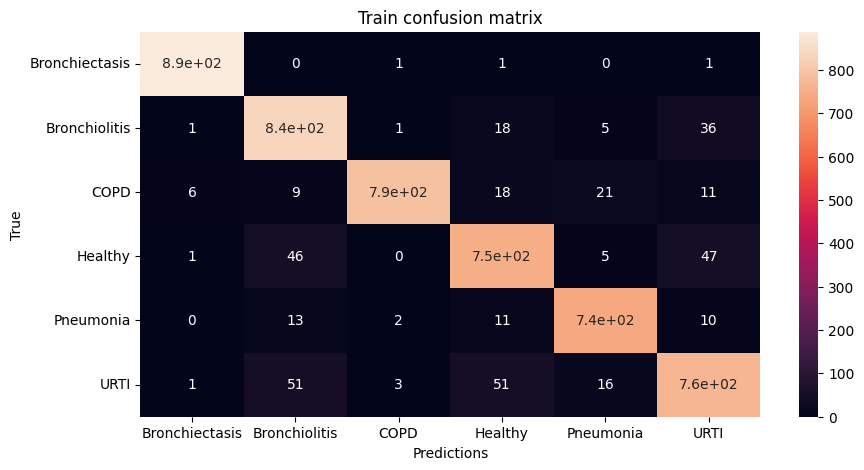

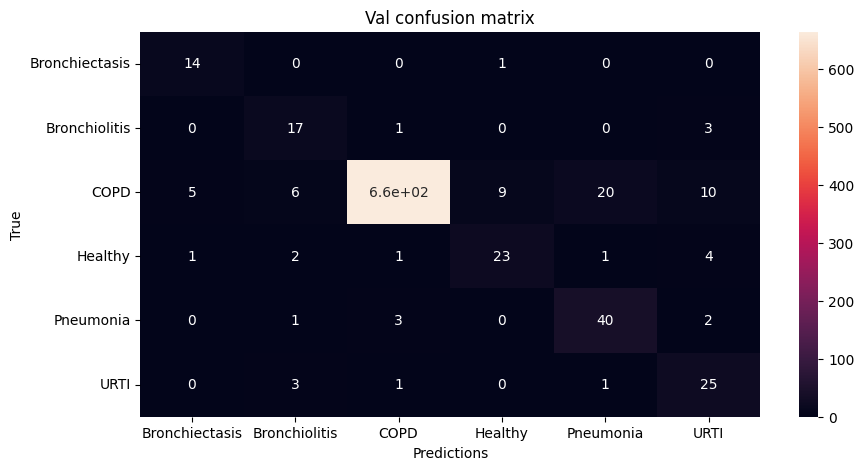


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 95:

Train Accuracy: 0.9307375776397515

Train Loss: 0.2088968694348883

Train F1 Score: 0.9244154243735794

Val Accuracy: 0.9196047008547009

Val Loss: 0.25795275662784223

Val F1 Score: 0.6696531231756564




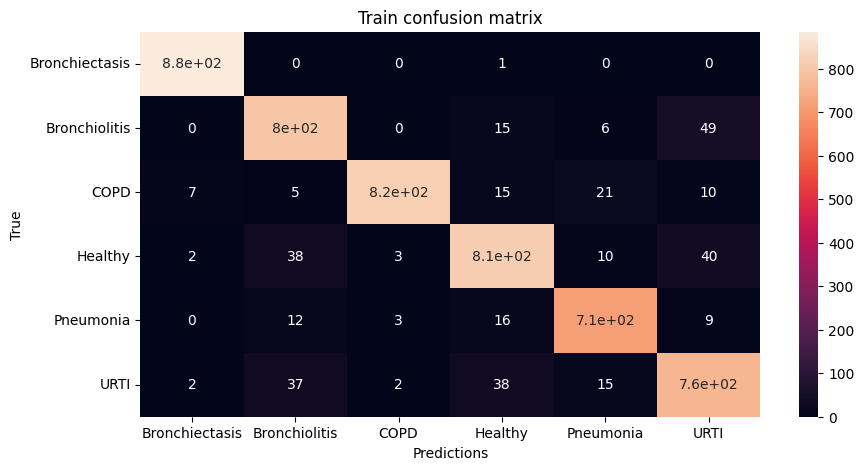

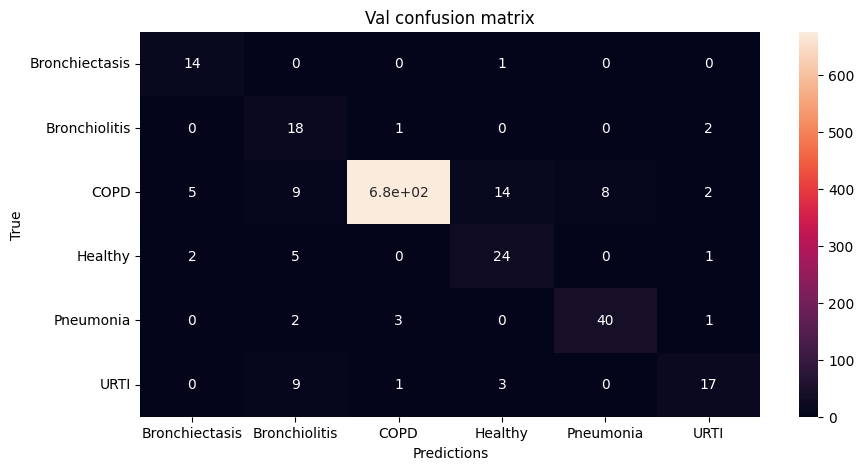


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 96:

Train Accuracy: 0.9285714285714286

Train Loss: 0.20541004822676226

Train F1 Score: 0.9216150363779957

Val Accuracy: 0.9131944444444444

Val Loss: 0.25286128454738194

Val F1 Score: 0.6788616710238986




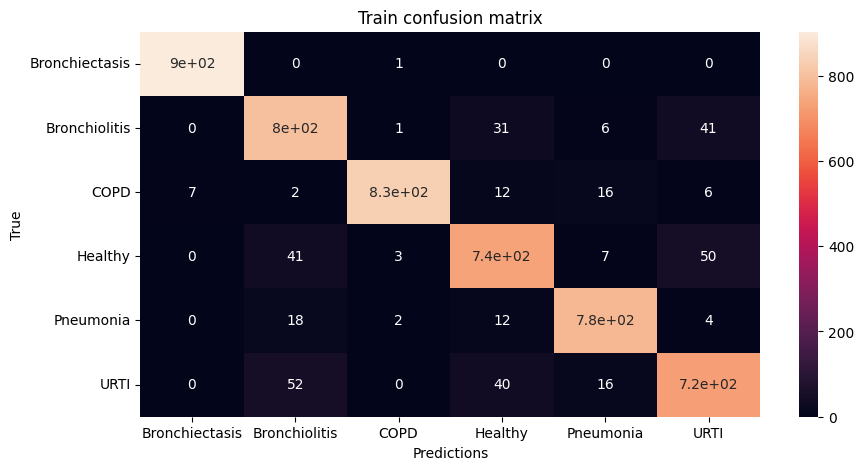

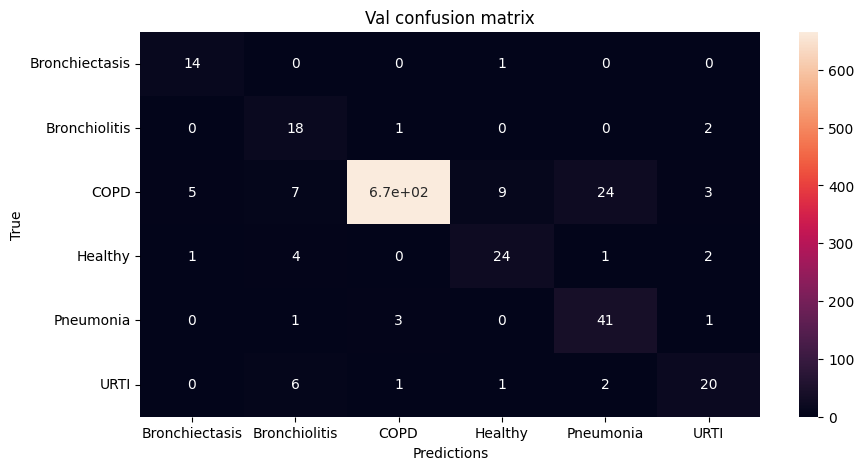


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 97:

Train Accuracy: 0.9346739130434781

Train Loss: 0.19619271436833446

Train F1 Score: 0.927487703954211

Val Accuracy: 0.9017094017094017

Val Loss: 0.26681554234690136

Val F1 Score: 0.6413043373160892




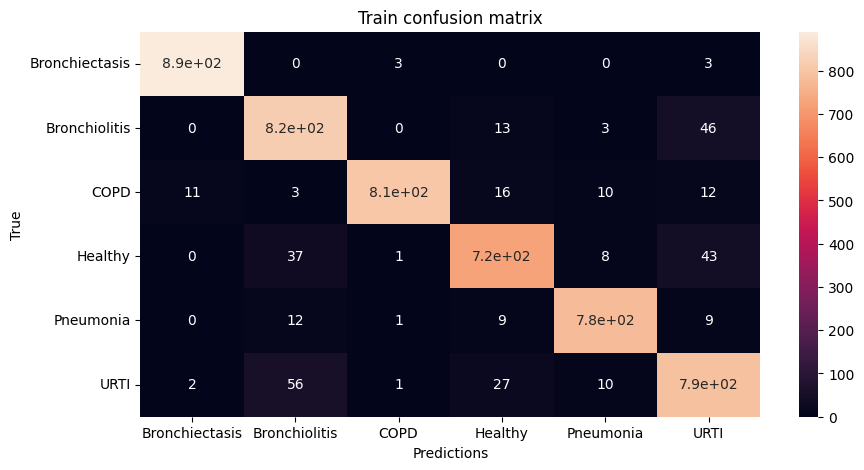

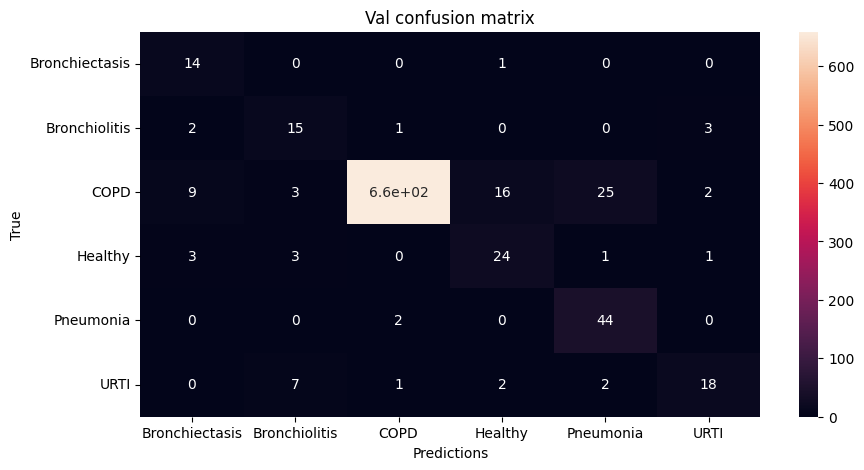


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 98:

Train Accuracy: 0.9362267080745341

Train Loss: 0.19690903741287888

Train F1 Score: 0.9294022928853953

Val Accuracy: 0.9149750712250713

Val Loss: 0.2498748592549452

Val F1 Score: 0.6892049842410617




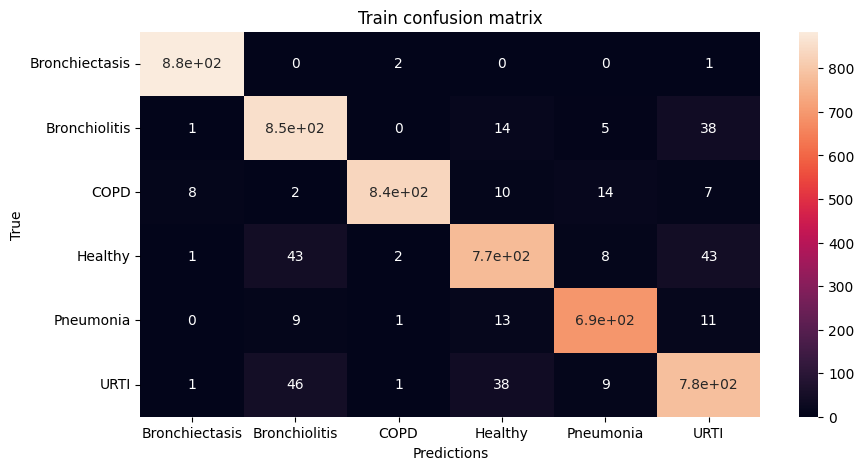

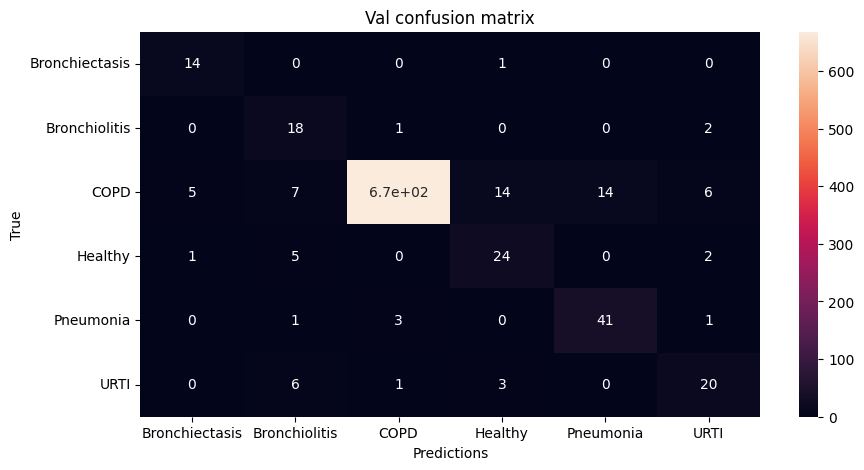


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 99:

Train Accuracy: 0.9421583850931677

Train Loss: 0.18818023233957912

Train F1 Score: 0.9336017207329318

Val Accuracy: 0.9291310541310541

Val Loss: 0.2291637405201241

Val F1 Score: 0.689431779914432




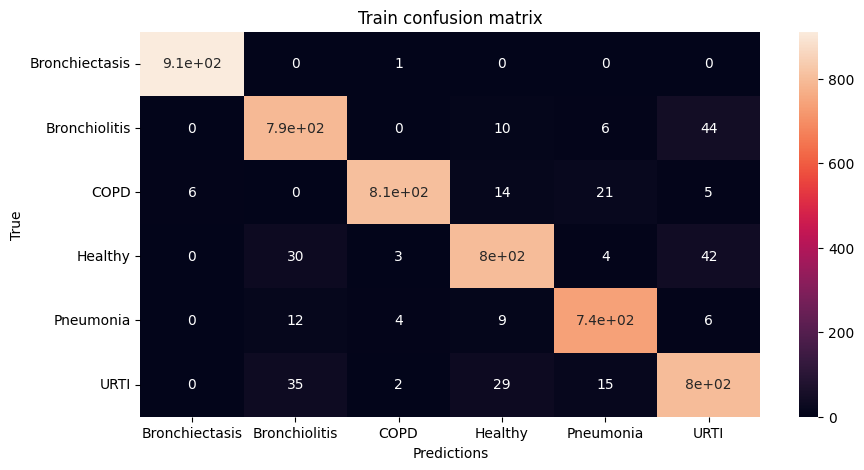

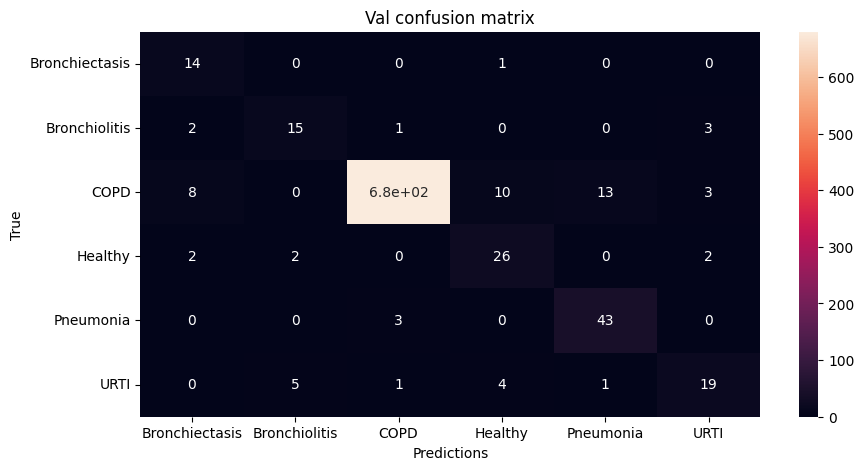


Training:


  0%|          | 0/161 [00:00<?, ?it/s]

Testing:


  0%|          | 0/27 [00:00<?, ?it/s]


Epoch 100:

Train Accuracy: 0.9342857142857142

Train Loss: 0.1993801503771951

Train F1 Score: 0.9273345481534923

Val Accuracy: 0.9221866096866096

Val Loss: 0.2138668611921646

Val F1 Score: 0.7043523413163645




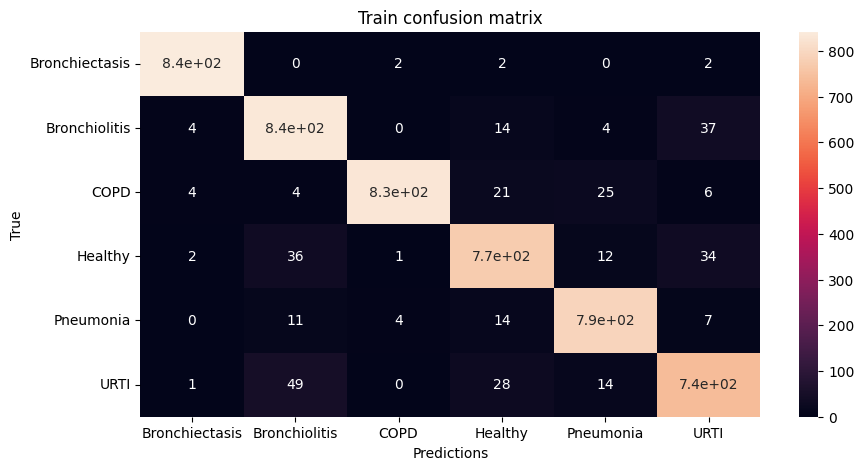

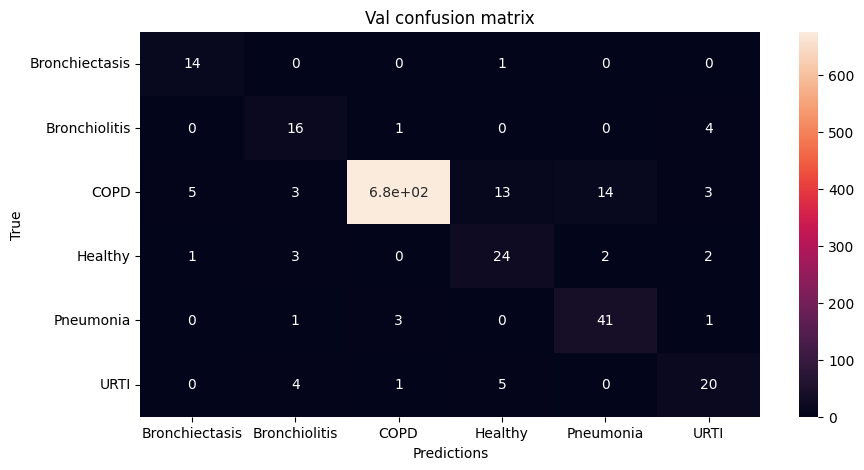

In [22]:
epochs=100
train_model(model2,epochs)


Training:


  0%|          | 0/27 [00:00<?, ?it/s]


Test Accuracy: 0.9295833333333333

Test Loss: 0.23242219868633482

Test F1 Score: 0.7648751868142022




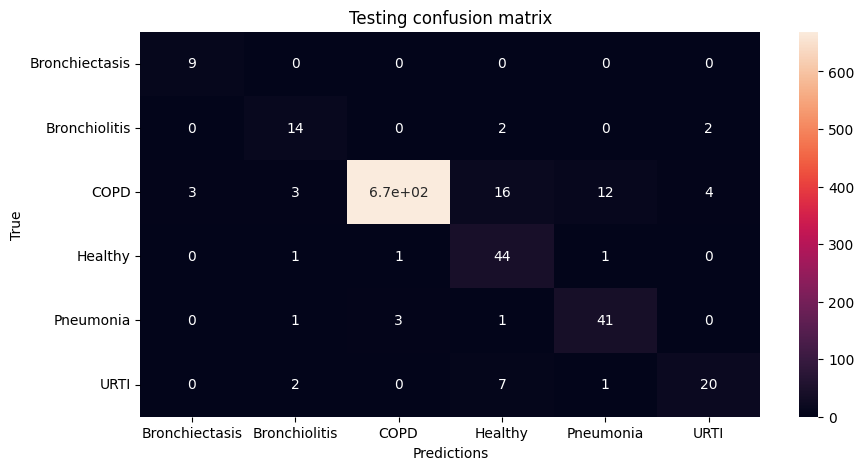

In [23]:
test_model(model2)

In [24]:
torch.save(model2.state_dict(),"../models/model_lstm_76f1.pt")